### Analyze and plot the output from climatology_qvp.ipynb

In [15]:
import sys
sys.path.append('/home/silke/Python/radarlecture2016/radarmeteorology/common')
import warnings
warnings.filterwarnings('ignore')
from helper import create_filename
import pandas as pd 
import numpy as np
import datetime as dt
import glob
from scipy import stats
import wradlib as wrl
from scipy import ndimage
import math
import matplotlib.pyplot as pl
import matplotlib as mpl
try:
    get_ipython().magic("matplotlib inline")
except:
    pl.ion()
import os
import glob
import scipy
from pandas import rolling_median
import pandas as pd
from scipy.stats import linregress
import numpy.ma as ma
from numpy import asarray as ar
import datetime as dt
from datetime import timedelta
from matplotlib.dates import DayLocator, HourLocator, MinuteLocator,DateFormatter, drange
from scipy.stats.stats import pearsonr
from scipy.signal import correlate

In [16]:
#%pylab

In [17]:
def get_miub_cmap():
    startcolor = 'white'  # a dark olive
    color1 = '#8ec7ff'#'cyan'    # a bright yellow
    color2 = 'dodgerblue'
    color3 = 'darkgreen'
    #color3 = 'lime'
    color4 = 'yellow'
    color5 = 'darkorange'
    color6 = 'red'
    #color7 = 'purple'
    endcolor = 'darkmagenta'    # medium dark red
    colors = [startcolor, color1, color2, color3, color4, color5, color6, endcolor]
    return mpl.colors.LinearSegmentedColormap.from_list('miub1',colors)


In [18]:
def add_cbar(im, ticks, norm):
    cbar = pl.colorbar(im[-1], norm=norm, boundaries=ticks, pad=0.05)
    cbar.locator = mpl.ticker.FixedLocator(ticks)
    cbar.update_ticks()
    return cbar

In [19]:
def get_norm(ticks):
    cmap = get_miub_cmap()
    norm = mpl.colors.BoundaryNorm(ticks, cmap.N)
    return norm

In [20]:
def shift(xs, n):
    if n >= 0:
        return np.r_[np.full(n, np.nan), xs[:-n]]
    else:
        return np.r_[xs[-n:], np.full(-n, np.nan)]

#Load output files

In [21]:
datepath="/home/silke/Python/projects/climatology/"
outputf = sorted(glob.glob(datepath + "out*.txt"))
dates=range(len(outputf))
#print('outputf',outputf[3])
for l in range(len(outputf)):
    dates[l]=outputf[l][44:54]

###Versteh Fehler nicht, lasse erstmal 2013-05-29 weg
##Ich glaub 2015-04-02 gibts keine Wippeninfo, ebenfalls weg:'2015-05-03', '2015-05-29', '2015-06-02','2015-06-13', '2015-06-23', '2015-07-13','2015-07-26', 
#     '2015-08-08','2015-08-16', '2015-08-17', '2015-09-01','2015-09-16'
## Ich glaub 2015-04-04 ist die ML zu niedrig, ebenfalls weg
##'2016-01-10','2016-01-11', '2016-01-13'
##Fast das komplette 2015 hat keine Wippeninfo!!
##high rainrates raus '2013-07-03', '2014-05-06', '2014-08-26',
##nearly high rain rates '2015-06-13','2015-08-08','2015-09-01',
datesredu=['2013-04-12','2014-05-06','2014-05-27','2014-06-28','2014-07-08','2014-07-09','2014-10-07','2014-10-08','2014-11-04','2014-12-12',
       '2015-03-29','2015-04-02','2015-05-03',
       '2015-06-02', '2015-06-23', '2015-08-04','2015-08-17','2015-08-27','2015-09-01','2015-09-13', 
       '2015-09-16','2015-09-22','2015-10-05','2015-11-17', '2015-11-19', '2015-11-29', '2015-12-04', 
       '2015-12-08','2015-12-09',
       '2015-12-11', '2015-12-16', '2015-12-22', '2015-12-25','2016-01-07','2016-01-30','2016-09-04']
dates=['2013-04-12','2013-07-03','2014-05-06','2014-05-27','2014-06-28','2014-07-05','2014-07-08',
       '2014-07-09','2014-08-26','2014-10-07','2014-10-08','2014-10-09','2014-10-15','2014-11-04','2014-12-12',     
       '2014-11-16','2014-12-19','2015-01-02','2015-01-08','2015-02-27','2015-03-29','2015-04-02','2015-05-03','2015-05-29',
       '2015-06-02', '2015-06-13','2015-06-22','2015-06-23', '2015-07-13','2015-08-04','2015-08-08','2015-08-17',
       '2015-08-27','2015-09-01','2015-09-13', 
       '2015-09-16','2015-09-22','2015-10-05','2015-11-17', '2015-11-19', '2015-11-20',
       '2015-11-29', '2015-12-08','2015-12-09',
       '2015-12-11', '2015-12-16', '2015-12-22', '2015-12-25','2016-01-02','2016-01-07',
       '2016-09-04']
#,'2015-11-06' rausgenommen
dates_low=['2013-04-12', '2015-04-02', '2015-04-04','2015-05-03', '2015-05-29',
       '2015-06-02', '2015-06-23', '2015-07-13',
       '2015-08-17', '2015-09-16',
       '2015-10-05','2015-11-06','2015-11-17', '2015-11-19', '2015-11-20',
       '2015-11-29', '2015-12-08','2015-12-09','2015-12-11', 
       '2015-12-16','2015-12-22', '2015-12-25','2016-01-02', '2016-01-07']
print(dates)


['2013-04-12', '2013-07-03', '2014-05-06', '2014-05-27', '2014-06-28', '2014-07-05', '2014-07-08', '2014-07-09', '2014-08-26', '2014-10-07', '2014-10-08', '2014-10-09', '2014-10-15', '2014-11-04', '2014-12-12', '2014-11-16', '2014-12-19', '2015-01-02', '2015-01-08', '2015-02-27', '2015-03-29', '2015-04-02', '2015-05-03', '2015-05-29', '2015-06-02', '2015-06-13', '2015-06-22', '2015-06-23', '2015-07-13', '2015-08-04', '2015-08-08', '2015-08-17', '2015-08-27', '2015-09-01', '2015-09-13', '2015-09-16', '2015-09-22', '2015-10-05', '2015-11-17', '2015-11-19', '2015-11-20', '2015-11-29', '2015-12-08', '2015-12-09', '2015-12-11', '2015-12-16', '2015-12-22', '2015-12-25', '2016-01-02', '2016-01-07', '2016-09-04']


# Read the output files

In [22]:
def runningMean(x, N):
    y = np.zeros((len(x)-N+1,))
    for ctr in range(len(x)-N+1):
         y[ctr] = np.sum(x[ctr:(ctr+N)])
    return y/N

a=[3,5,np.nan, np.nan,7,3,7,9,45,232,5,7,9,0]
#print(runningMean(a,2))

In [23]:
def savitzky_golay(y, window_size, order, deriv=0):
    r"""Smooth (and optionally differentiate) data with a Savitzky-Golay filter.
    The Savitzky-Golay filter removes high frequency noise from data.
    It has the advantage of preserving the original shape and
    features of the signal better than other types of filtering
    approaches, such as moving averages techhniques.
    
    This code has been taken from http://www.scipy.org/Cookbook/SavitzkyGolay
    Parameters
    ----------
    y : array_like, shape (N,)
        the values of the time history of the signal.
    window_size : int
        the length of the window. Must be an odd integer number.
    order : int
        the order of the polynomial used in the filtering.
        Must be less then `window_size` - 1.
    deriv: int
        the order of the derivative to compute (default = 0 means only smoothing)
    Returns
    -------
    ys : ndarray, shape (N)
        the smoothed signal (or it's n-th derivative).
    Notes
    -----
    The Savitzky-Golay is a type of low-pass filter, particularly
    suited for smoothing noisy data. The main idea behind this
    approach is to make for each point a least-square fit with a
    polynomial of high order over a odd-sized window centered at
    the point.
    Examples
    --------
    t = np.linspace(-4, 4, 500)
    y = np.exp( -t**2 ) + np.random.normal(0, 0.05, t.shape)
    ysg = savitzky_golay(y, window_size=31, order=4)
    import matplotlib.pyplot as plt
    plt.plot(t, y, label='Noisy signal')
    plt.plot(t, np.exp(-t**2), 'k', lw=1.5, label='Original signal')
    plt.plot(t, ysg, 'r', label='Filtered signal')
    plt.legend()
    plt.savefig('images/golay.png')
    #plt.show()
    References
    ----------
    .. [1] A. Savitzky, M. J. E. Golay, Smoothing and Differentiation of
       Data by Simplified Least Squares Procedures. Analytical
       Chemistry, 1964, 36 (8), pp 1627-1639.
    .. [2] Numerical Recipes 3rd Edition: The Art of Scientific Computing
       W.H. Press, S.A. Teukolsky, W.T. Vetterling, B.P. Flannery
       Cambridge University Press ISBN-13: 9780521880688
    """
    try:
        window_size = np.abs(np.int(window_size))
        order = np.abs(np.int(order))
    except ValueError, msg:
        raise ValueError("window_size and order have to be of type int")
    if window_size % 2 != 1 or window_size < 1:
        raise TypeError("window_size size must be a positive odd number")
    if window_size < order + 2:
        raise TypeError("window_size is too small for the polynomials order")
    order_range = range(order+1)
    half_window = (window_size -1) // 2
    # precompute coefficients
    b = np.mat([[k**i for i in order_range] for k in range(-half_window, half_window+1)])
    m = np.linalg.pinv(b).A[deriv]
    # pad the signal at the extremes with
    # values taken from the signal itself
    firstvals = y[0] - np.abs( y[1:half_window+1][::-1] - y[0] )
    lastvals = y[-1] + np.abs(y[-half_window-1:-1][::-1] - y[-1])
    y = np.concatenate((firstvals, y, lastvals))
    return np.convolve( m, y, mode='valid')

#First try with pearson

('vorher', -0.9059541807653801)
('p-value', 3.6365747981882947e-19)
('p-value', 4.702000651993421e-06)
('p-value', 0.00012399427918406515)
('p-value', 0.004163771455335641)
('p-value', 0.04341190475865214)
('p-value', 0.2554269167003828)
('p-value', 0.8713525326382568)
('p-value', 0.3827761424915671)
('p-value', 0.09239989146286753)
('p-value', 0.02894105385206399)
('p-value', 0.0066310429330726384)
('p-value', 0.005410548252584259)
('p-value', 0.06389021023370788)
('p-value', 0.2547584964945567)


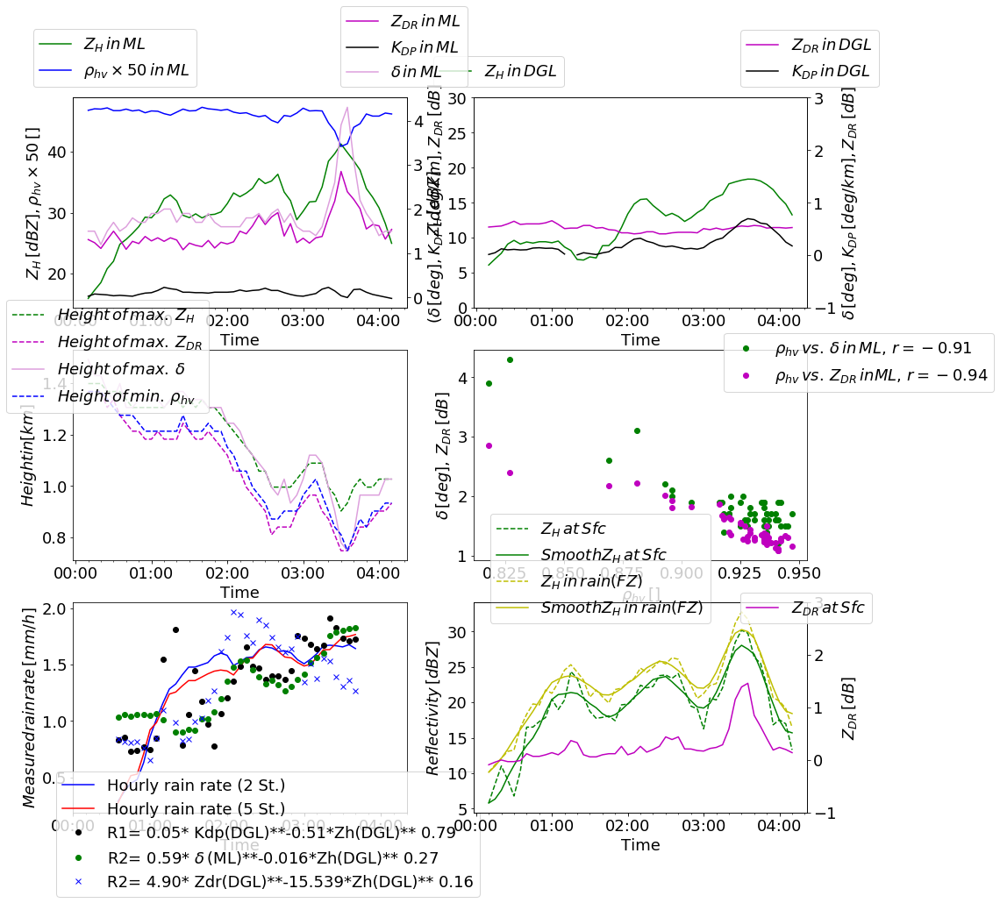

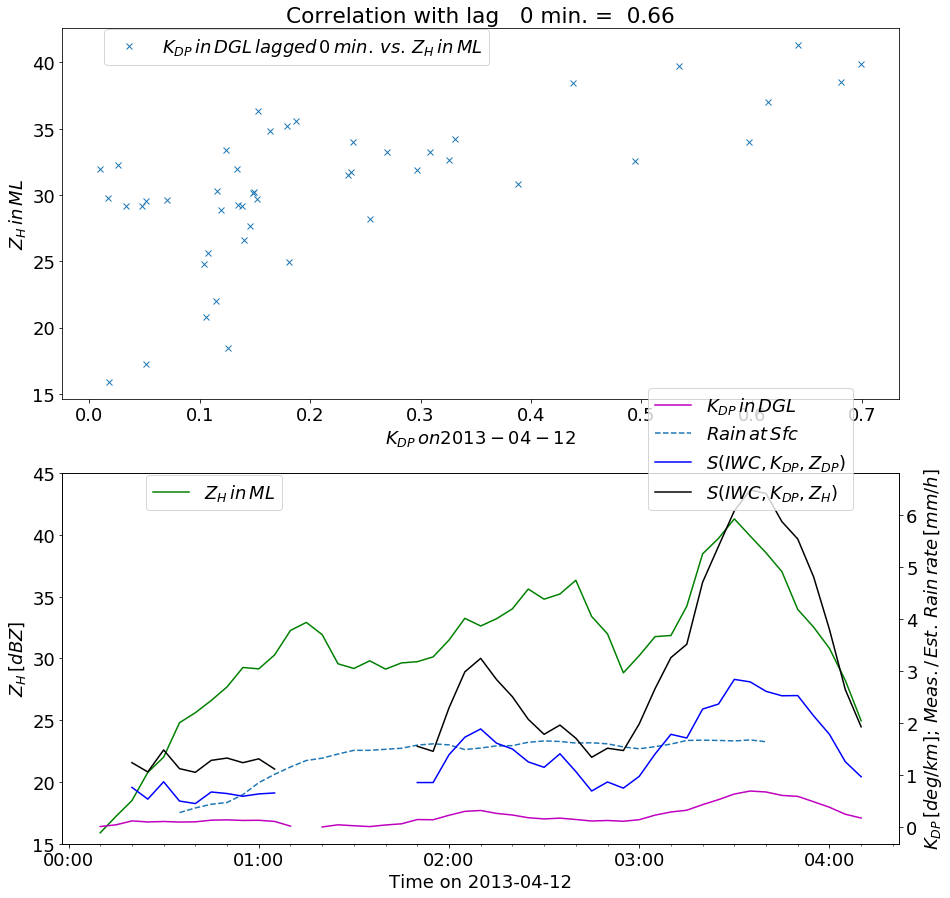

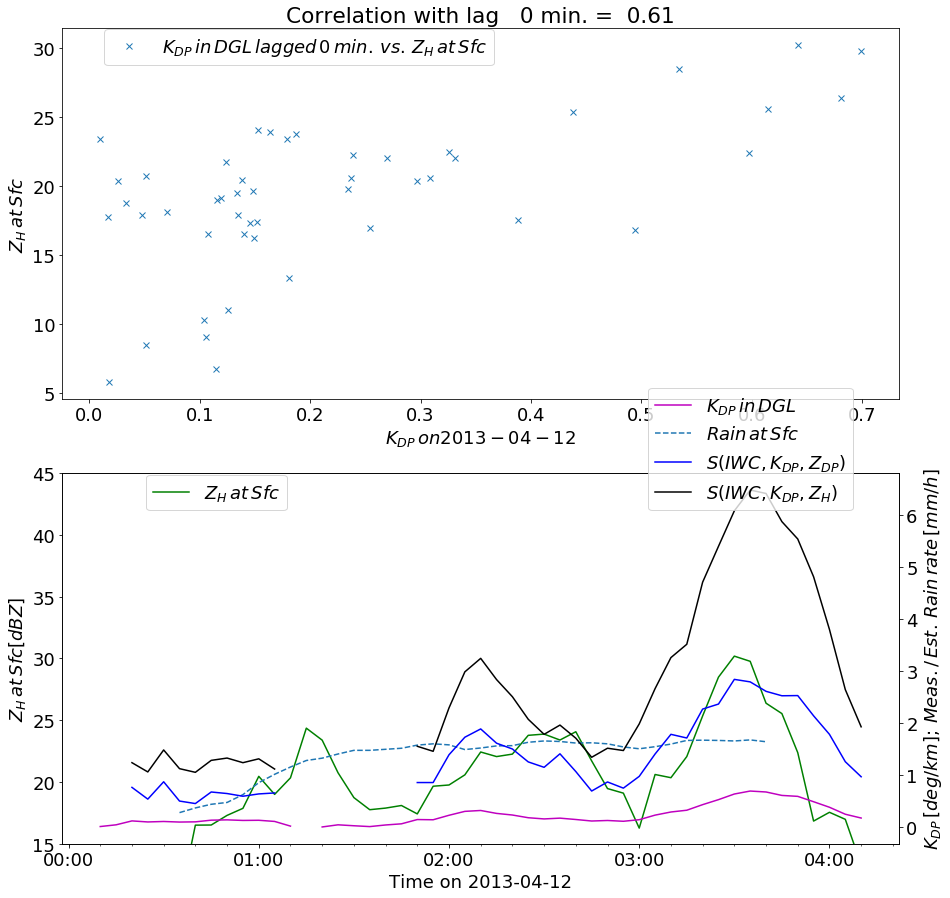

('vorher', -0.38831180835207085)
('p-value', 0.006992735902038973)
('p-value', 0.17947200313776426)
('p-value', 0.026124954595280536)
('p-value', 0.015919892320150012)
('p-value', 0.0014599118315079221)
('p-value', 0.0006562231788089626)
('p-value', 0.0020137647804860954)
('p-value', 0.0035061800398472516)
('p-value', 0.06899191266945433)
('p-value', 0.7762484331000505)
('p-value', 0.454480842239789)
('p-value', 0.18918318159635053)
('p-value', 0.139680497287999)
('p-value', 0.11449731457580115)


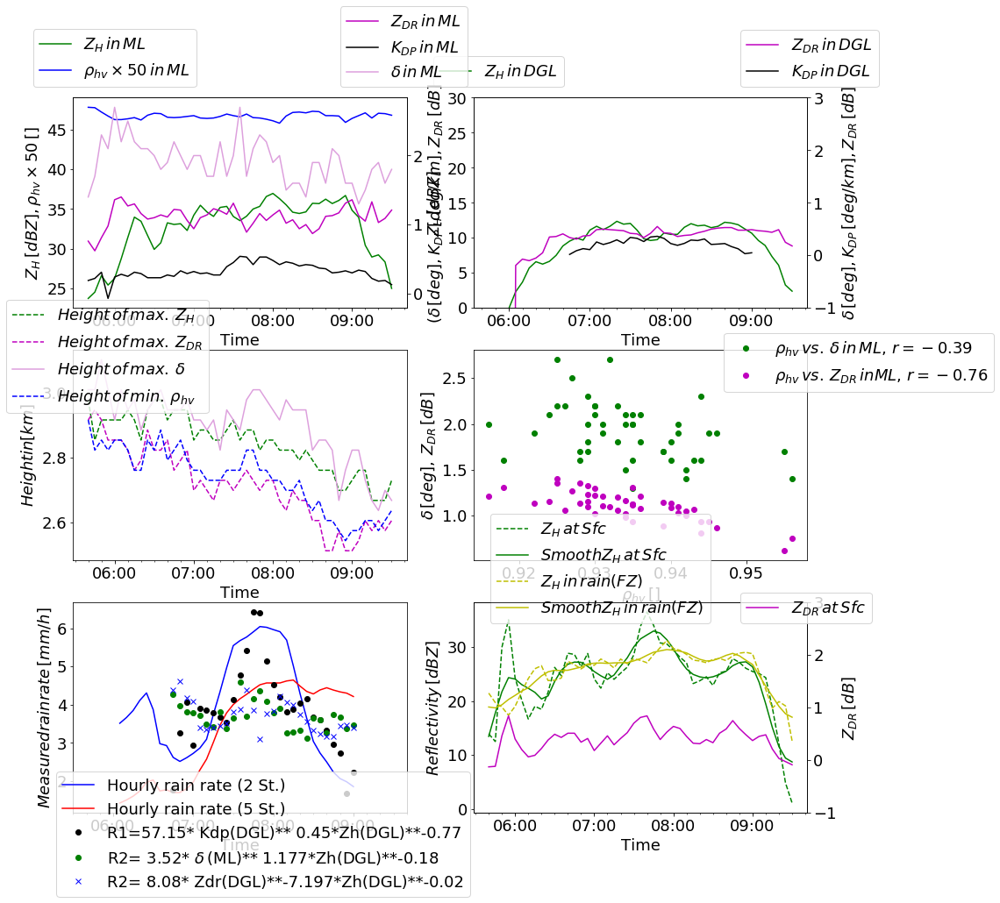

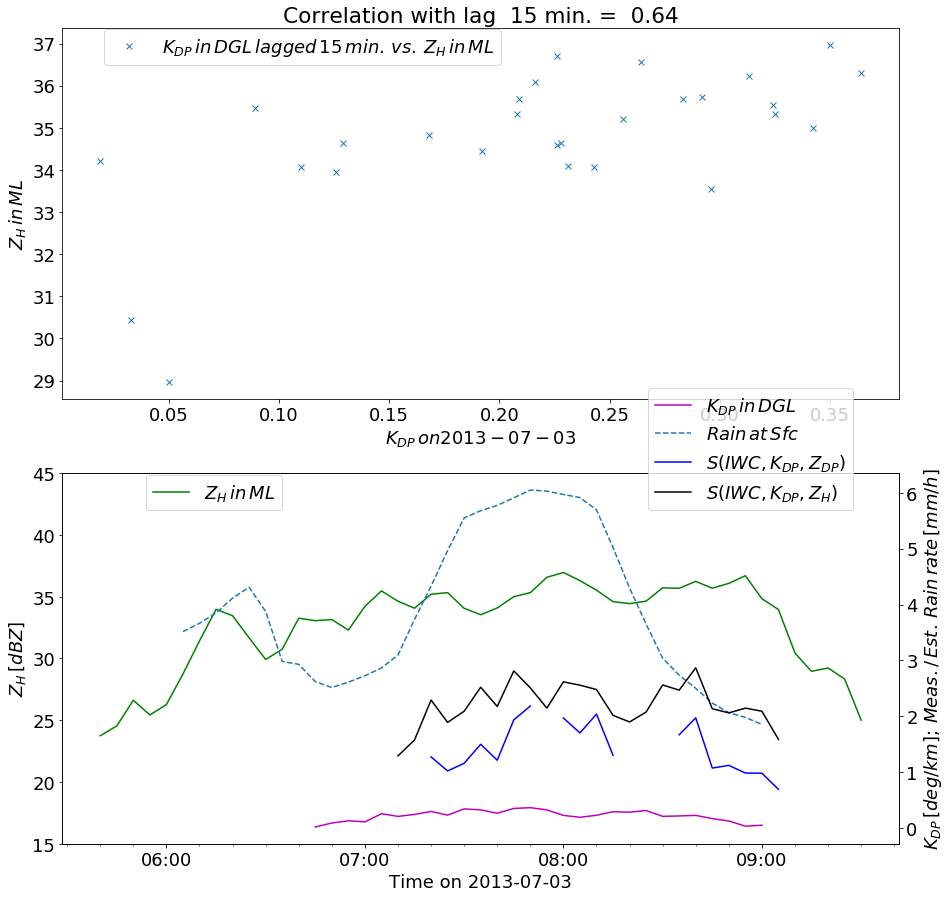

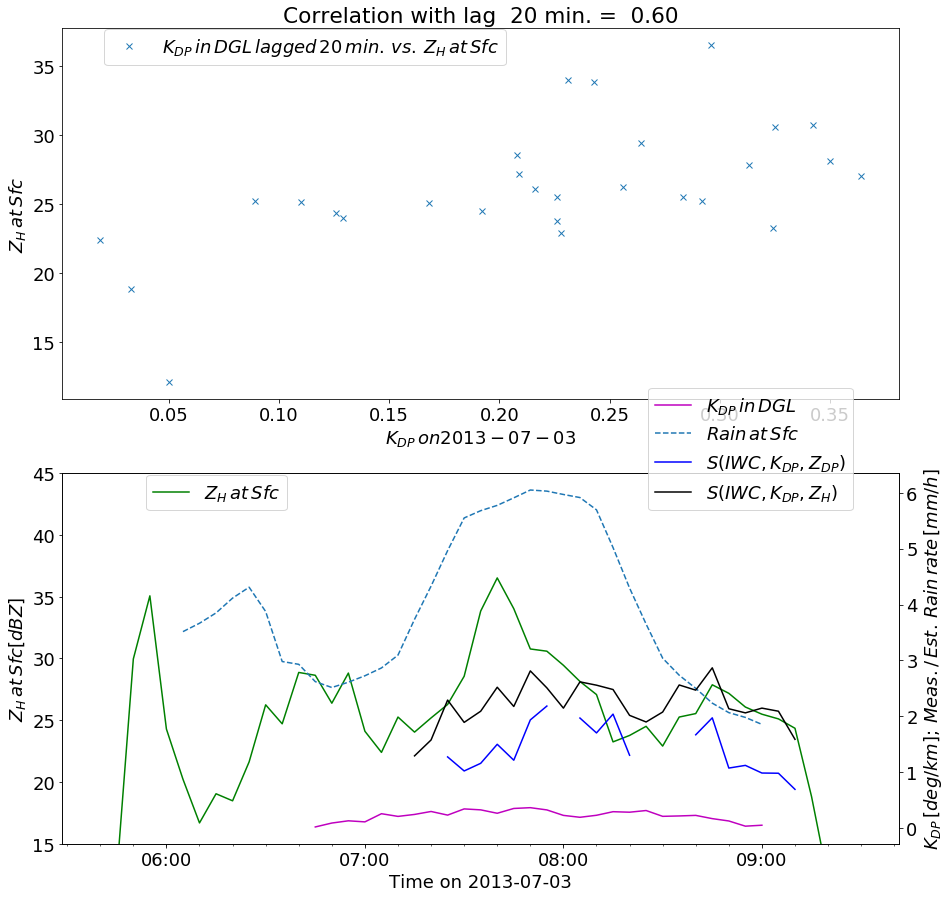

('vorher', -0.8631609440344539)
('p-value', 2.938860400160251e-18)
('p-value', 0.03391689831994687)
('p-value', 0.011505451708474937)
('p-value', 0.10551038645223025)
('p-value', 0.12972848860578257)
('p-value', 0.12892574445872224)
('p-value', 0.17985028585839724)
('p-value', 0.4453076192057228)
('p-value', 0.7187694710321373)
('p-value', 0.17172369149961744)
('p-value', 0.3282198488978493)
('p-value', 0.8231302490772856)
('p-value', 0.9155467340116299)
('p-value', 0.6882287750709092)


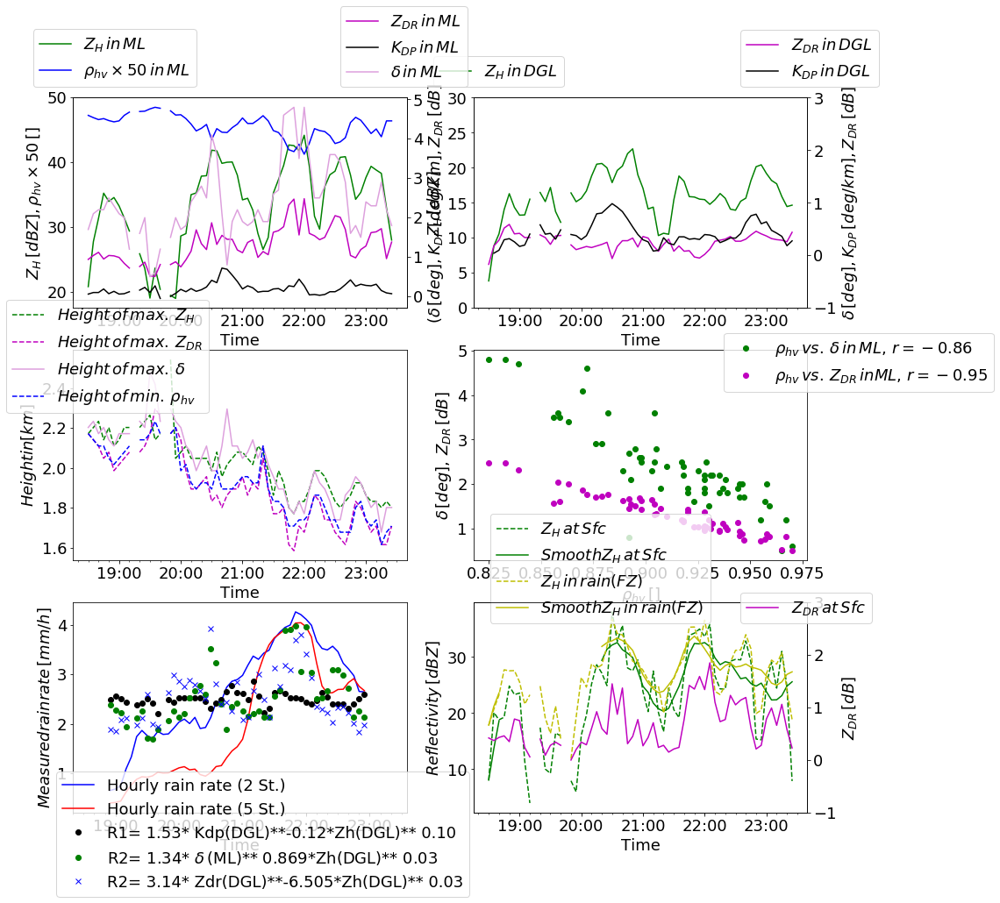

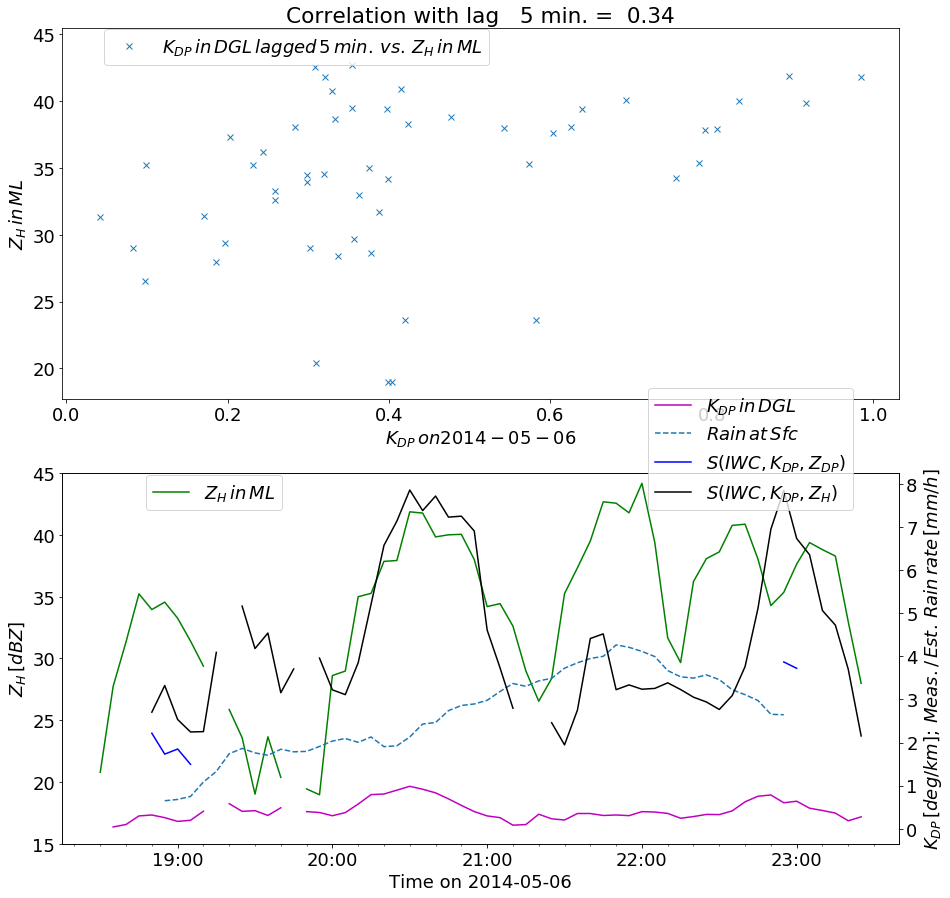

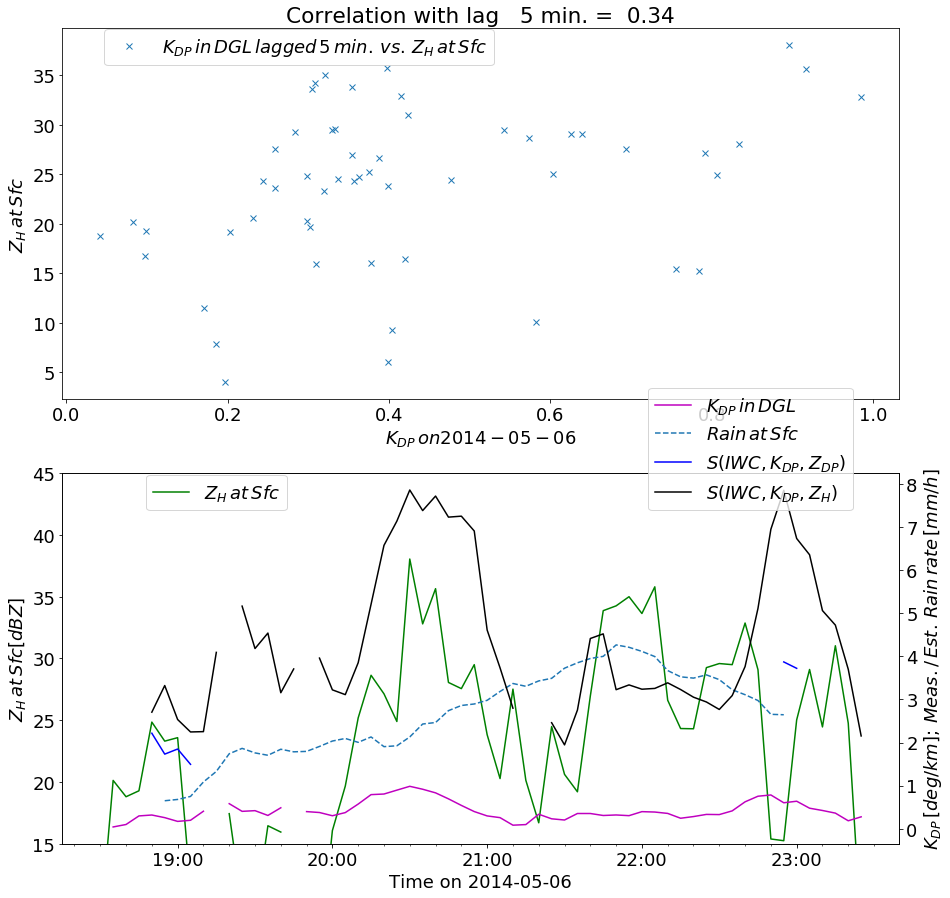

('vorher', -0.5399195212869069)
('p-value', 2.0976572661901267e-05)
('p-value', 0.05179892132116825)
('p-value', 0.10444008176063828)
('p-value', 0.2712435446105035)
('p-value', 0.5243723519839878)
('p-value', 0.7088621179250376)
('p-value', 0.9691570098986149)
('p-value', 0.4620576583236746)
('p-value', 0.21621609897472596)
('p-value', 0.11000560482399621)
('p-value', 0.036221860739075795)
('p-value', 0.01089770921315397)
('p-value', 0.0014999561879090748)
('p-value', 0.0001927946239016857)


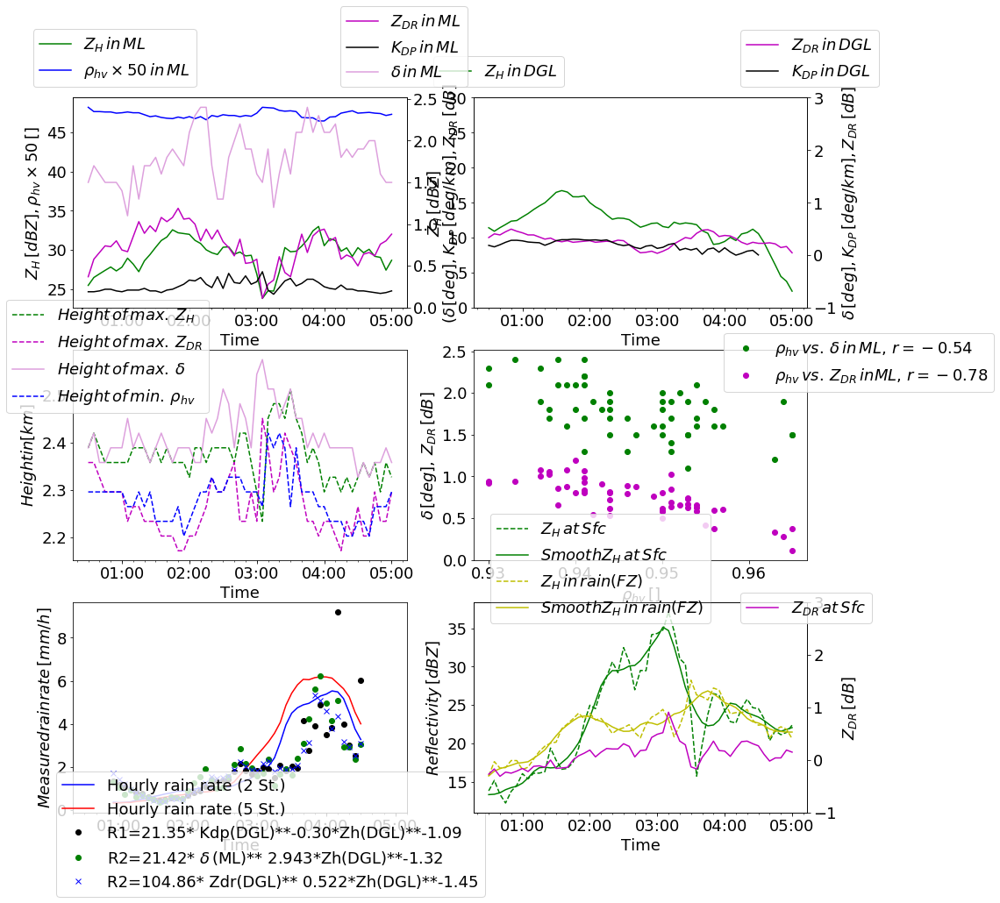

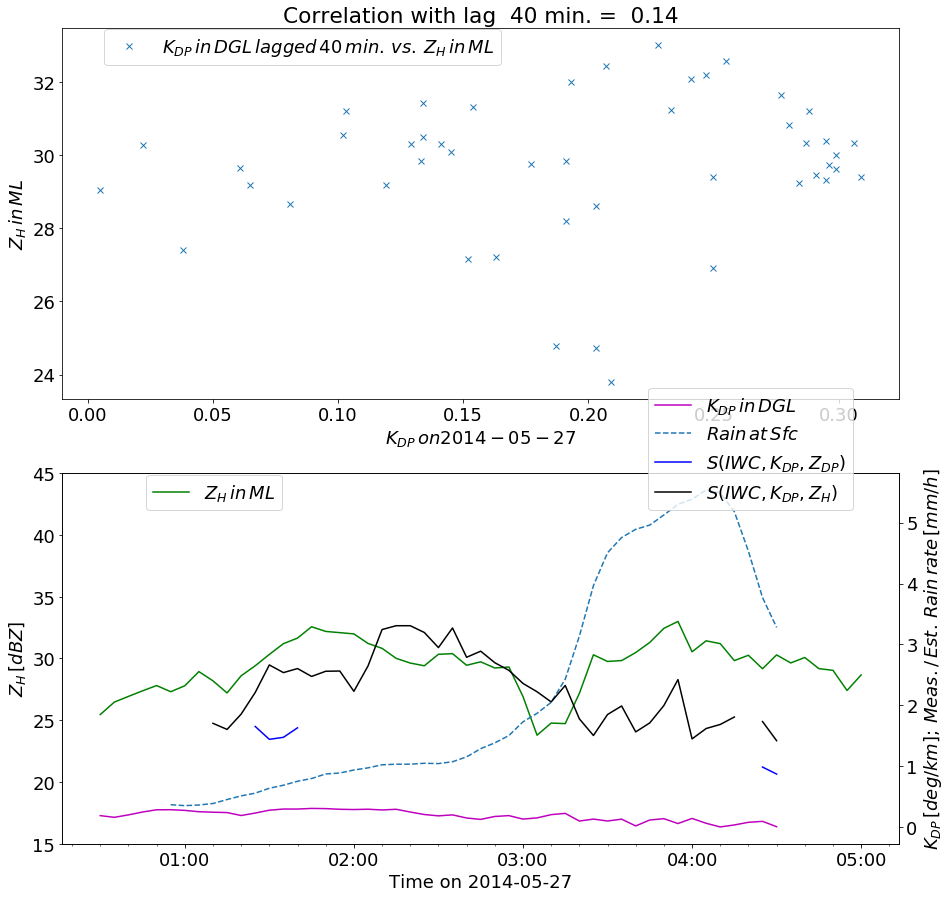

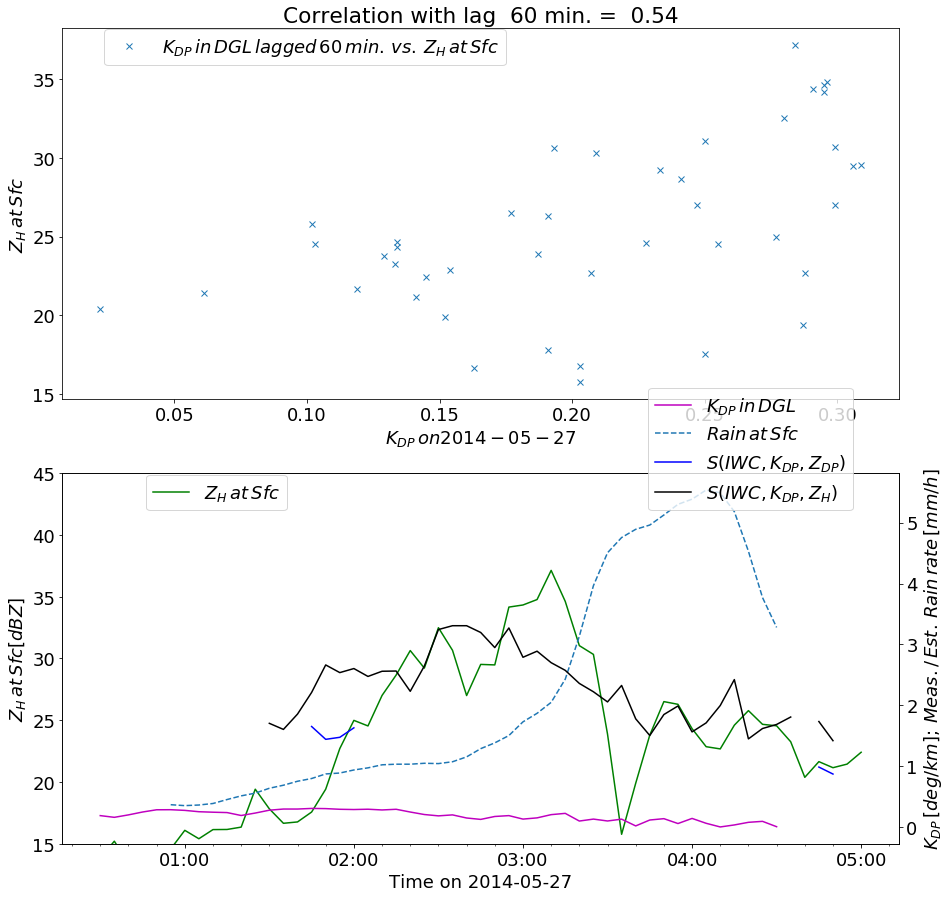

('vorher', -0.18242577492823356)
('p-value', 0.27984541282703046)
('p-value', 0.12348046550341765)
('p-value', 0.7220113258872276)
('p-value', 0.8511145169643477)
('p-value', 0.4866527157129079)
('p-value', 0.44346097421971187)
('p-value', 0.007221364824451738)
('p-value', 0.005895415167733989)
('p-value', 0.0032804785434442352)
('p-value', 0.0356202354155516)
('p-value', 0.09109116758963863)
('p-value', 0.4856706165541731)
('p-value', 0.868748007565853)
('p-value', 0.9121011430909085)


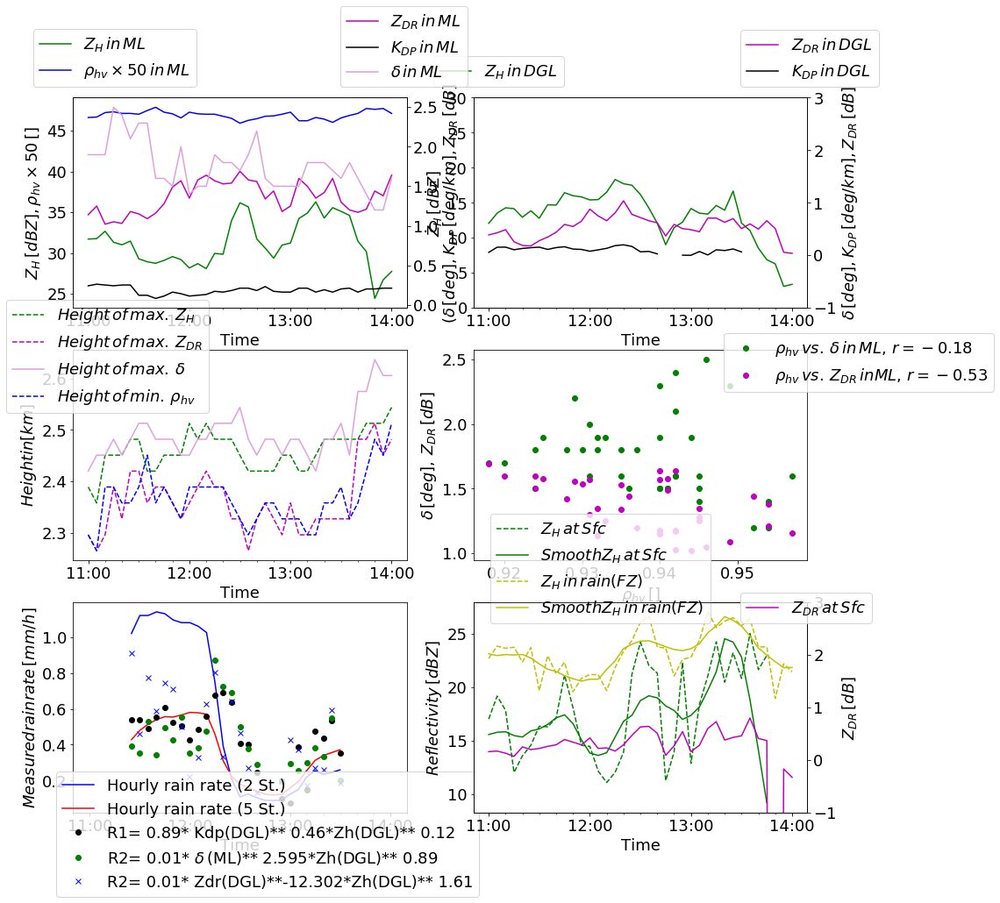

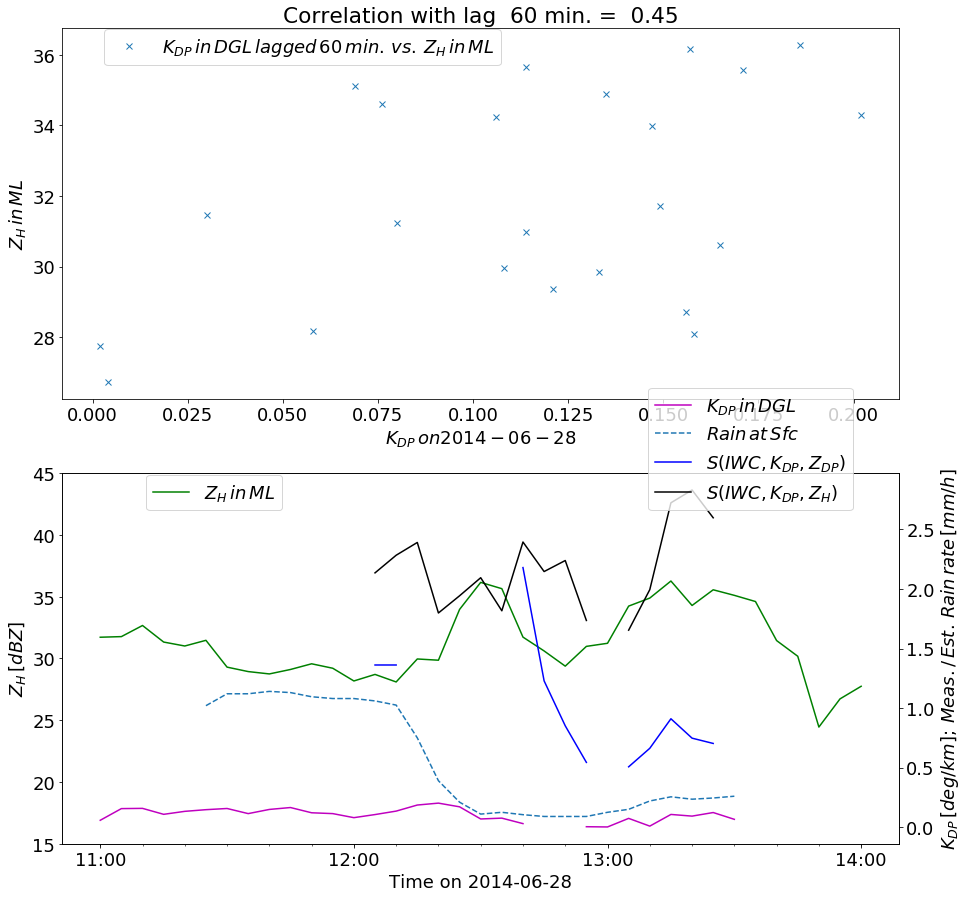

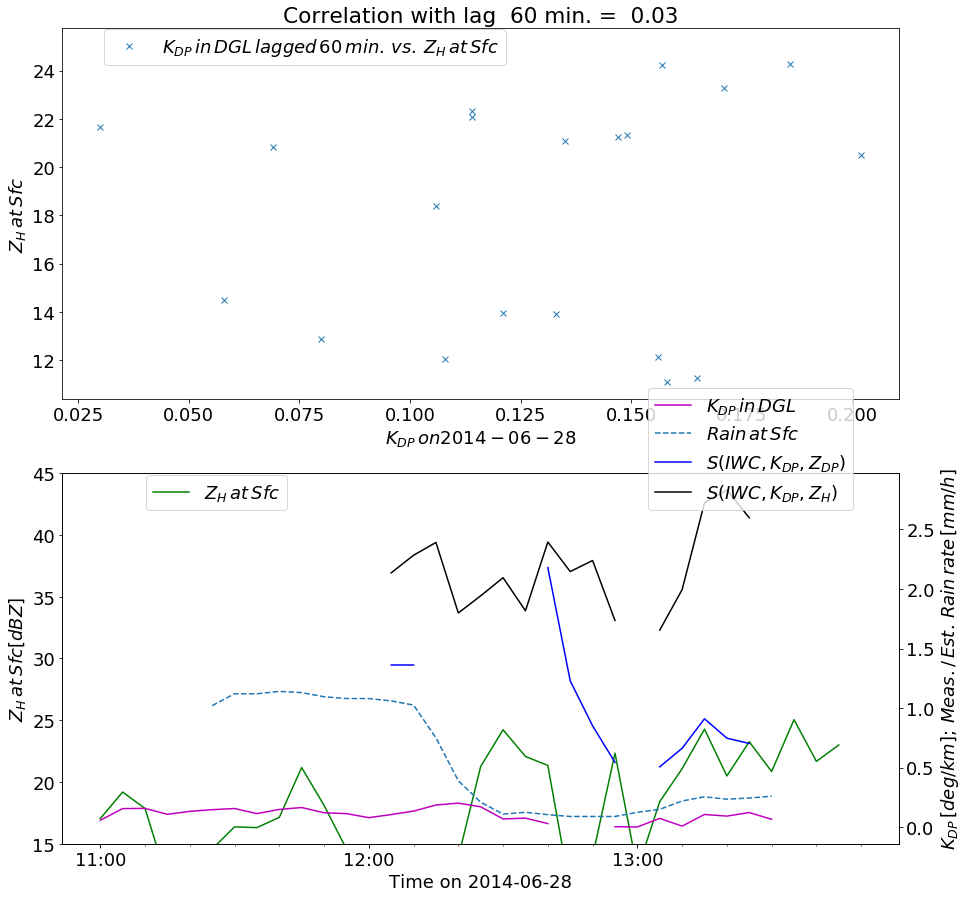

('vorher', -0.10764960953406054)
('p-value', 0.5855841809892213)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)


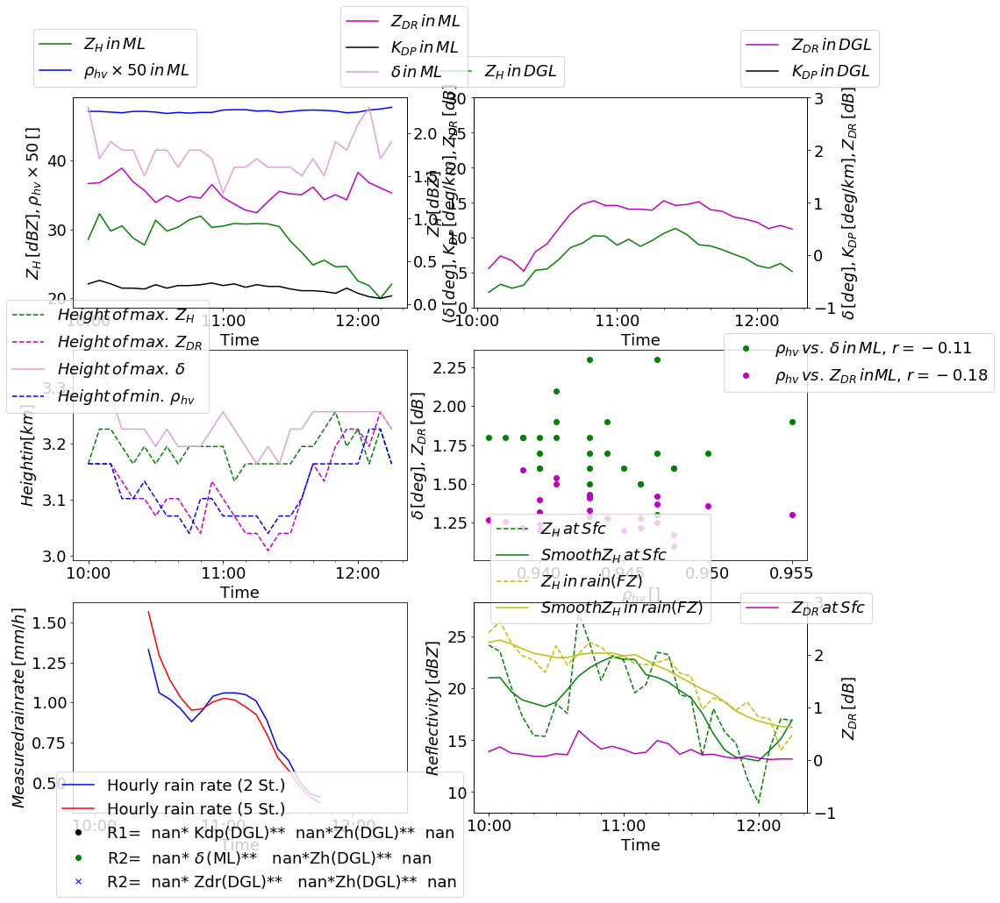

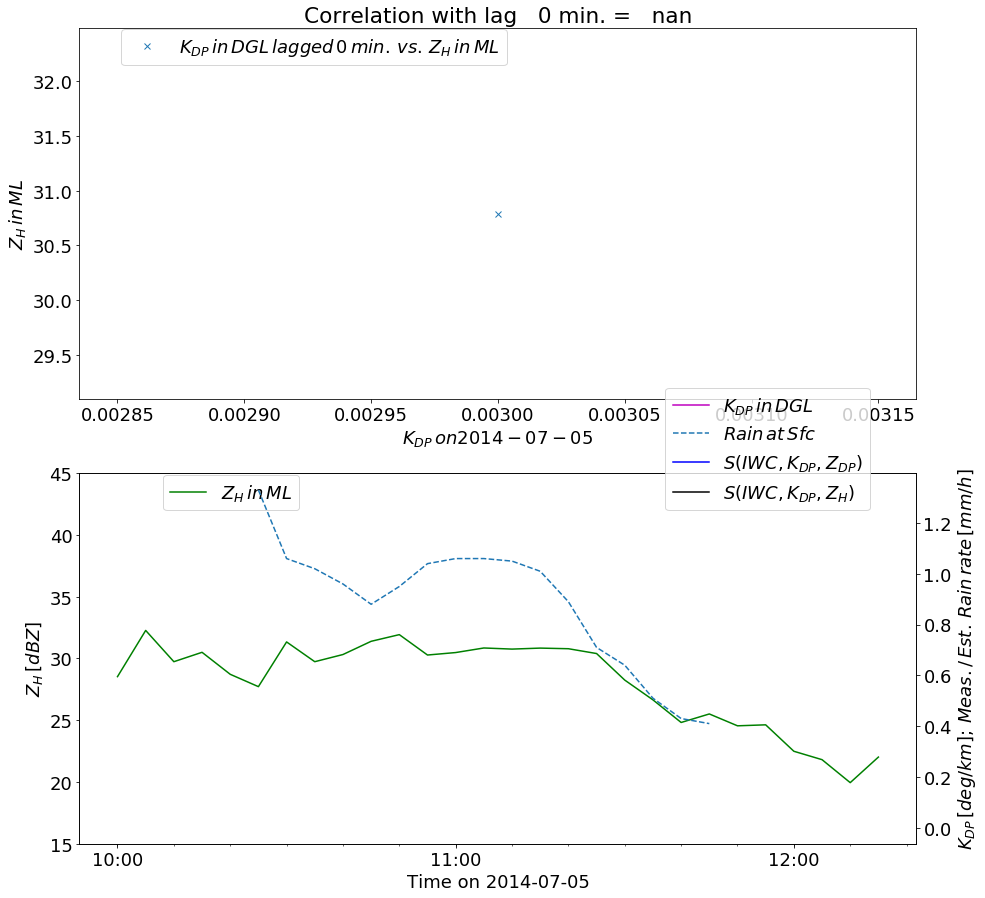

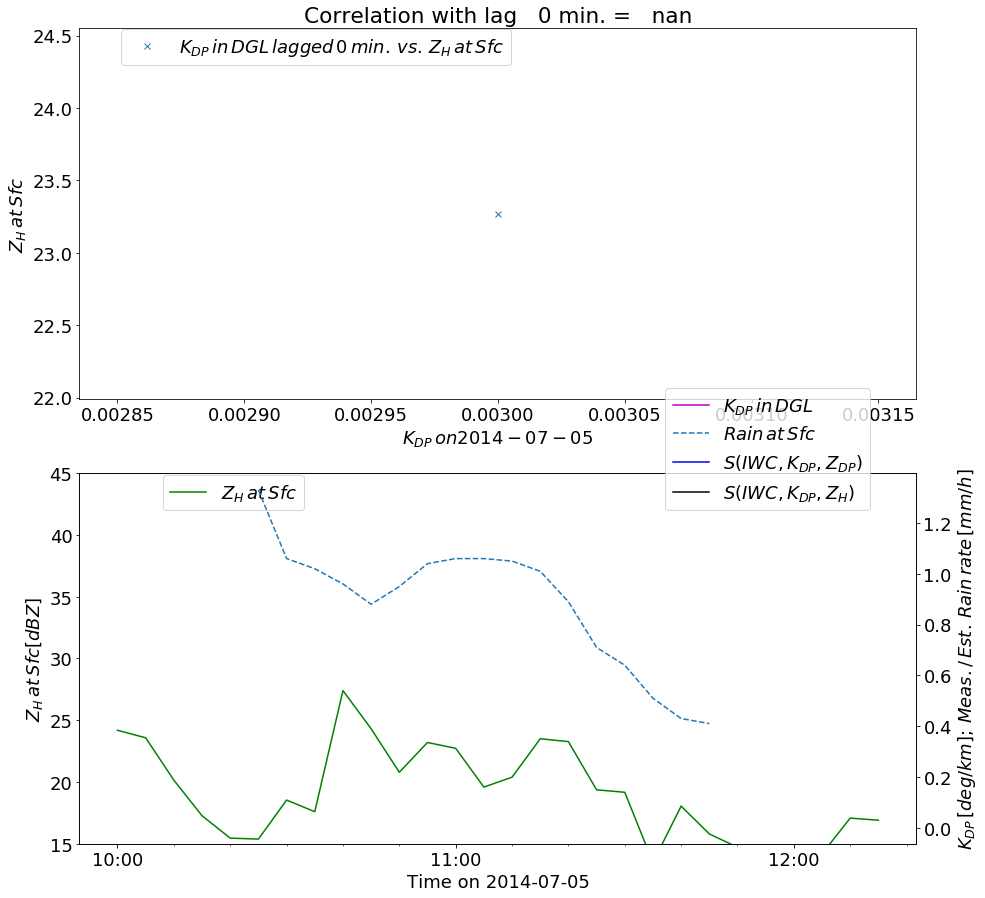

('vorher', -0.4450738511411507)
('p-value', 0.00036639950880171755)
('p-value', 0.9068965741870052)
('p-value', 0.40669512784193373)
('p-value', 0.018038253920238164)
('p-value', 0.006214828629376494)
('p-value', 0.0028085662028143185)
('p-value', 0.007069689945576266)
('p-value', 0.06849236767763835)
('p-value', 0.06945134735233936)
('p-value', 0.13885182784586336)
('p-value', 0.5632801056041414)
('p-value', 0.41586209095288673)
('p-value', 0.3202902348503858)
('p-value', 0.612677219706464)


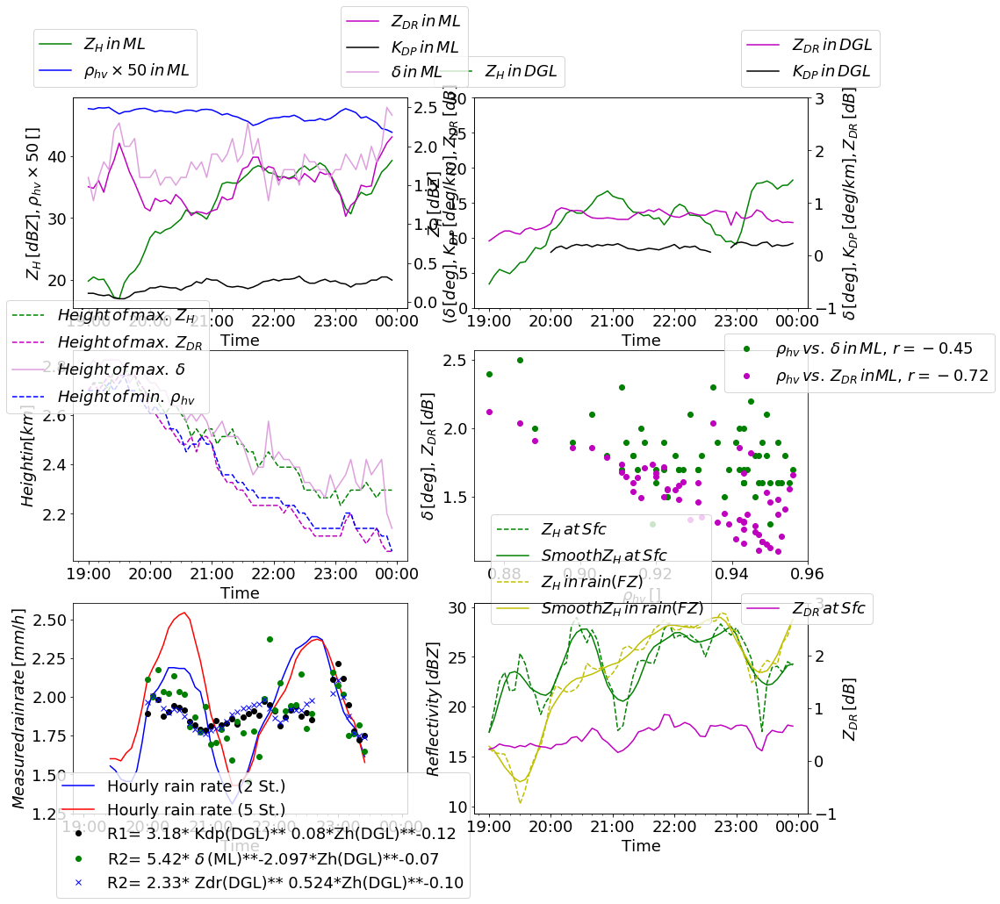

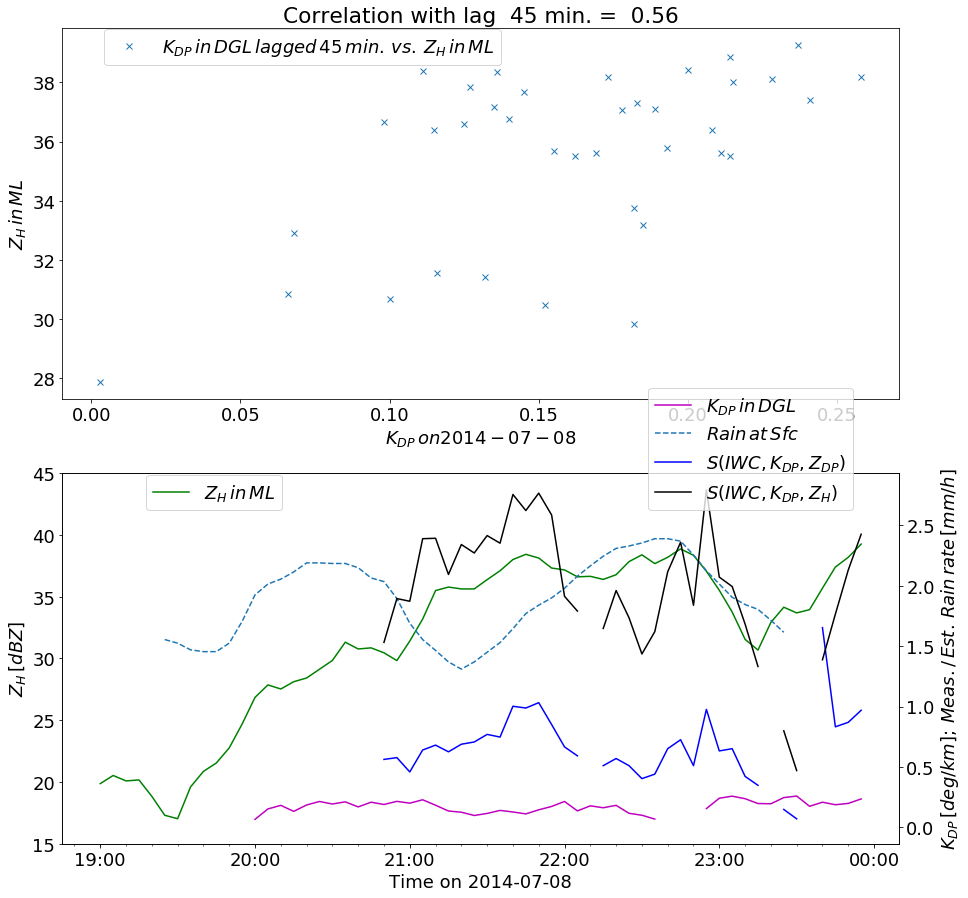

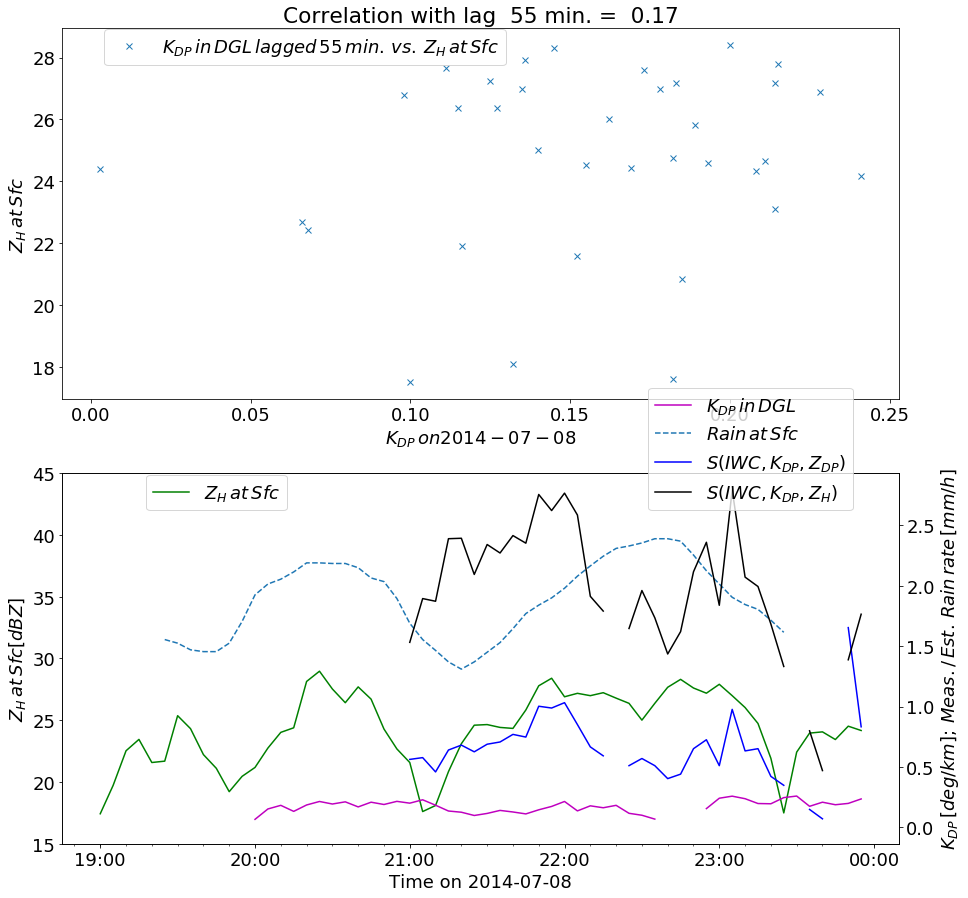

('vorher', -0.7571034339862645)
('p-value', 2.4246334330548352e-29)
('p-value', 2.8056580242969995e-05)
('p-value', 7.808893246674985e-06)
('p-value', 3.7909164617014734e-05)
('p-value', 0.00012476174093878527)
('p-value', 0.000708268880192007)
('p-value', 0.0075009907539100255)
('p-value', 0.017268426672141863)
('p-value', 0.02527856954056245)
('p-value', 0.05007357738544787)
('p-value', 0.07760924311116356)
('p-value', 0.022268883650491775)
('p-value', 0.038009213719109904)
('p-value', 0.06712499484233203)


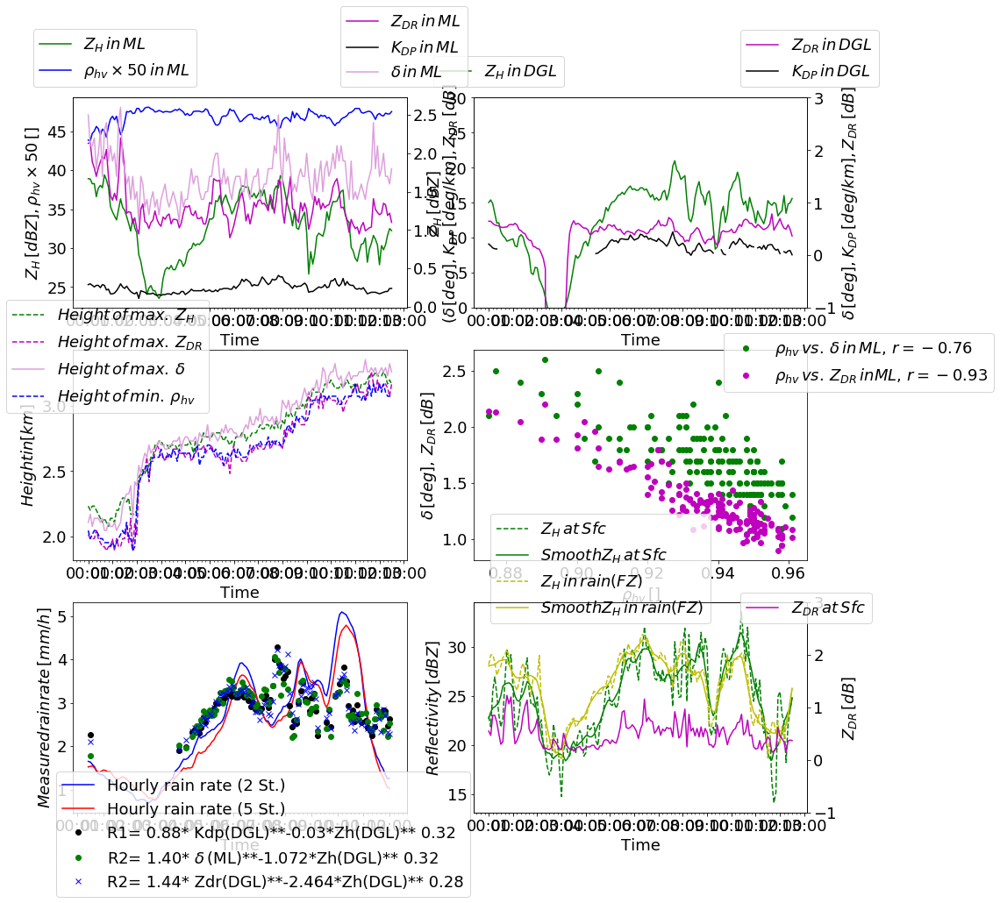

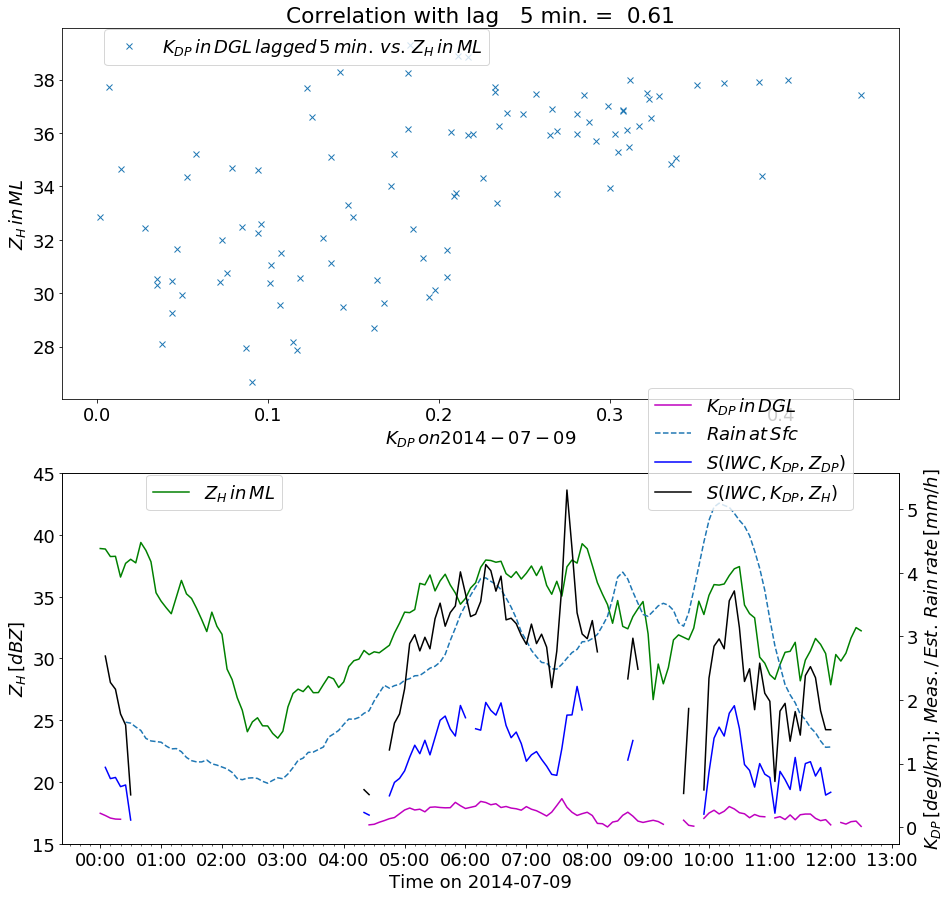

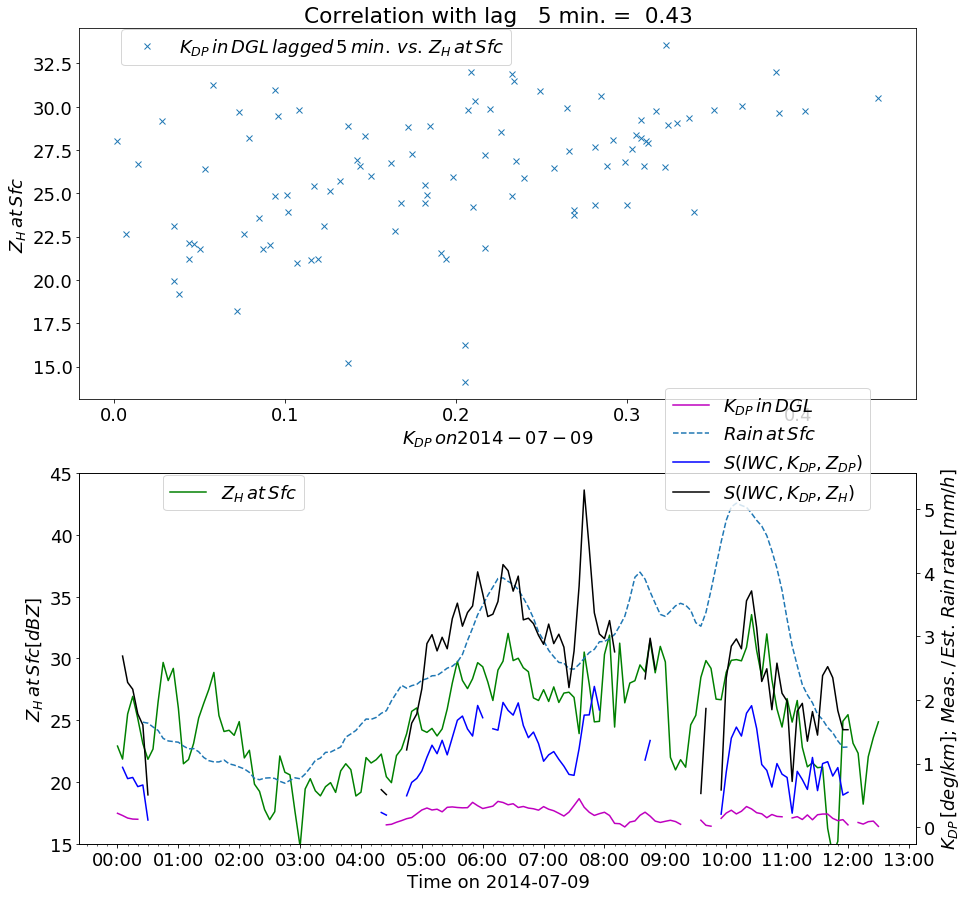

('vorher', -0.7682531947674892)
('p-value', 2.0659296202449225e-14)
('p-value', 2.0300869744851934e-06)
('p-value', 1.3105643326139556e-05)
('p-value', 0.0002283662568664503)
('p-value', 0.0001851318663617468)
('p-value', 0.0006620111653419178)
('p-value', 0.003067749460474173)
('p-value', 0.019193481339302525)
('p-value', 0.11574582124040331)
('p-value', 0.18700474722973026)
('p-value', 0.194288972328591)
('p-value', 0.5361316585256104)
('p-value', 0.5926089493963875)
('p-value', 0.4110664097298119)


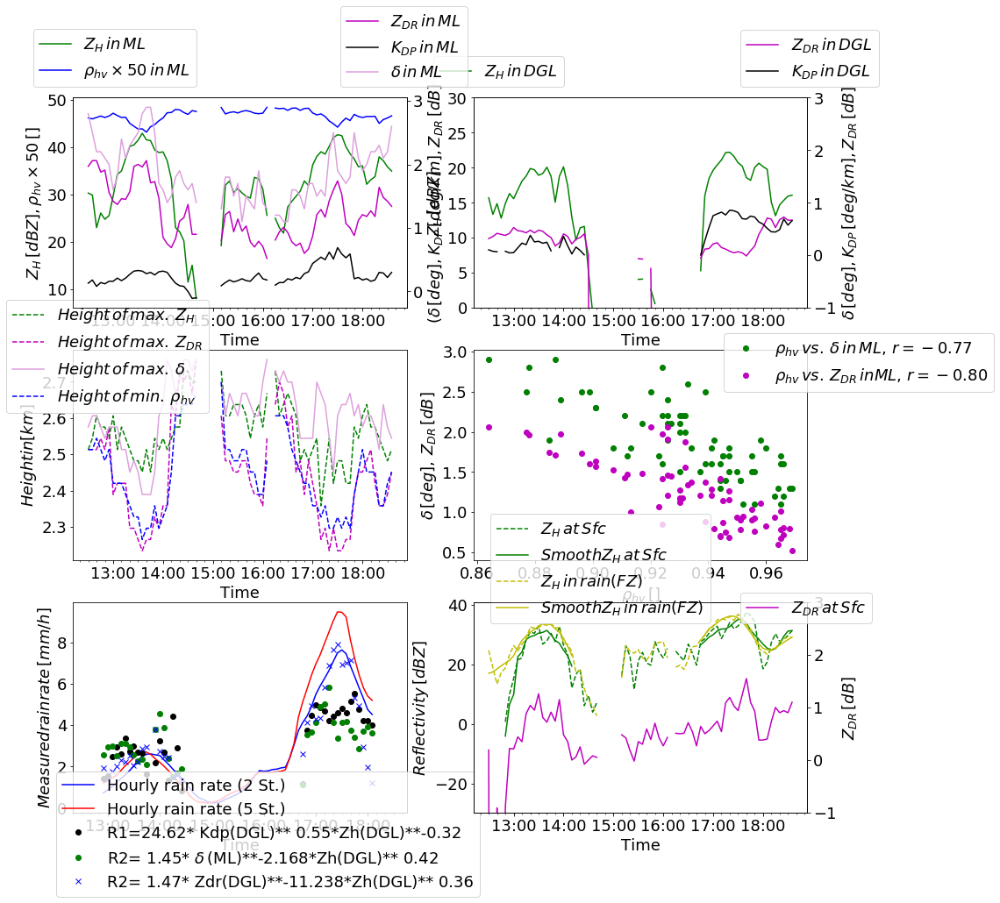

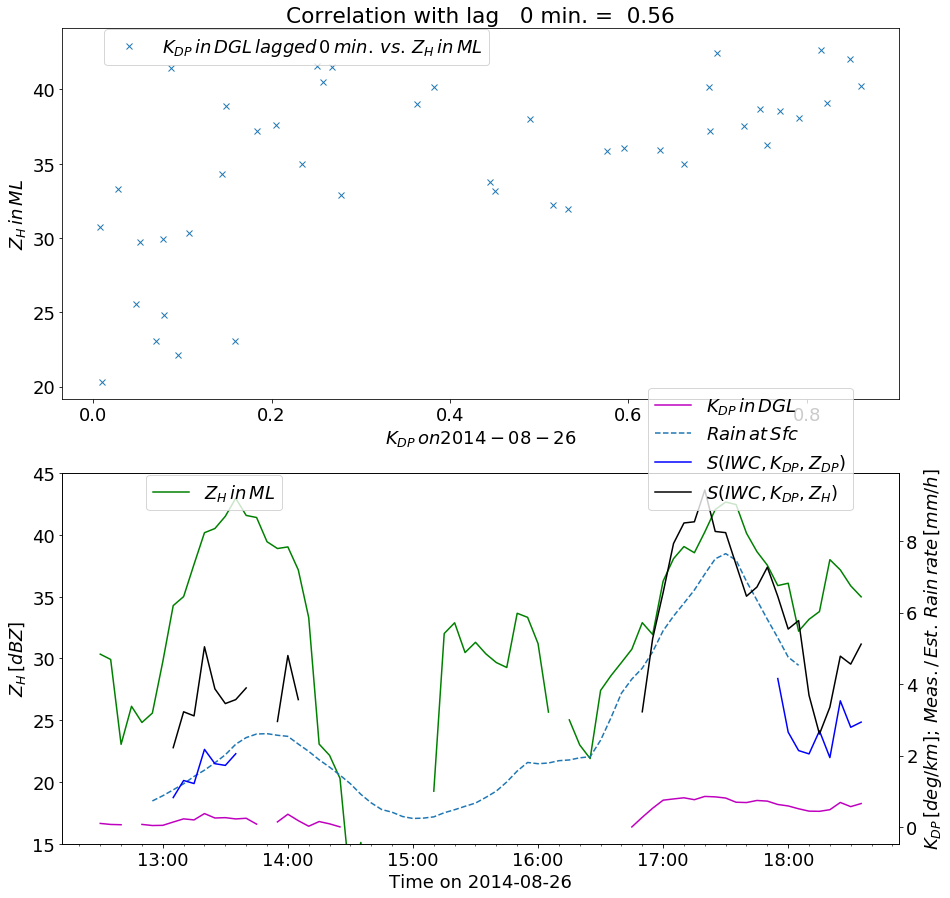

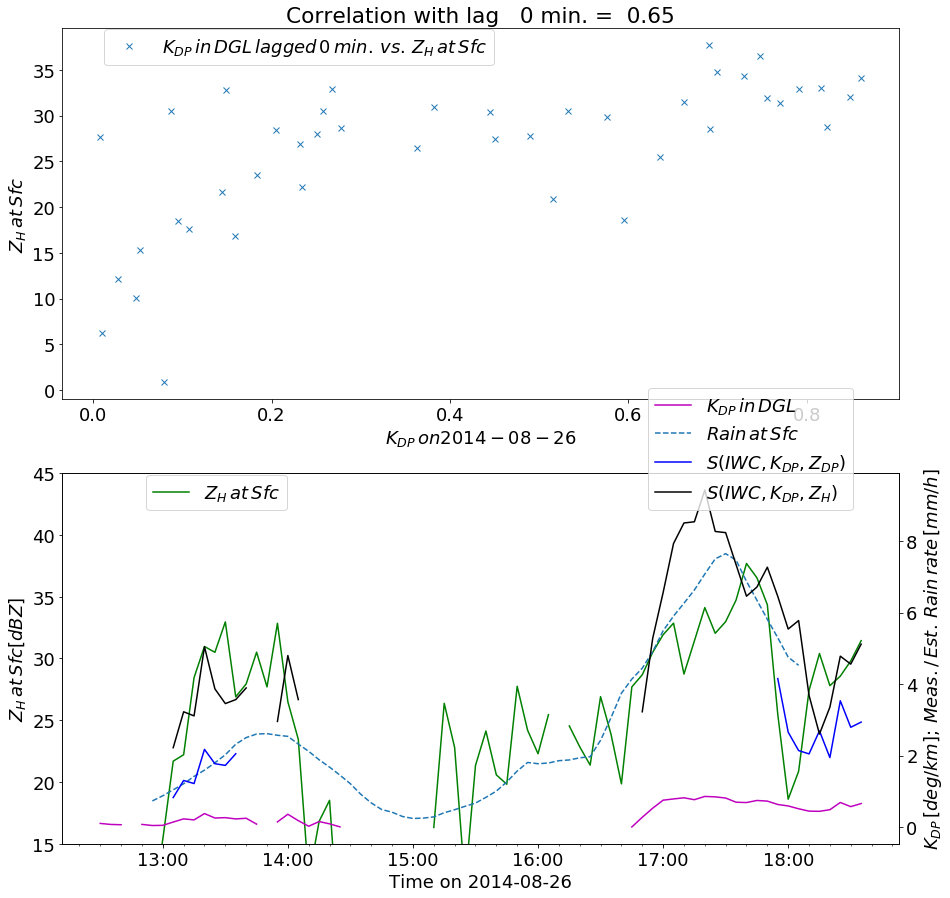

('vorher', -0.8806236363294171)
('p-value', 1.4957534153110615e-14)
('p-value', 3.071885726117468e-06)
('p-value', 1.3764240535365422e-06)
('p-value', 2.3236445789149206e-05)
('p-value', 0.0016927516739904647)
('p-value', 0.08630683736553332)
('p-value', 0.7019212132148607)
('p-value', 0.48657351461375886)
('p-value', 0.2356042649131607)
('p-value', 0.07535789247677119)
('p-value', 0.011372773296909692)
('p-value', 0.004722249167021723)
('p-value', 0.009318911212707028)
('p-value', 0.030654927360417705)


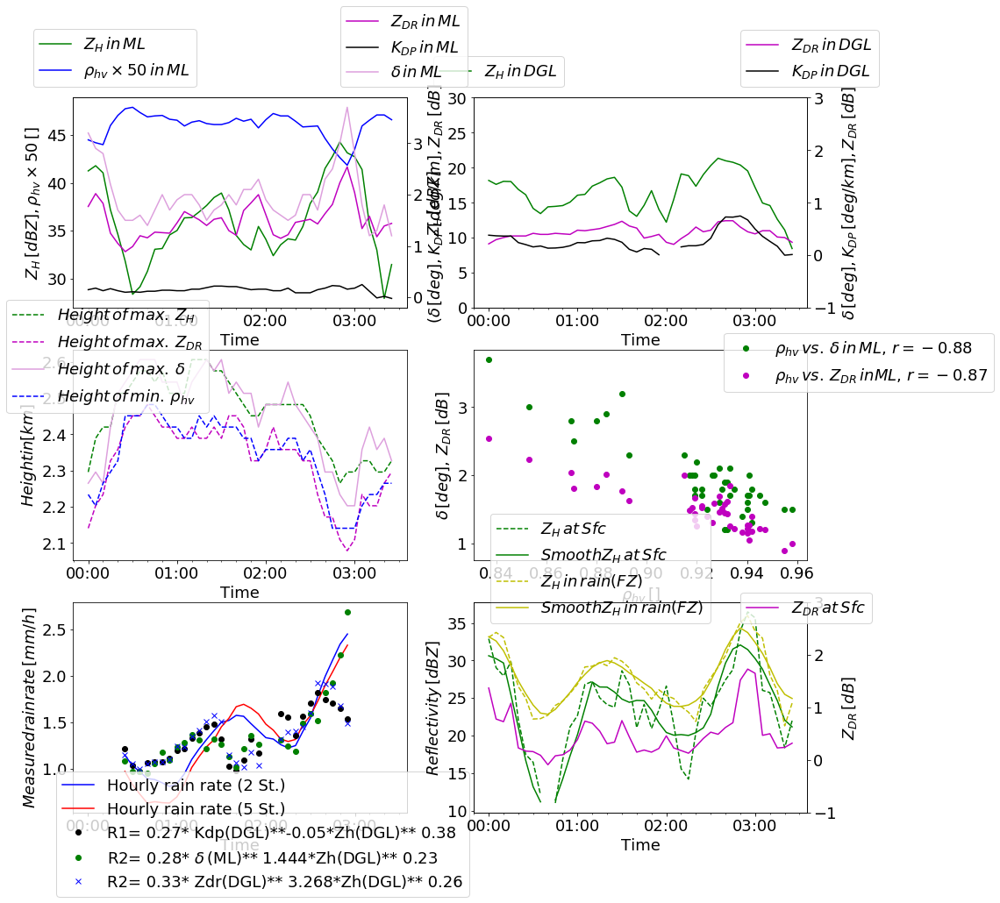

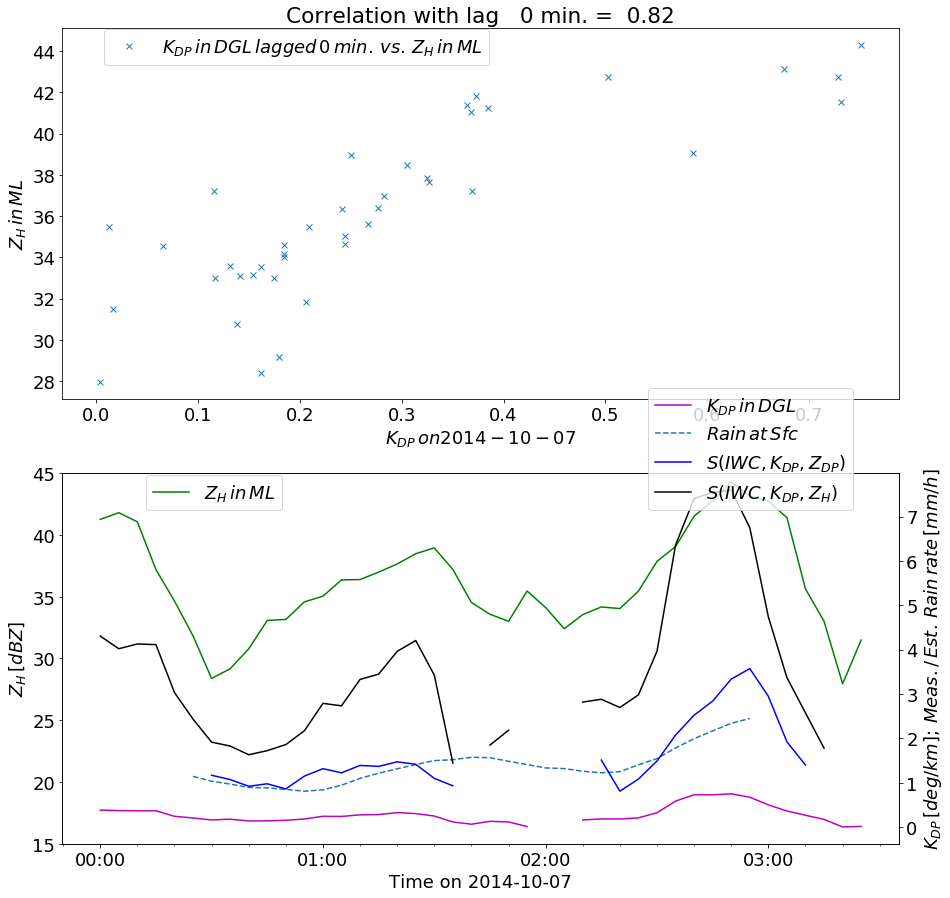

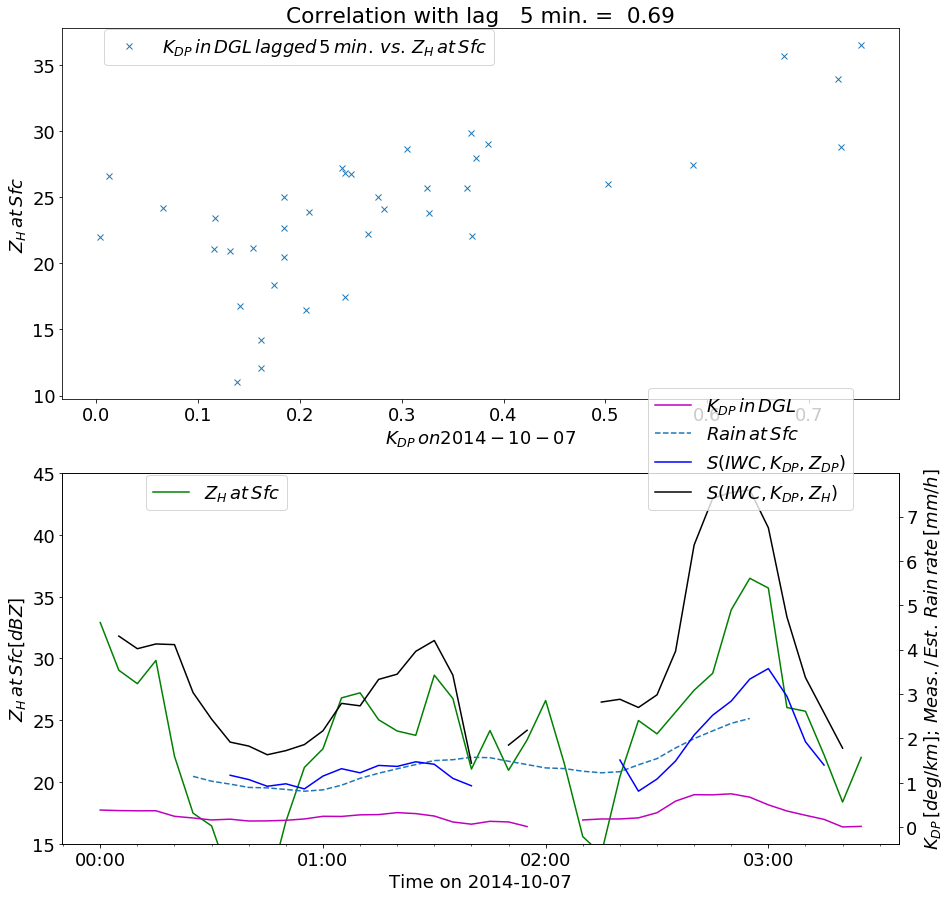

('vorher', -0.6695807816566891)
('p-value', 5.845457885511998e-06)
('p-value', 0.03762052155225529)
('p-value', 0.42299671145323403)
('p-value', 0.6299885463134111)
('p-value', 0.5687990964633292)
('p-value', 0.9663705458446759)
('p-value', 0.7837519385585681)
('p-value', 0.8263012335271318)
('p-value', 0.8411408112471326)
('p-value', 0.2322957163586709)
('p-value', 0.34912001145494453)
('p-value', 0.5310137401544377)
('p-value', 0.4317276528195376)
('p-value', 0.25360451226094)


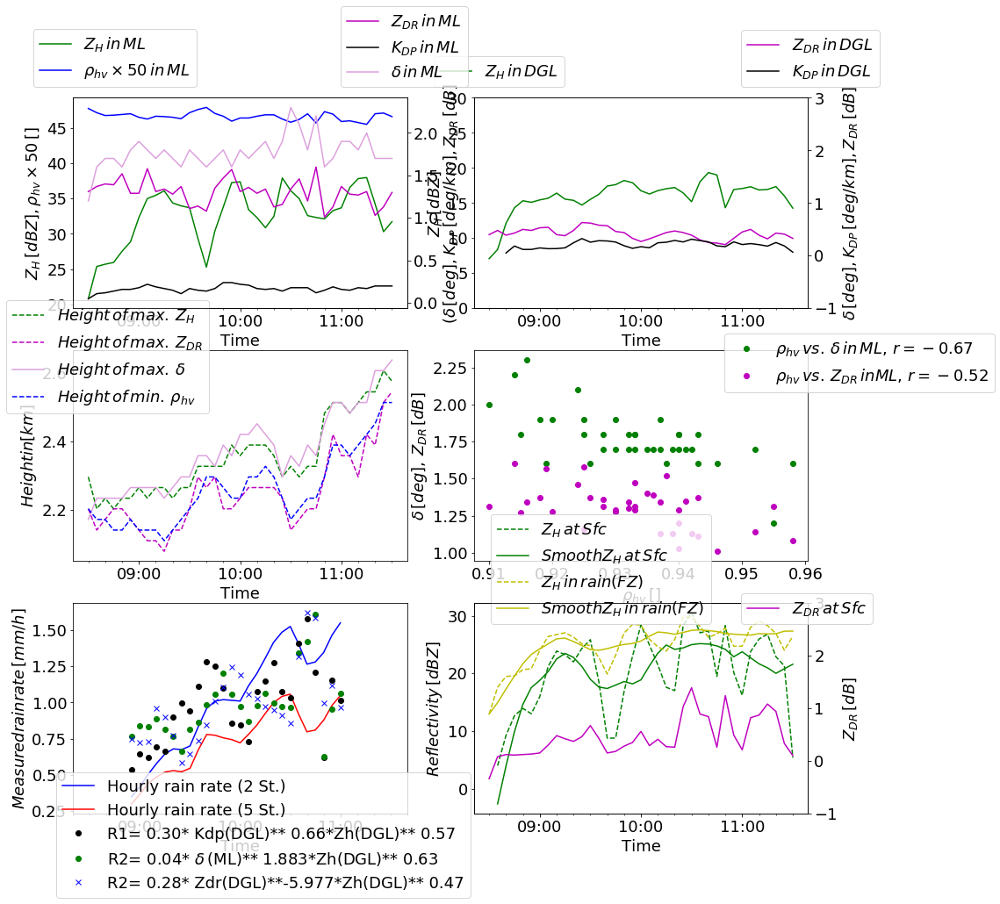

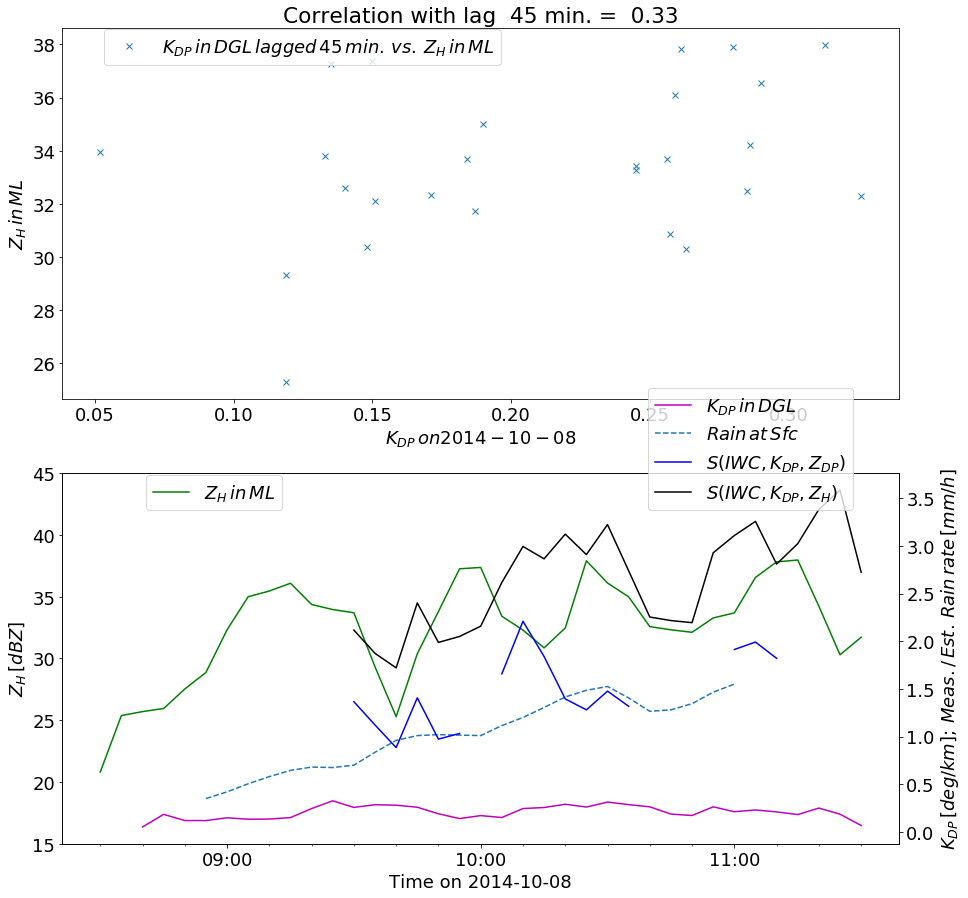

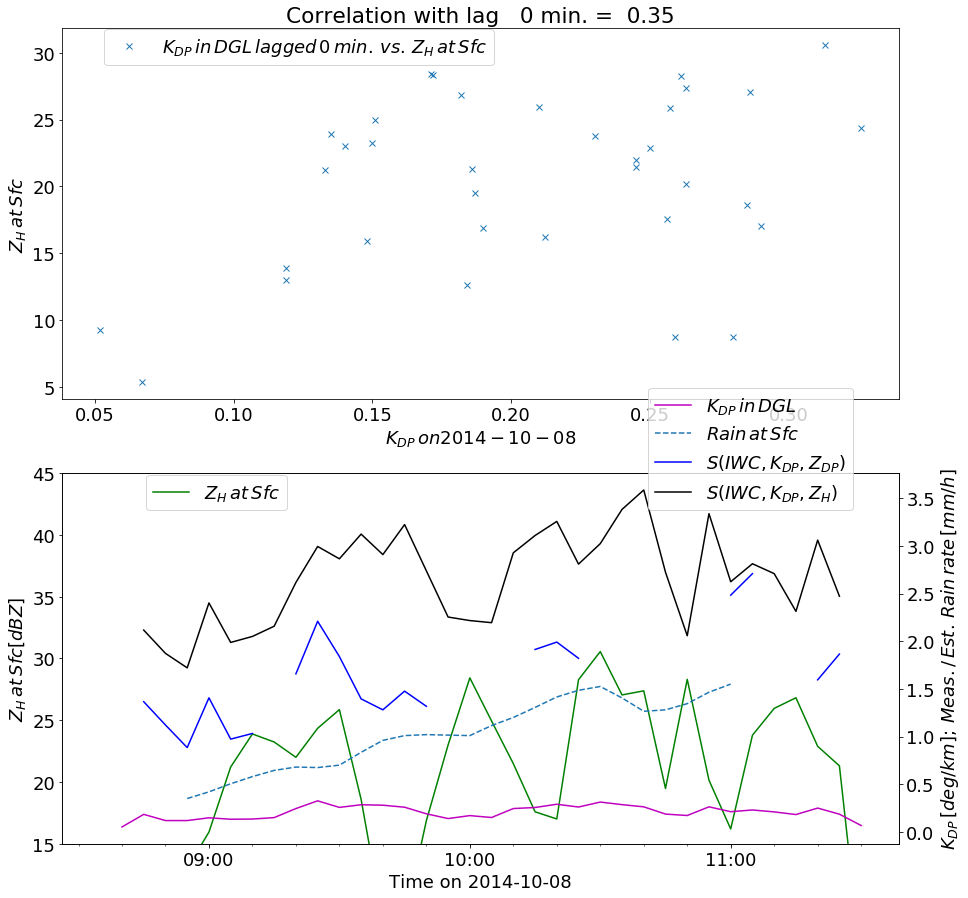

('vorher', -0.3810912211541817)
('p-value', 0.060170713485067175)
('p-value', 0.5813072254670066)
('p-value', 0.464150164146675)
('p-value', 0.5604773762459272)
('p-value', 0.5614221832382758)
('p-value', 0.5866688535752733)
('p-value', 0.9788876537887496)
('p-value', 0.49205297862083697)
('p-value', 0.5243621475690795)
('p-value', 0.7323293449707944)
('p-value', 0.5283289358035245)
('p-value', 0.1720409942242874)
('p-value', 0.061162047296335086)
('p-value', 0.9850933950662658)


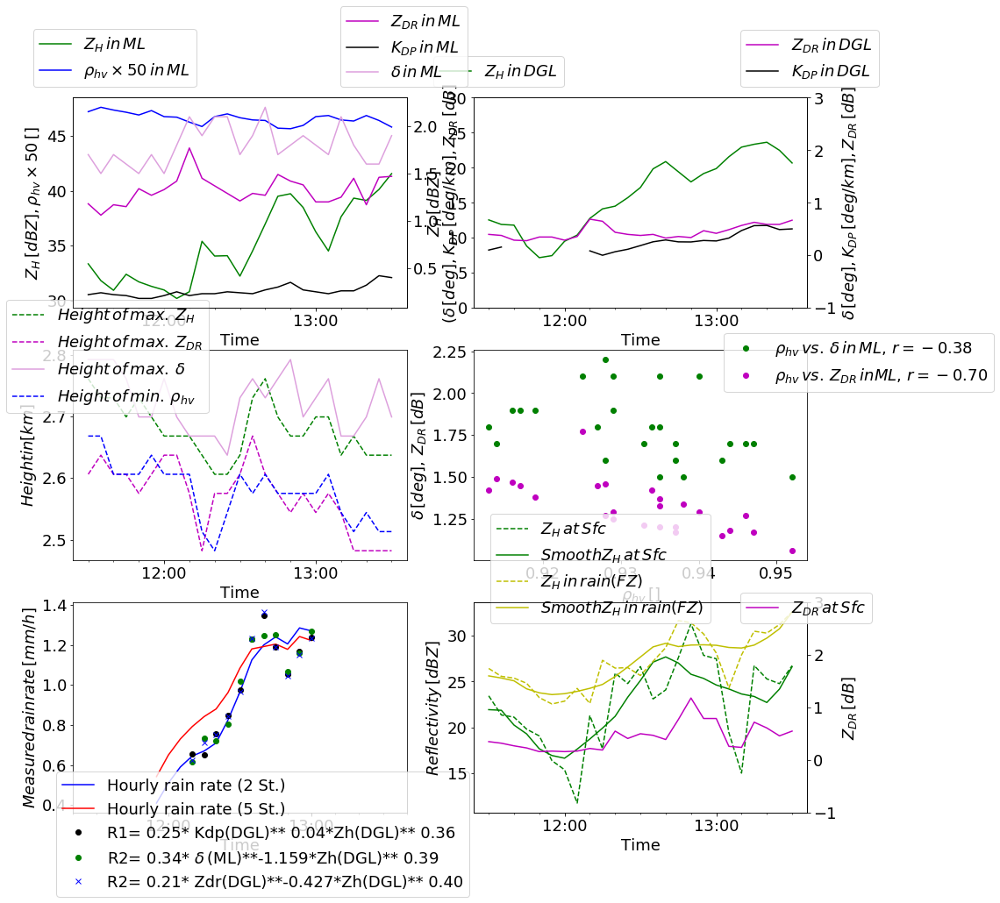

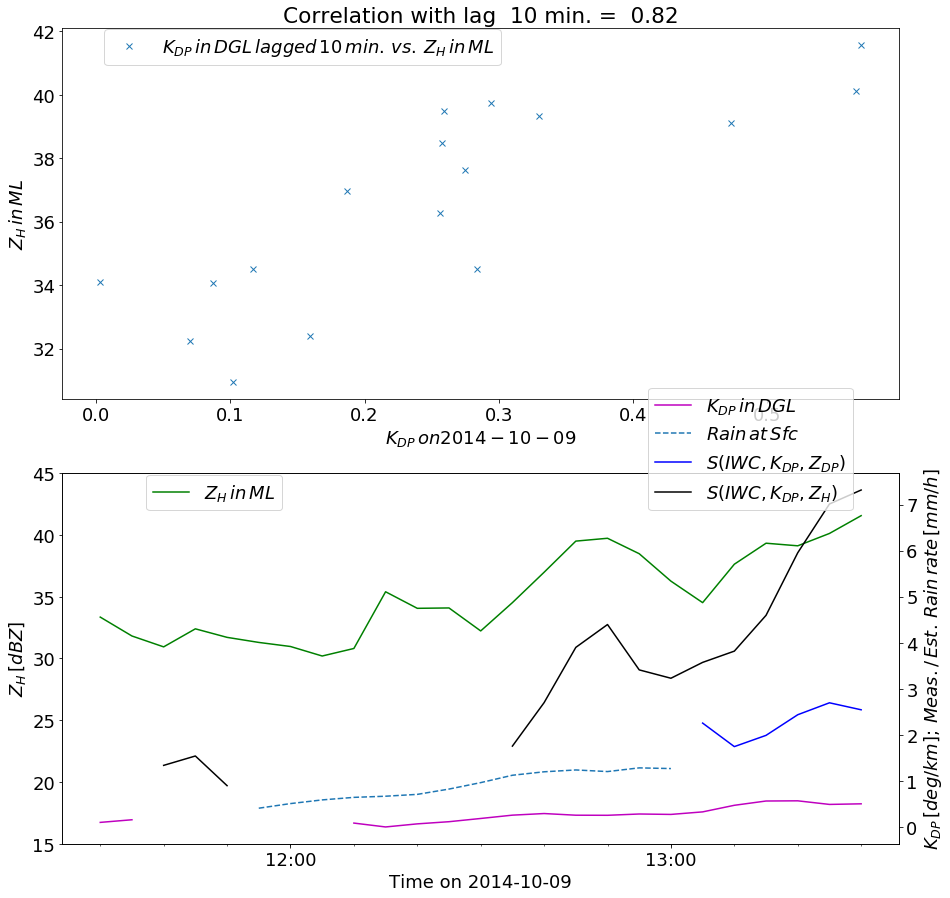

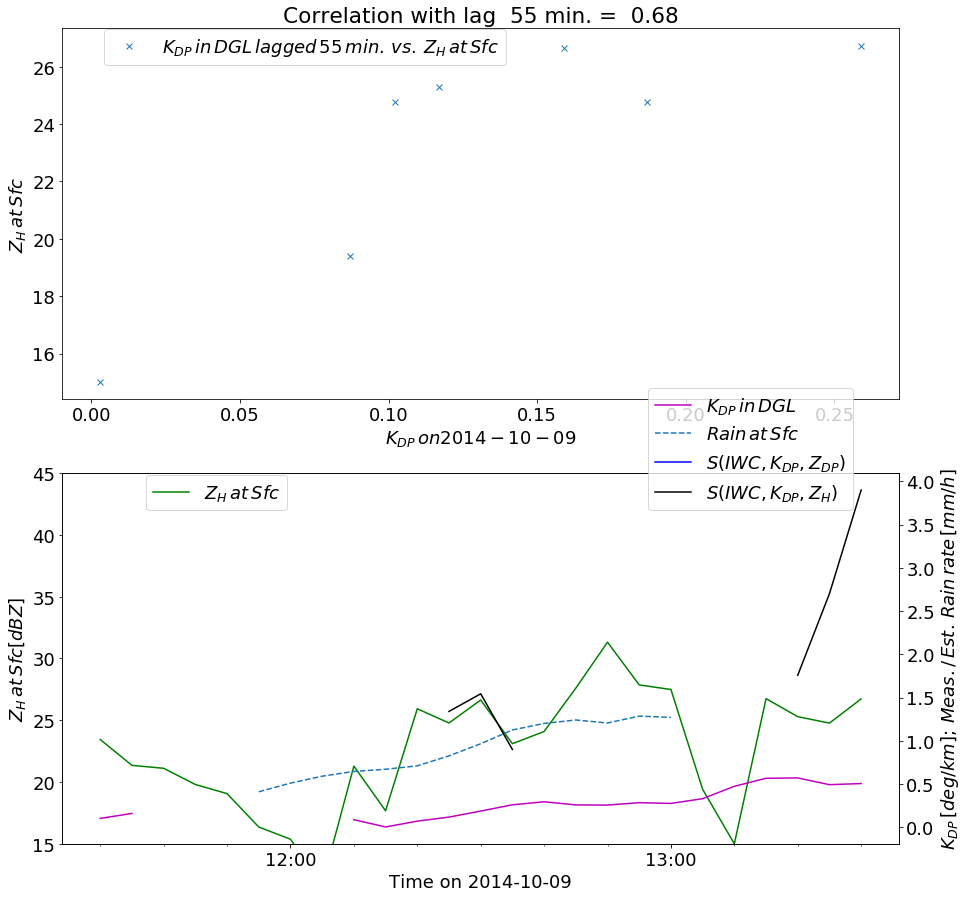

('vorher', -0.9221529382035614)
('p-value', 6.577370788296906e-14)
('p-value', 0.4899036594697553)
('p-value', 0.6098879840861894)
('p-value', 0.7757658061206738)
('p-value', 0.7911114354035813)
('p-value', 0.3256308162940525)
('p-value', 0.2726204803858817)
('p-value', 0.16606623477541543)
('p-value', 0.43949163309970857)
('p-value', 0.9049394795365096)
('p-value', 0.8760643351645877)
('p-value', 0.5604019821410746)
('p-value', 0.524014064040861)
('p-value', 0.18877687904314694)


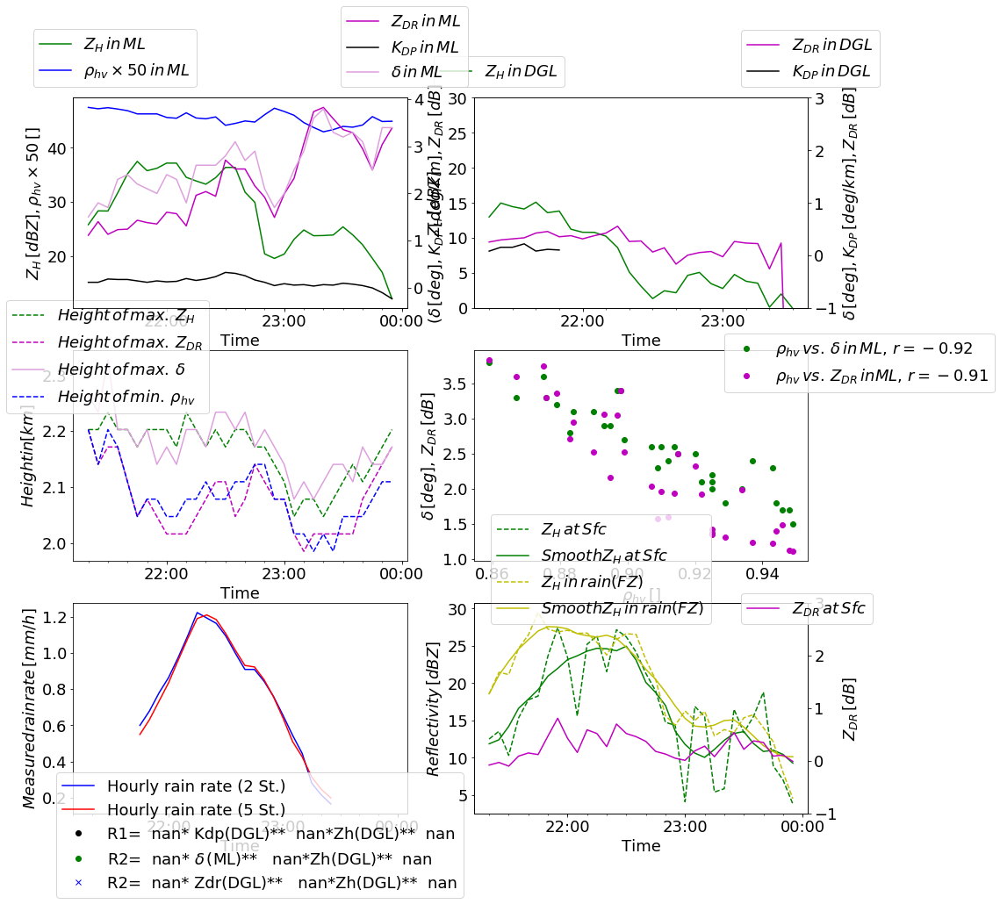

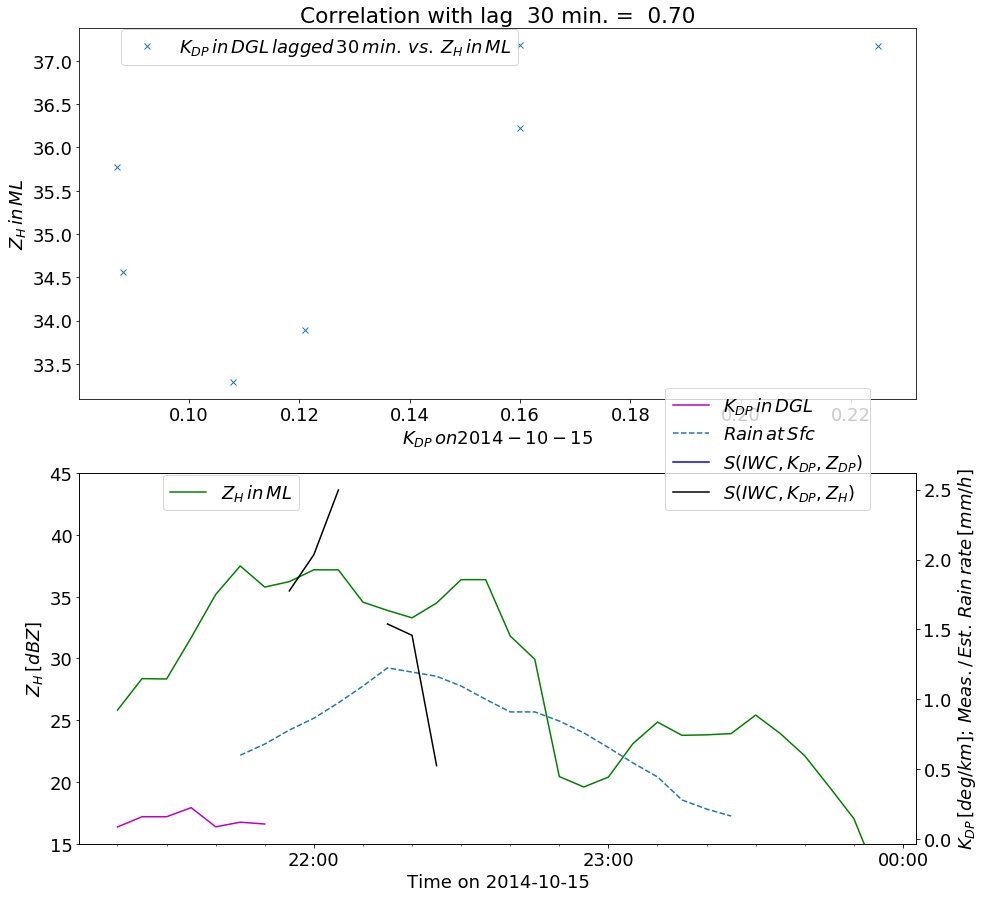

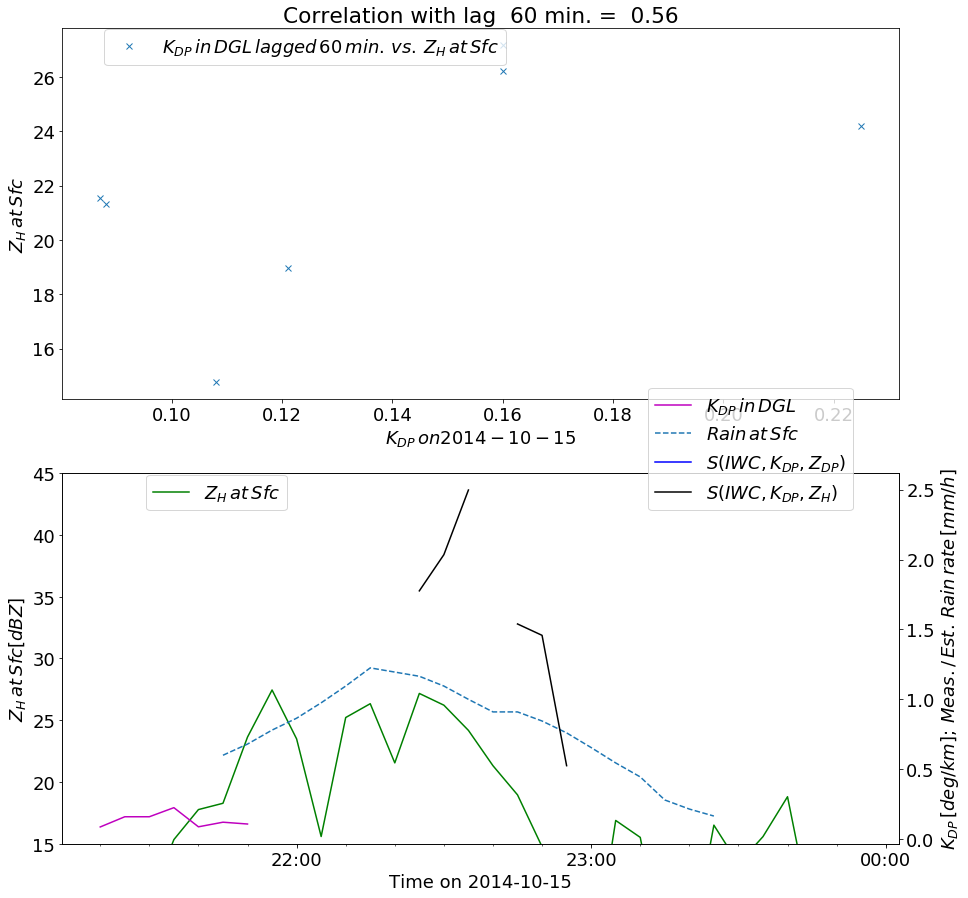

('vorher', -0.5083150137160067)
('p-value', 4.208683934534505e-10)
('p-value', 0.004595202746101227)
('p-value', 0.01852022582880831)
('p-value', 0.01535326582810133)
('p-value', 0.009945551046097411)
('p-value', 0.009848334372087316)
('p-value', 0.003427871807485874)
('p-value', 0.0018785034749801597)
('p-value', 0.002693348915754072)
('p-value', 0.044725939748372724)
('p-value', 0.34139915645290186)
('p-value', 0.8923745109283434)
('p-value', 0.36163540720377263)
('p-value', 0.2235225652715275)


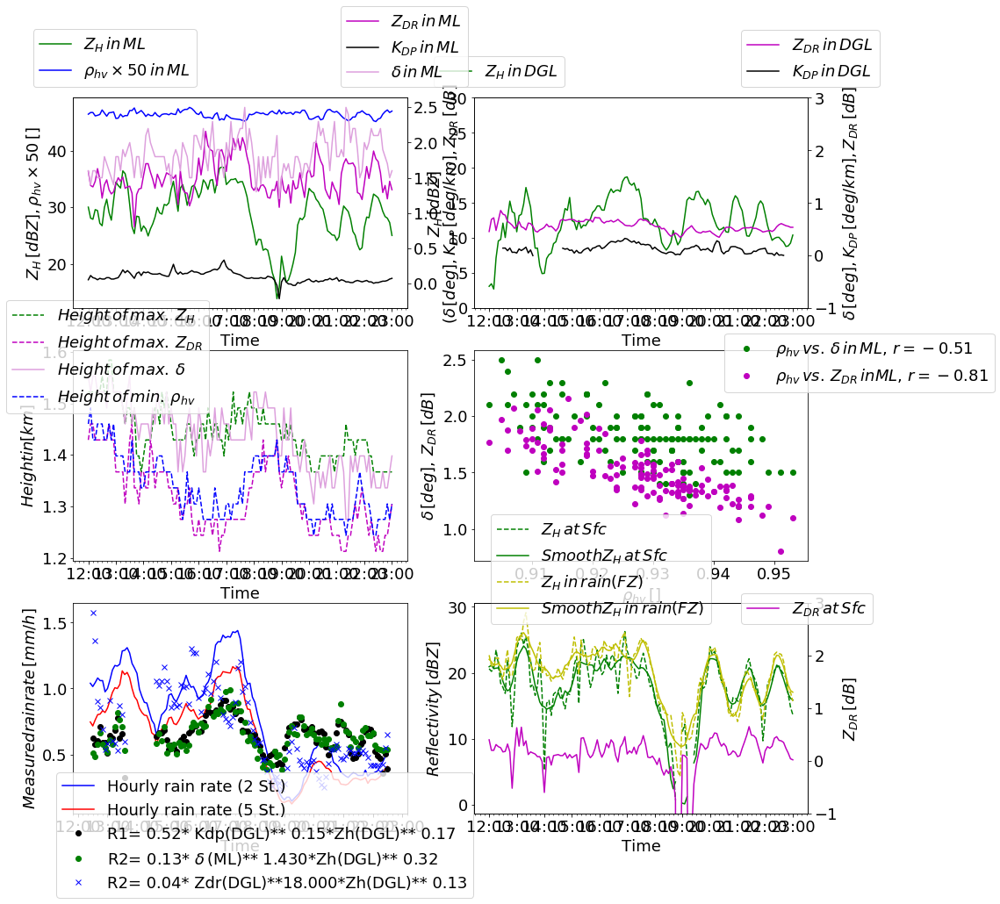

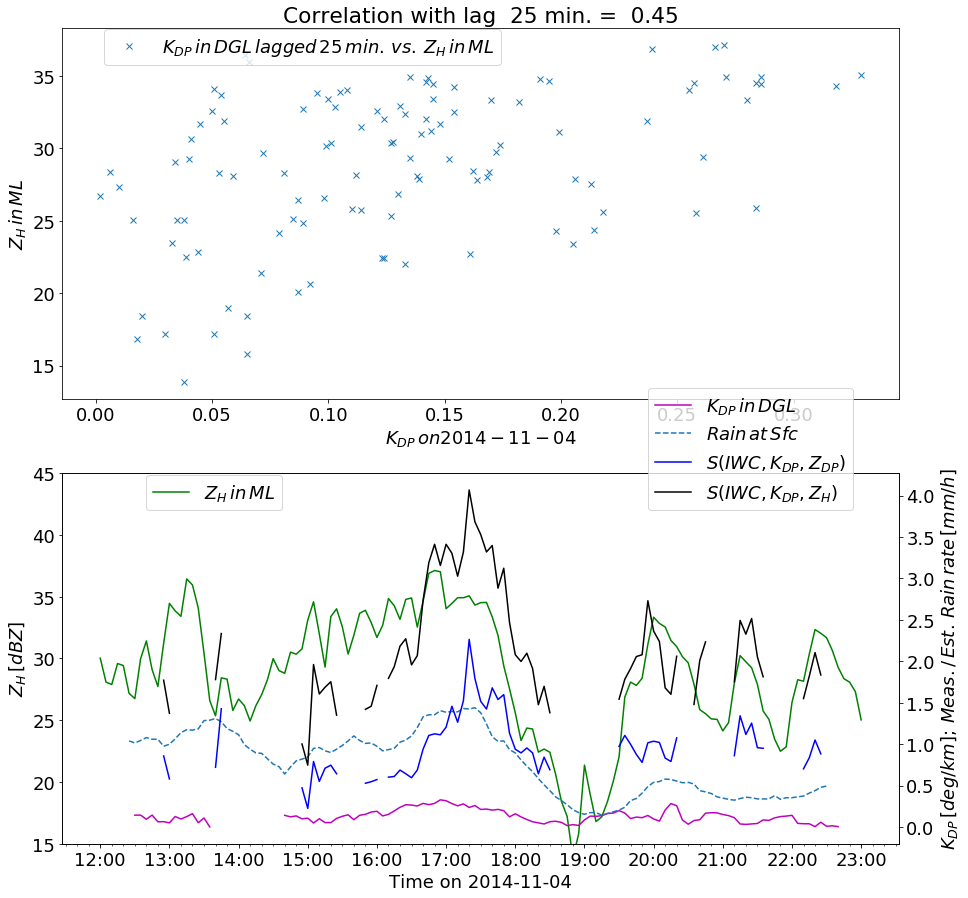

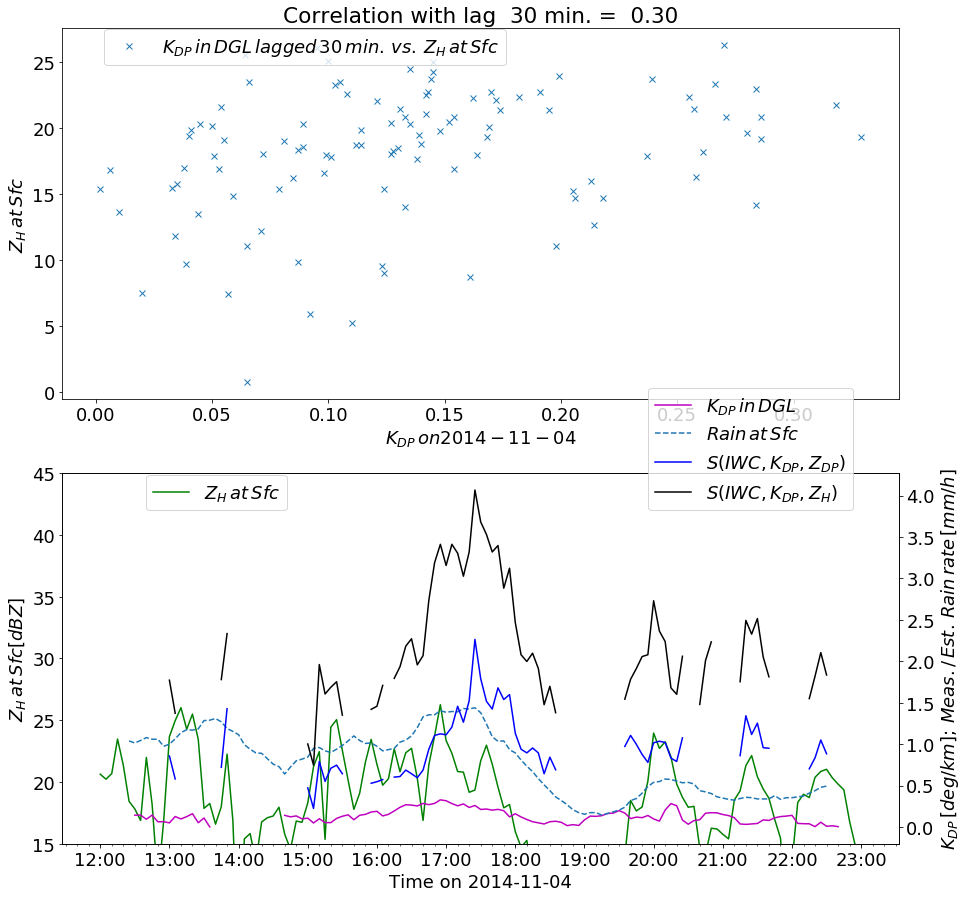

('vorher', -0.7721384591159864)
('p-value', 5.108889416250479e-12)
('p-value', 0.11377839858596937)
('p-value', 0.12123583706427421)
('p-value', 0.1422709906310703)
('p-value', 0.12892174744563056)
('p-value', 0.47343233447414135)
('p-value', 0.7945888591677209)
('p-value', 0.740283774456792)
('p-value', 0.9377367341472681)
('p-value', 0.7594837810061921)
('p-value', 0.9304662983469457)
('p-value', 0.6158066877551023)
('p-value', 0.47411045776605276)
('p-value', 0.2764686104033397)


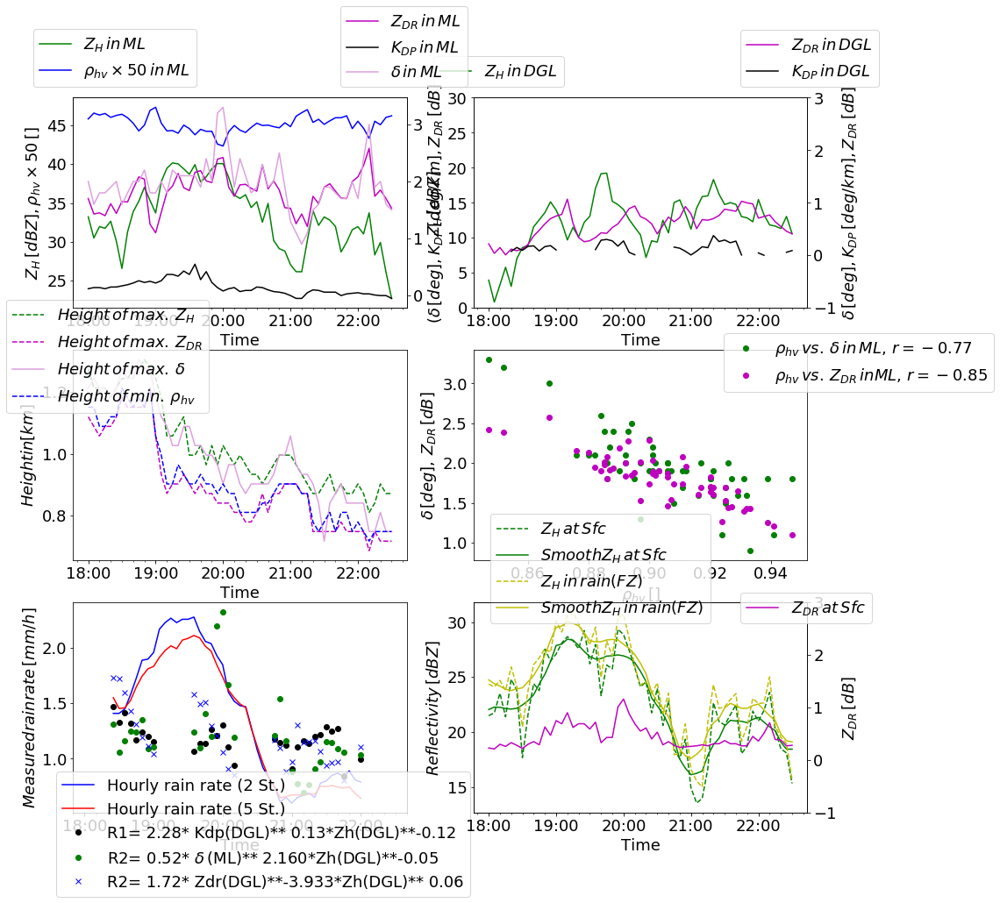

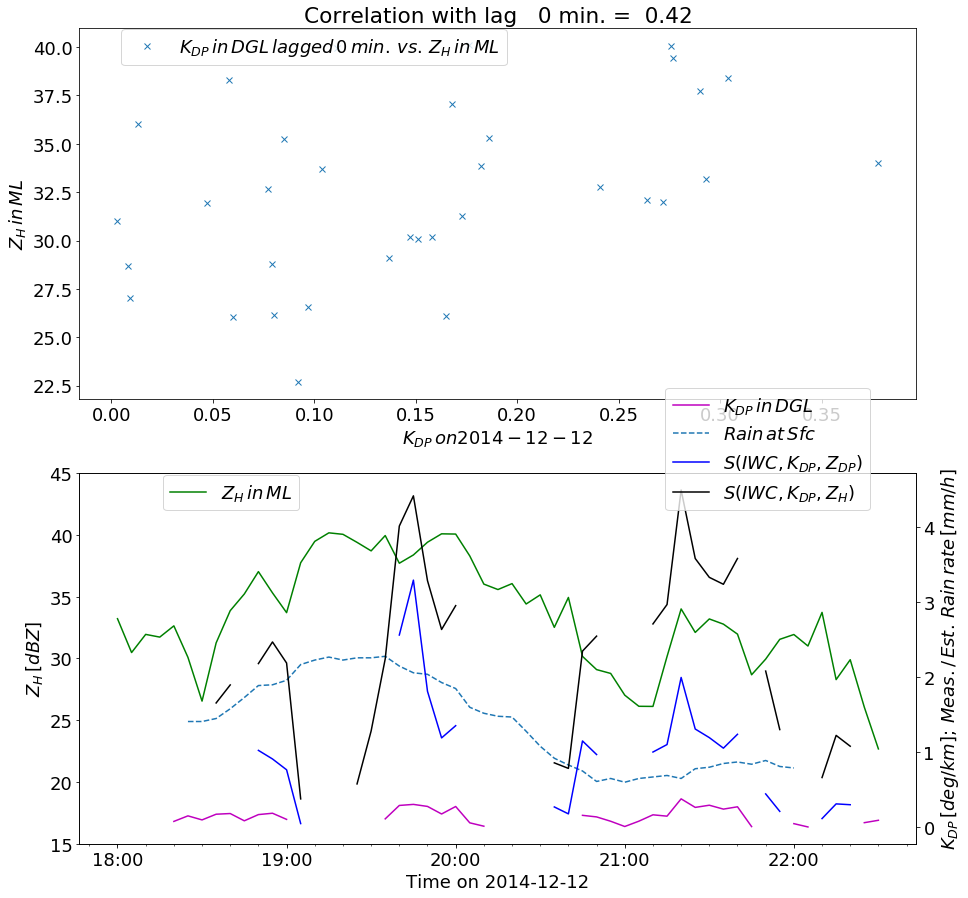

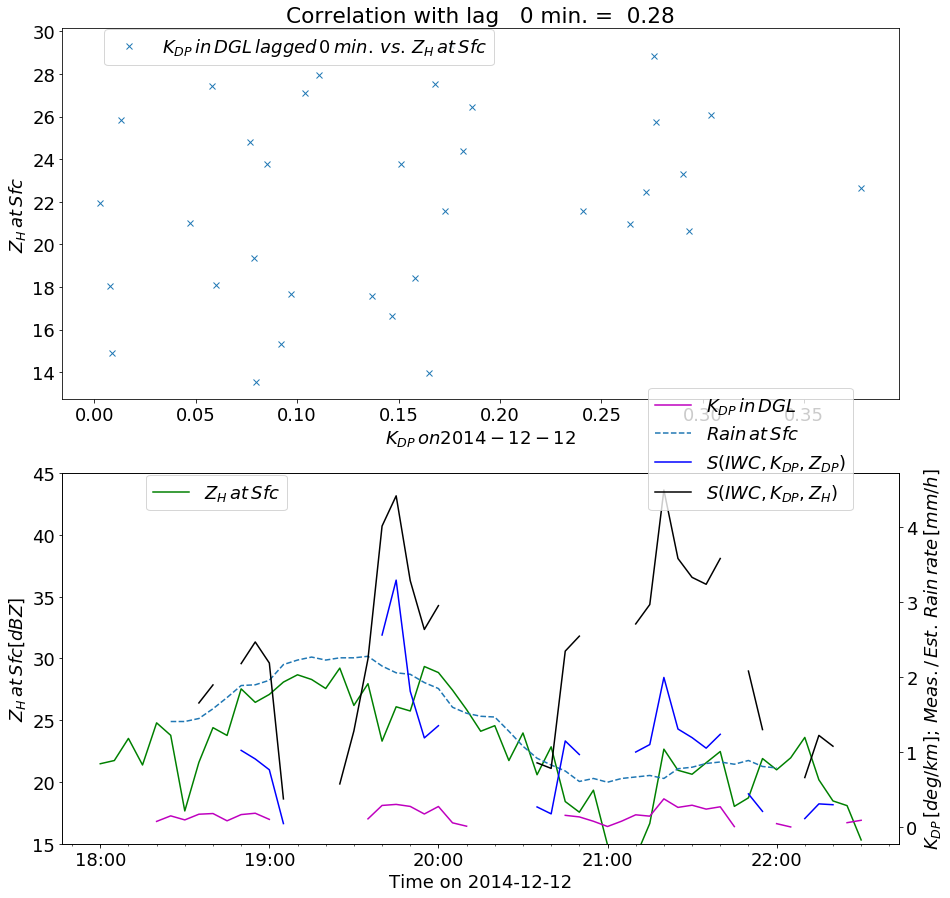

('vorher', -0.4922729455513706)
('p-value', 3.0609848120671436e-08)
('p-value', 0.00017312835432857789)
('p-value', 1.4268289336476546e-06)
('p-value', 3.454188755609891e-08)
('p-value', 3.551541982223013e-09)
('p-value', 1.0132577375359133e-09)
('p-value', 2.2503588939249762e-10)
('p-value', 3.017257016777927e-10)
('p-value', 7.309127223758988e-10)
('p-value', 4.529315433906957e-10)
('p-value', 5.458580381426831e-09)
('p-value', 9.436881717828285e-07)
('p-value', 3.061845655423471e-05)
('p-value', 0.0002989539246871383)


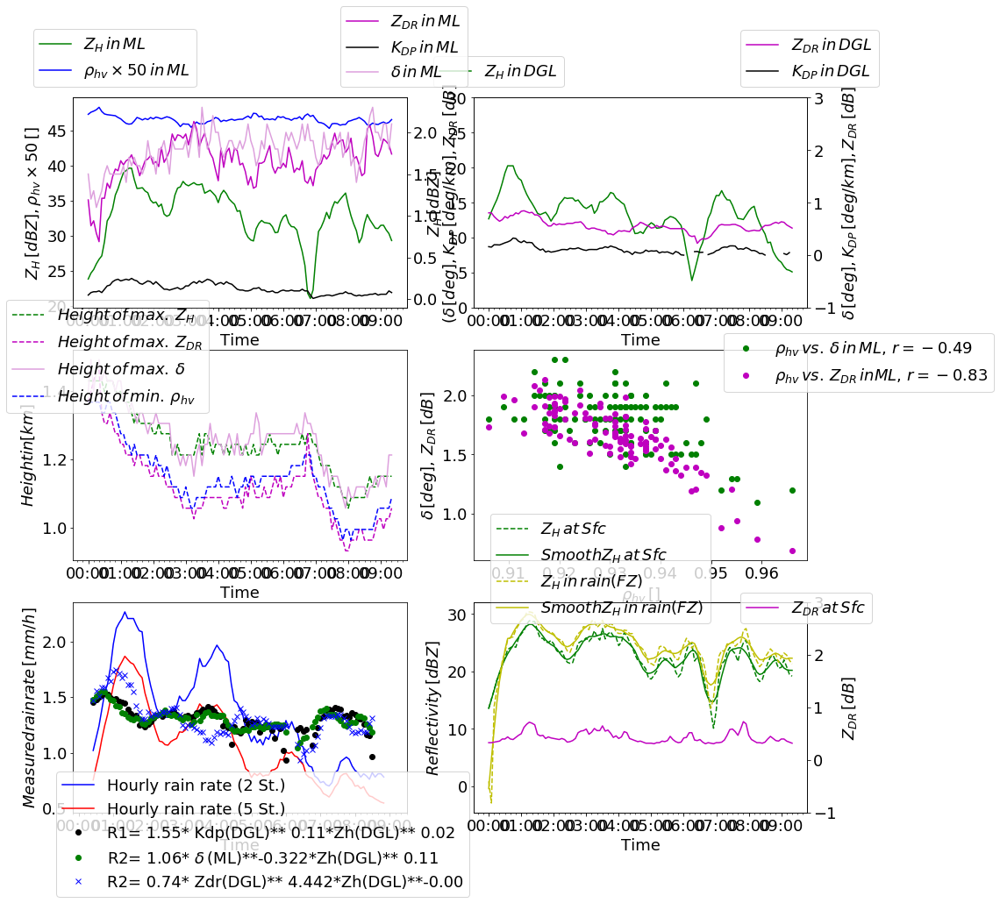

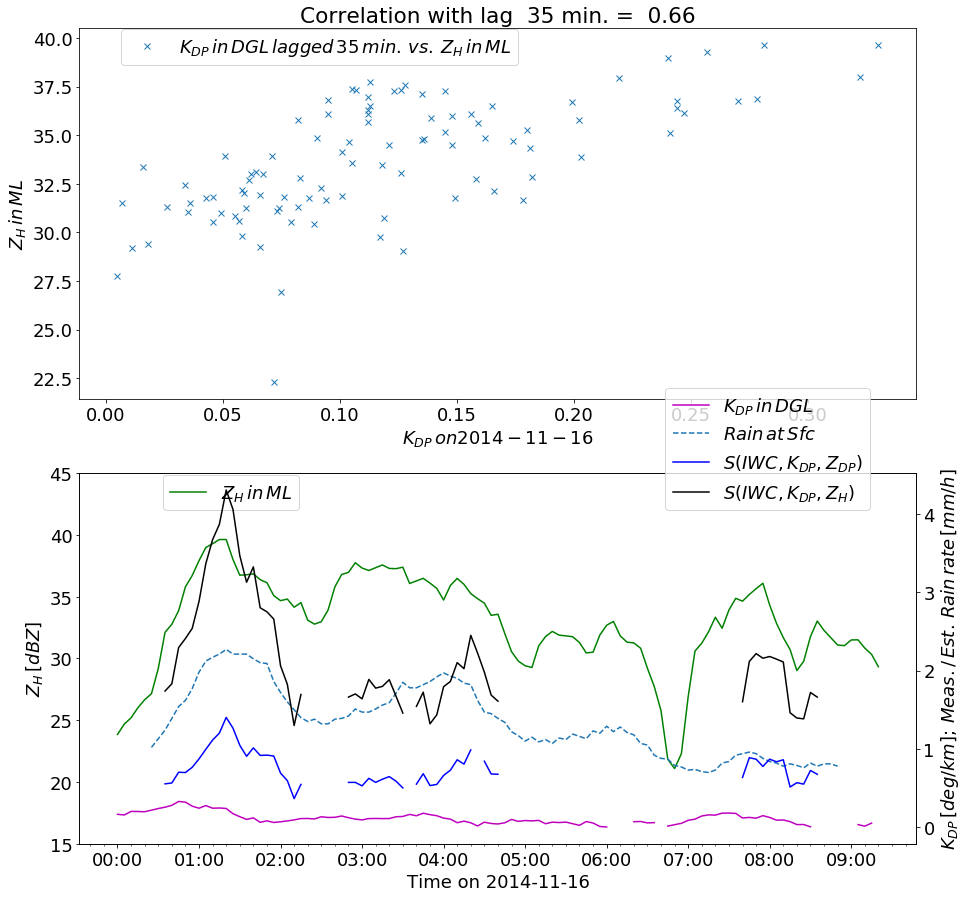

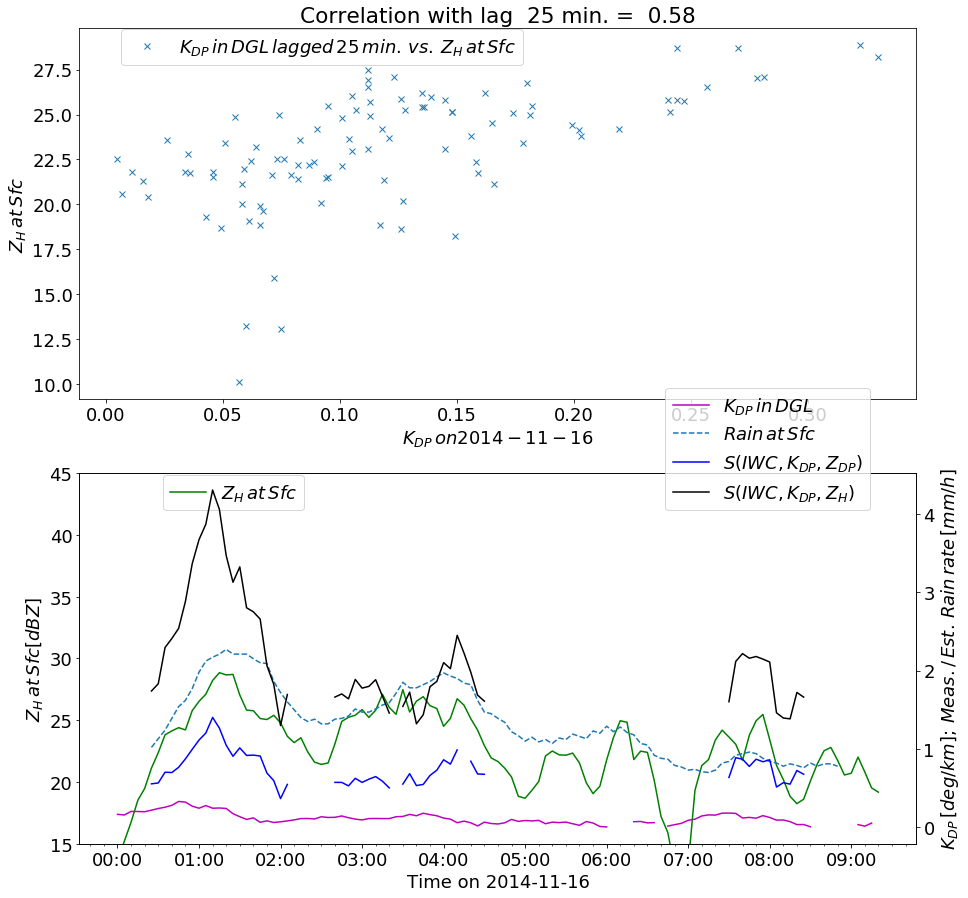

('vorher', -0.6771214940745448)
('p-value', 3.550877243330434e-08)
('p-value', 0.03597386833293267)
('p-value', 0.662143702755775)
('p-value', 0.4605855049199131)
('p-value', 0.0783452116858443)
('p-value', 0.4387636911359081)
('p-value', 0.16777174395343175)
('p-value', 0.21986836148812264)
('p-value', 0.4762343469551019)
('p-value', 0.5414110237821612)
('p-value', 0.8655732041476296)
('p-value', 0.5152245269639739)
('p-value', 0.016379904109930944)
('p-value', 0.023055617414121418)


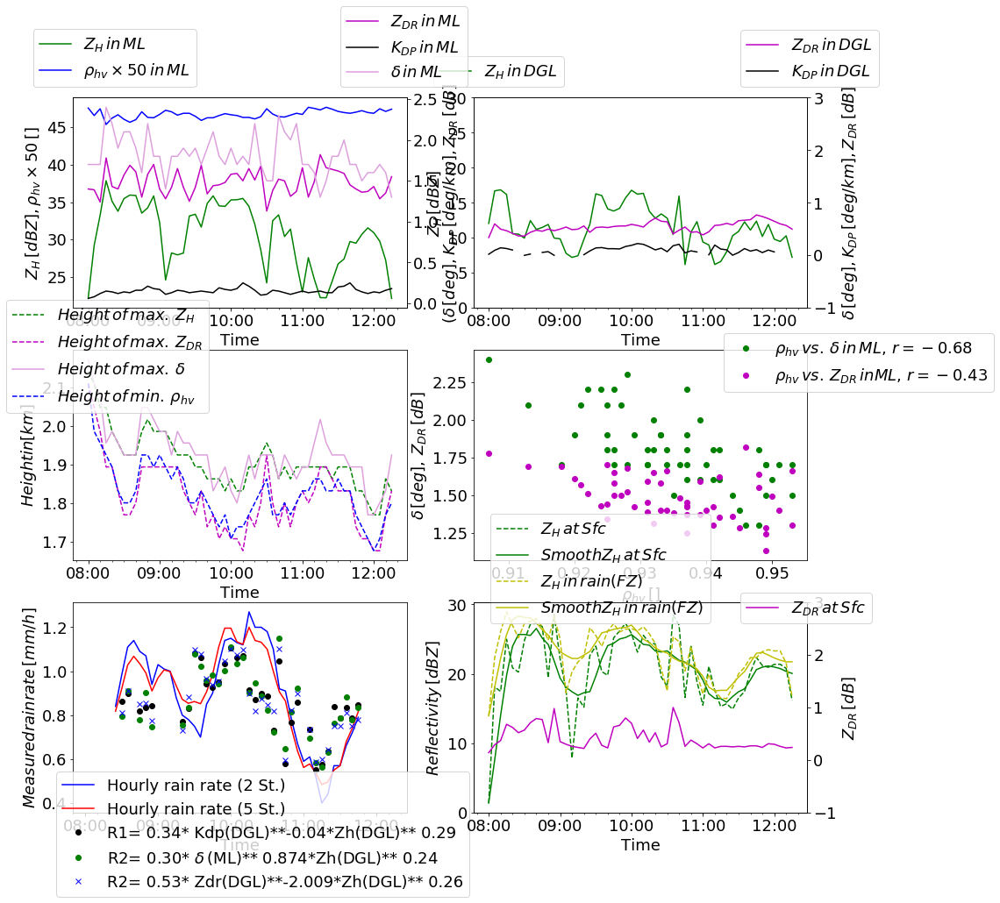

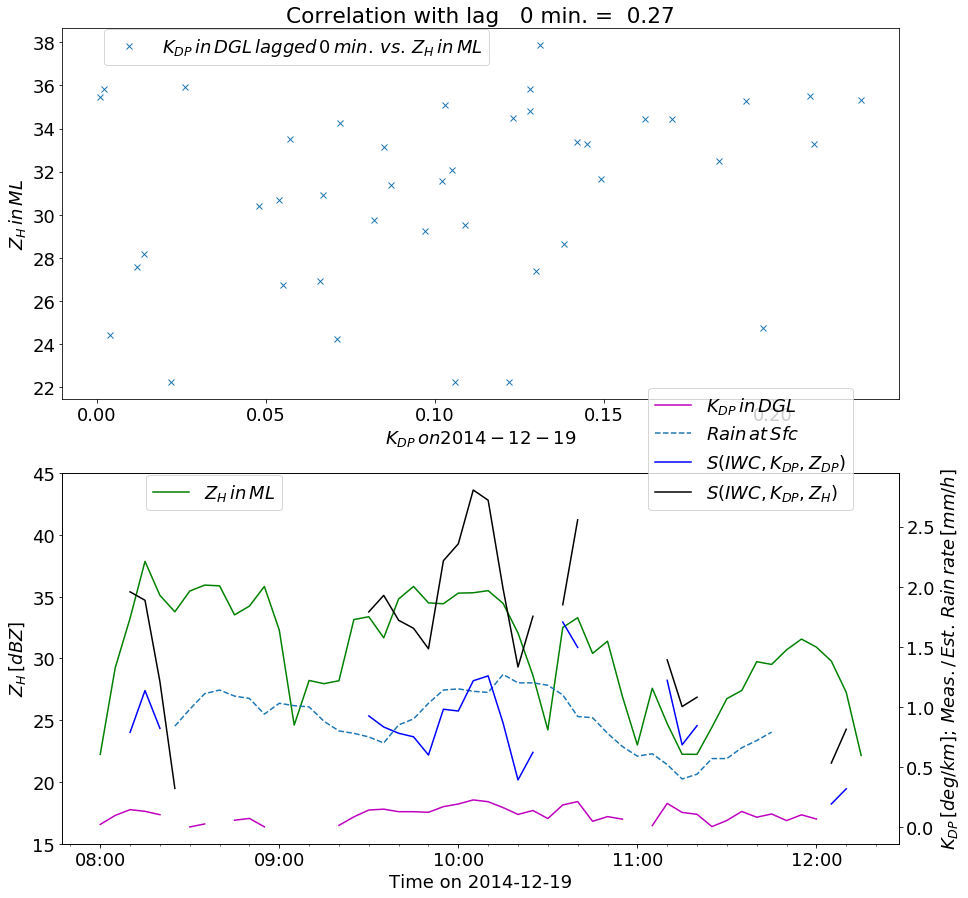

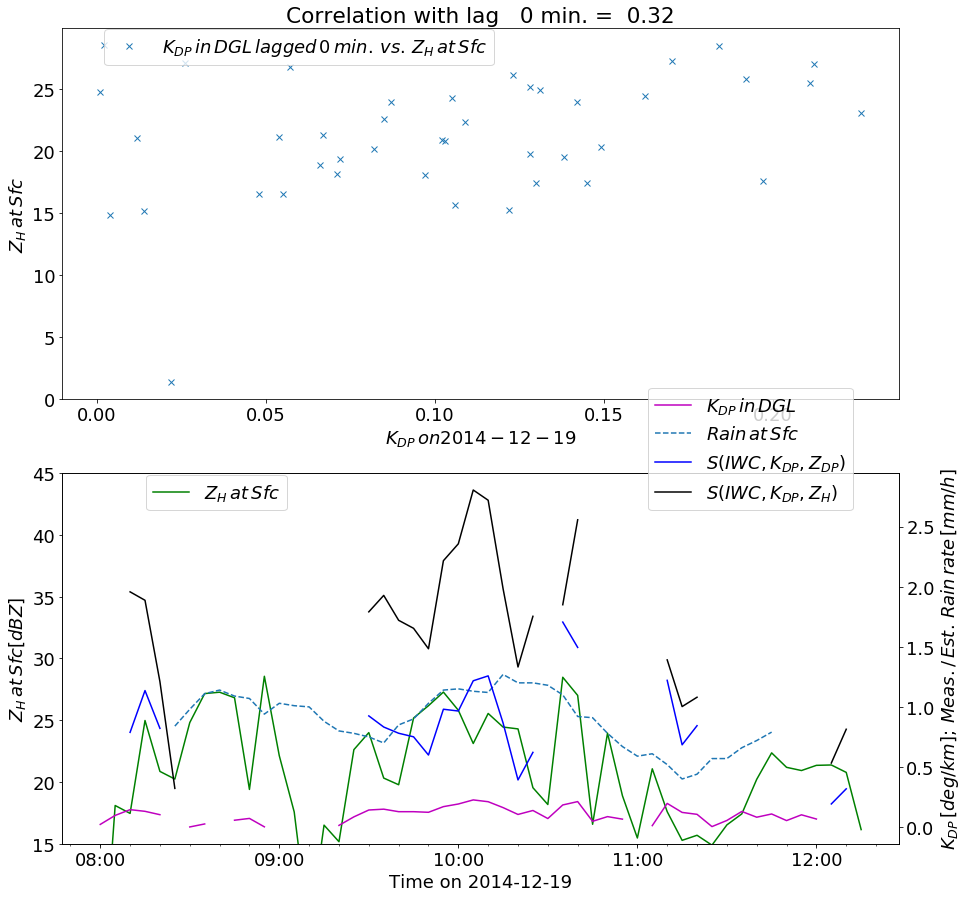

('vorher', -0.5033381354024106)
('p-value', 0.002827506912919375)
('p-value', 0.7665749606650939)
('p-value', 0.5419605355583821)
('p-value', 0.6148518331803001)
('p-value', 0.1952359011798522)
('p-value', 0.17616410195966278)
('p-value', 0.08187718930419485)
('p-value', 0.1102009378338238)
('p-value', 0.5609966005729838)
('p-value', 0.7932602818559268)
('p-value', 0.8631472586184196)
('p-value', 0.020016897848526335)
('p-value', 0.2919159812781368)
('p-value', 0.17233170448760654)


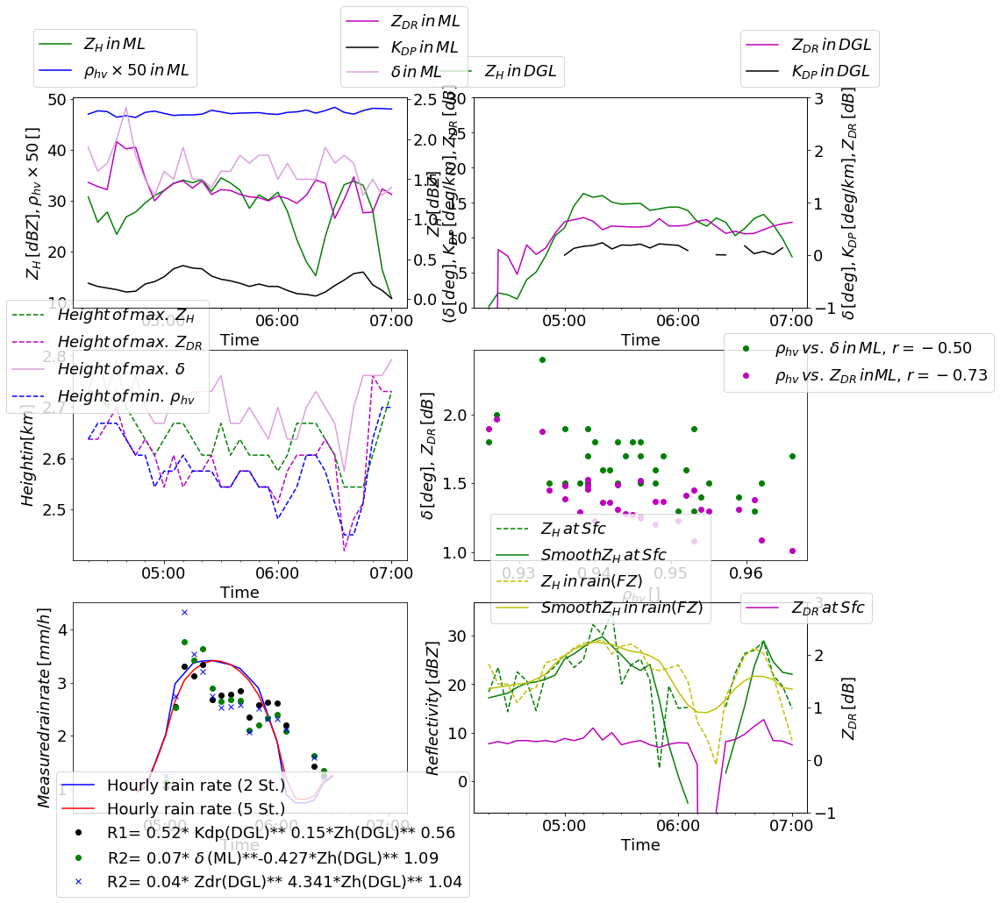

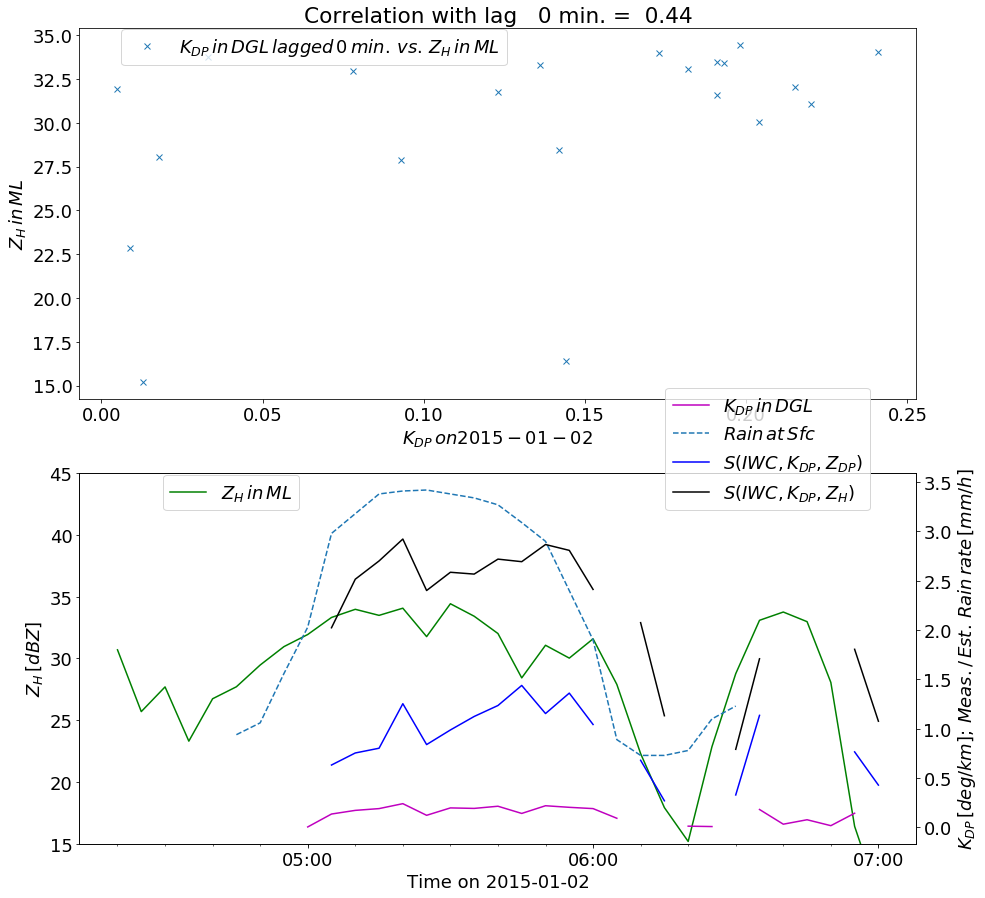

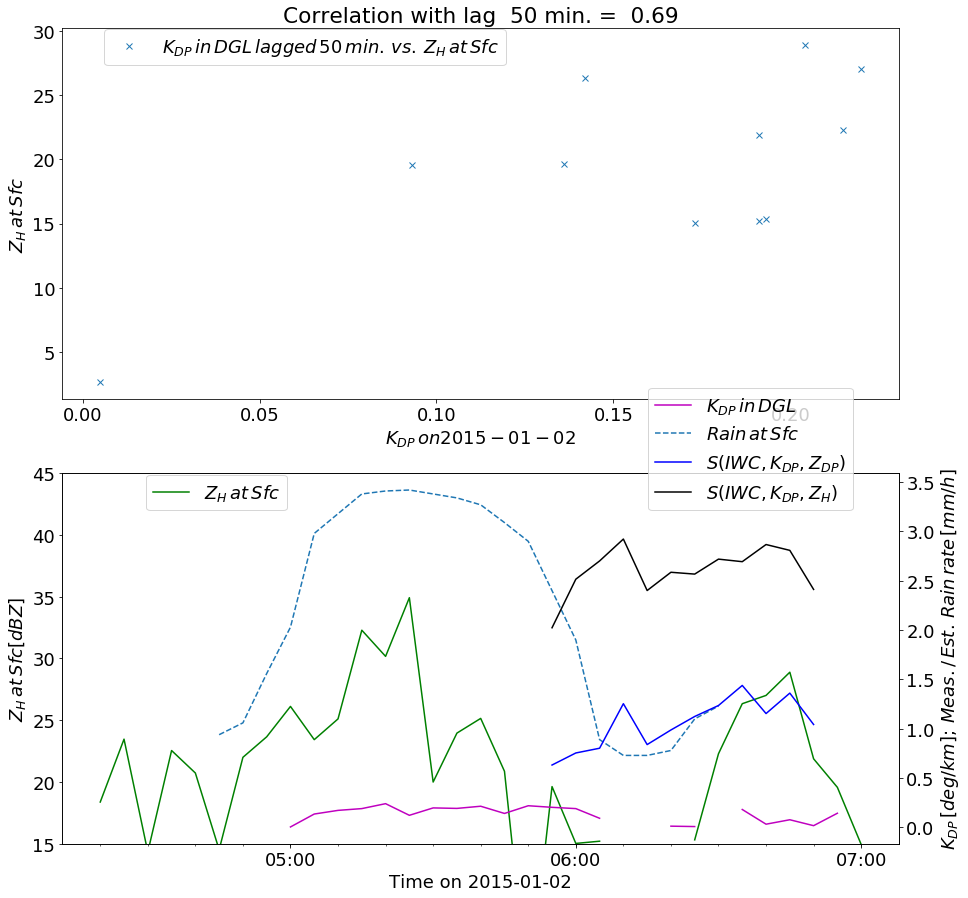

('vorher', -0.8782571422799346)
('p-value', 9.241520023059907e-13)
('p-value', 0.39997583423950955)
('p-value', 0.24339752377227927)
('p-value', 0.2049406189908444)
('p-value', 0.1860334604559042)
('p-value', 0.45837002510113534)
('p-value', 0.2089344874468146)
('p-value', 0.2605273699682866)
('p-value', 0.7727862254765601)
('p-value', 0.5087203848274482)
('p-value', 0.22763033493640172)
('p-value', 0.959289545158122)
('p-value', 0.036386710626373026)
('p-value', 0.15151037569863485)


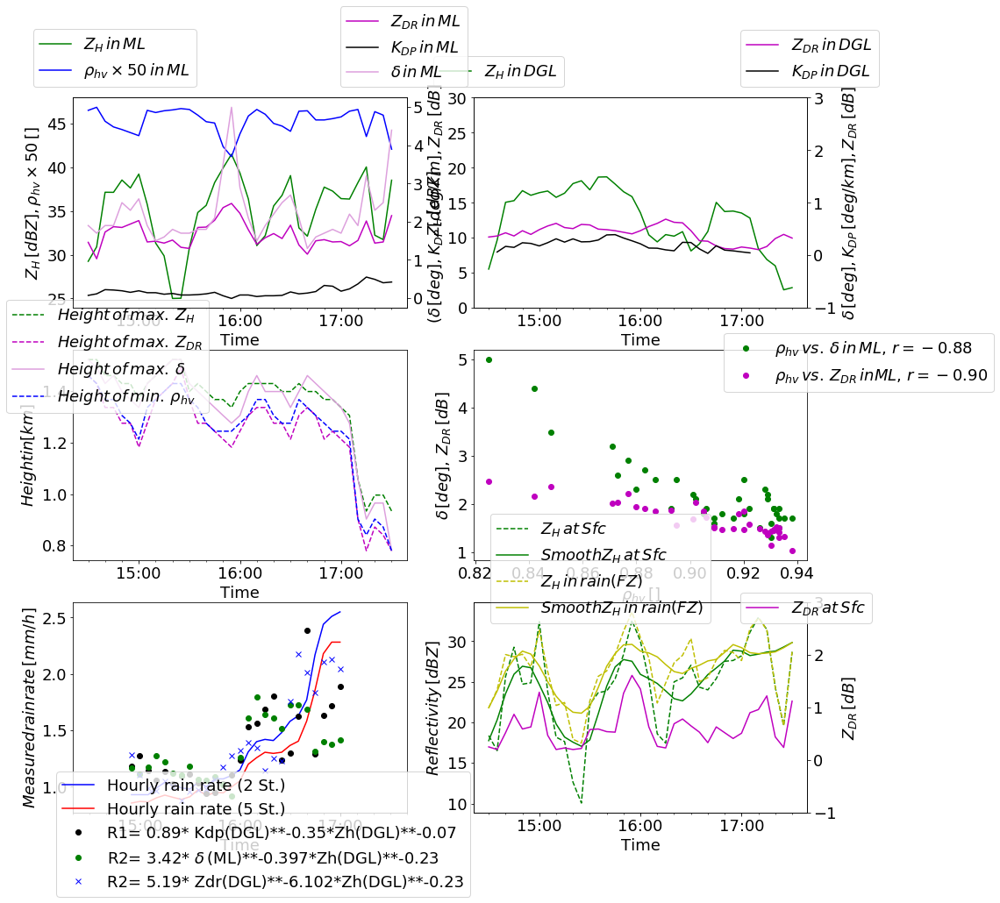

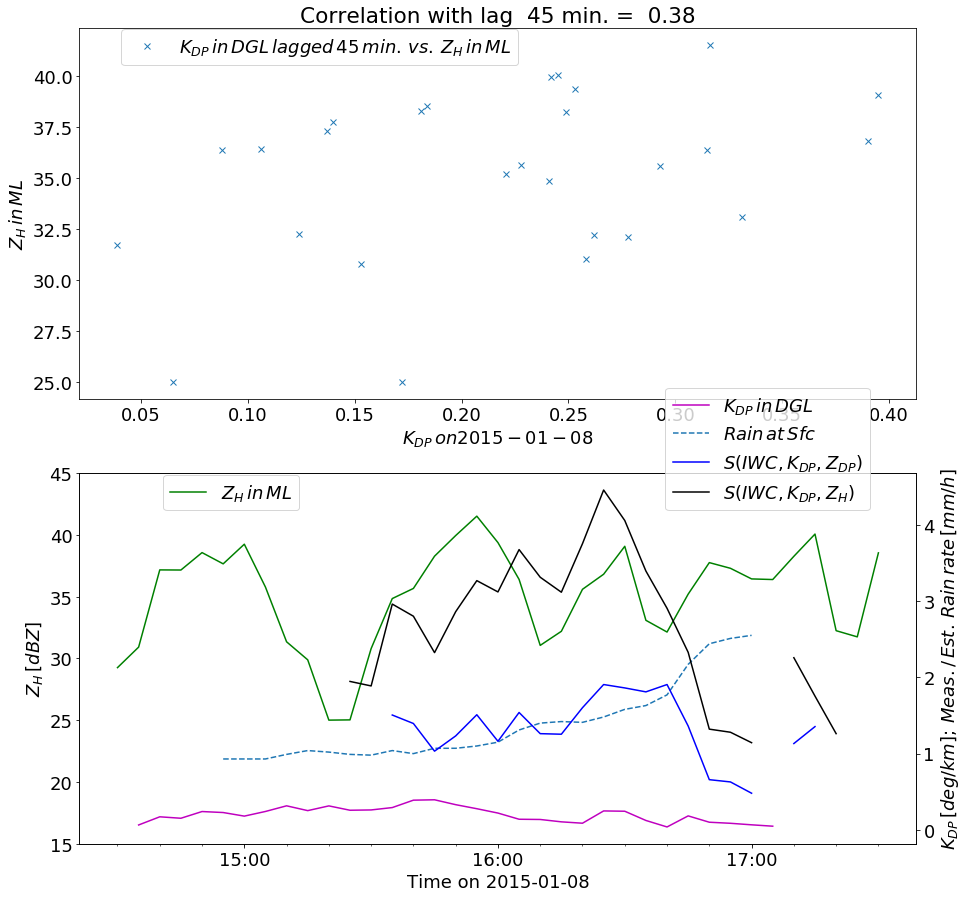

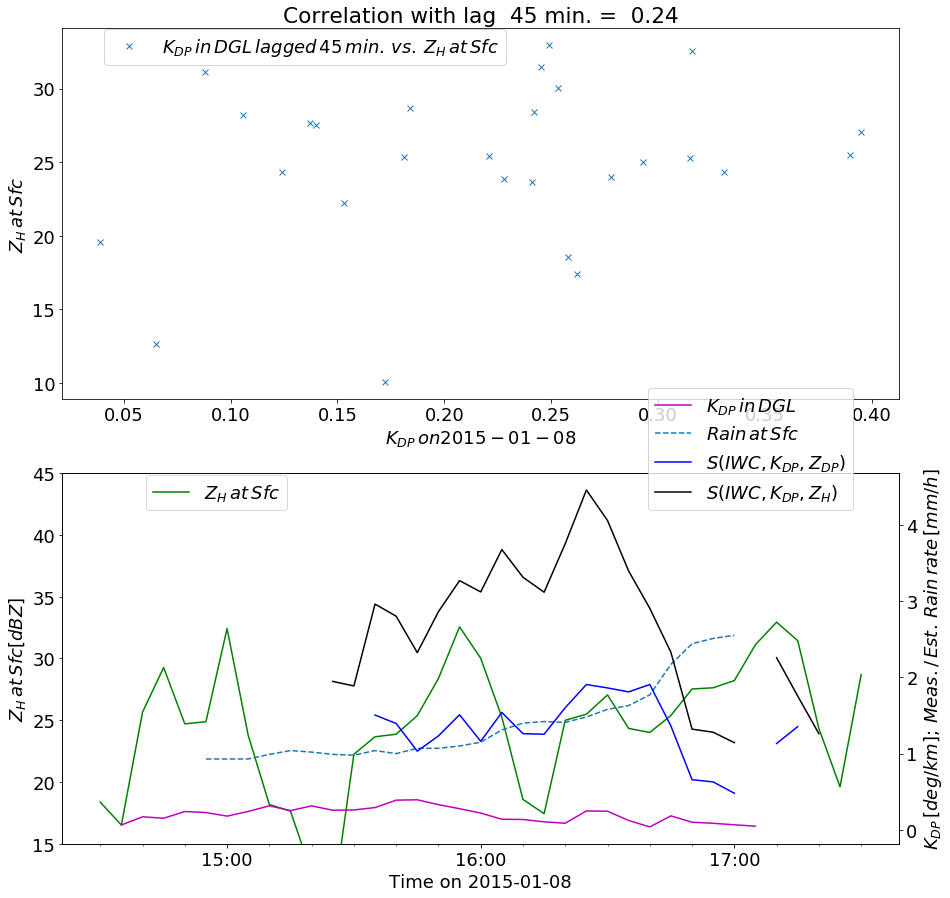

('vorher', -0.02926165194237235)
('p-value', 0.8058764200983715)
('p-value', 0.016774230921226433)
('p-value', 0.021888324659949516)
('p-value', 0.055391903072257234)
('p-value', 0.07128128731170703)
('p-value', 0.20247310177938513)
('p-value', 0.23807370712998752)
('p-value', 0.21478918183056472)
('p-value', 0.7180903337048063)
('p-value', 0.5672636138914599)
('p-value', 0.7920850288513925)
('p-value', 0.7653931426078519)
('p-value', 0.9784848567572753)
('p-value', 0.43007850197567377)


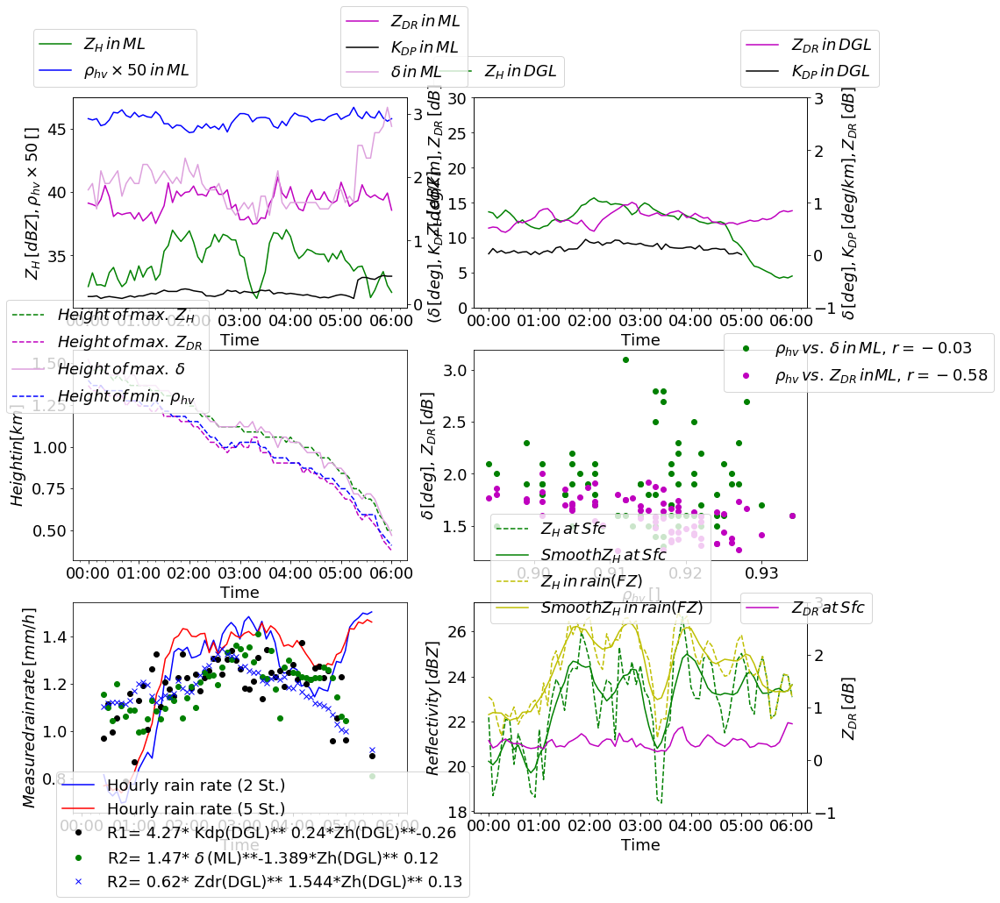

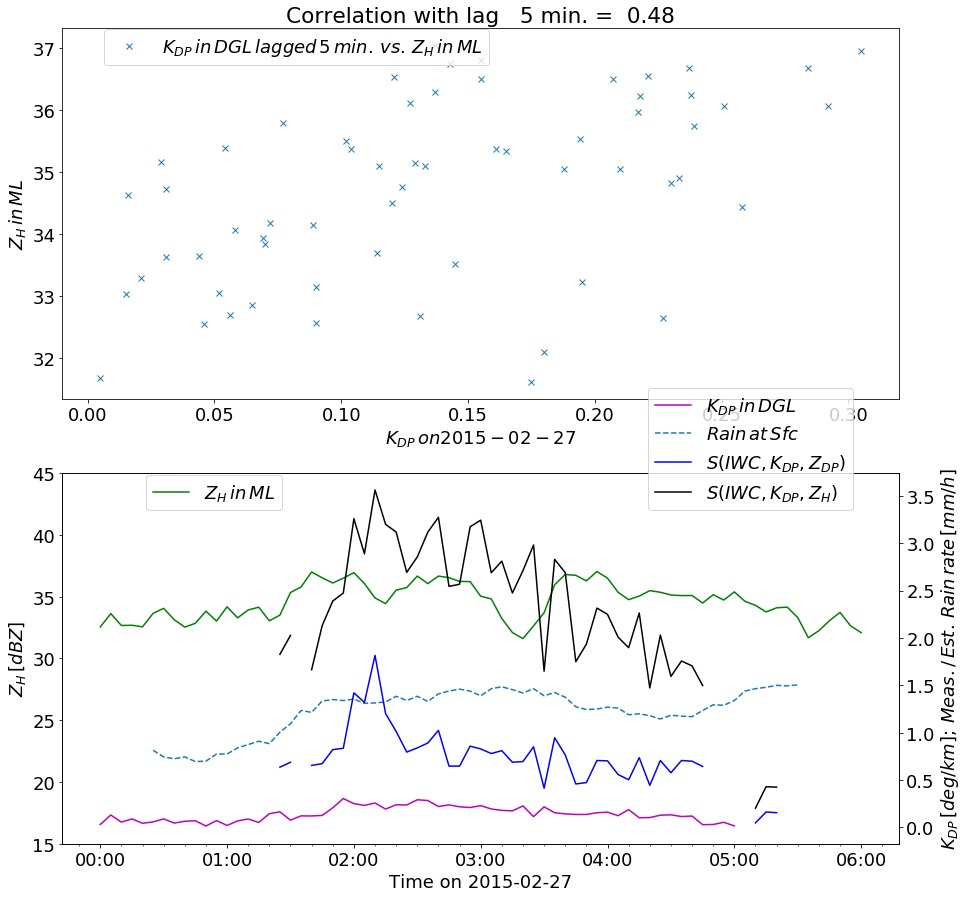

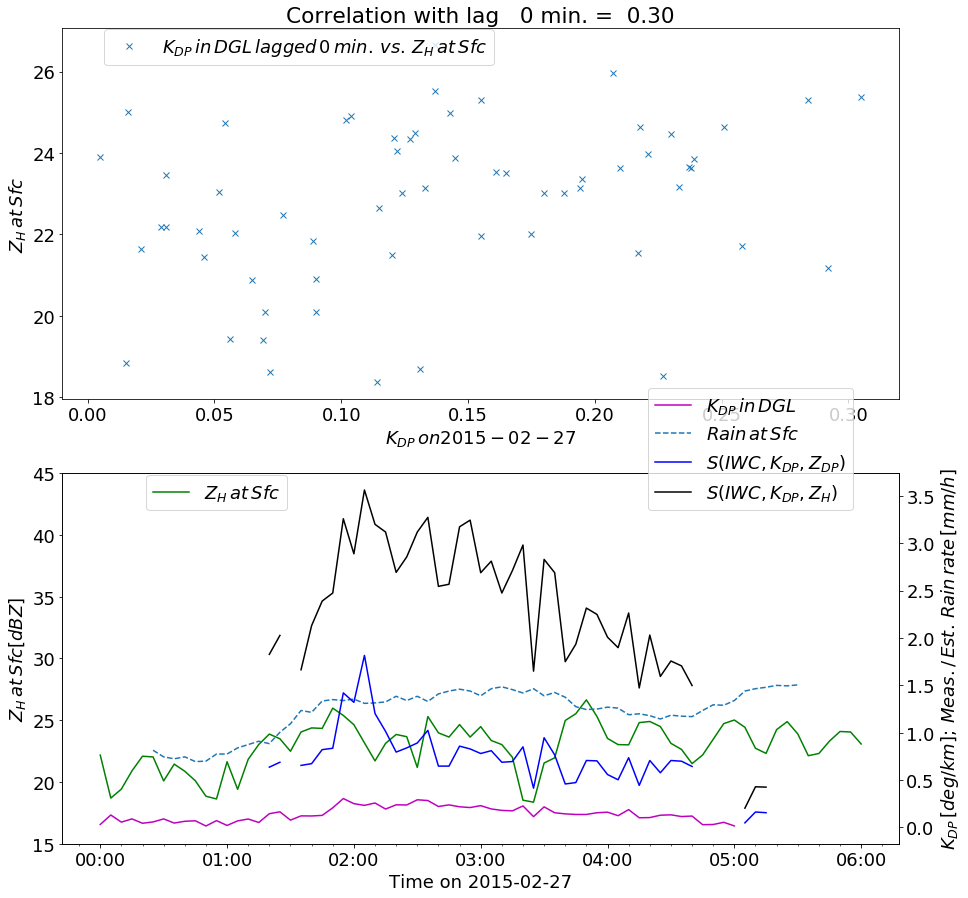

('vorher', -0.7167911084643691)
('p-value', 1.5747339925404696e-09)
('p-value', 0.60625950305945)
('p-value', 0.4357940848933227)
('p-value', 0.6505198986696434)
('p-value', 0.8319303952924751)
('p-value', 0.8910121658886268)
('p-value', 0.5921891583377678)
('p-value', 0.7632045459481887)
('p-value', 0.9790107011505823)
('p-value', 0.8133574393221167)
('p-value', 0.6698179756153864)
('p-value', 0.43523615561039597)
('p-value', 0.35835980564515757)
('p-value', 0.6129750340545876)


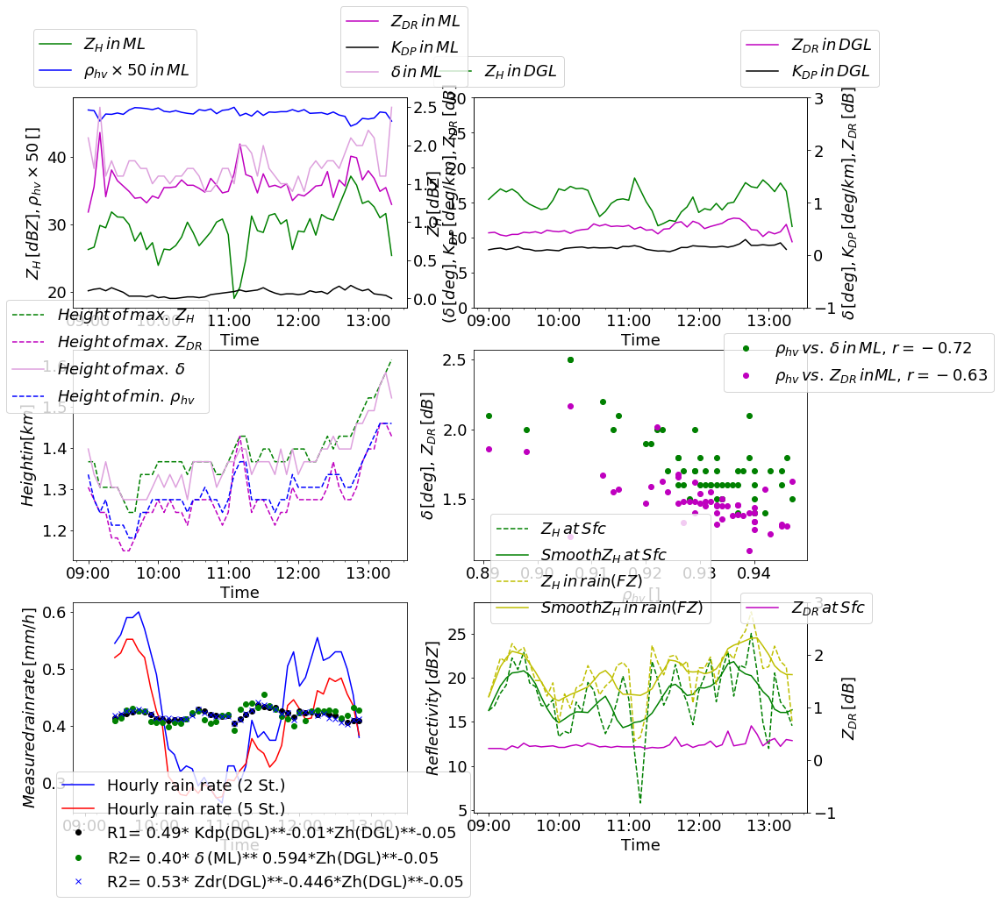

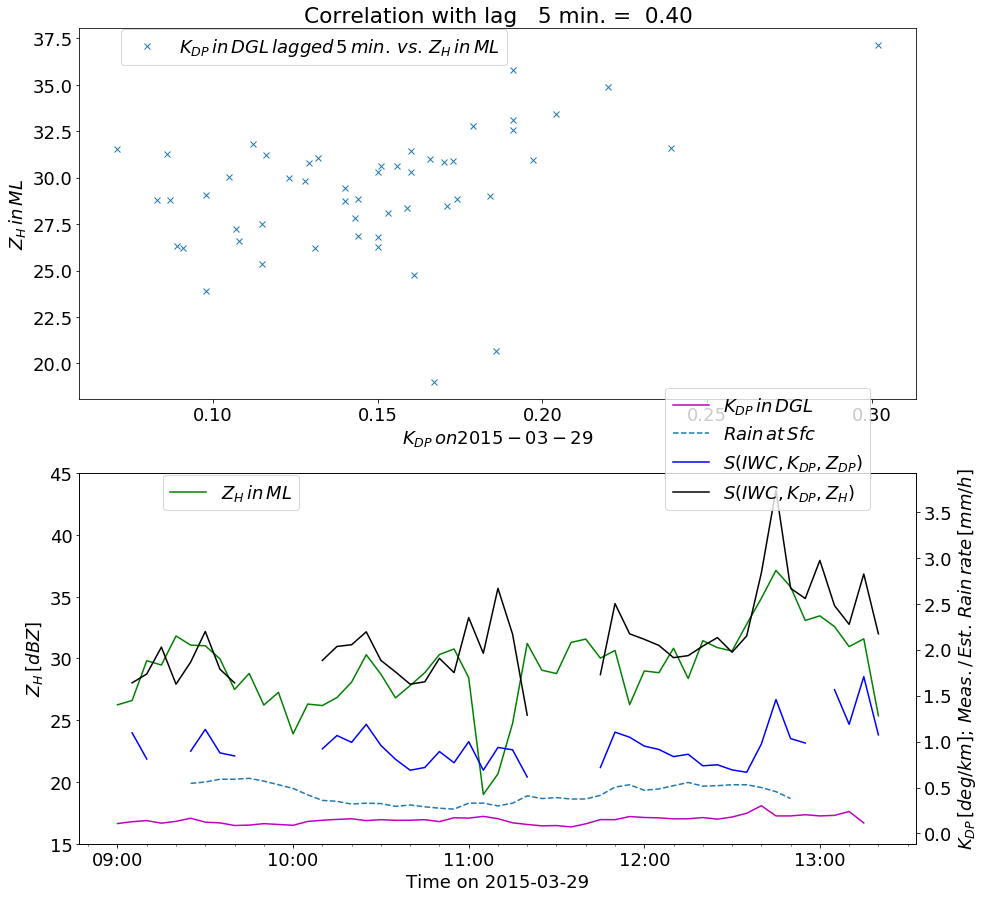

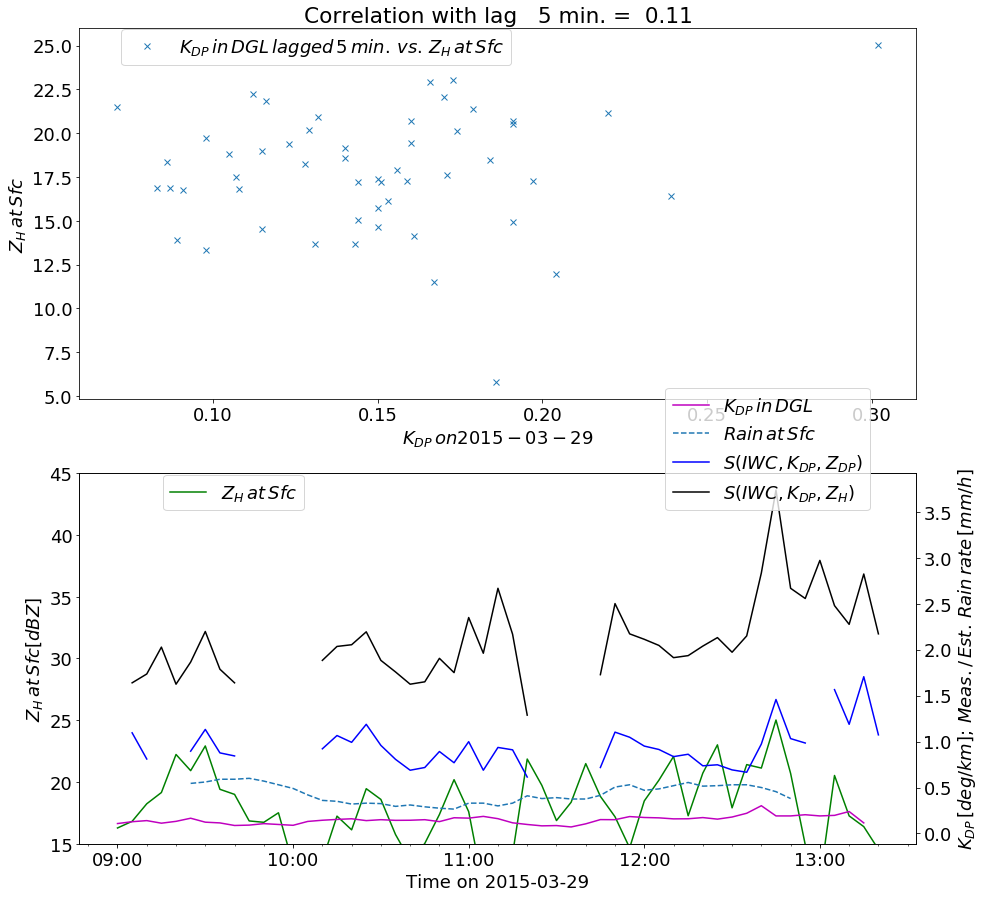

('vorher', -0.705207687431722)
('p-value', 1.292424157624051e-07)
('p-value', 0.21185830473644998)
('p-value', 0.14109480685055192)
('p-value', 0.07973173012078974)
('p-value', 0.05136193714167698)
('p-value', 0.06067257241411262)
('p-value', 0.08539837071299979)
('p-value', 0.10122113215110375)
('p-value', 0.03978670099020913)
('p-value', 0.018226317811285732)
('p-value', 0.004294358230420752)
('p-value', 0.00030768684731007203)
('p-value', 3.12350912962814e-06)
('p-value', 2.0903921014164804e-08)


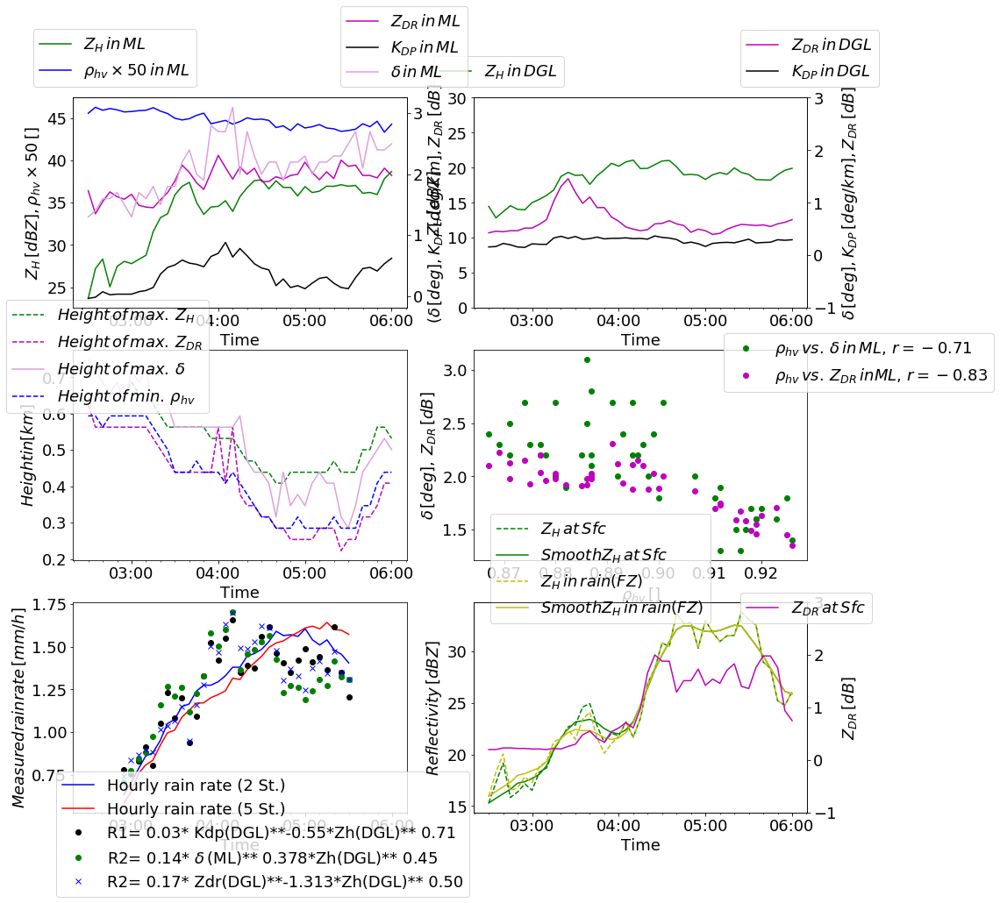

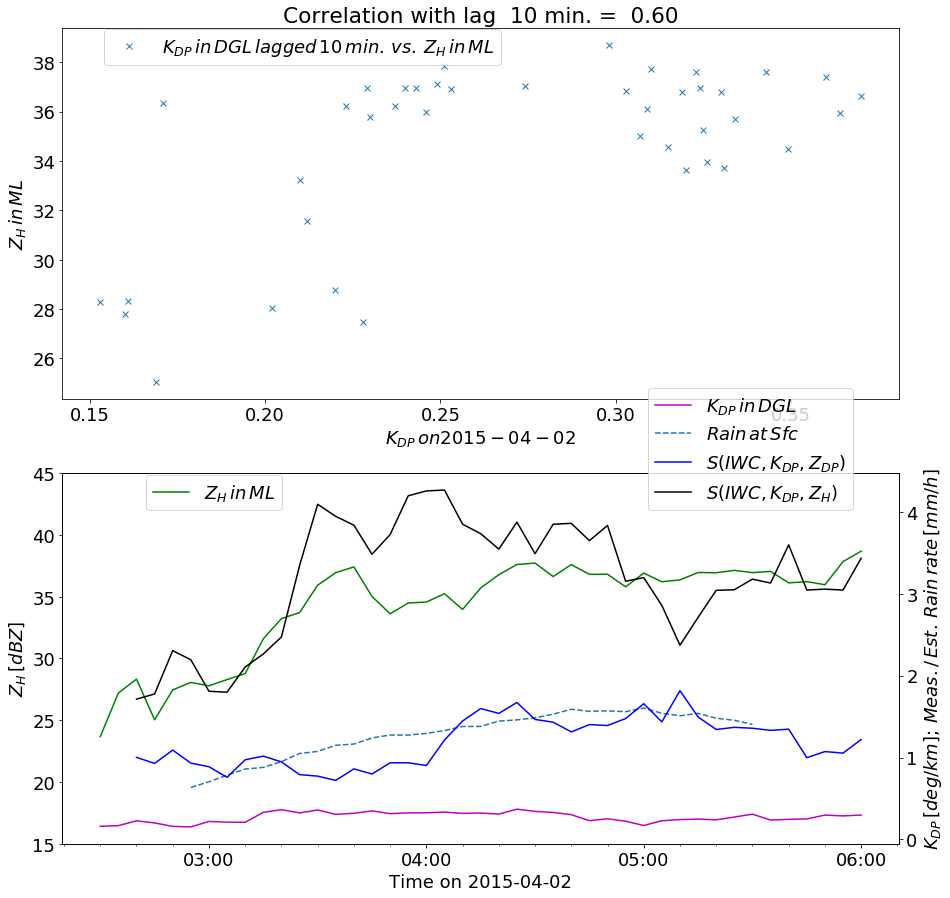

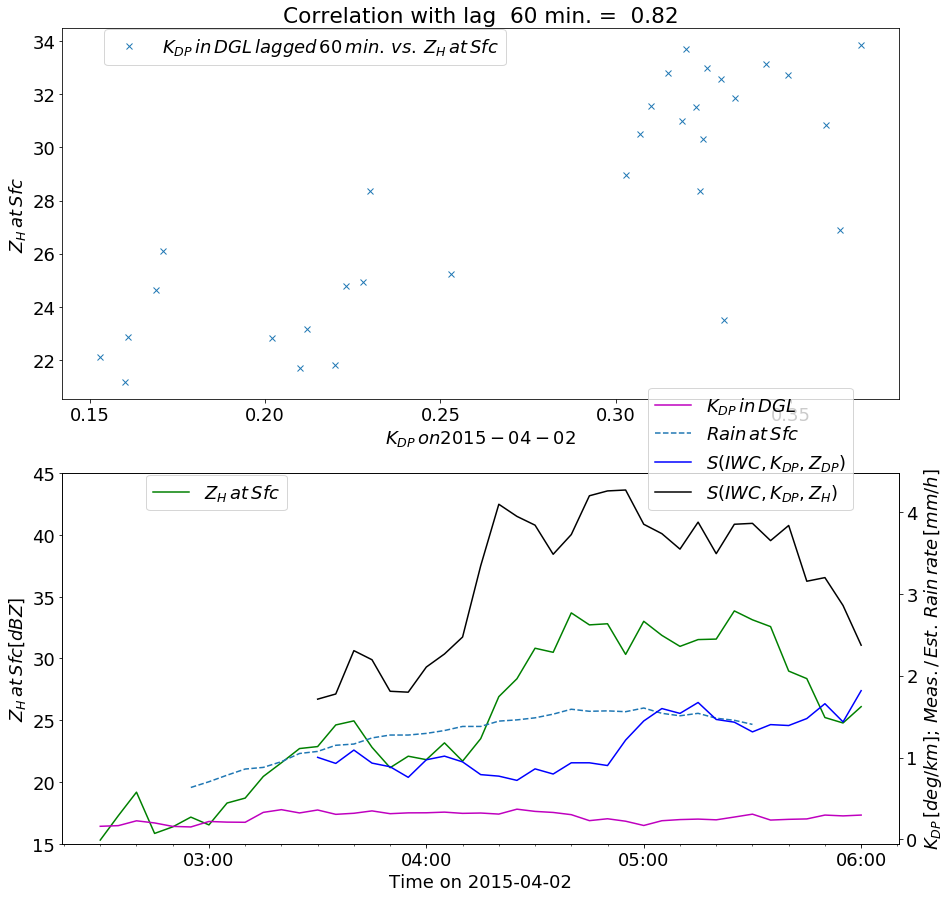

('vorher', -0.522278721140178)
('p-value', 0.00010010450671549477)
('p-value', 0.0004330793538707866)
('p-value', 3.298616018994231e-05)
('p-value', 2.6921740787144895e-05)
('p-value', 0.0003182223869259417)
('p-value', 0.0010365554708821906)
('p-value', 0.0026769373482224824)
('p-value', 0.0009377801129767899)
('p-value', 0.012929006682613129)
('p-value', 0.012142363409978913)
('p-value', 0.0264413407167486)
('p-value', 0.10496414565876215)
('p-value', 0.7037991987577399)
('p-value', 0.9312367910635605)


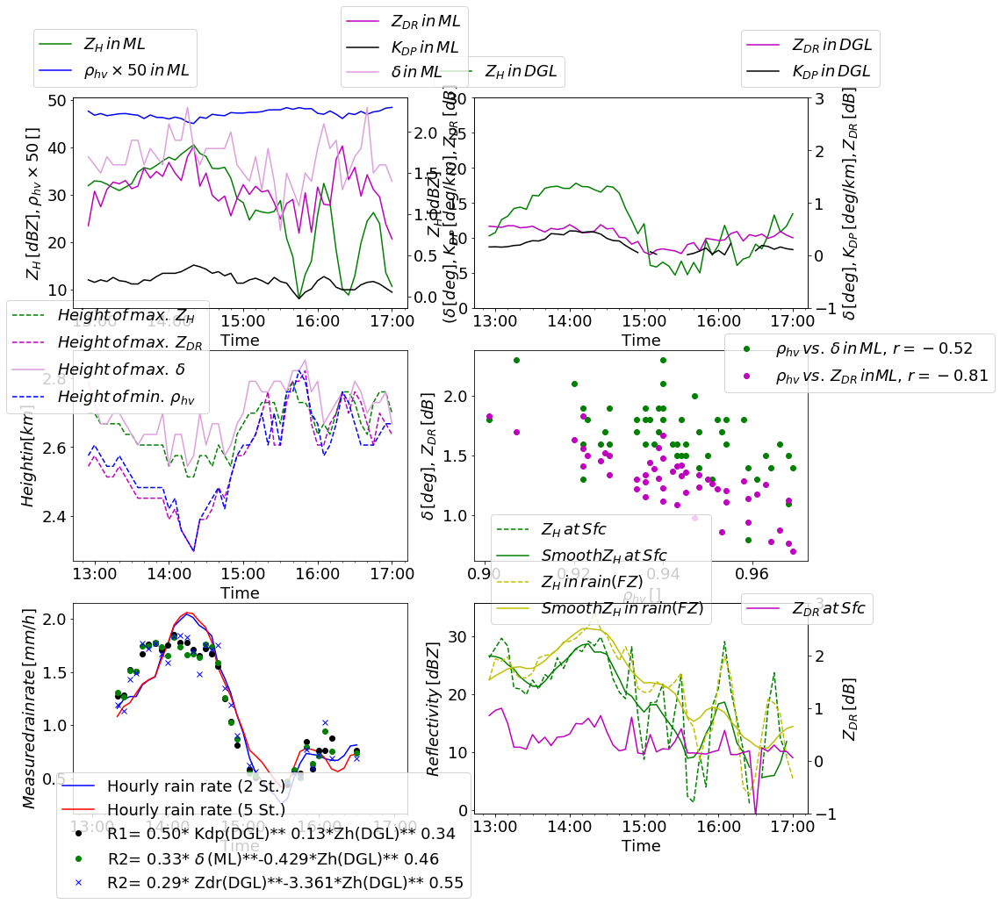

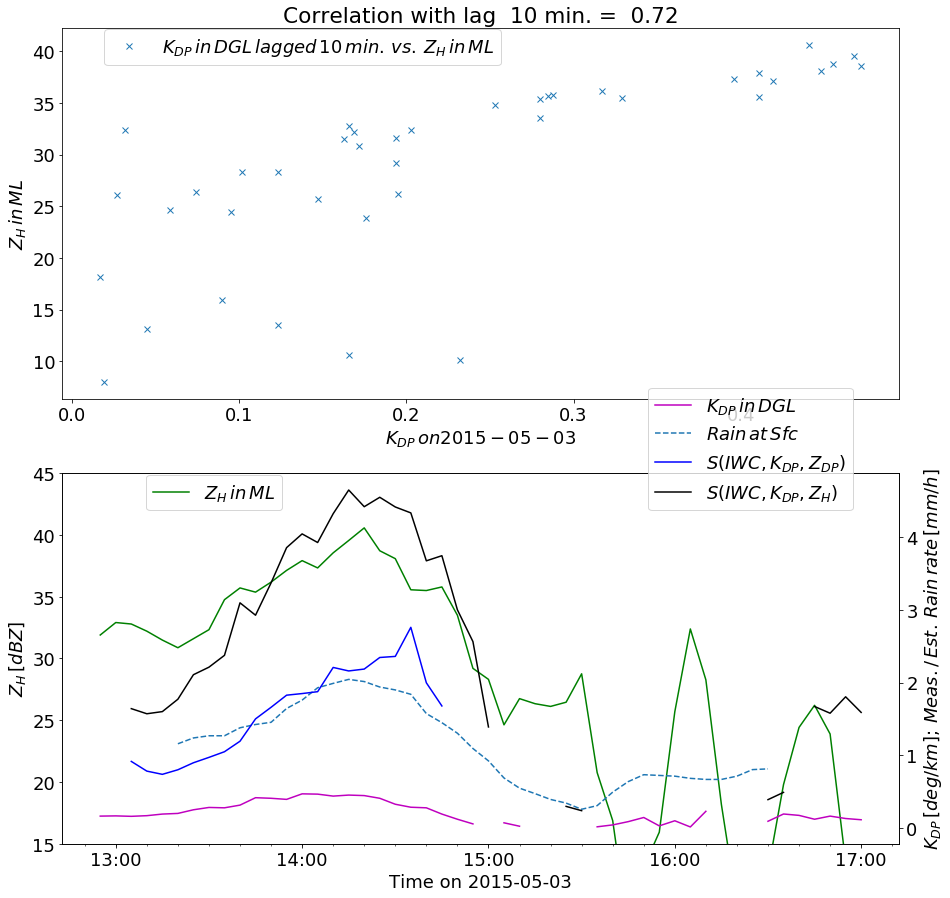

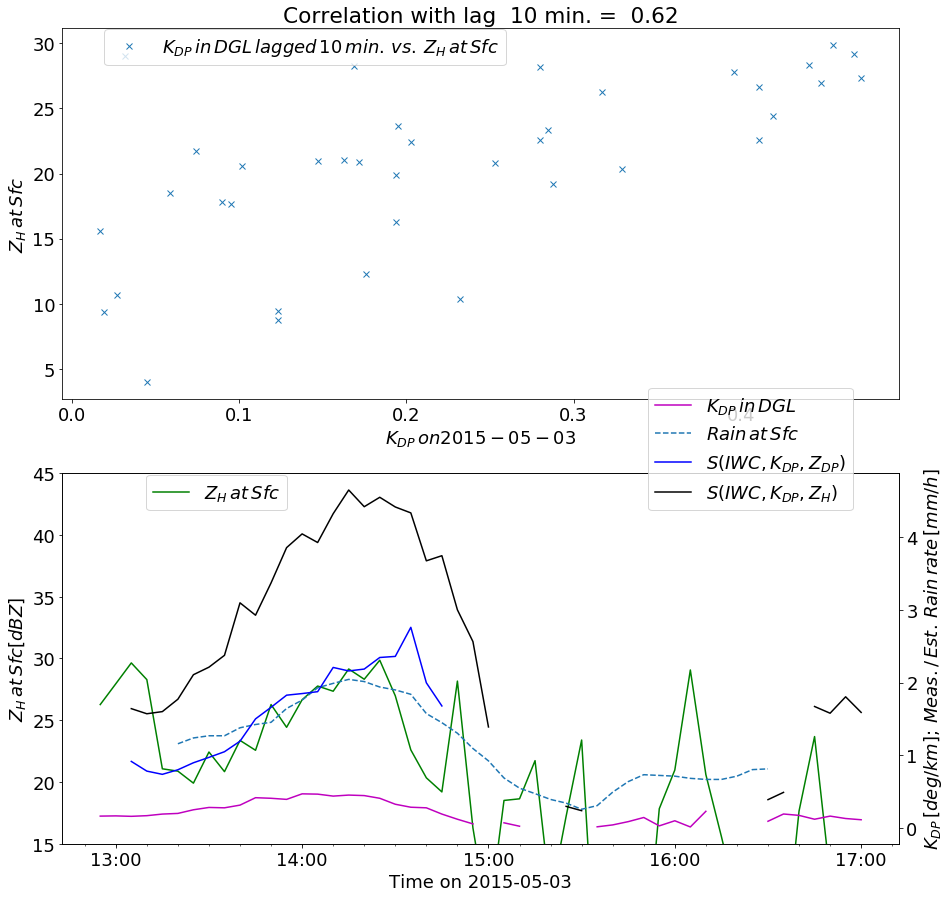

('vorher', -0.8457635690736451)
('p-value', 1.1033340721864537e-09)
('p-value', 0.8543701553693082)
('p-value', 0.0)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)


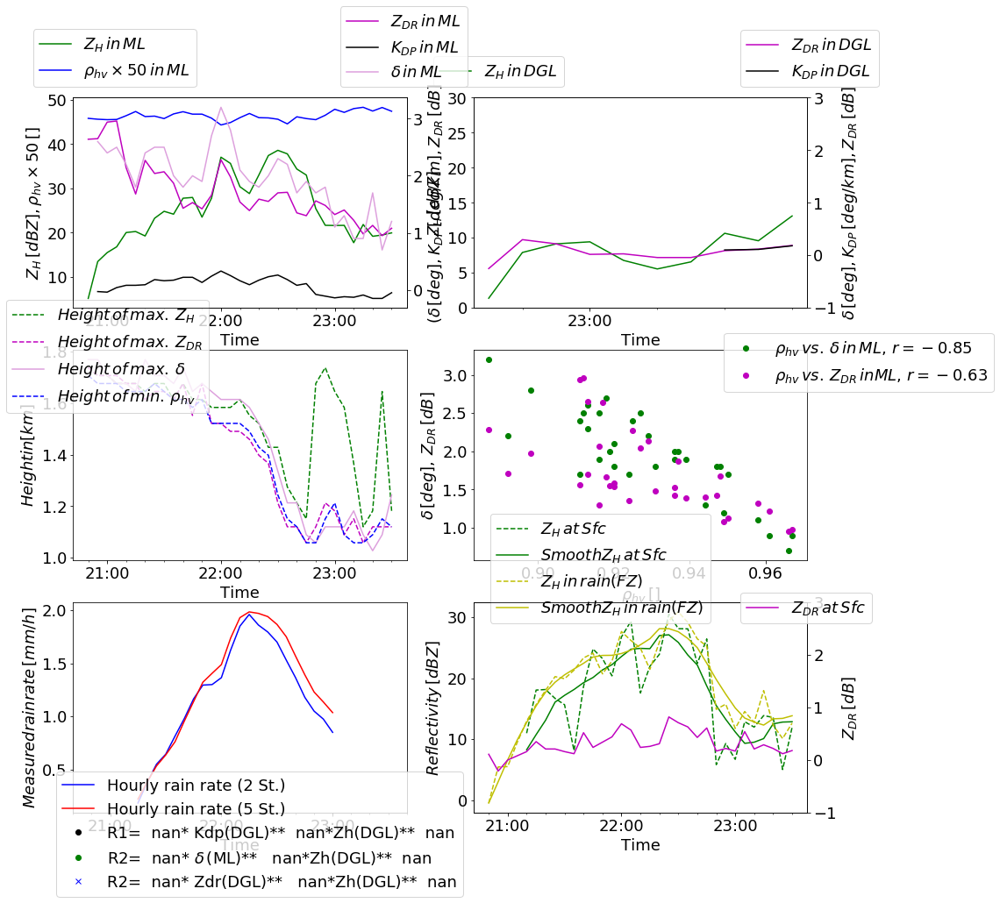

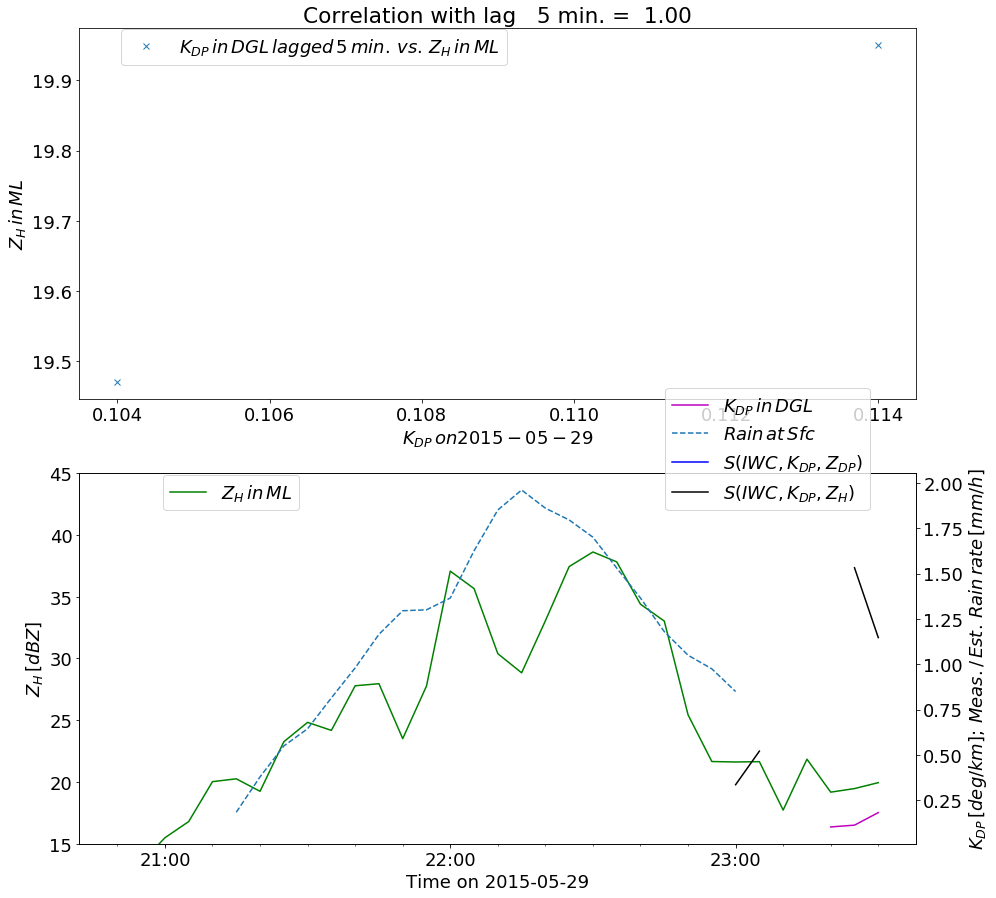

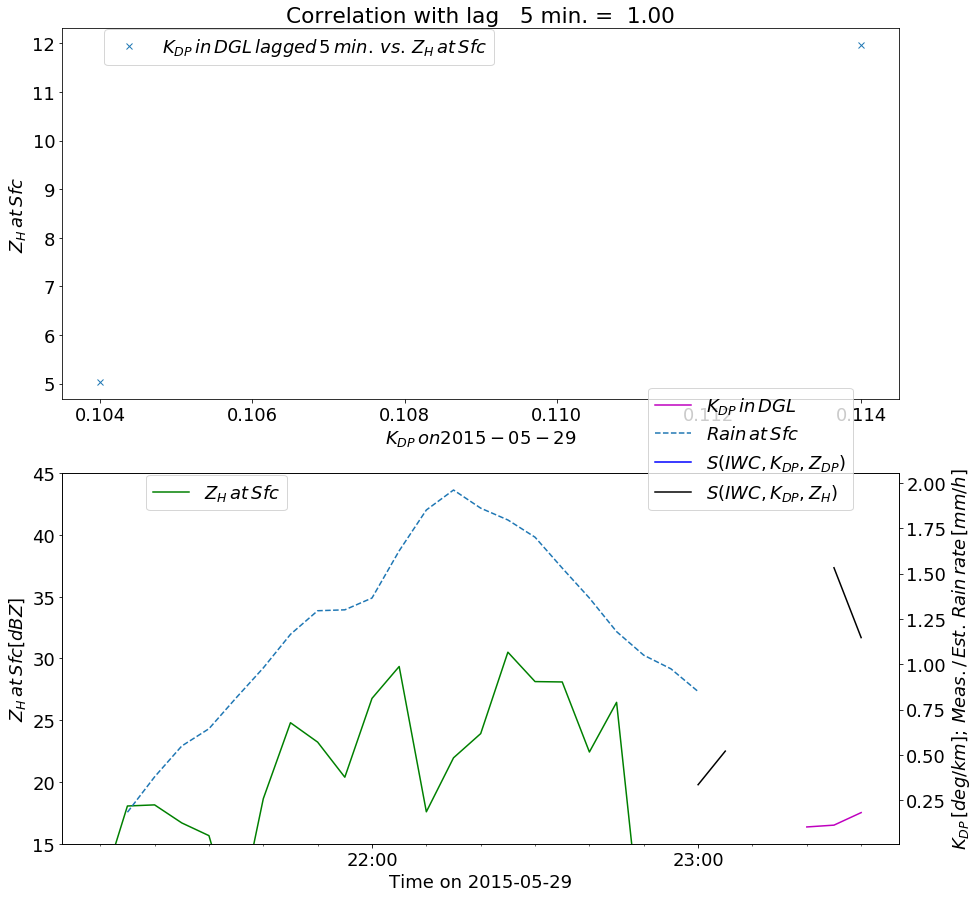

('vorher', -0.696887370041349)
('p-value', 3.308677290099655e-06)
('p-value', 0.01260509654220823)
('p-value', 0.0020674074691669083)
('p-value', 0.000537445806314725)
('p-value', 0.0012759302261579454)
('p-value', 0.02415319818243745)
('p-value', 0.0650618903955288)
('p-value', 0.8469329268360027)
('p-value', 0.2615065949663942)
('p-value', 0.0037042283762579063)
('p-value', 1.0503024361290124e-07)
('p-value', 6.641725189184487e-08)
('p-value', 5.20597011372572e-07)
('p-value', 0.002869467186051285)


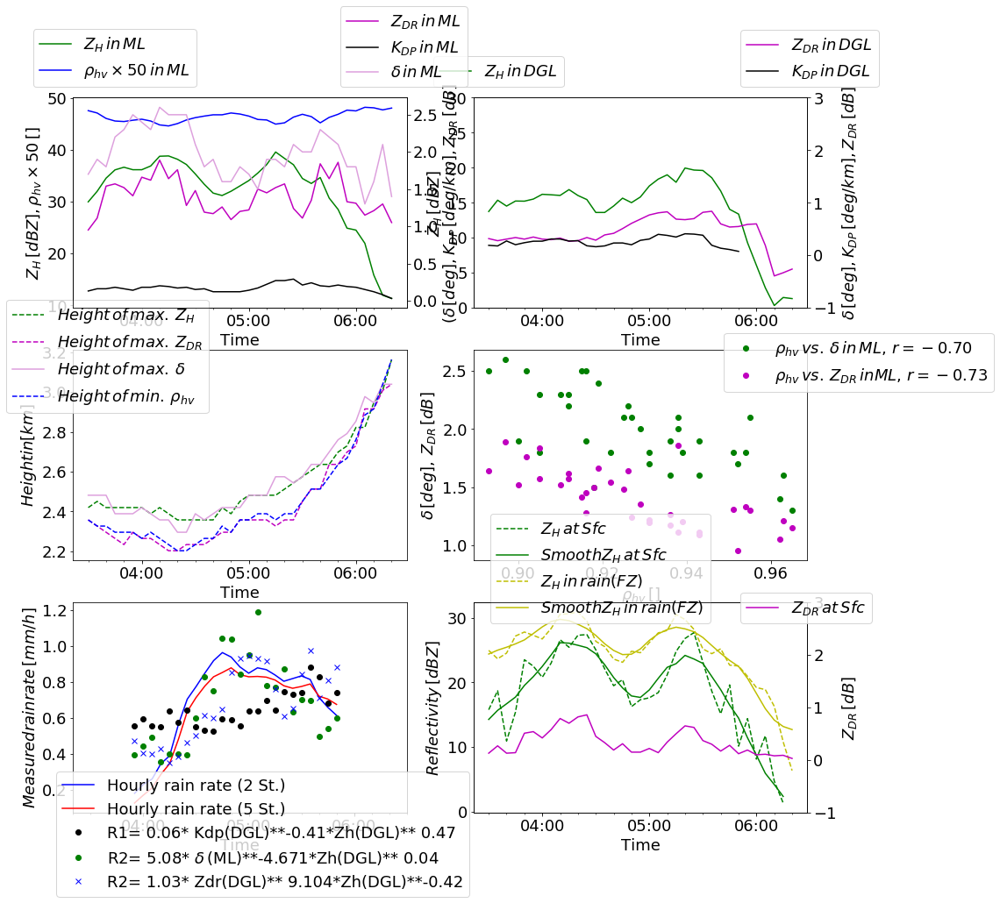

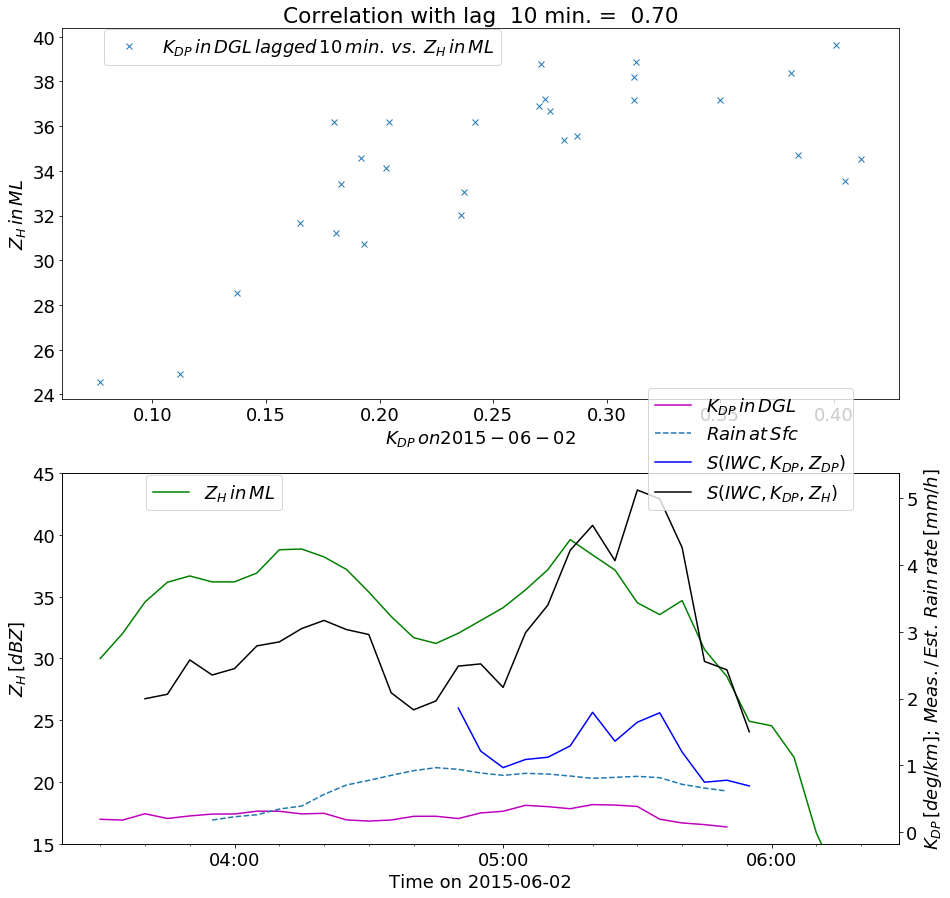

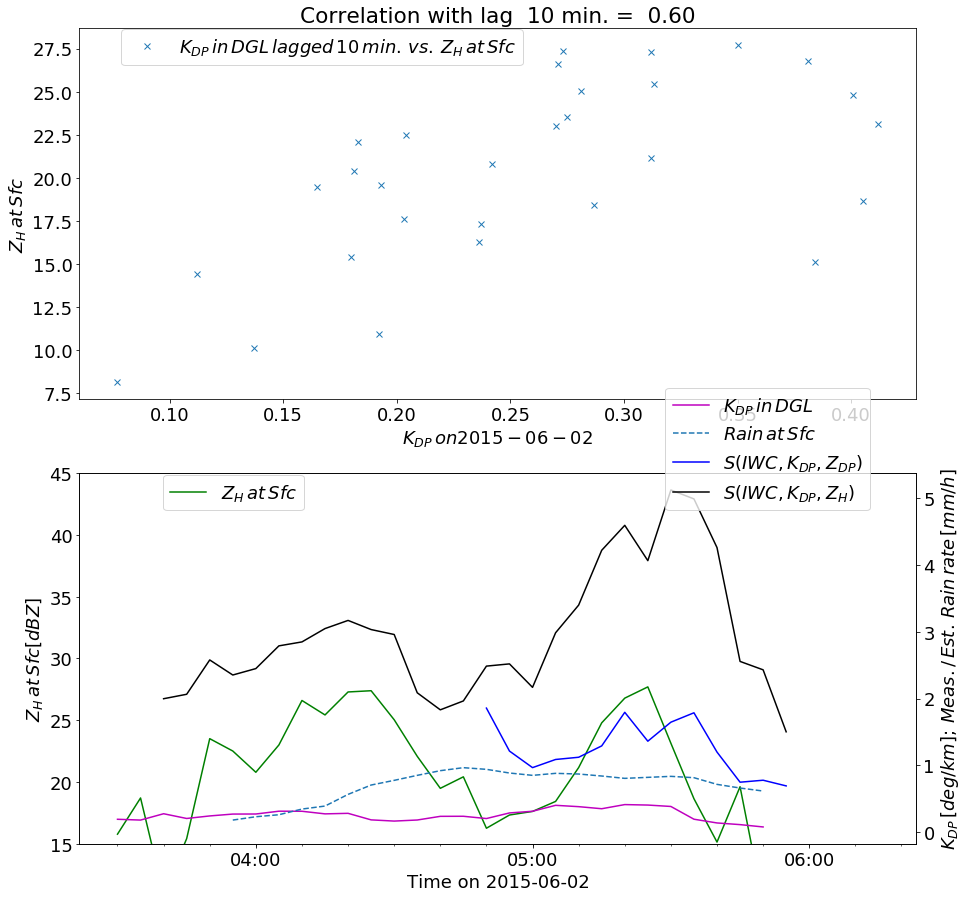

('vorher', -0.5634876166439411)
('p-value', 0.009673127287086407)
('p-value', 0.6946368955384699)
('p-value', 0.24691429678965476)
('p-value', 0.0013844973730319423)
('p-value', 0.09345754867464531)
('p-value', 0.17729529797271903)
('p-value', 0.4532518053530131)
('p-value', 0.41173333921221184)
('p-value', 0.6359567169845105)
('p-value', 0.0)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)


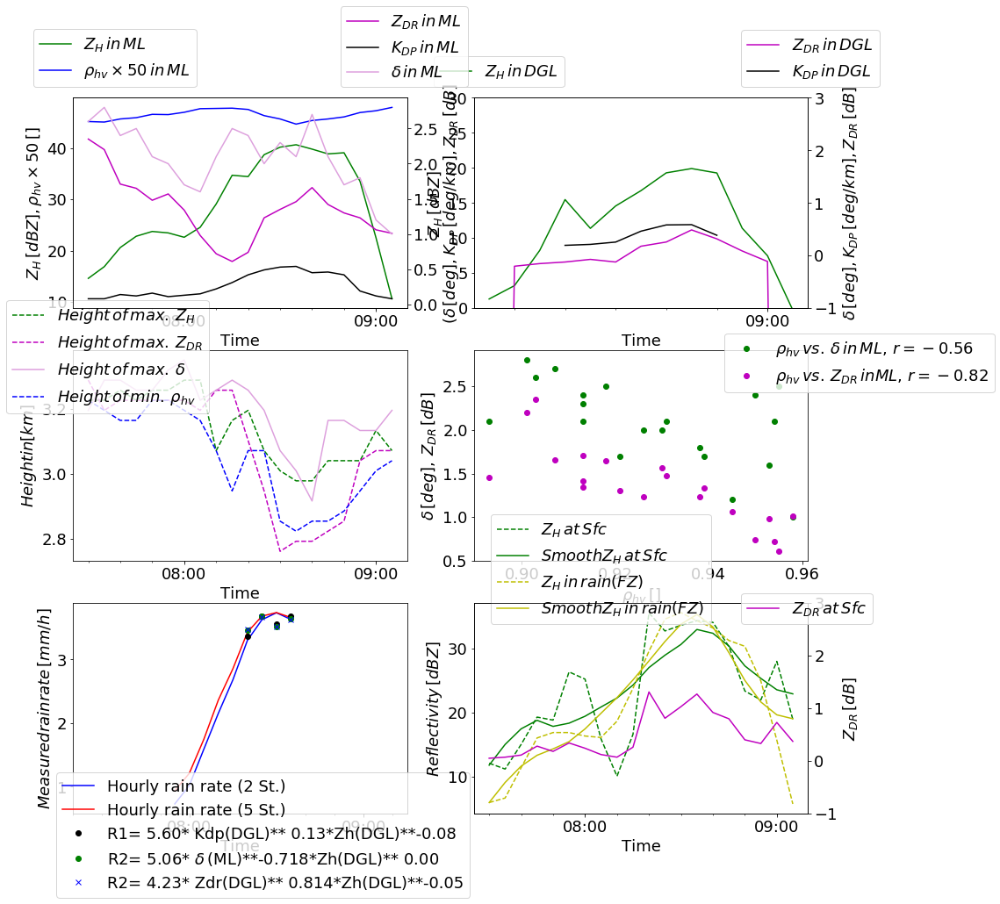

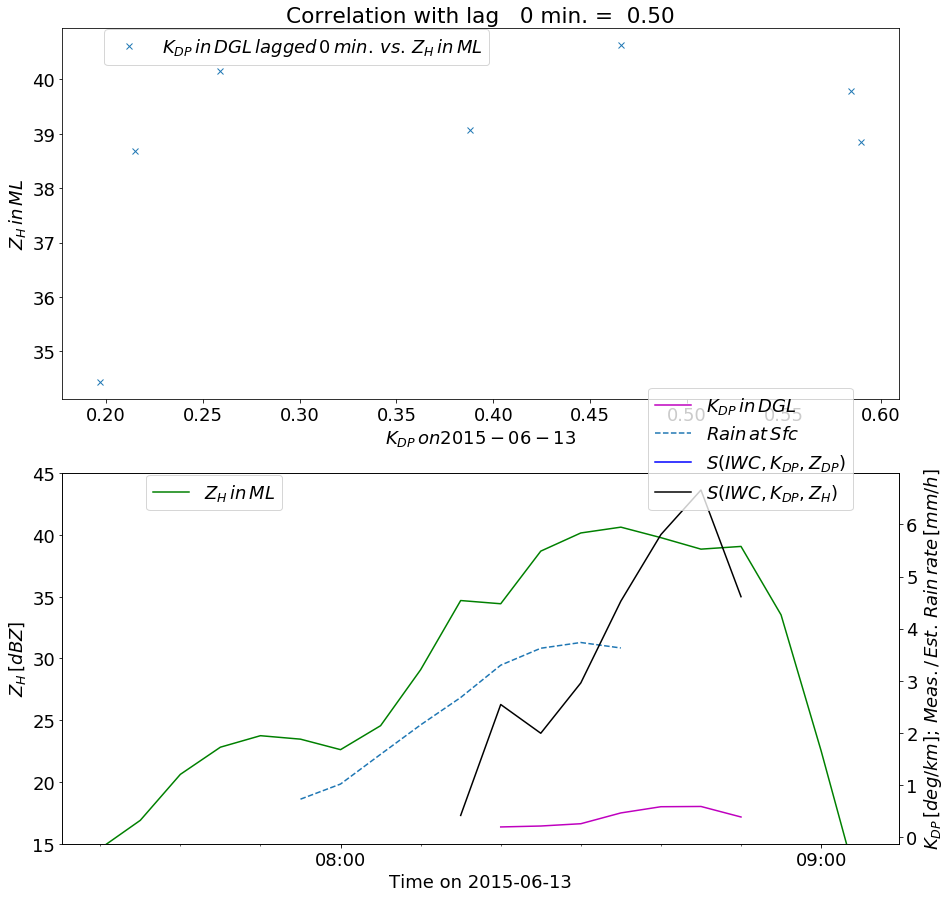

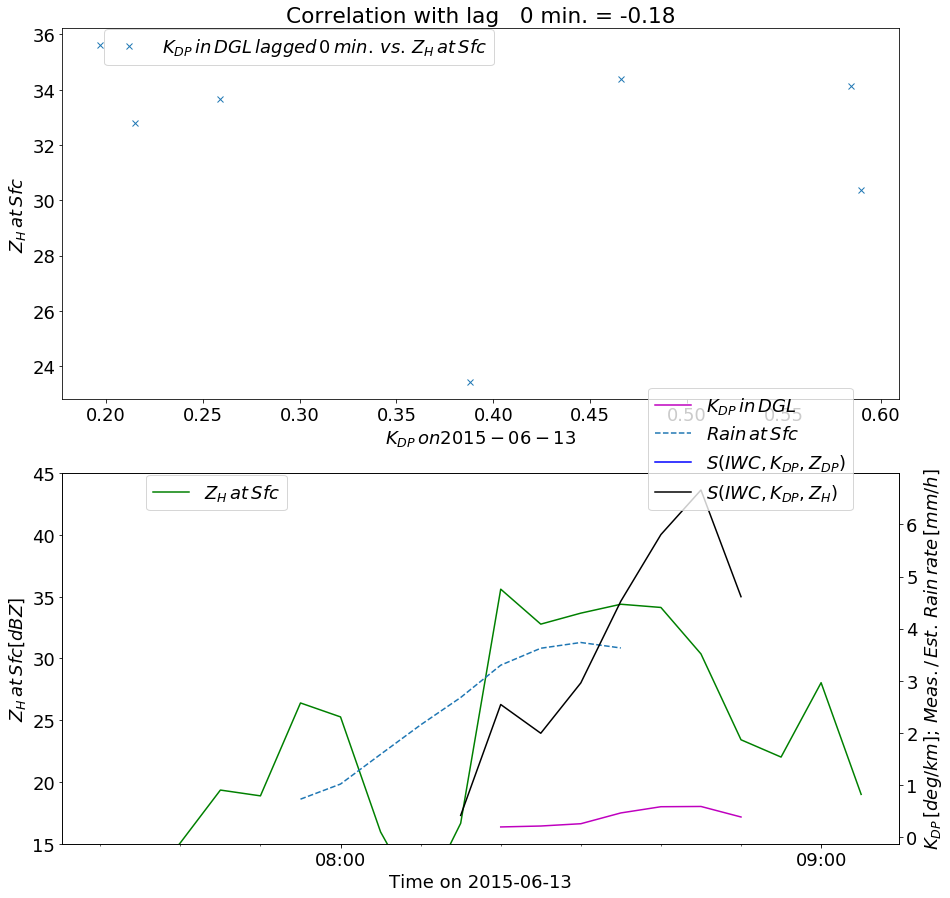

('vorher', -0.661573557676197)
('p-value', 1.3274409278739327e-19)
('p-value', 0.022145784378478955)
('p-value', 0.008696207375425435)
('p-value', 0.011381617072631562)
('p-value', 0.020356724565349316)
('p-value', 0.0012351186672541847)
('p-value', 0.00016700282613344298)
('p-value', 4.240706857537078e-05)
('p-value', 1.3408640549851506e-05)
('p-value', 1.318236343033137e-05)
('p-value', 2.2227149946838243e-05)
('p-value', 6.816556601380522e-06)
('p-value', 1.799420477992041e-05)
('p-value', 6.843596982647311e-05)


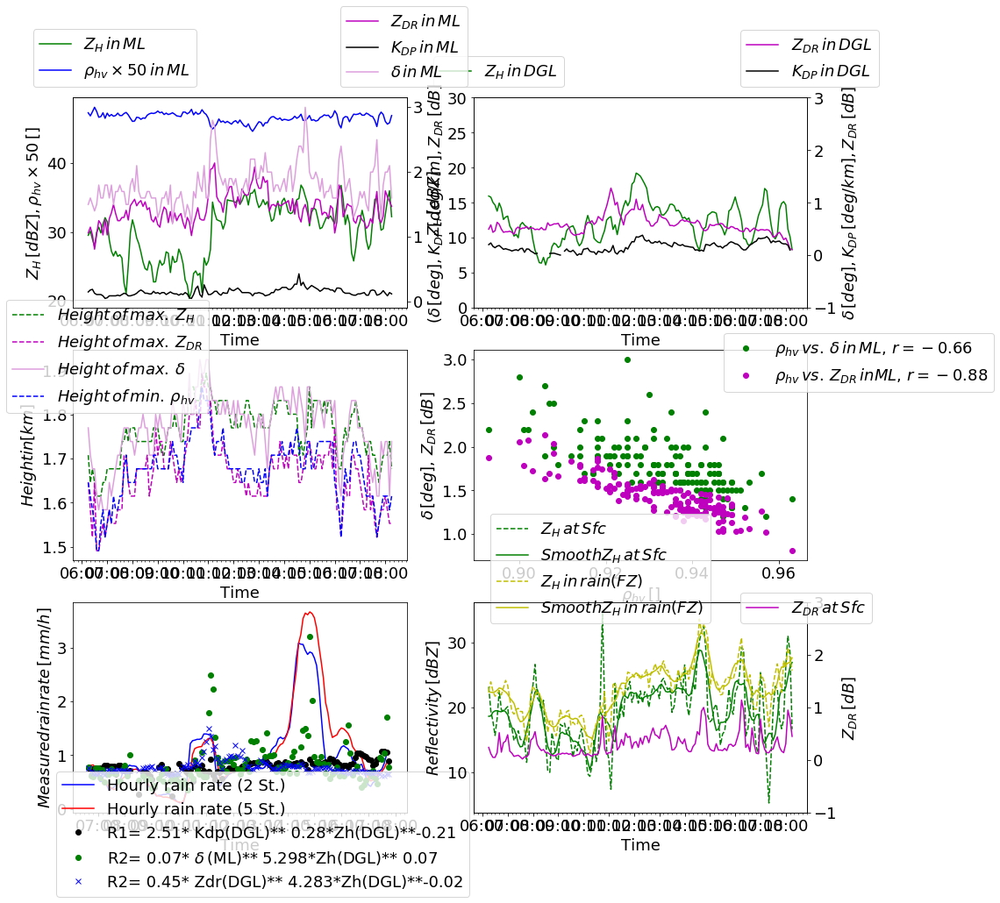

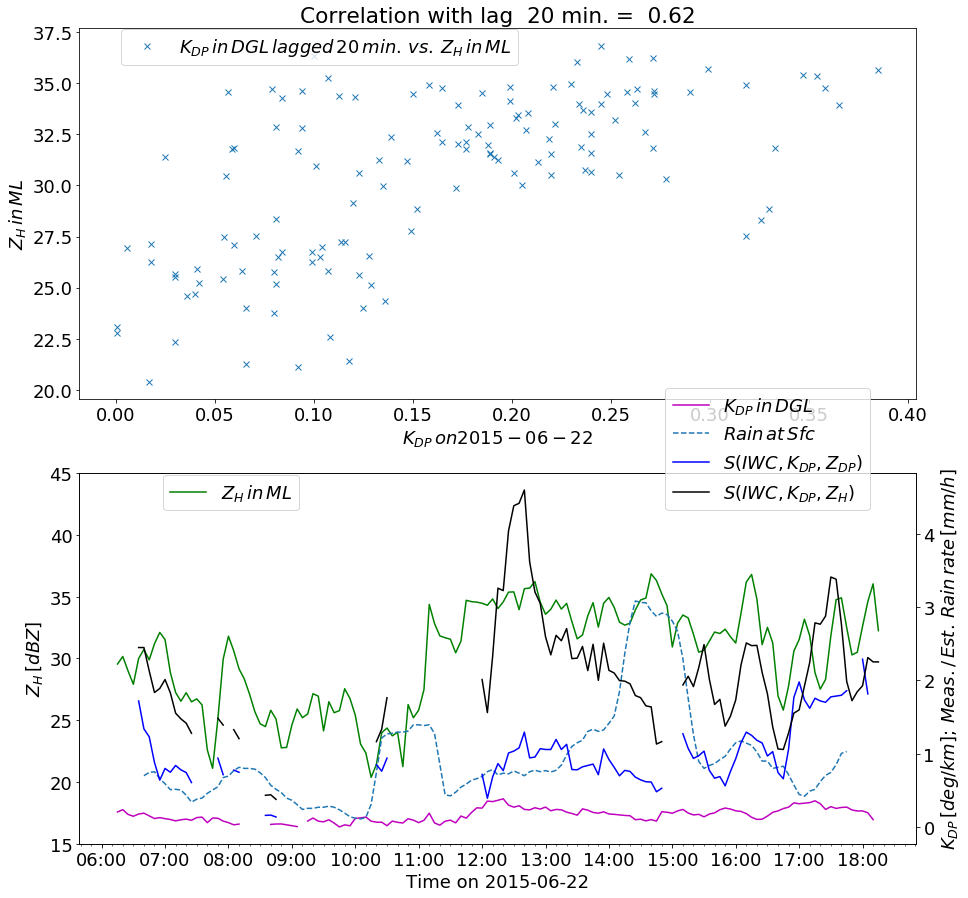

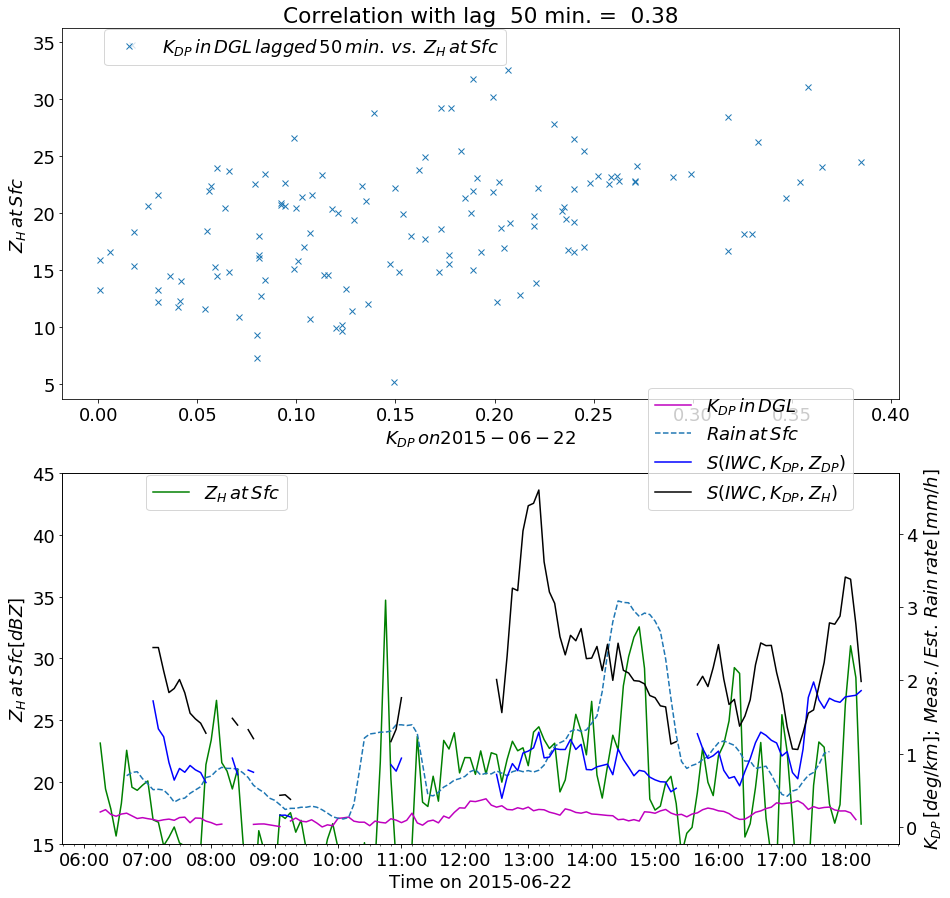

('vorher', -0.7579495679281789)
('p-value', 5.06111508898972e-07)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)
('p-value', 0.0)


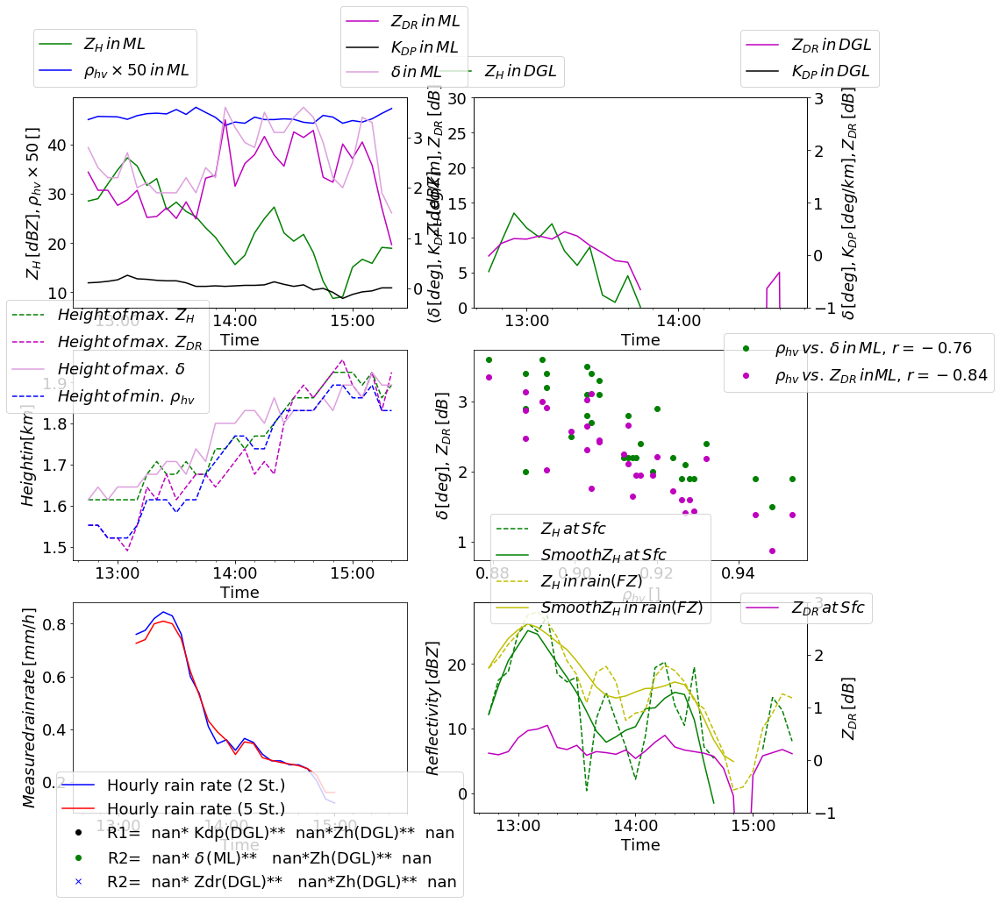

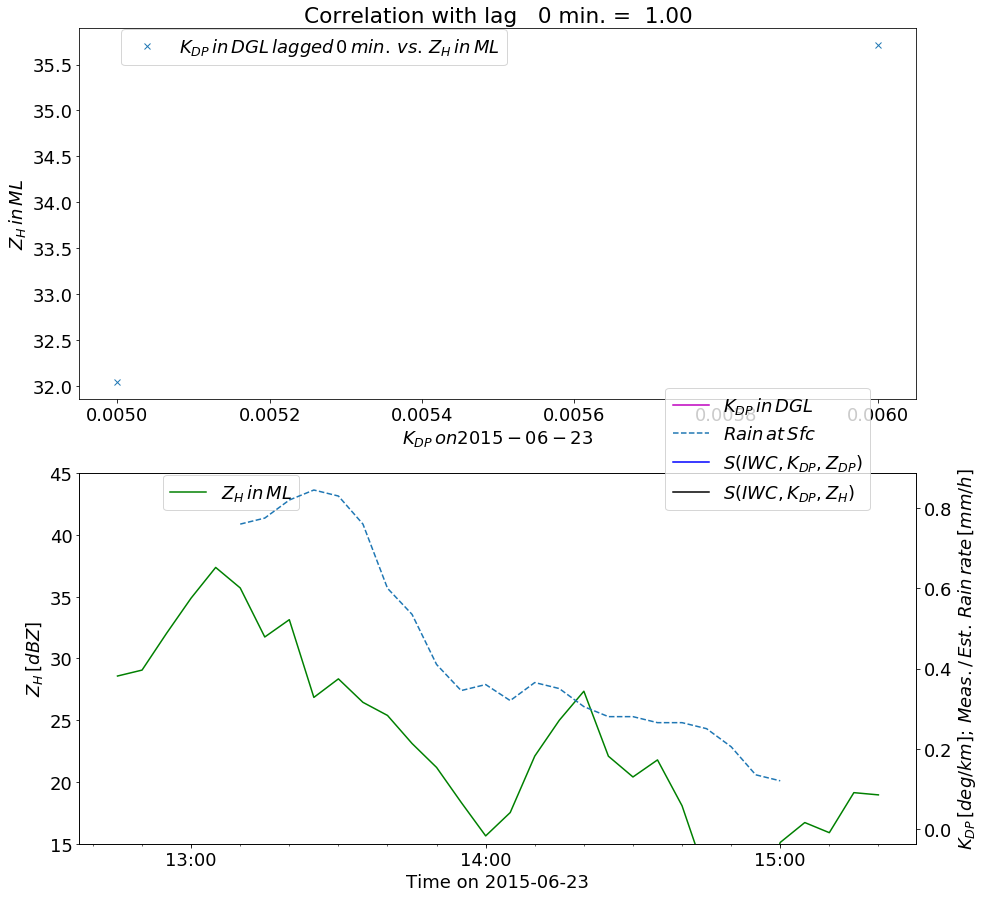

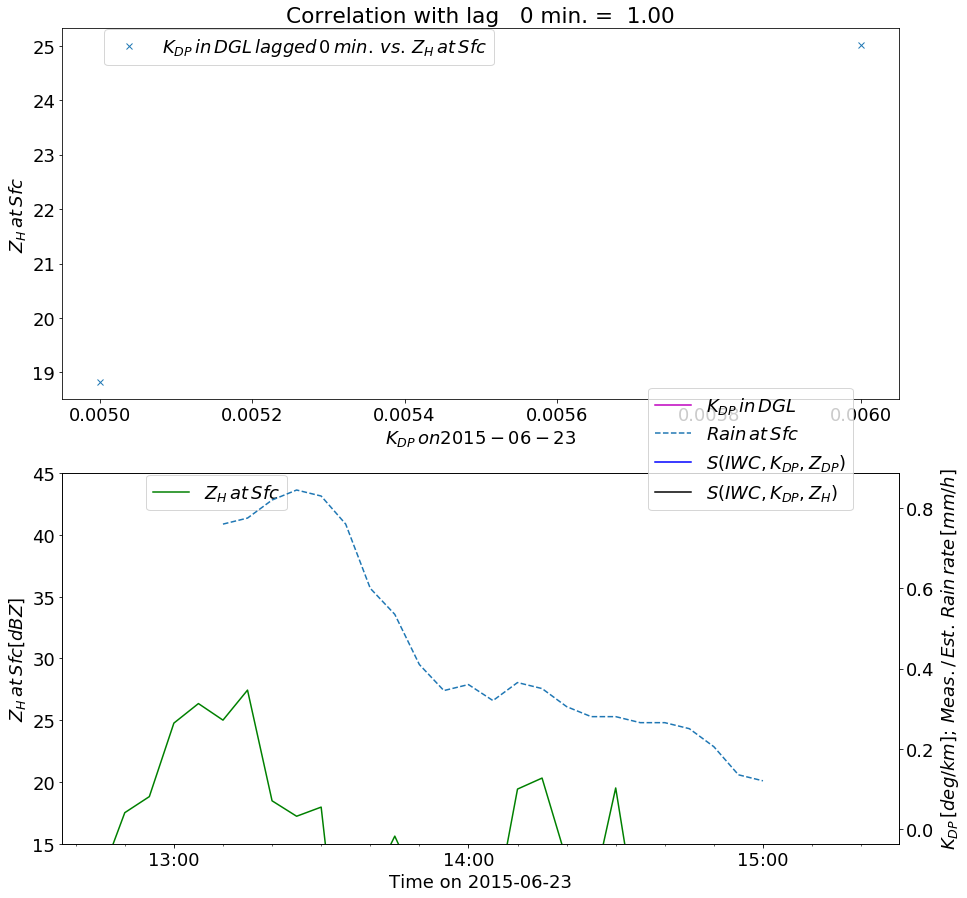

('vorher', -0.5512411128029167)
('p-value', 0.02181274248616823)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)


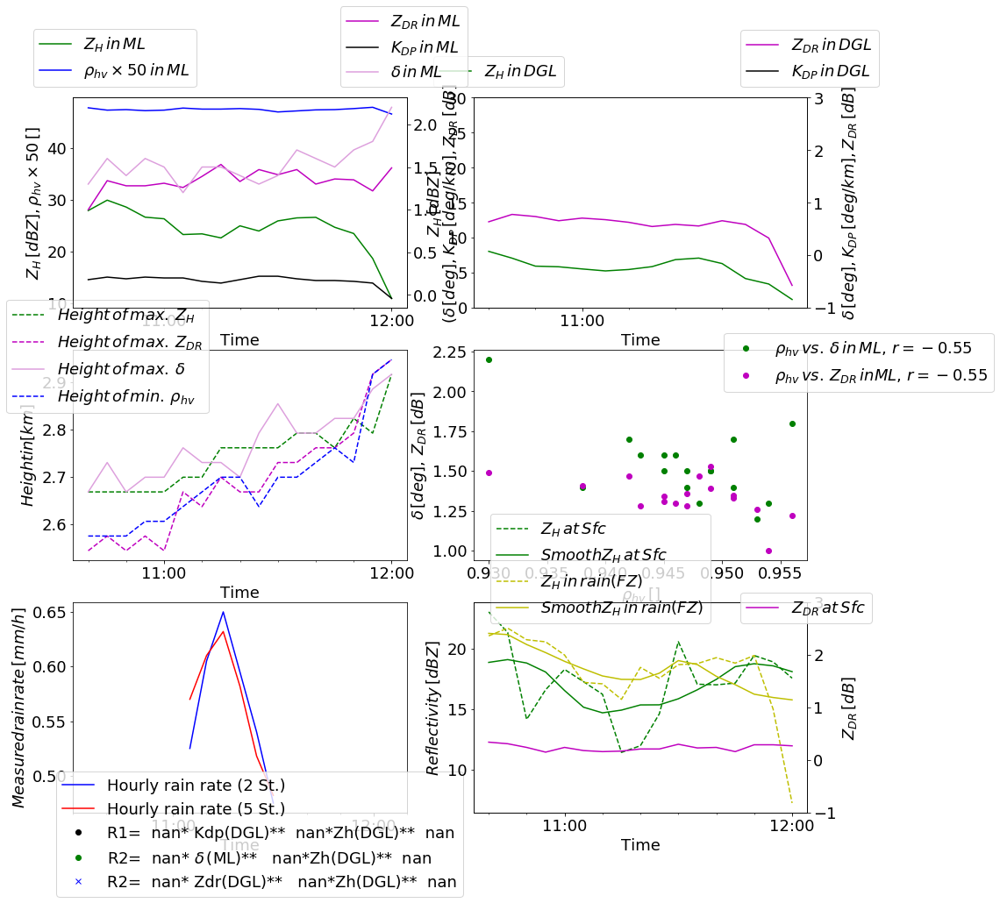

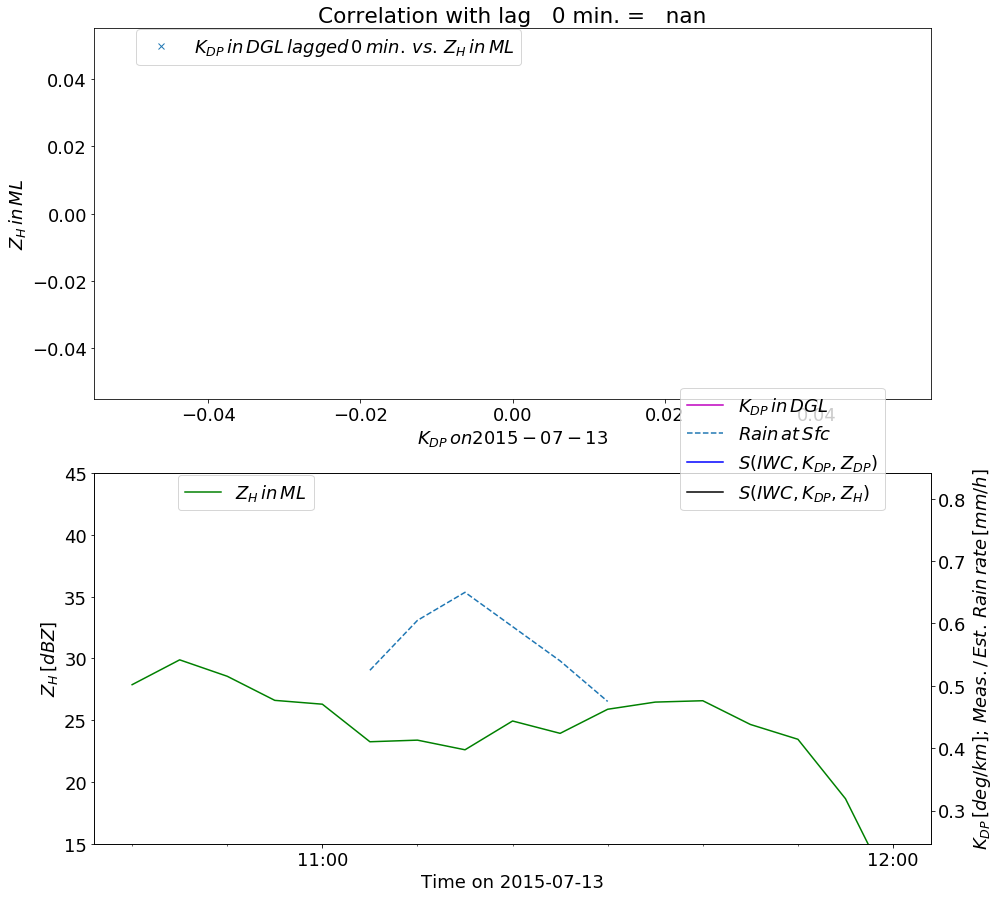

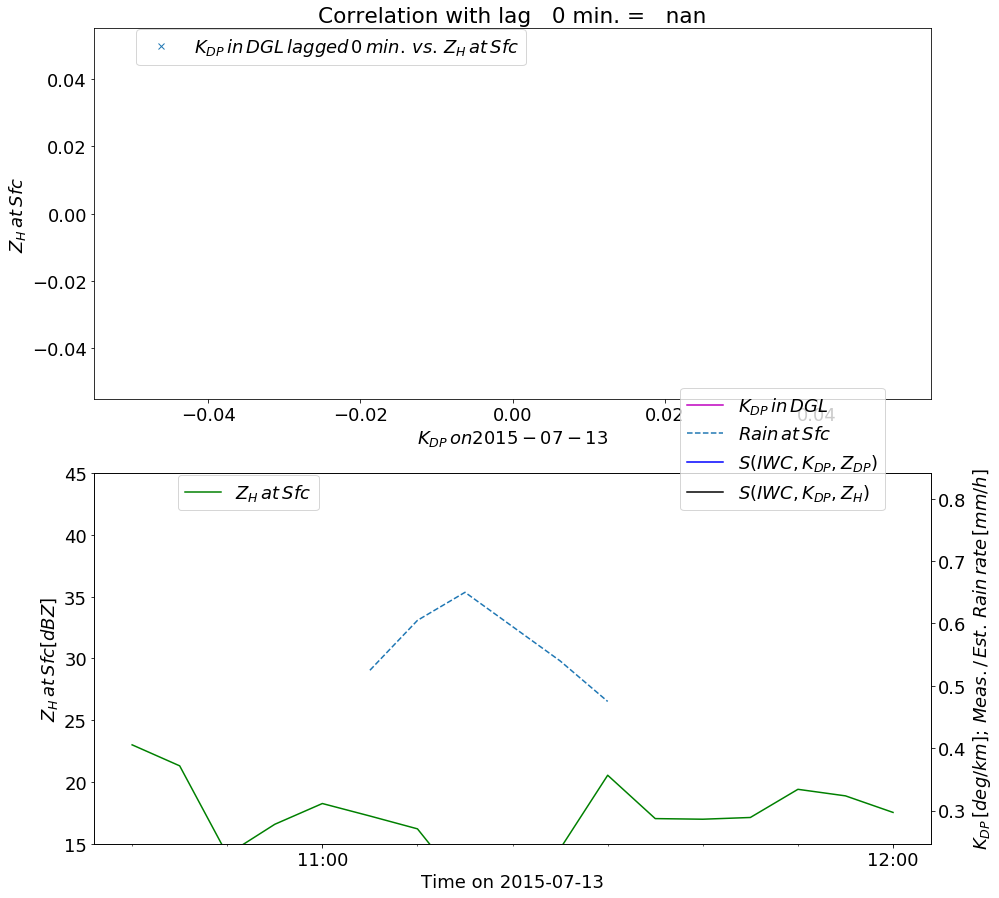

('vorher', -0.06896852671908883)
('p-value', 0.7432305172723472)
('p-value', 9.707822155908695e-07)
('p-value', 1.2939998427203804e-06)
('p-value', 9.995607272770189e-05)
('p-value', 0.000602802431208708)
('p-value', 0.003791624835016434)
('p-value', 0.011588141715869074)
('p-value', 0.2963001675491059)
('p-value', 0.8117399544905822)
('p-value', 0.5831540256730343)
('p-value', 0.30415157870217296)
('p-value', 0.4289320501726046)
('p-value', 0.9347213606937534)
('p-value', 0.3791328628208551)


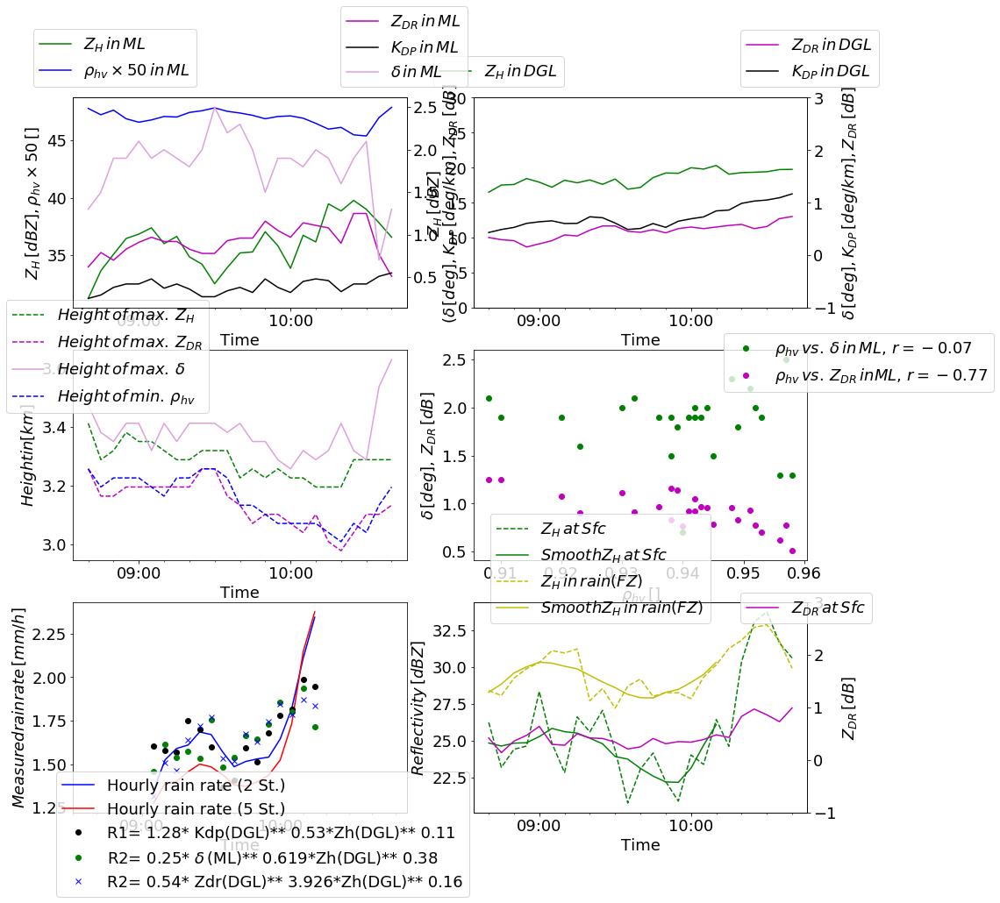

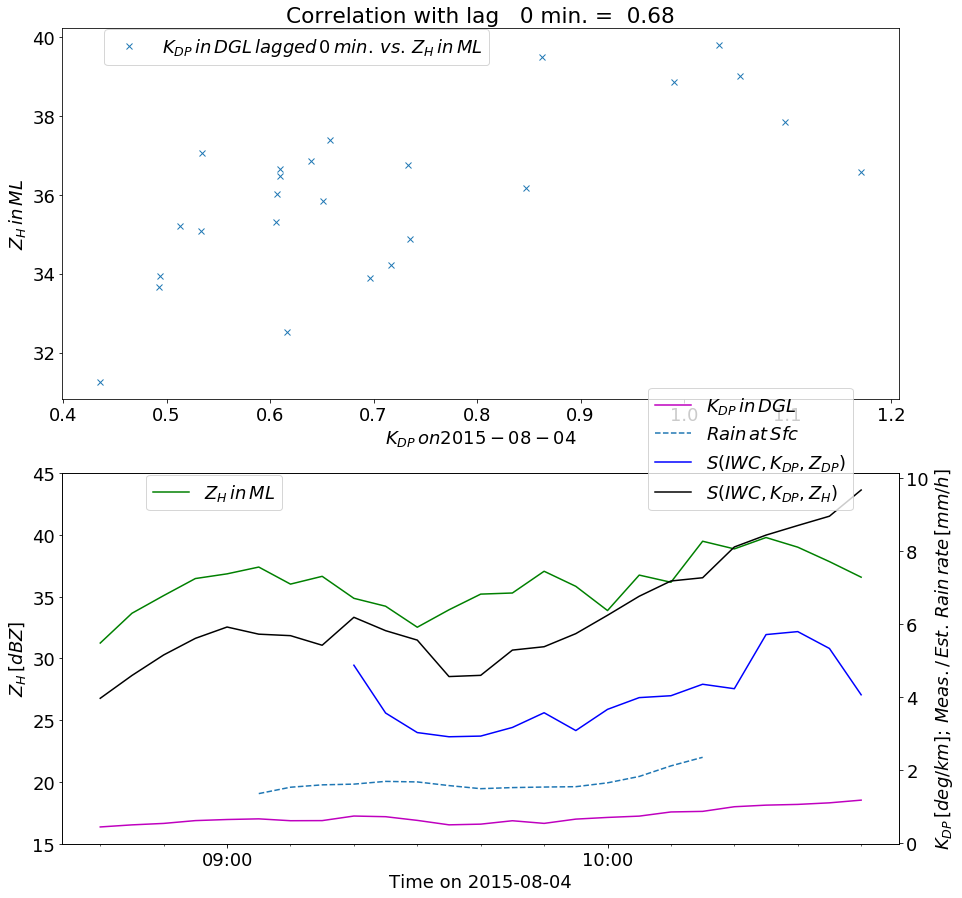

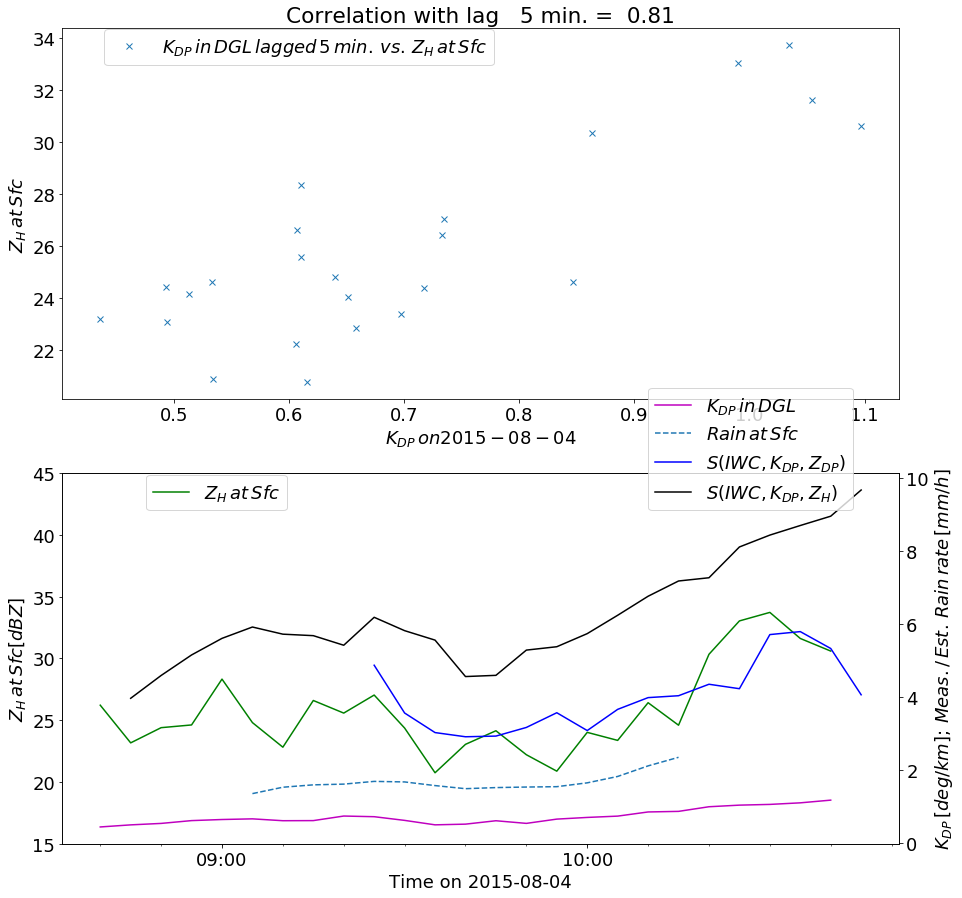

('vorher', -0.19764270247074342)
('p-value', 0.39046710491418657)
('p-value', 0.8116405466296138)
('p-value', 0.40244953780523474)
('p-value', 0.9071727780725802)
('p-value', 0.3853336669425273)
('p-value', 0.8411778265135957)
('p-value', 0.16944053708376072)
('p-value', 0.8503971592101778)
('p-value', 0.571785585302519)
('p-value', 0.0006945549952128811)
('p-value', 0.02482041476457198)
('p-value', 0.5425185206633802)
('p-value', 0.5604573313772994)
('p-value', 0.28307752214665194)


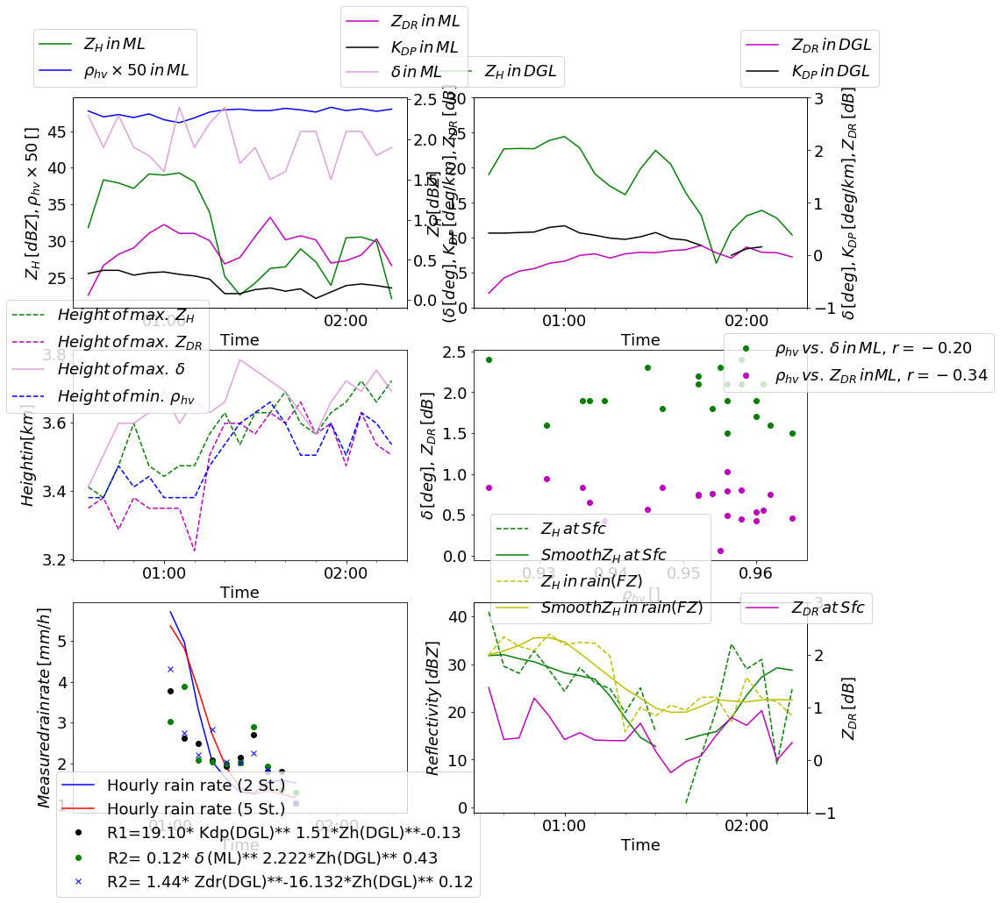

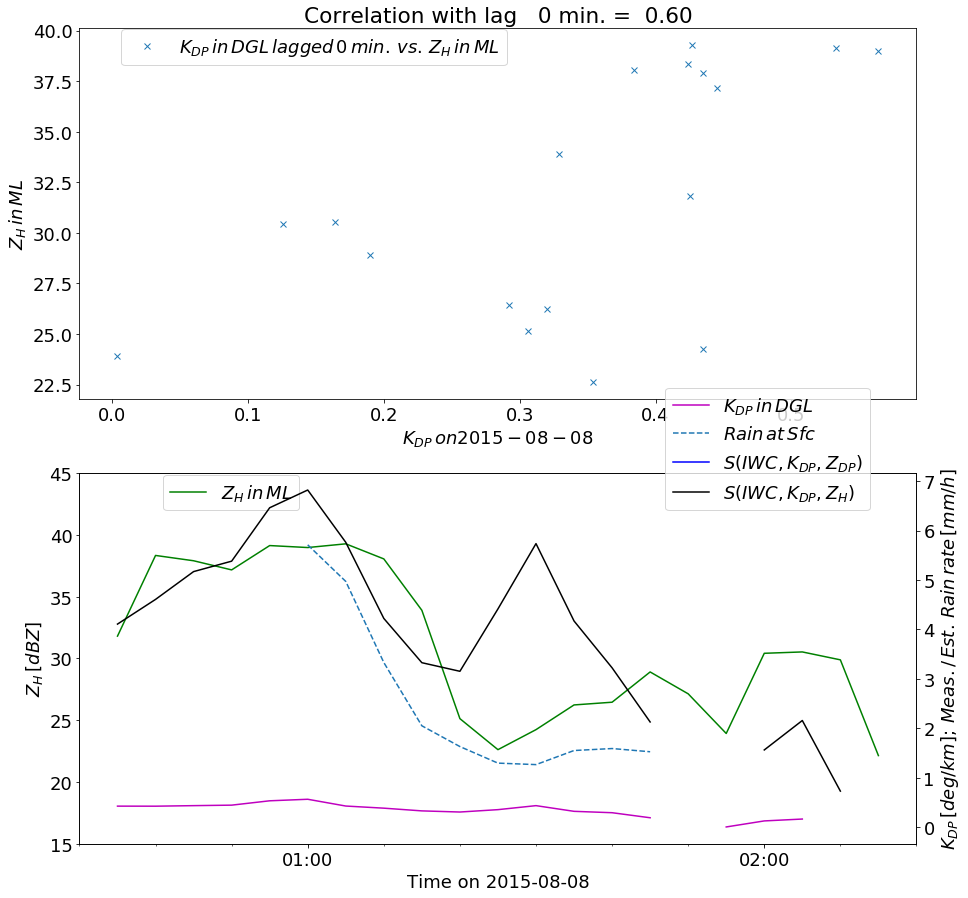

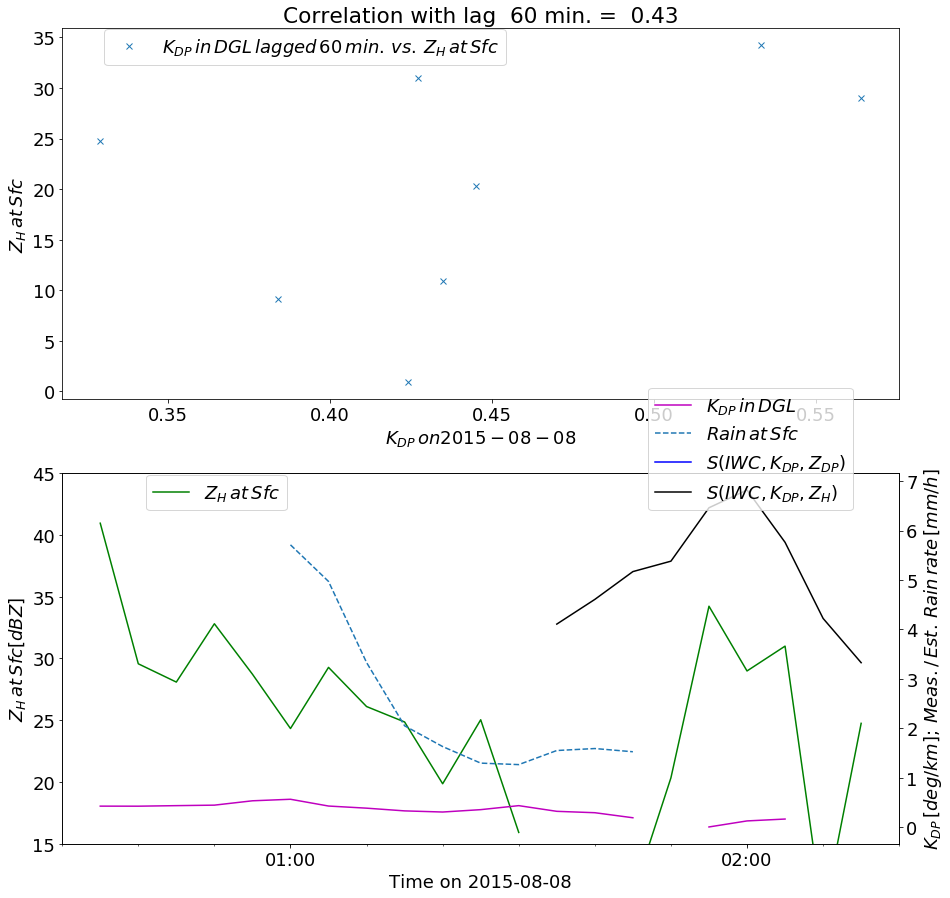

('vorher', -0.7107434151166274)
('p-value', 2.302441058946856e-11)
('p-value', 0.0018088809434850042)
('p-value', 0.010911517341457117)
('p-value', 0.009188360753486379)
('p-value', 0.000821625183348435)
('p-value', 0.0006469928271662155)
('p-value', 0.000825541117949778)
('p-value', 3.82715507057885e-06)
('p-value', 2.9083714220192334e-06)
('p-value', 3.9861936564331504e-05)
('p-value', 7.349805971860686e-05)
('p-value', 4.8089069515336716e-06)
('p-value', 6.196636282753518e-05)
('p-value', 0.0004461139001806101)


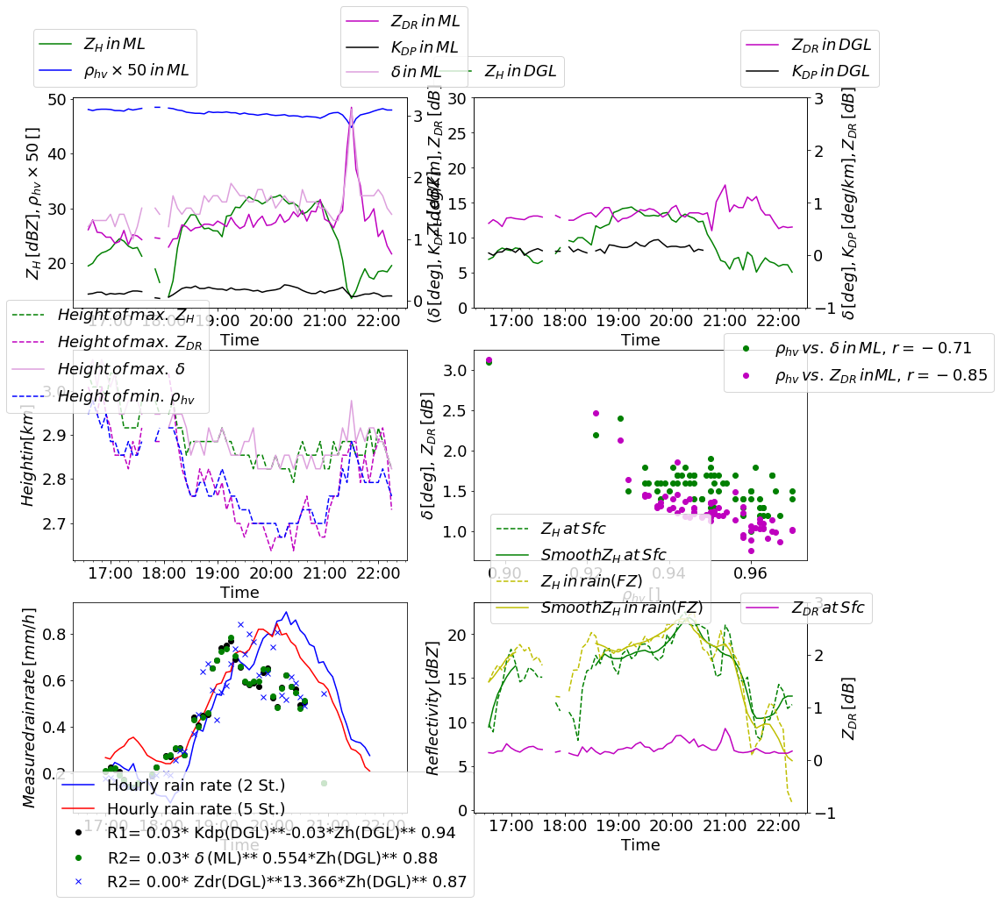

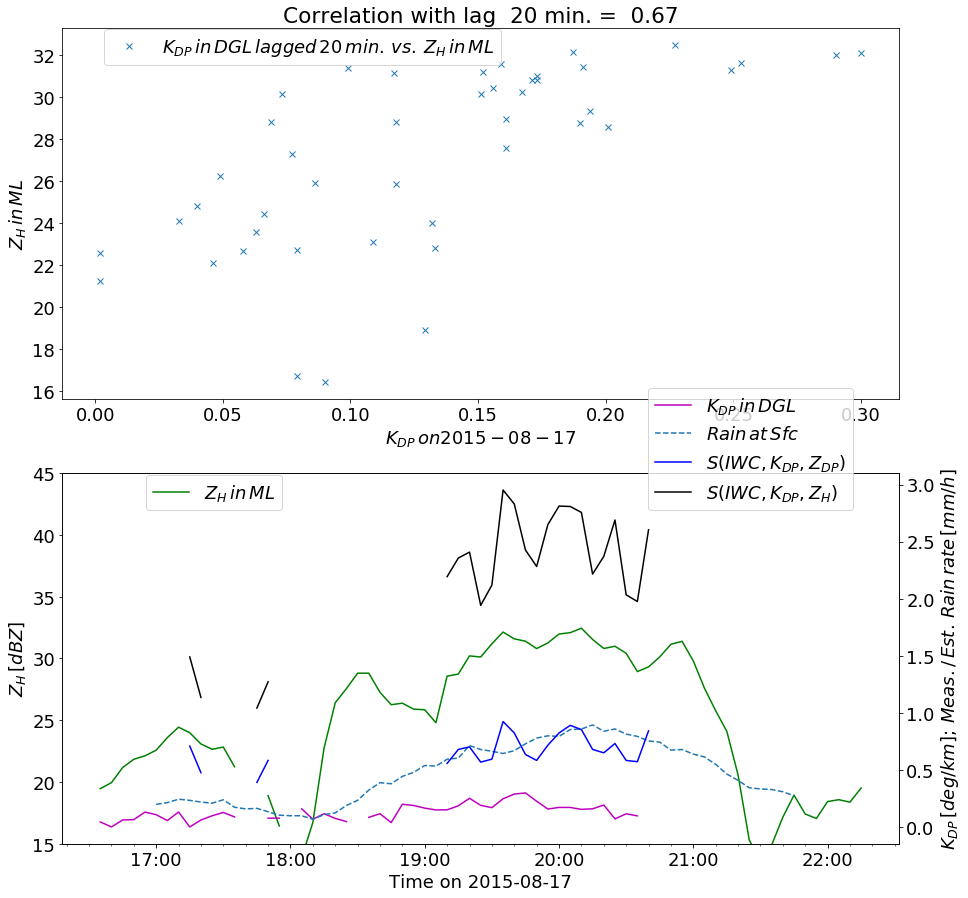

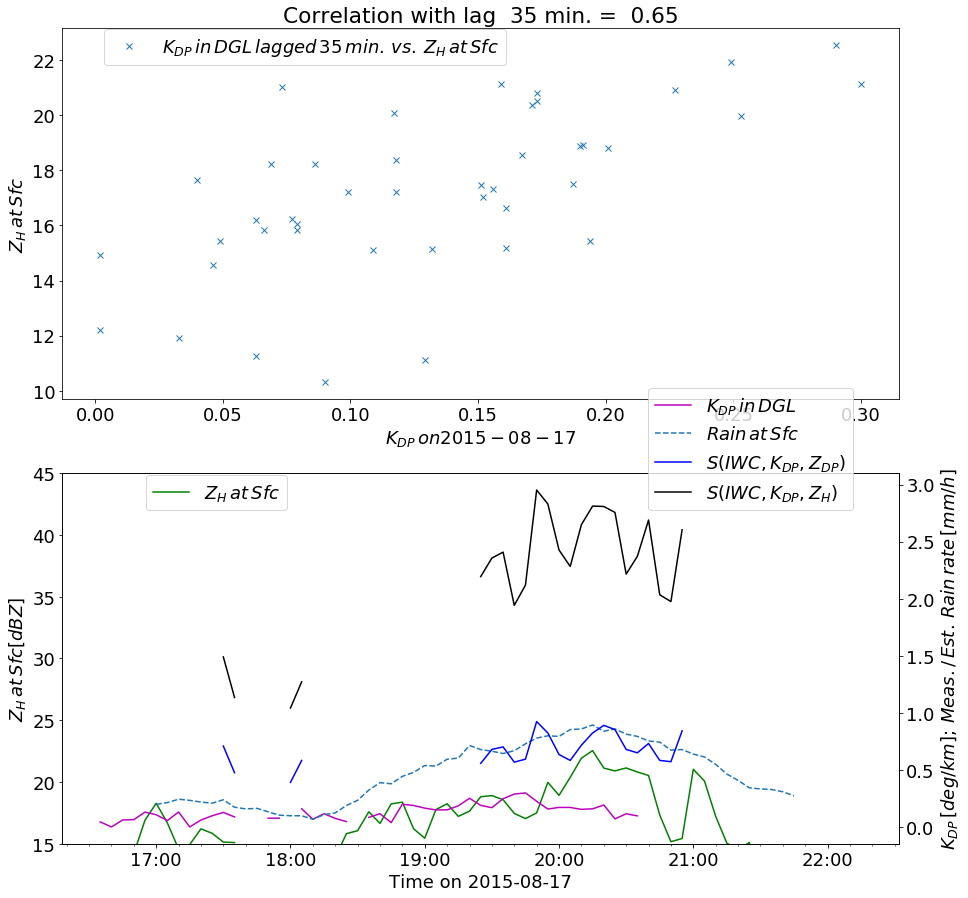

('vorher', -0.31219396919006615)
('p-value', 0.0005472437888653301)
('p-value', 0.06157678220517751)
('p-value', 0.0835511541710415)
('p-value', 0.4010640811166447)
('p-value', 0.2850453176097834)
('p-value', 0.25848203515122)
('p-value', 0.7202720722088745)
('p-value', 0.8064564999836923)
('p-value', 0.9602611634532837)
('p-value', 0.47522037628832436)
('p-value', 0.5996675238225968)
('p-value', 0.3142718786220418)
('p-value', 0.7261945627039121)
('p-value', 0.7891848500398536)


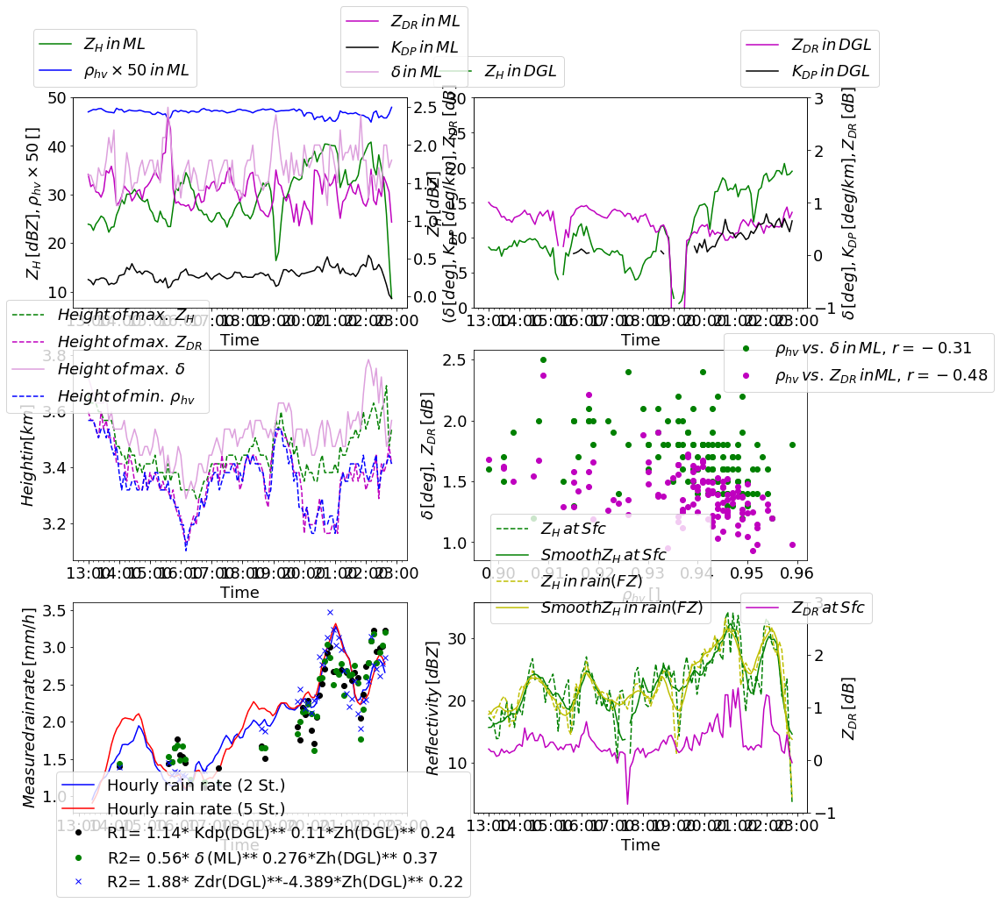

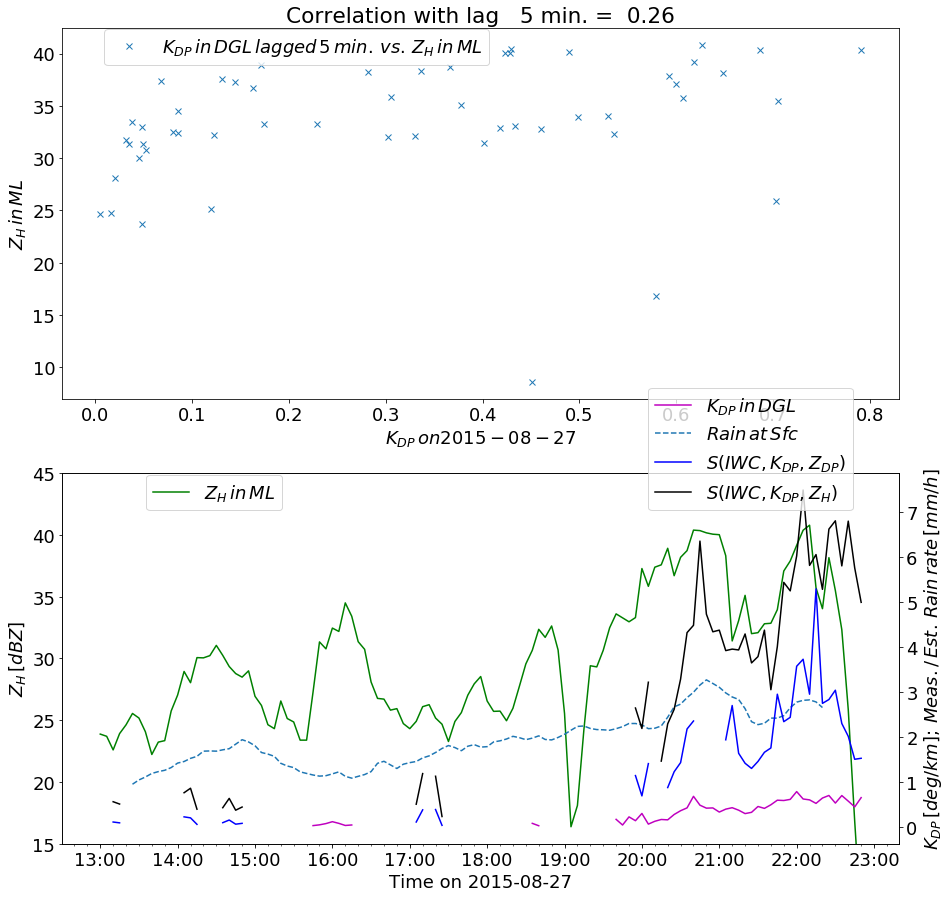

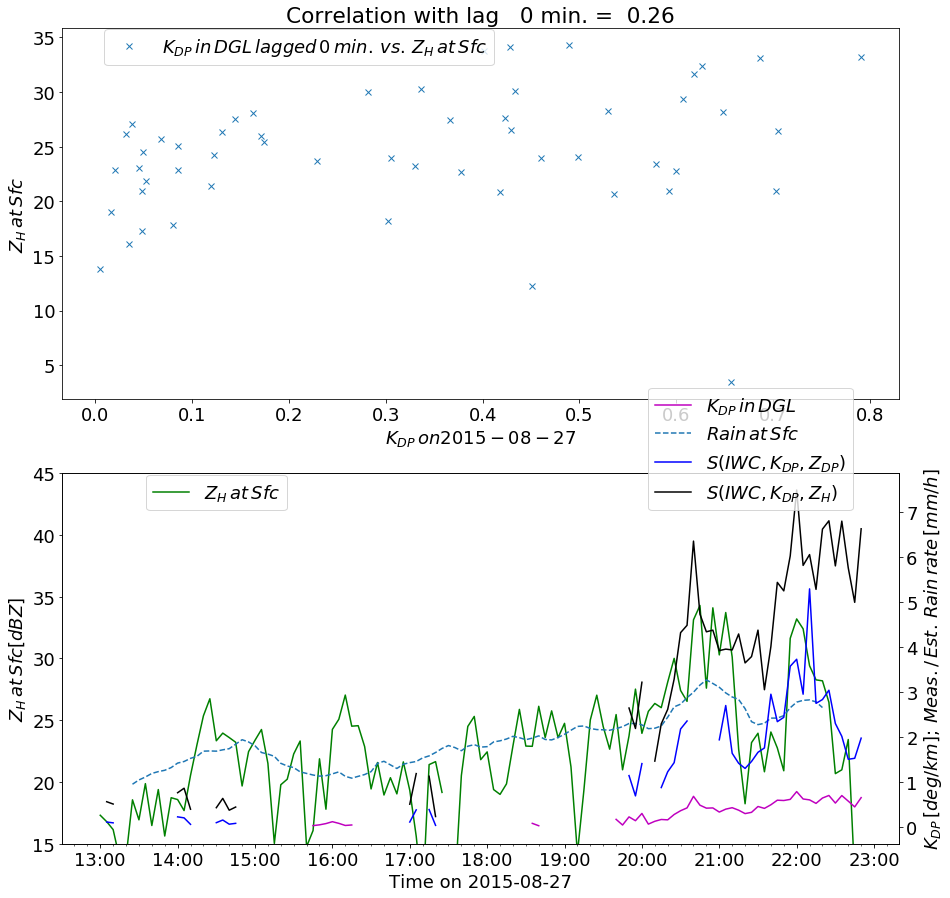

('vorher', -0.6598121885307621)
('p-value', 2.803024363964548e-11)
('p-value', 0.0008017840803305589)
('p-value', 2.462456100721868e-05)
('p-value', 5.8586271237297924e-08)
('p-value', 5.581034616499751e-08)
('p-value', 7.93975693971055e-07)
('p-value', 2.181046095802605e-06)
('p-value', 0.00011390714075933399)
('p-value', 0.0021936655400093216)
('p-value', 0.020659811210744904)
('p-value', 0.2314631928130817)
('p-value', 0.8201001578805638)
('p-value', 0.3894676199030188)
('p-value', 0.08733388978492858)


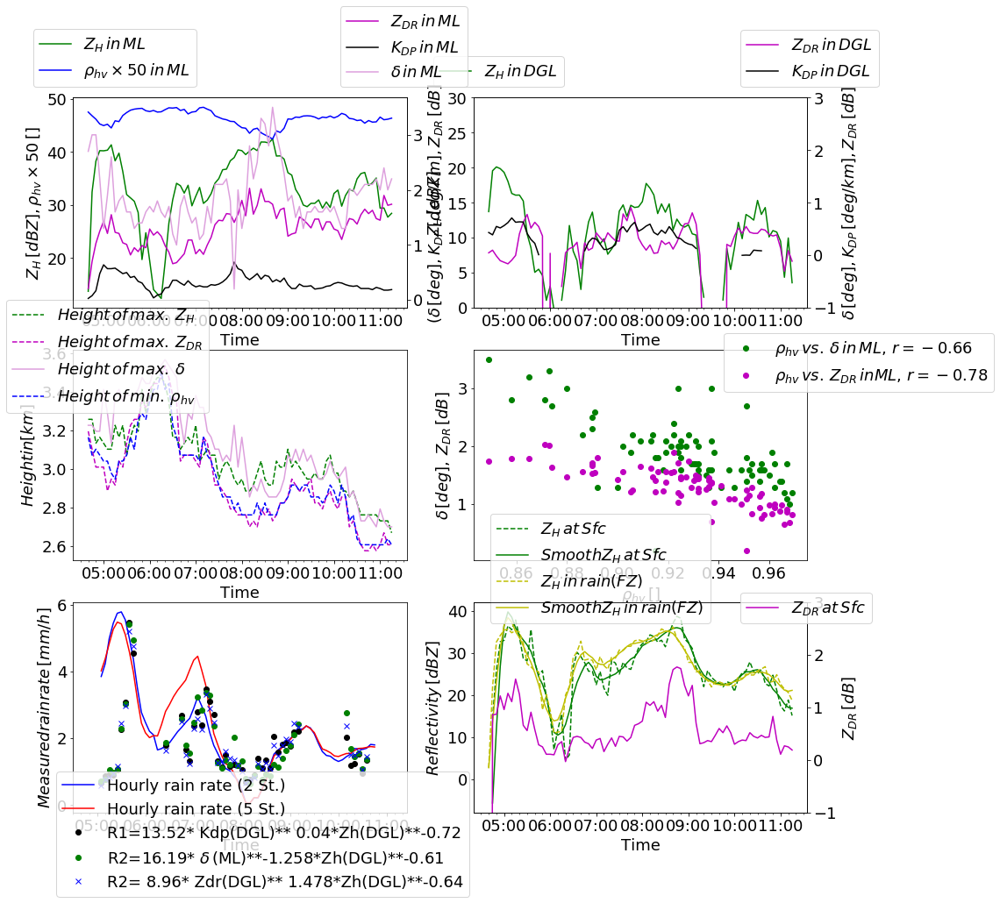

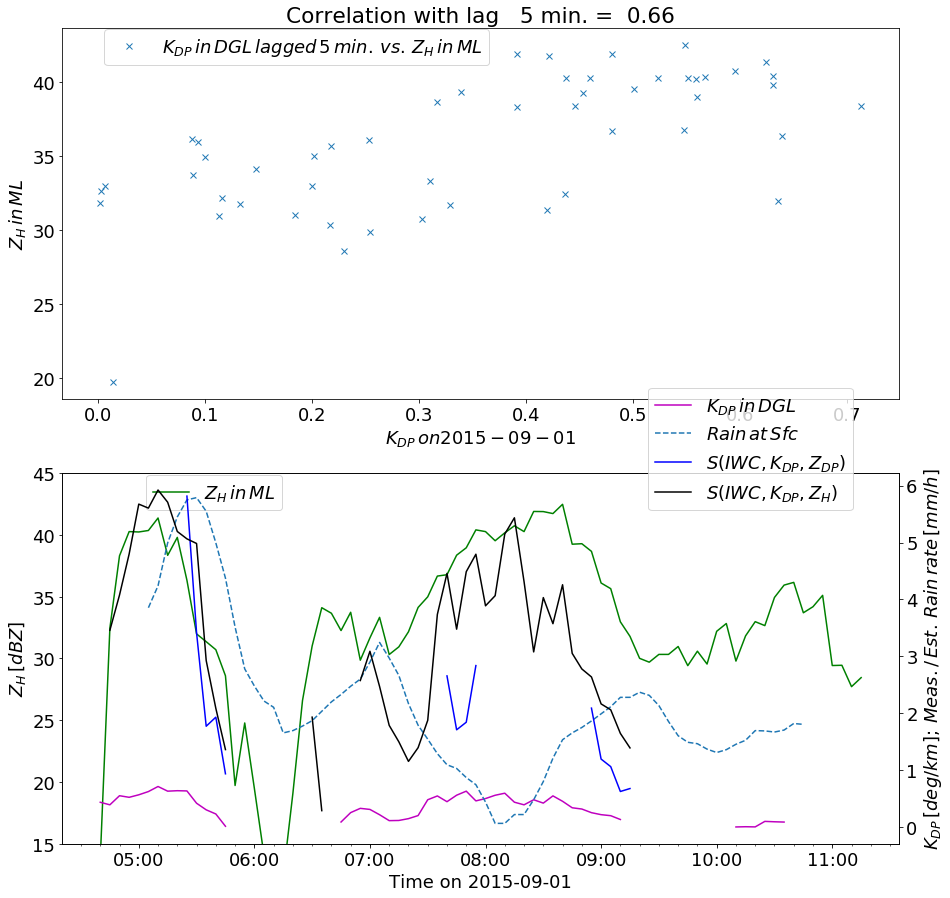

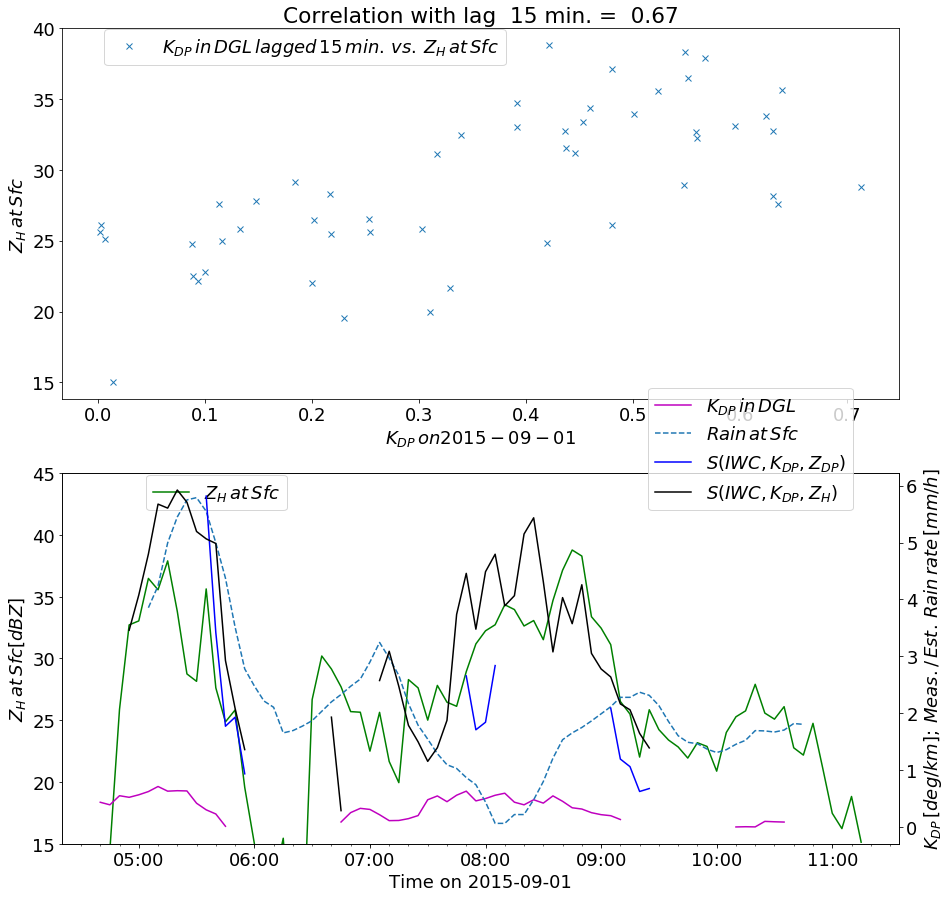

('vorher', -0.8586286791189564)
('p-value', 4.206384861225543e-11)
('p-value', 0.9530825279222772)
('p-value', 0.6156529511635868)
('p-value', 0.2797670416319423)
('p-value', 0.021578378267799)
('p-value', 0.00013675606488378674)
('p-value', 4.4235731990340585e-06)
('p-value', 4.619609244628162e-05)
('p-value', 0.002022185689028149)
('p-value', 0.057891942575203)
('p-value', 0.383548091151207)
('p-value', 0.965911570942338)
('p-value', 0.5578059994084384)
('p-value', 0.27141238542161195)


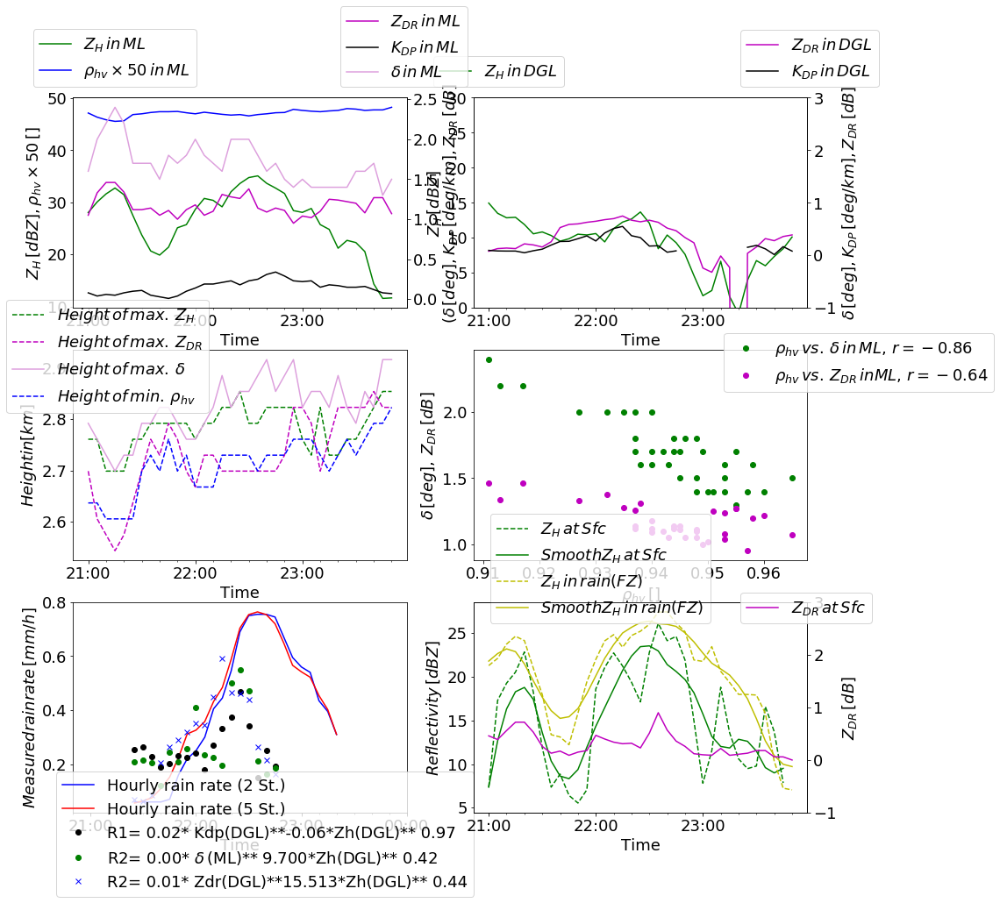

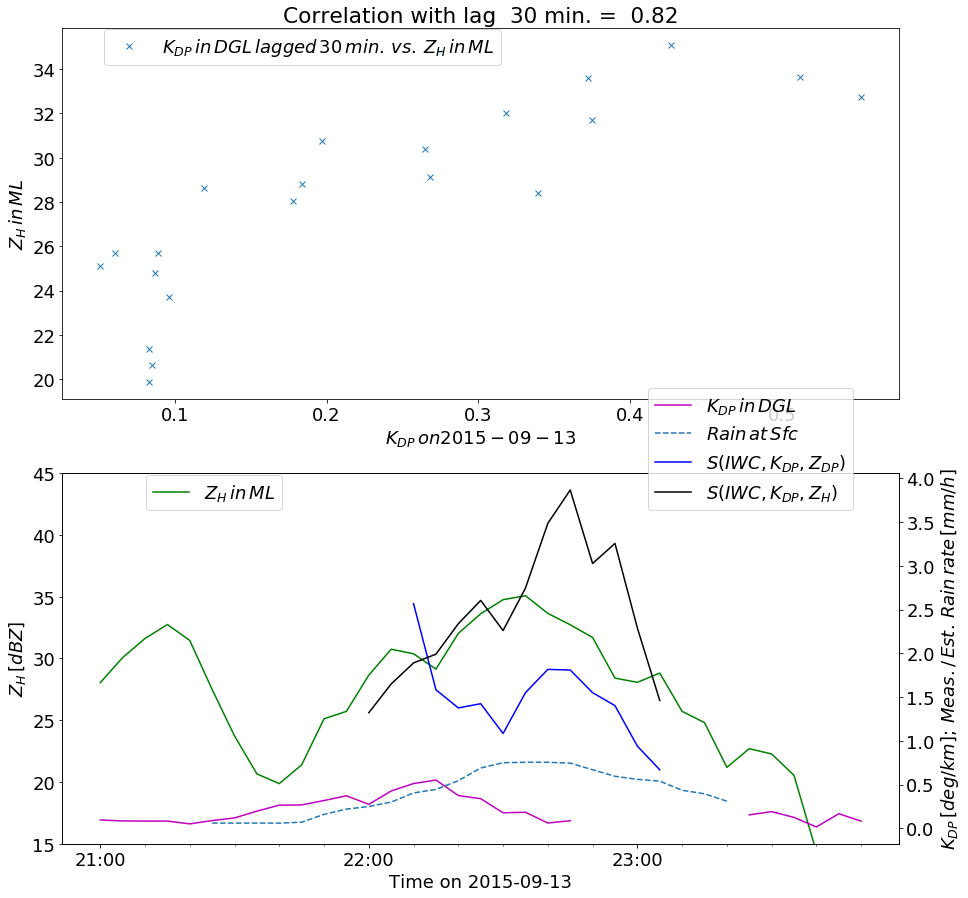

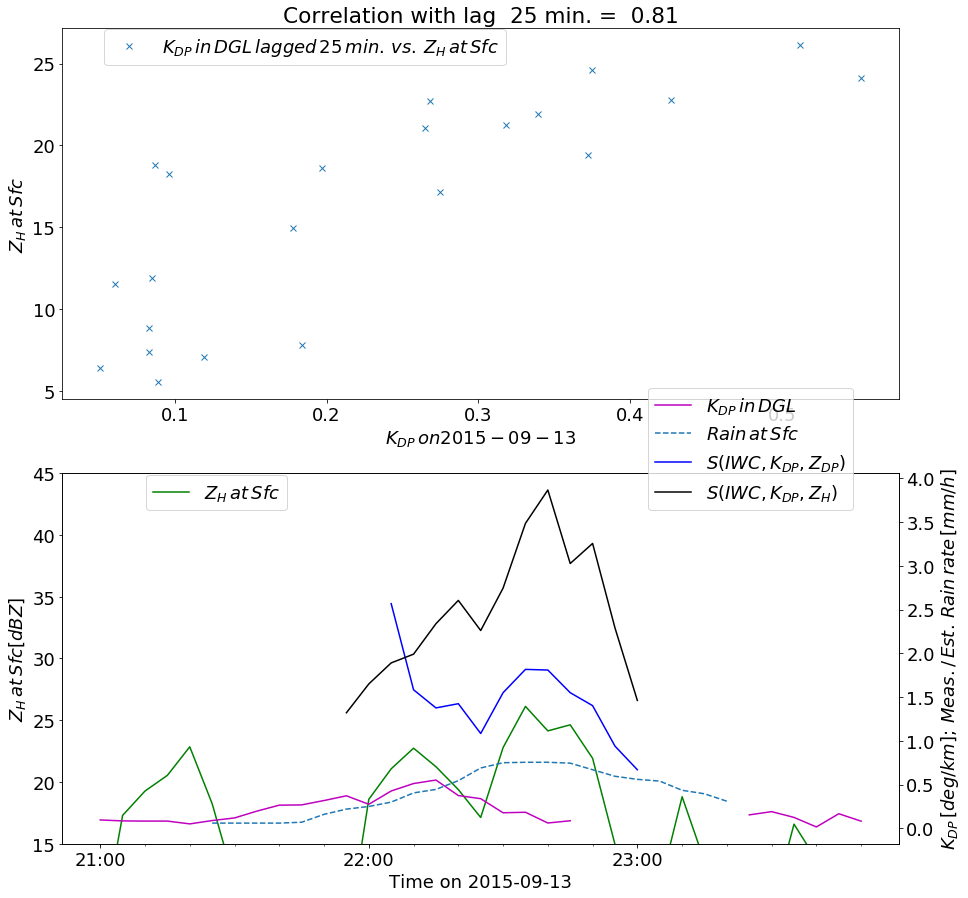

('vorher', -0.6204833970276344)
('p-value', 7.200472893125056e-07)
('p-value', 0.0015413766478962648)
('p-value', 0.0006828549254157729)
('p-value', 0.0002728405249341645)
('p-value', 0.0008080893442017323)
('p-value', 0.03466380548940353)
('p-value', 0.5140619216275263)
('p-value', 0.12145194621535134)
('p-value', 0.3089782640542232)
('p-value', 0.045121861192531296)
('p-value', 0.07307540591227922)
('p-value', 0.007211128754198484)
('p-value', 0.04980375537131395)
('p-value', 0.09945979301747056)


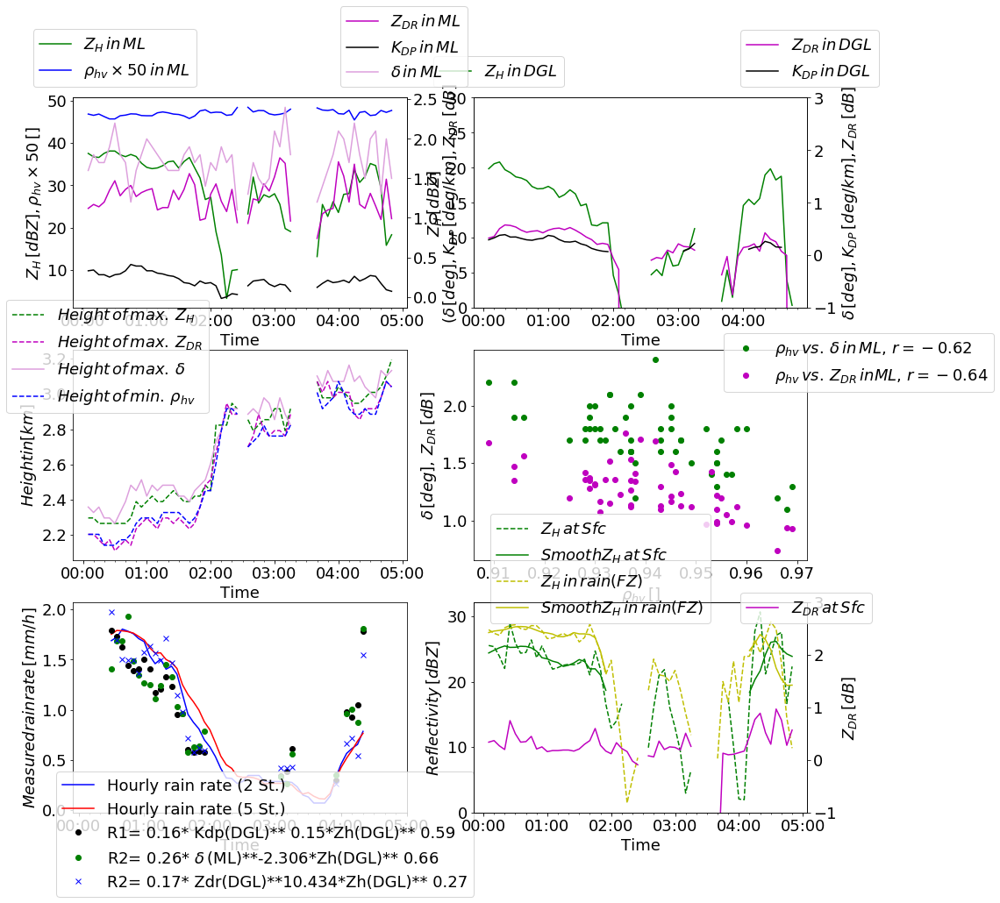

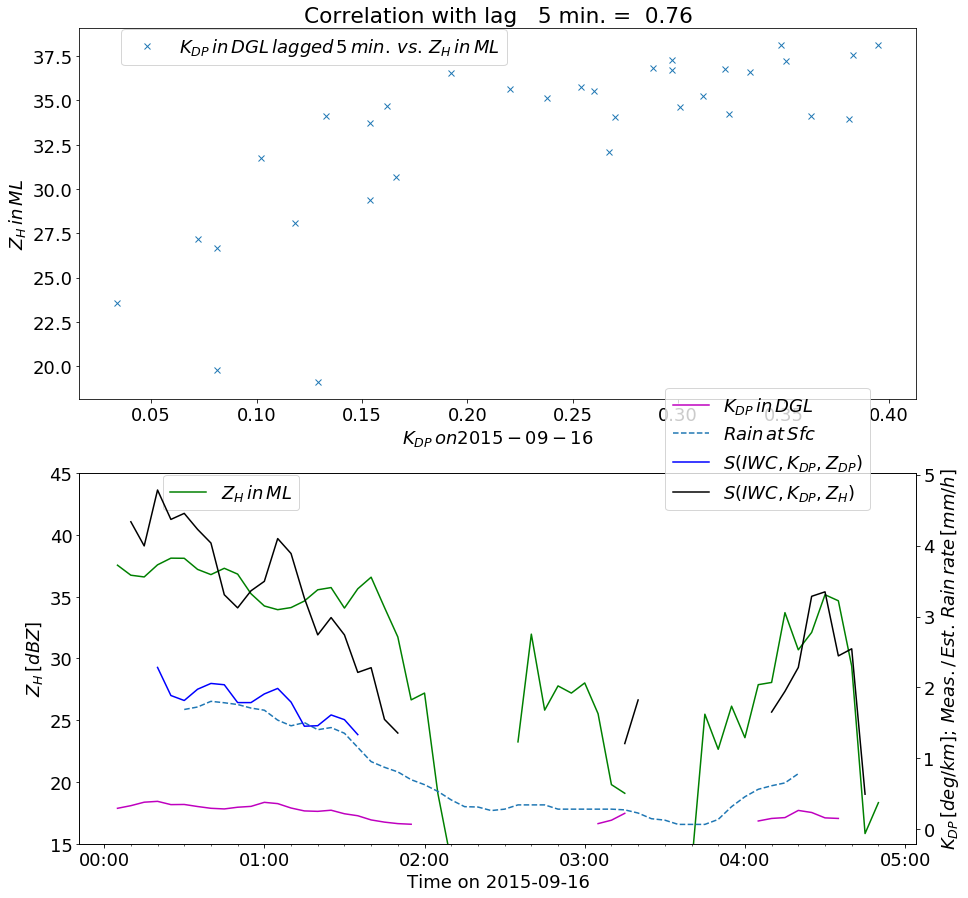

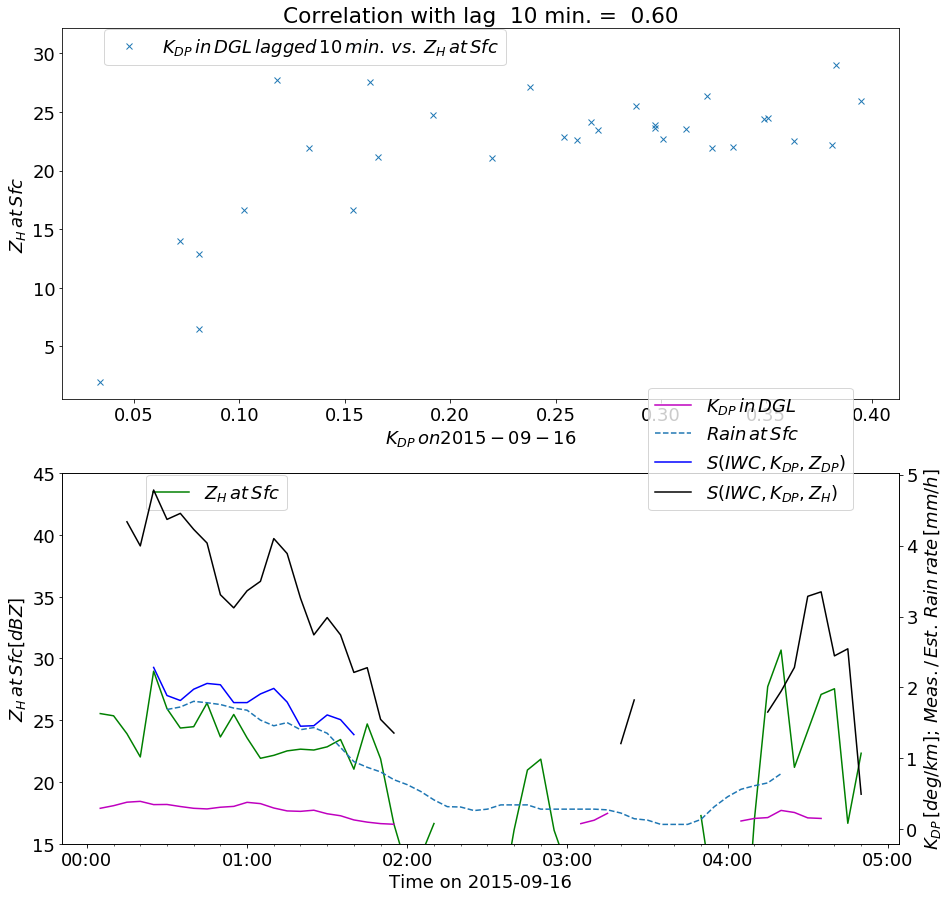

('vorher', -0.535645009625481)
('p-value', 0.00021432939446970118)
('p-value', 0.0033356809924188846)
('p-value', 0.02195560939409823)
('p-value', 0.016343258053724788)
('p-value', 0.06397848374793662)
('p-value', 0.3523385621561186)
('p-value', 0.941929627882605)
('p-value', 0.4744015505441267)
('p-value', 0.8000169675514565)
('p-value', 0.5312860219453779)
('p-value', 0.2715907753759505)
('p-value', 0.43029147189997785)
('p-value', 0.42639805168103184)
('p-value', 0.4267004304622638)


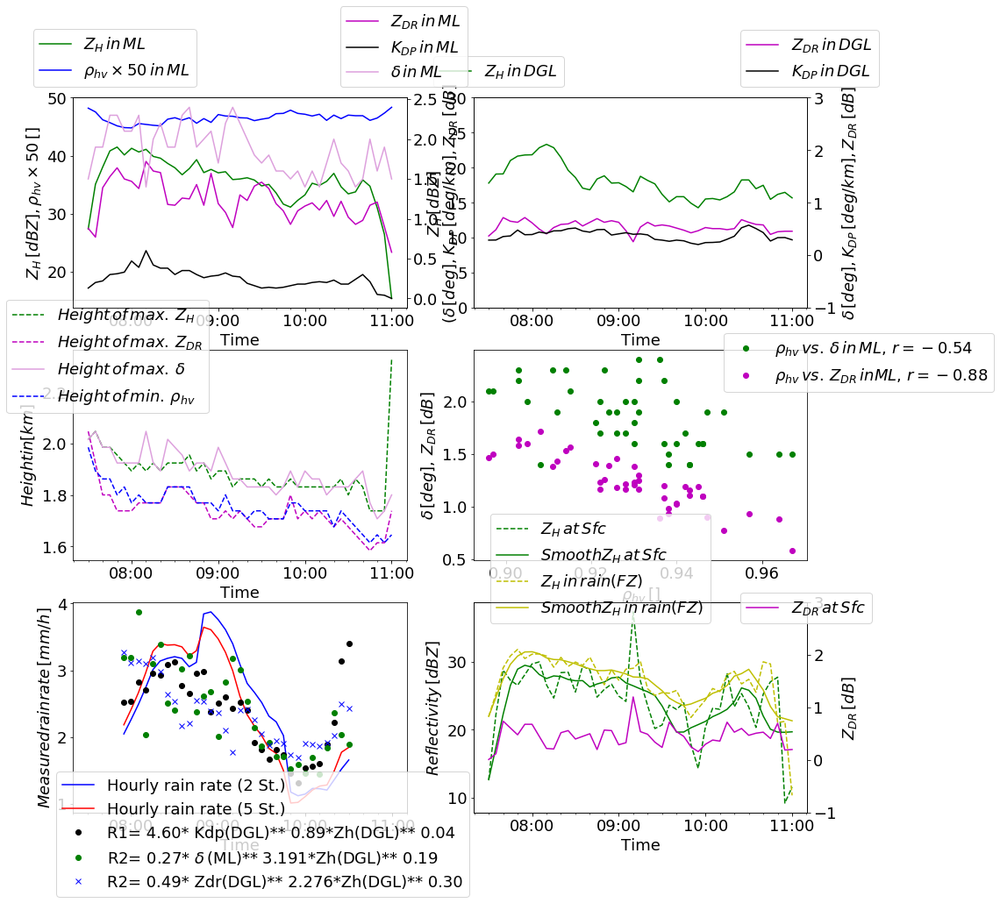

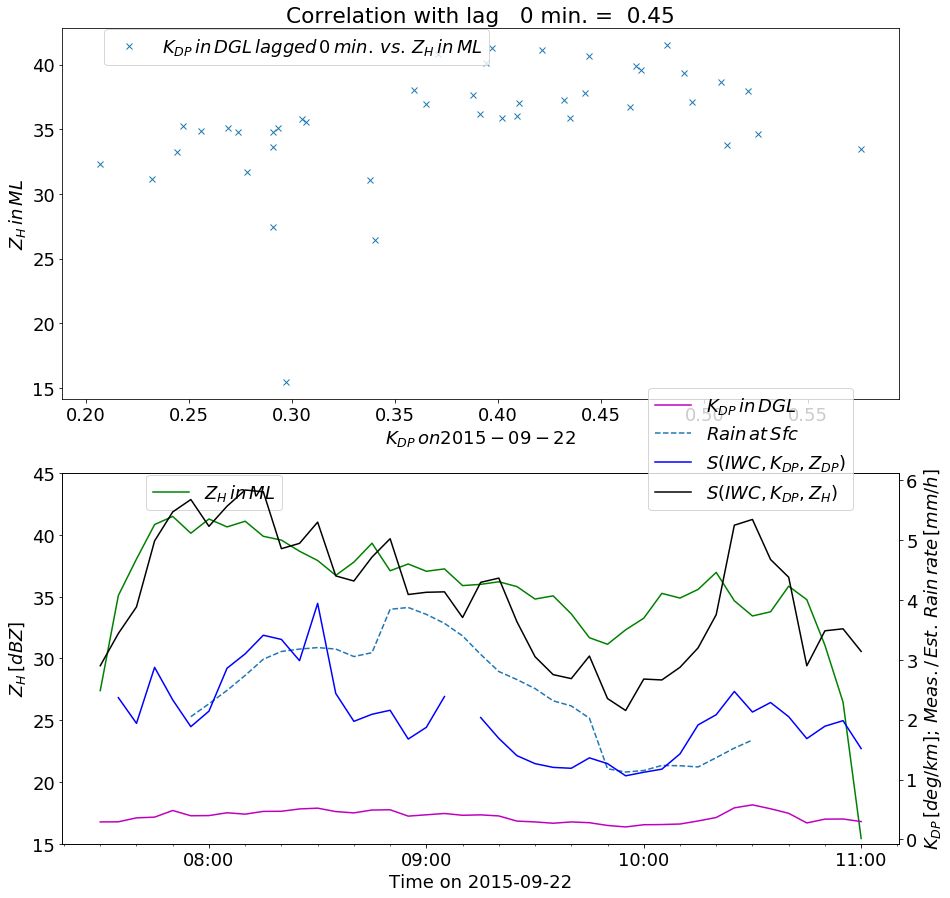

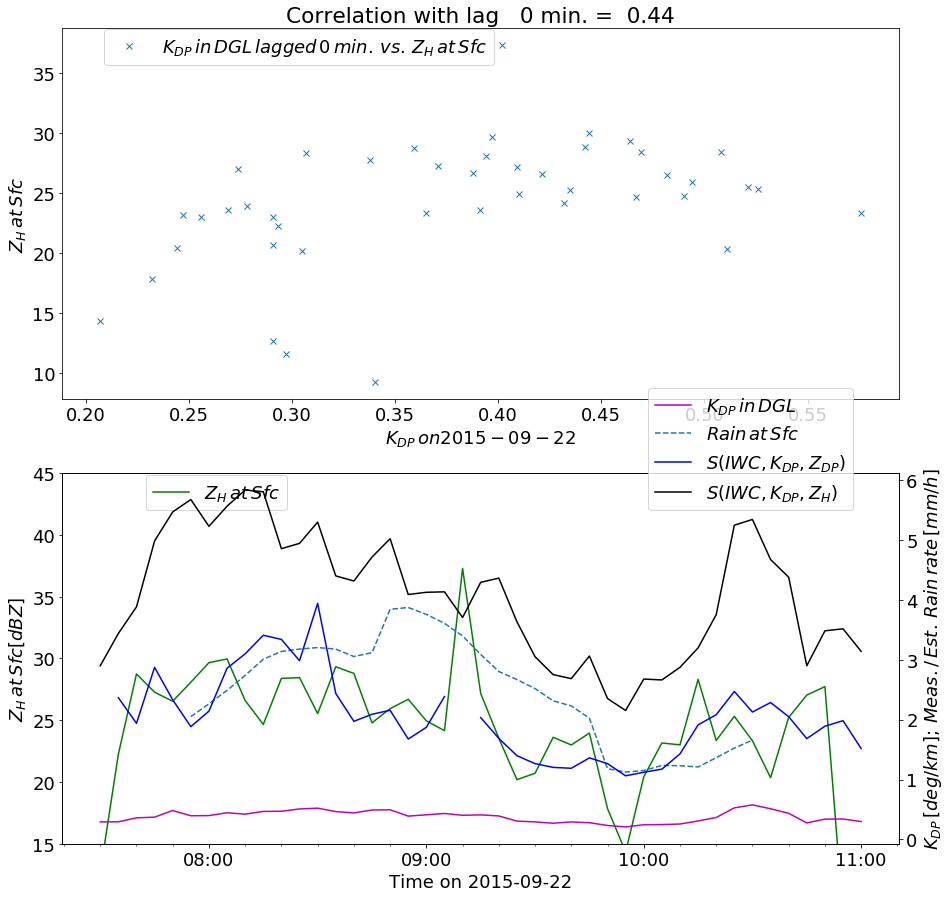

('vorher', -0.7920598622849839)
('p-value', 1.8431485479307345e-07)
('p-value', 0.020753464077304187)
('p-value', 0.0008223669232495252)
('p-value', 0.005793137123299407)
('p-value', 0.032075610681340384)
('p-value', 0.17401520973246207)
('p-value', 0.006095007241143136)
('p-value', 3.414782593329946e-06)
('p-value', 0.002400242421560918)
('p-value', 0.004382808839609165)
('p-value', 0.07733965126268)
('p-value', 0.21172504918245555)
('p-value', 0.037005985849101725)
('p-value', 0.08447123464475283)


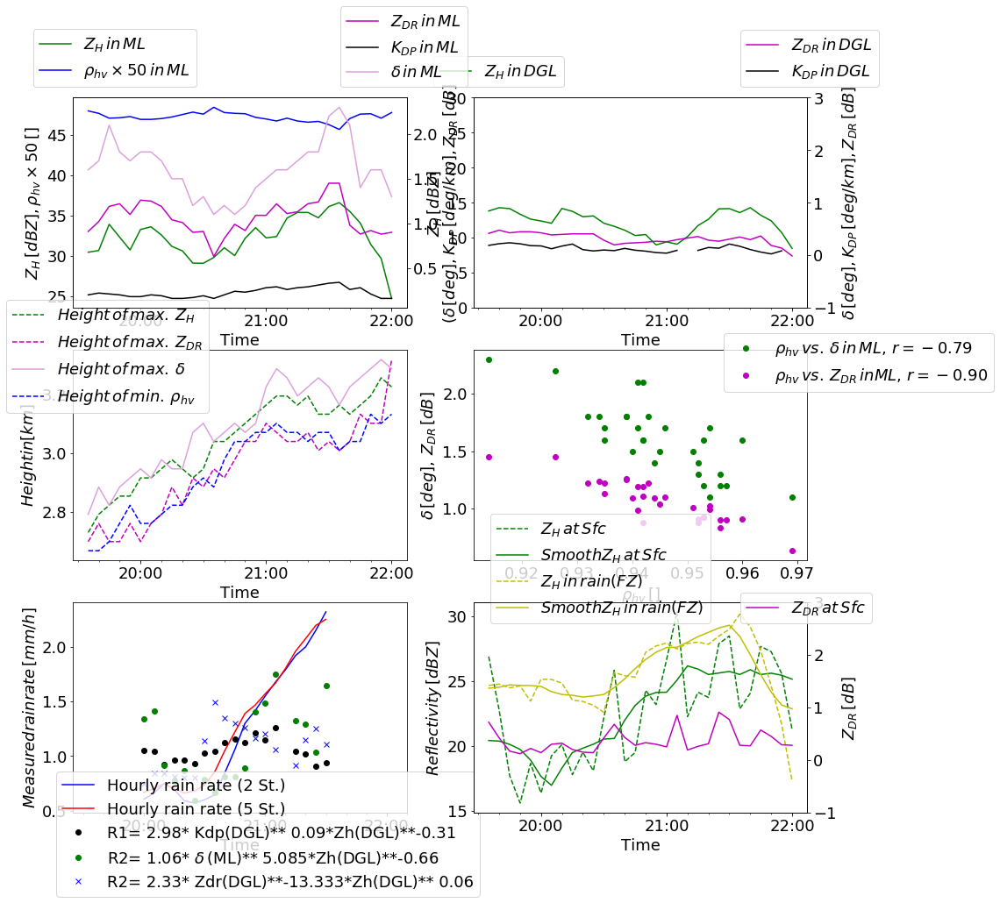

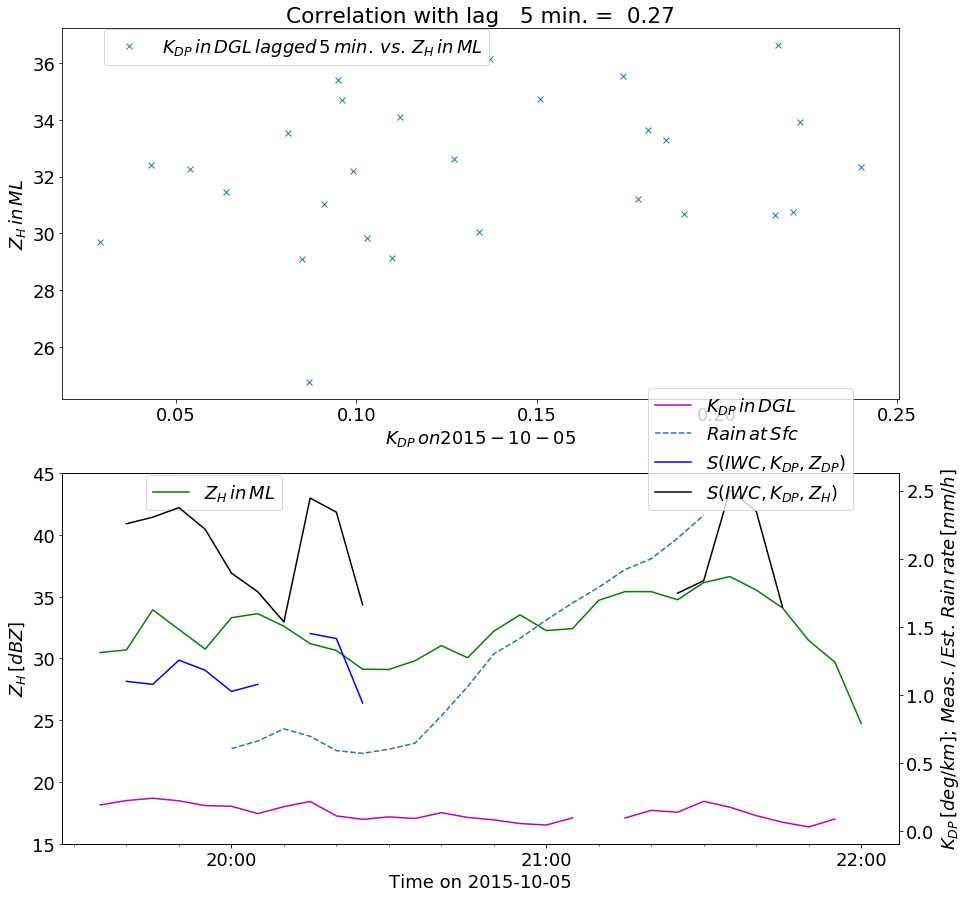

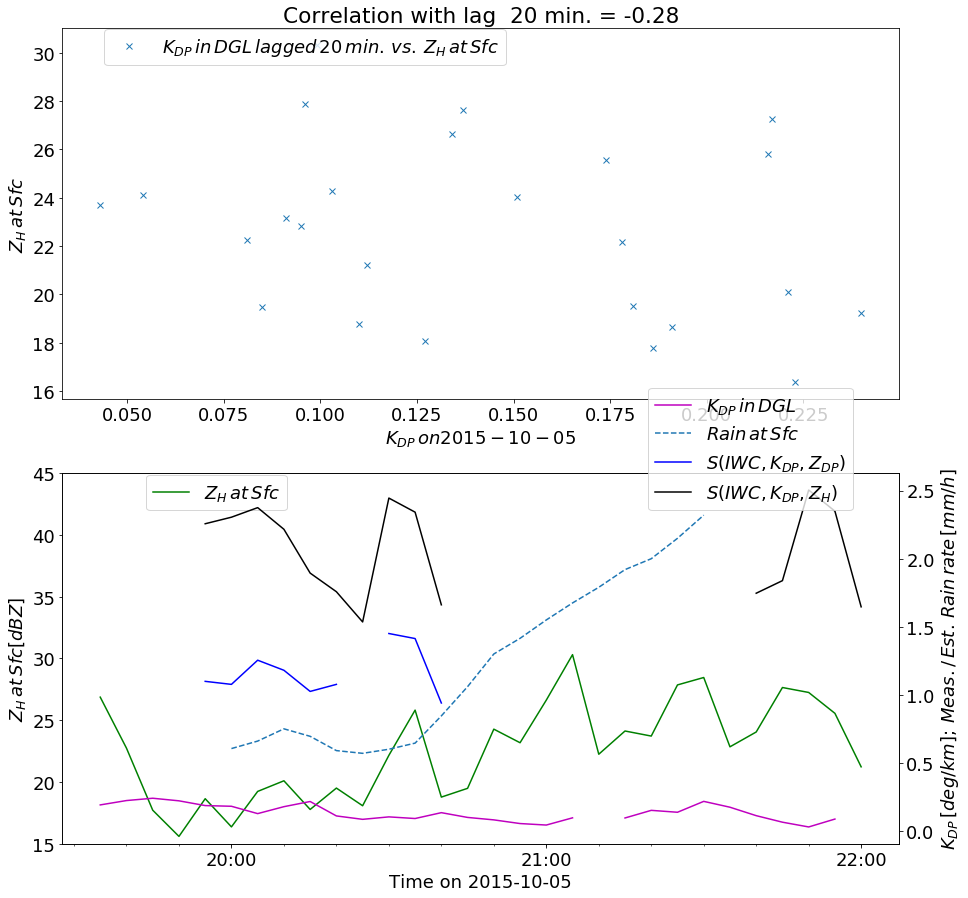

('vorher', -0.8880185444826348)
('p-value', 3.888307089524868e-07)
('p-value', 0.3485361326919077)
('p-value', 0.7414558214940081)
('p-value', 0.49616046101530364)
('p-value', 0.753941084933294)
('p-value', 0.6767822256831038)
('p-value', 0.10008333572746016)
('p-value', 0.006695735952243485)
('p-value', 0.01988933137322869)
('p-value', 0.06216220048276105)
('p-value', 0.11429188708321028)
('p-value', 0.5619630979946417)
('p-value', 0.0865563568978331)
('p-value', 0.2986678744329323)


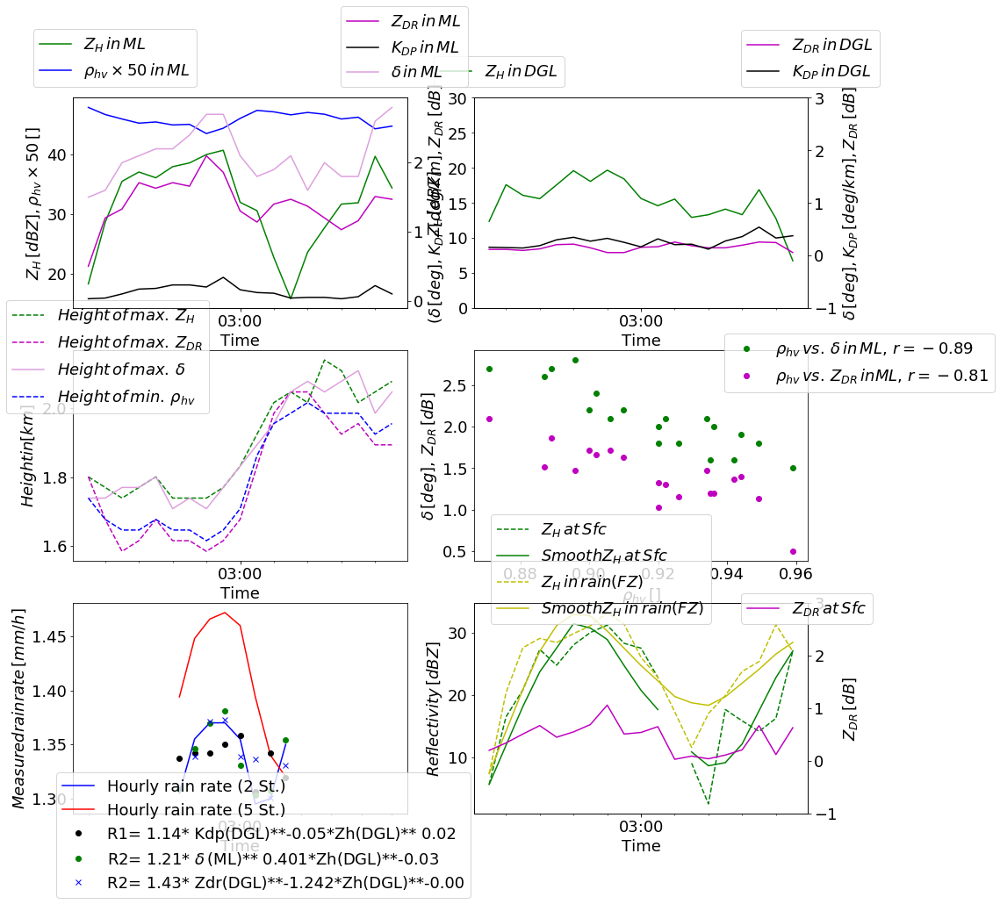

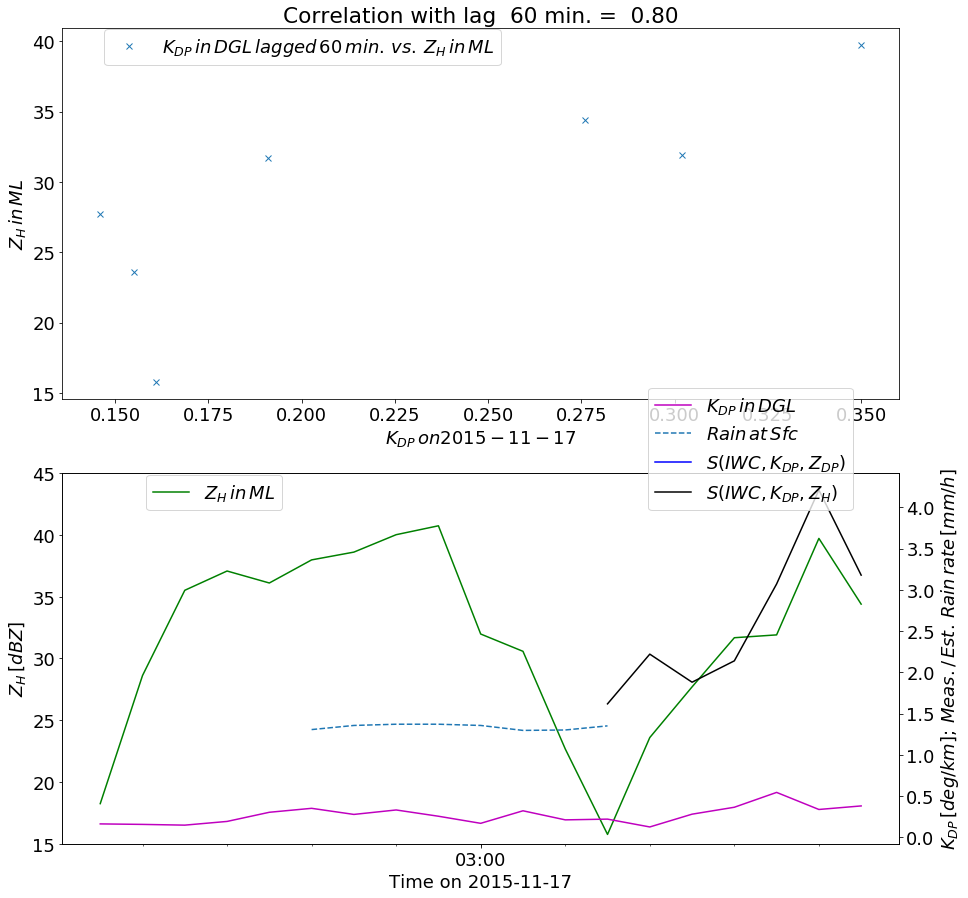

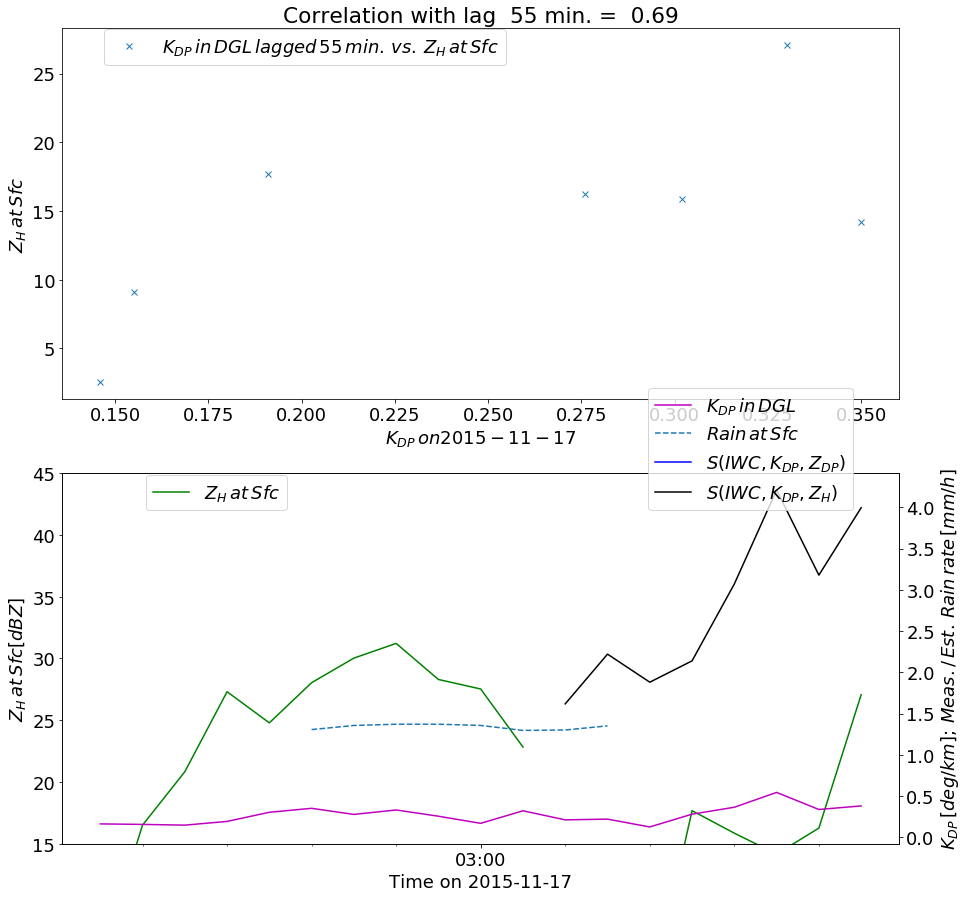

('vorher', -0.8755019965990136)
('p-value', 9.827651313114011e-18)
('p-value', 0.04760252122264503)
('p-value', 0.07961787099580242)
('p-value', 0.06902785307116398)
('p-value', 0.12053137664812241)
('p-value', 0.44101101760825523)
('p-value', 0.675061743293827)
('p-value', 0.2525195518918647)
('p-value', 0.05425985847281104)
('p-value', 0.1847588712355333)
('p-value', 0.5701974417920908)
('p-value', 0.7599240526189193)
('p-value', 0.5301669335024586)
('p-value', 0.48188896266260617)


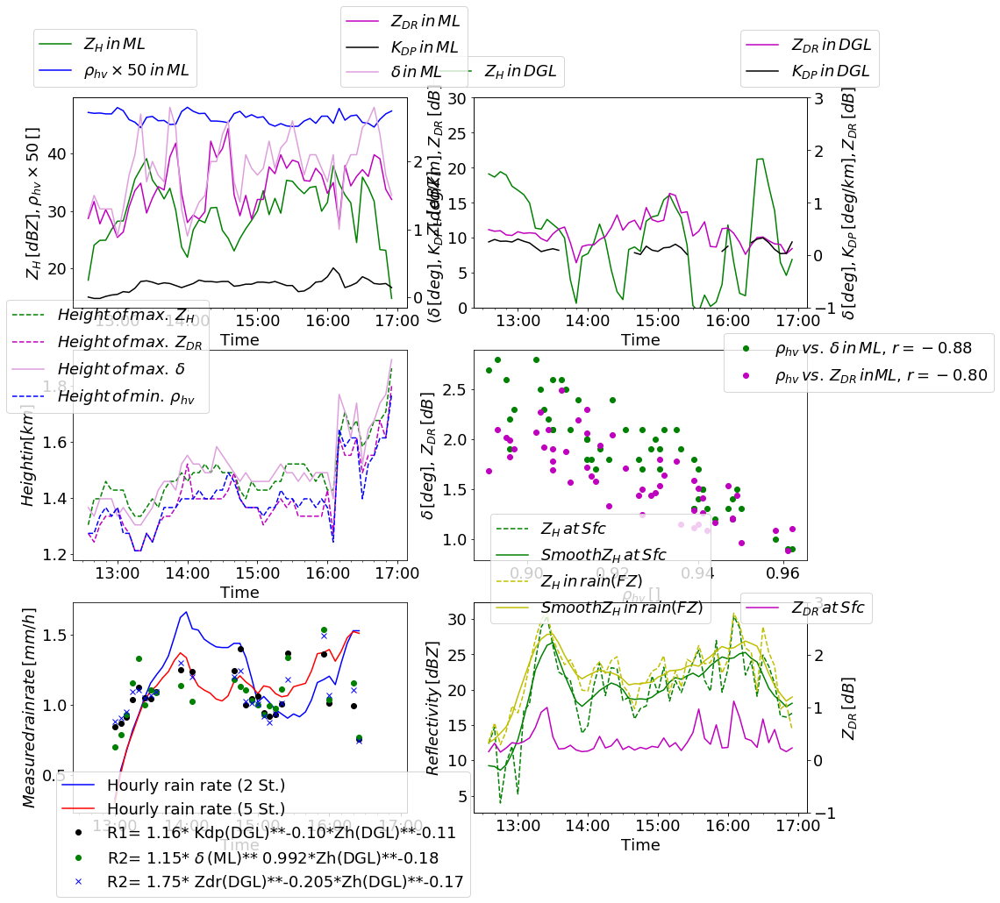

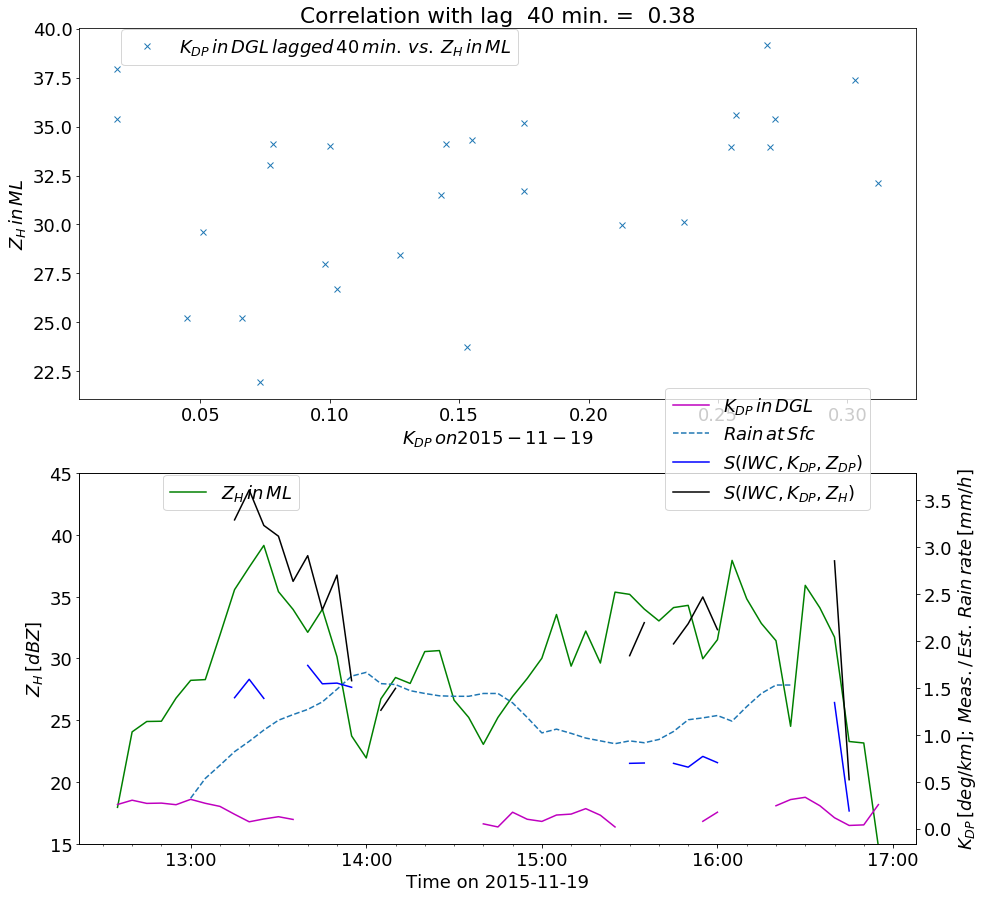

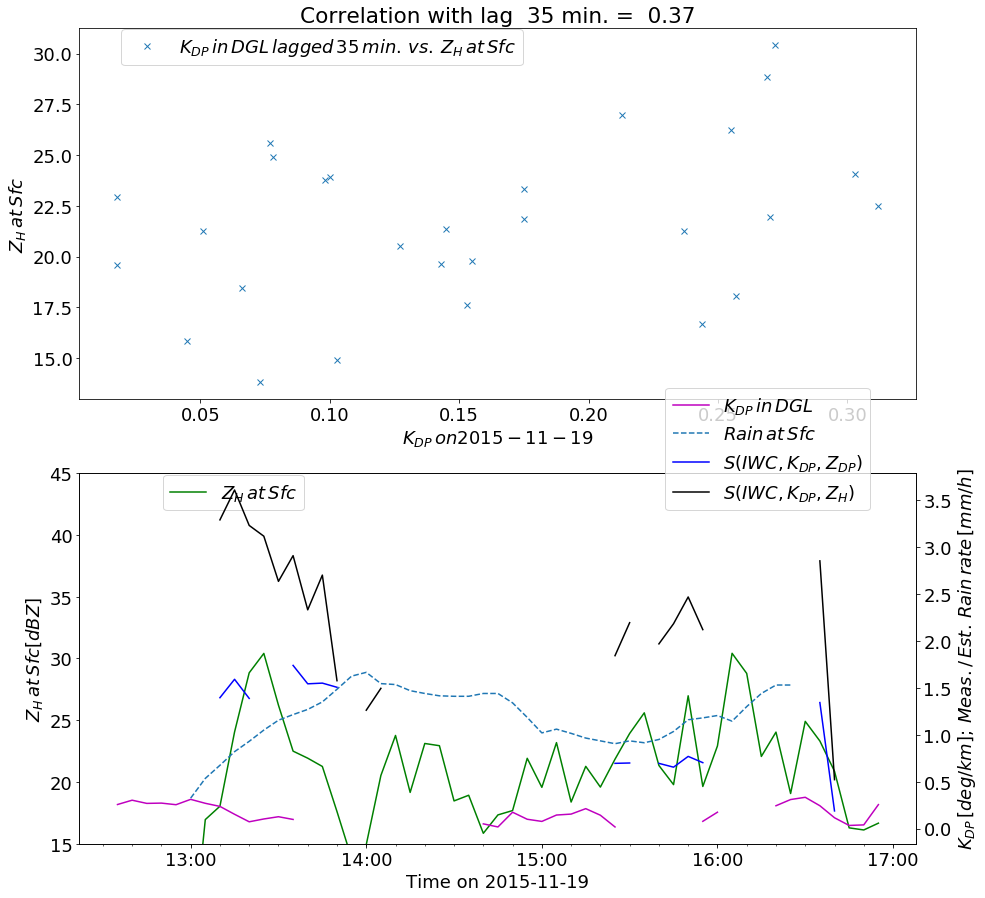

('vorher', -0.4058795246543013)
('p-value', 0.03211242387345622)
('p-value', 0.5855198803710582)
('p-value', 0.10986225648221003)
('p-value', 0.07357793466818092)
('p-value', 0.20158263474187393)
('p-value', 0.28595622796585735)
('p-value', 0.7306172221764495)
('p-value', 0.8554196137238923)
('p-value', 0.36958929183192735)
('p-value', 0.69340328086577)
('p-value', 0.37692378669930915)
('p-value', 0.7497666673956889)
('p-value', 0.22066810452865757)
('p-value', 0.08188800574855122)


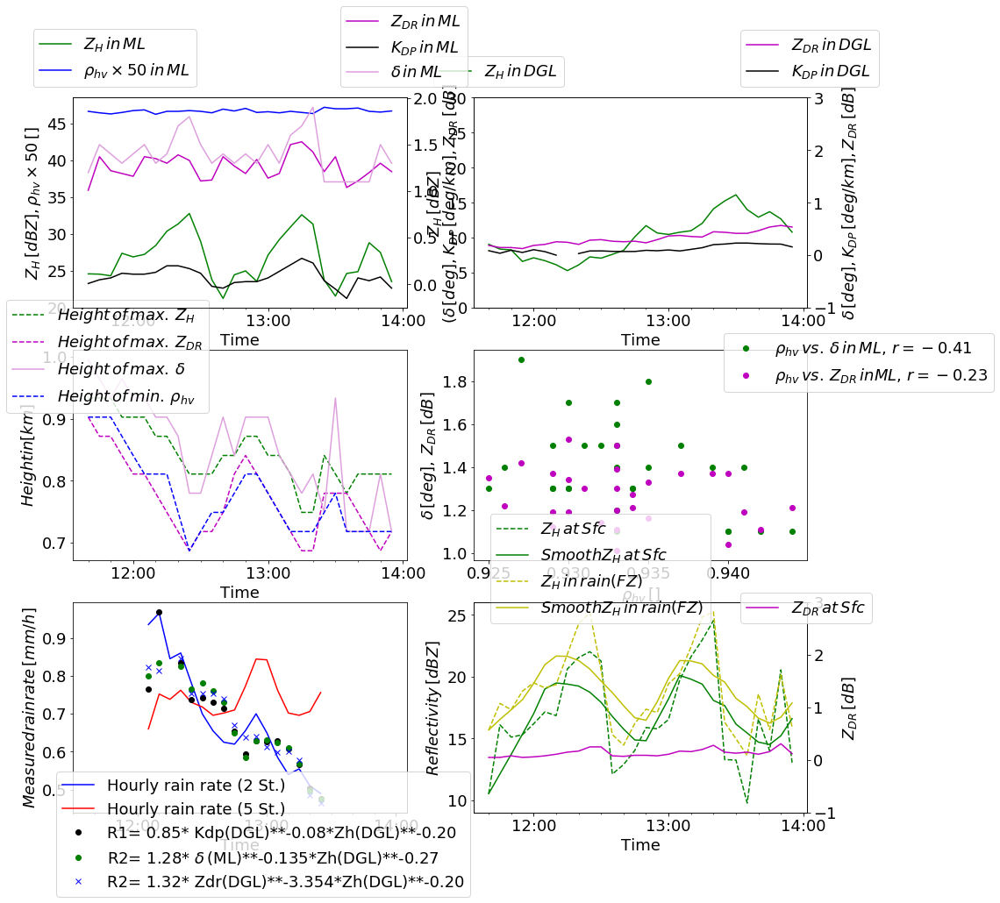

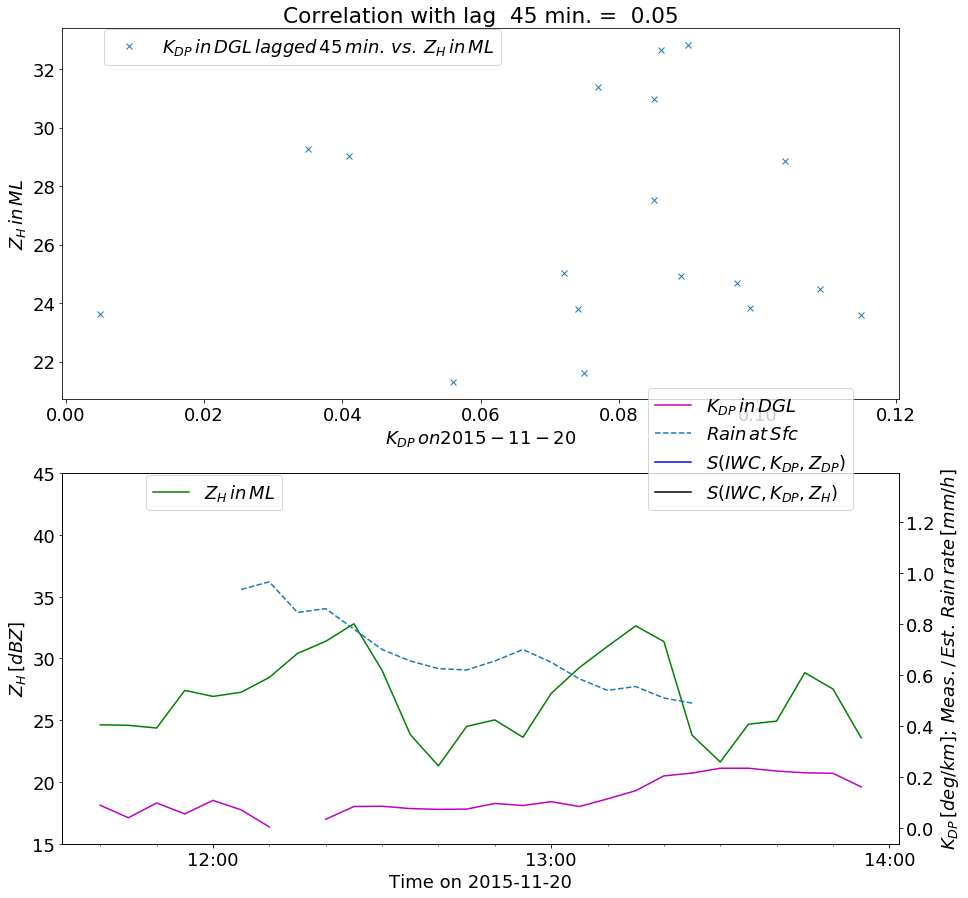

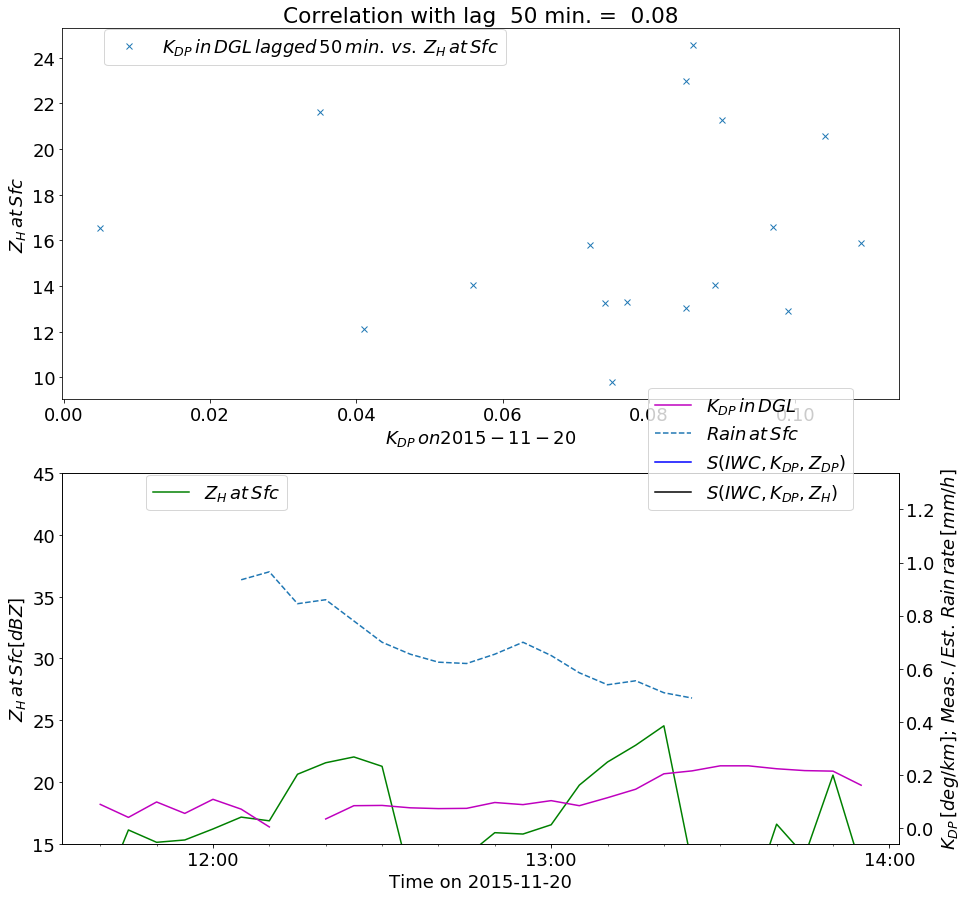

('vorher', -0.708262849223285)
('p-value', 5.1562709096288854e-05)
('p-value', 0.2920890664440574)
('p-value', 0.3125655312591257)
('p-value', 0.39845436041019655)
('p-value', 0.7937604323728857)
('p-value', 0.9898376952421406)
('p-value', 0.8947633935927272)
('p-value', 0.24914703083990794)
('p-value', 0.5894876008868115)
('p-value', 0.03358246773741145)
('p-value', 0.15395477532992055)
('p-value', 0.10729727558692416)
('p-value', 0.2817602194256374)
('p-value', 0.7173873842939955)


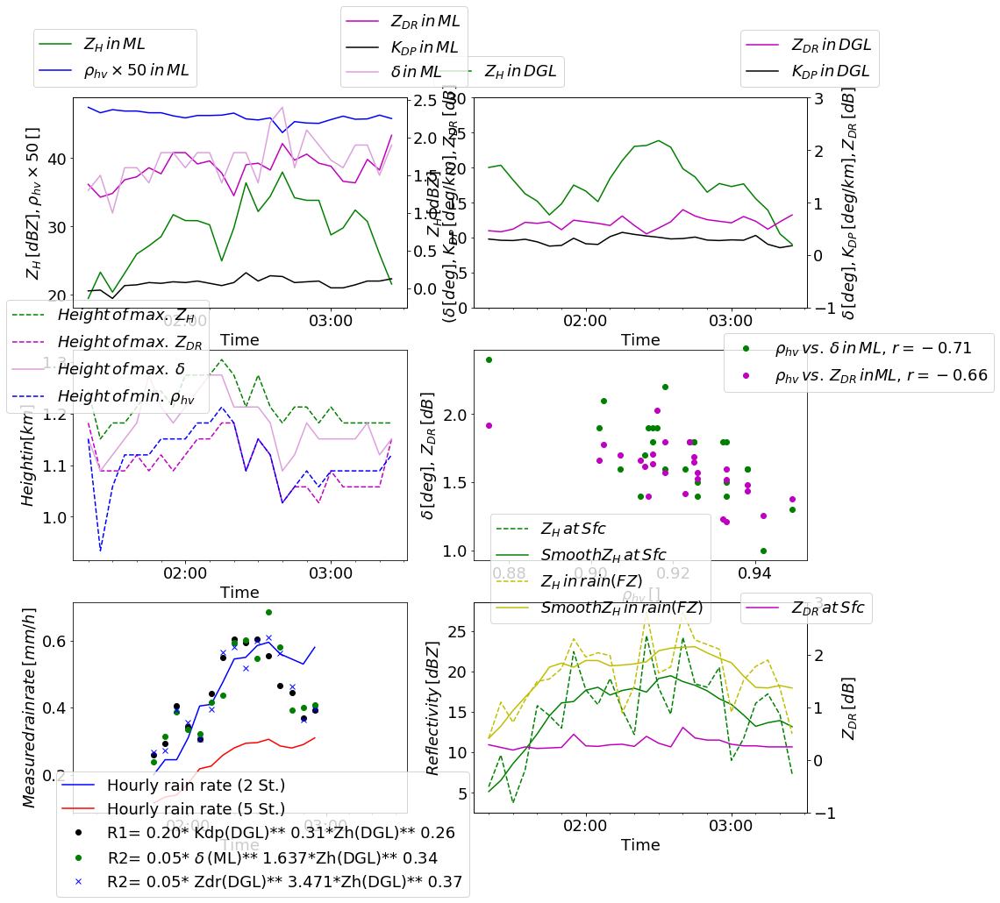

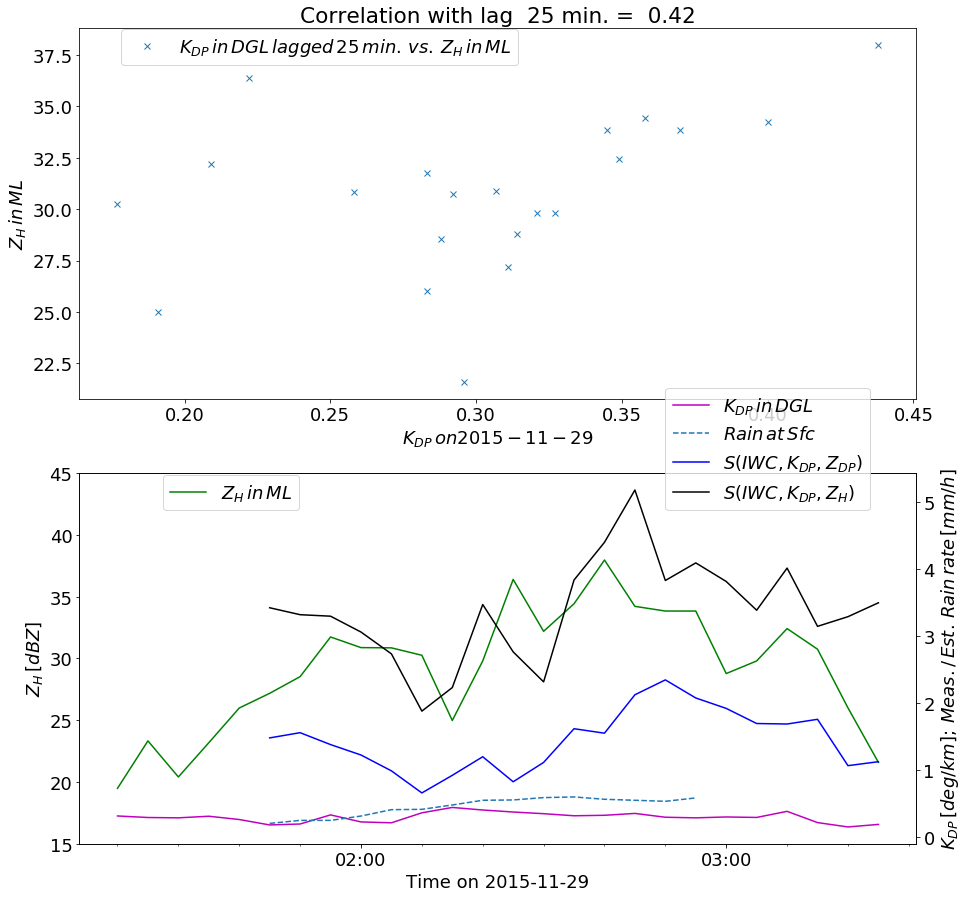

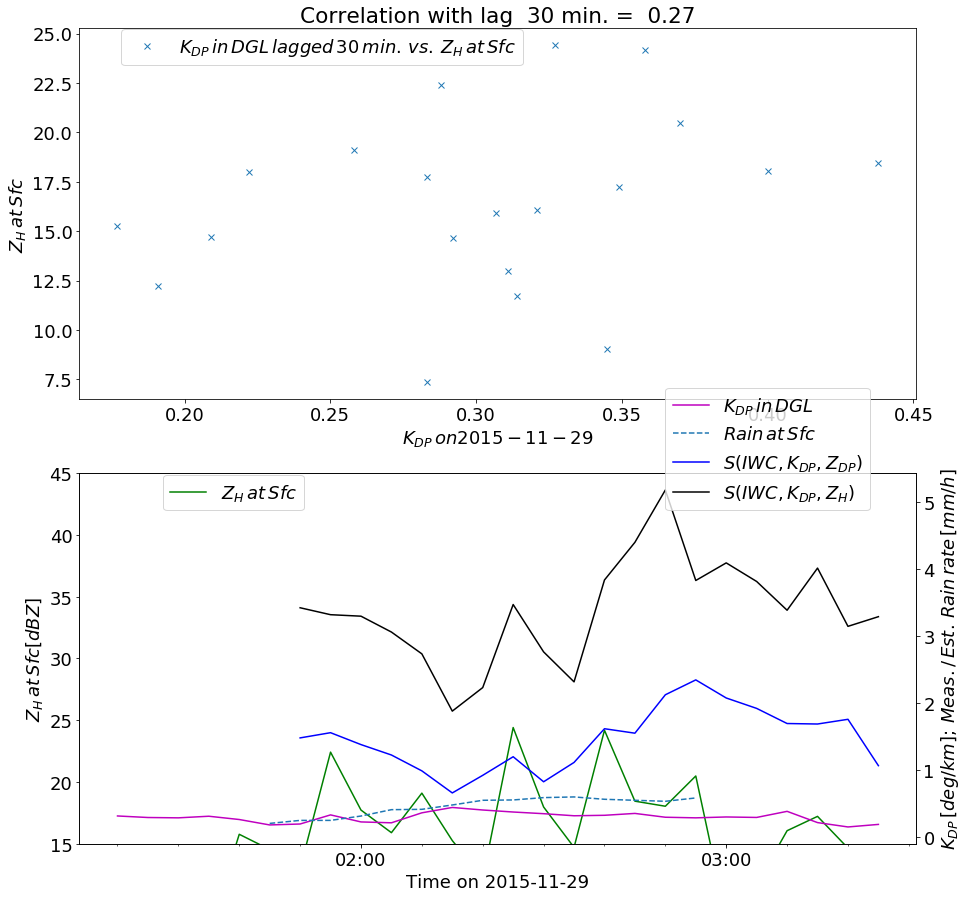

('vorher', -0.8170122068421477)
('p-value', 1.3430217761563431e-11)
('p-value', 0.001350691582018143)
('p-value', 0.001978999752493329)
('p-value', 0.0022752964044525474)
('p-value', 0.0010969895771150424)
('p-value', 0.006975123645887396)
('p-value', 0.07661015705093924)
('p-value', 0.22140571259495875)
('p-value', 0.5381746304506914)
('p-value', 0.6589587784777029)
('p-value', 0.3003034345411706)
('p-value', 0.2917828552460372)
('p-value', 0.25086202298454574)
('p-value', 0.36398032005872305)


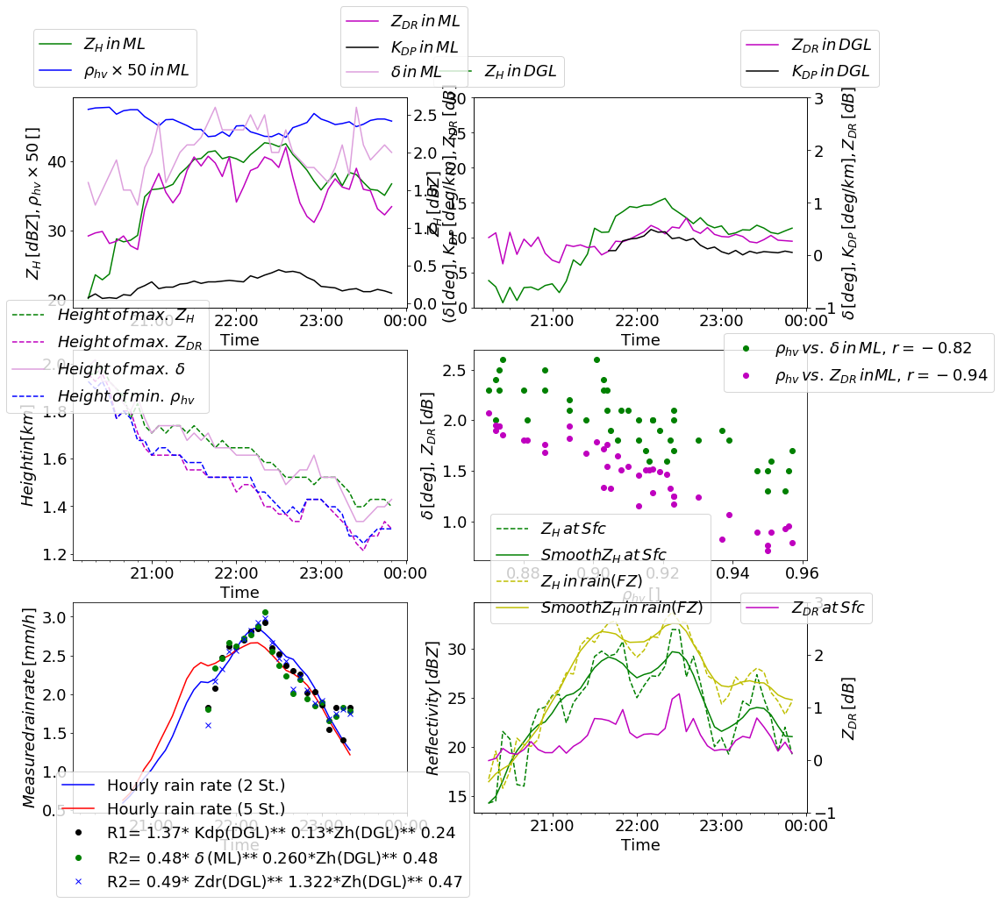

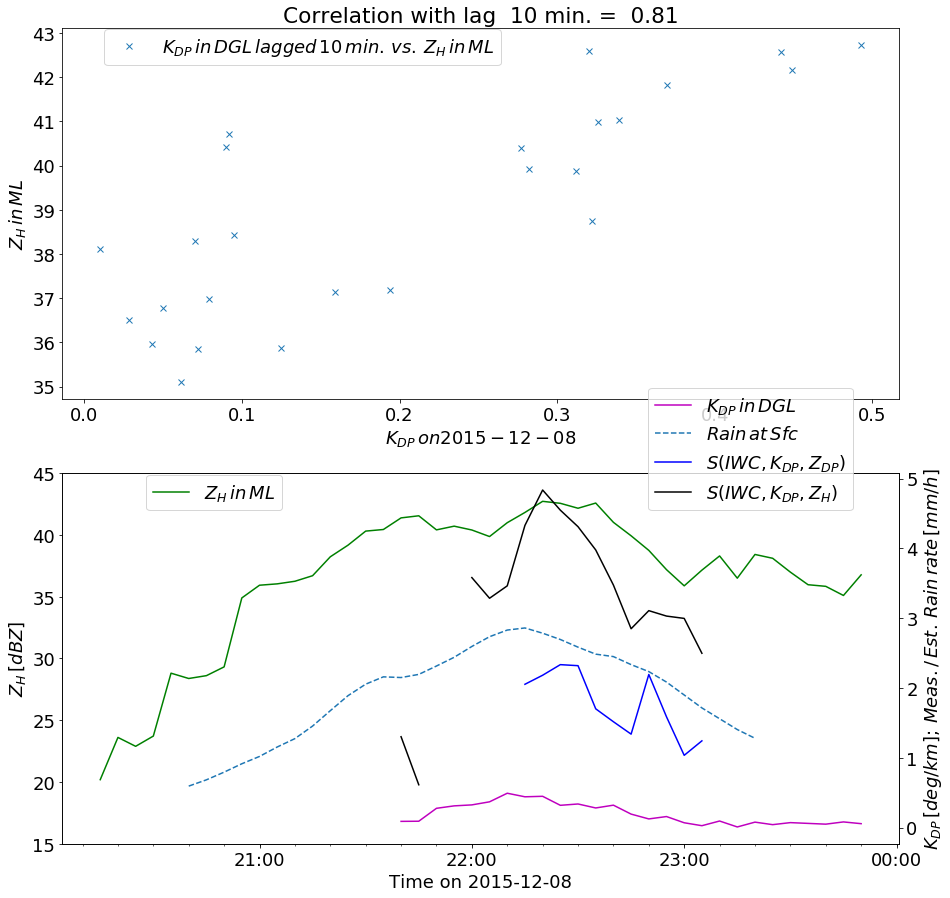

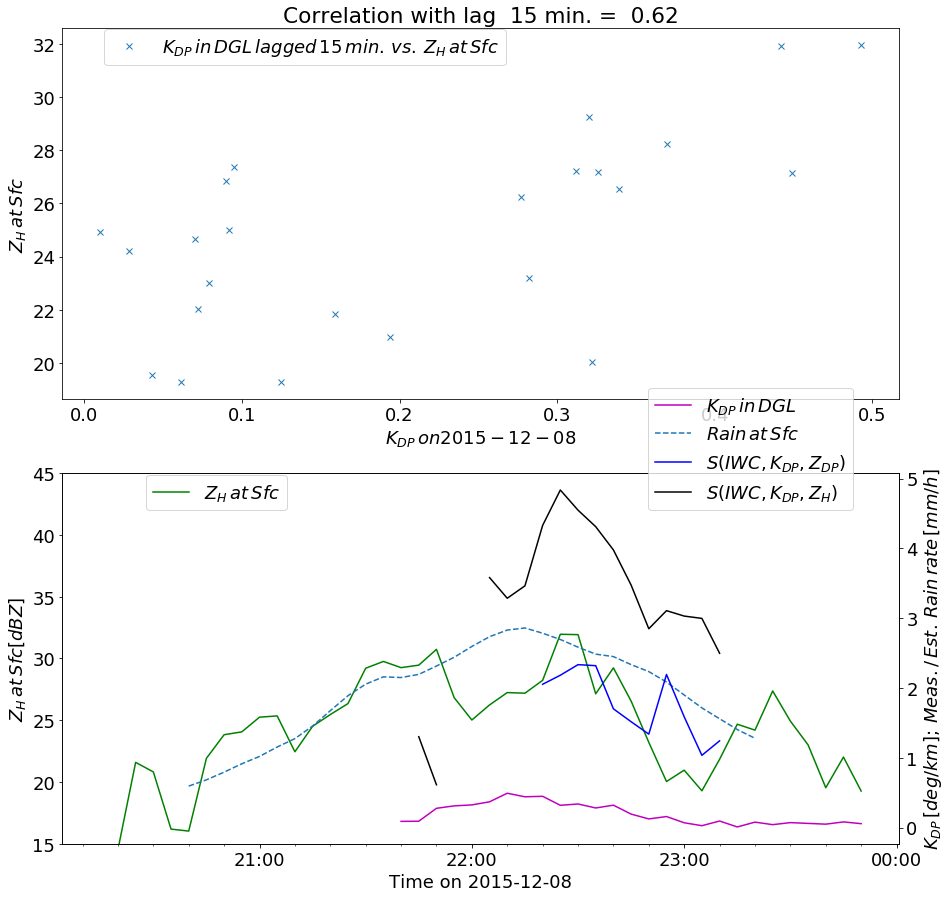

('vorher', -0.852176102909858)
('p-value', 7.133073247365369e-06)
('p-value', 0.8543425960080726)
('p-value', 0.8664930037363656)
('p-value', 0.45657576177092885)
('p-value', 0.6655246918325806)
('p-value', 0.32869659609226415)
('p-value', 0.06815045223905555)
('p-value', 0.06012167987550533)
('p-value', 0.2691288272553549)
('p-value', 0.4603069768740879)
('p-value', 0.5279012070147019)
('p-value', 0.2416707654632696)
('p-value', 0.24194313348328728)
('p-value', 0.035583037363093005)


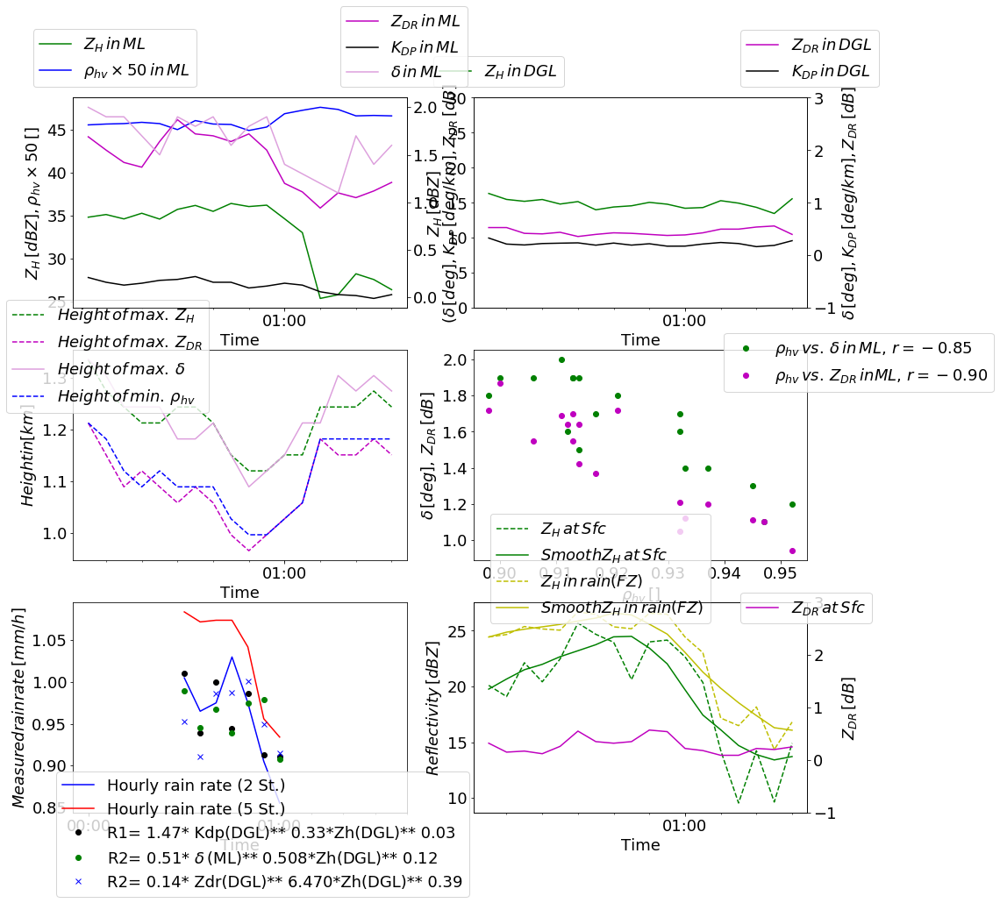

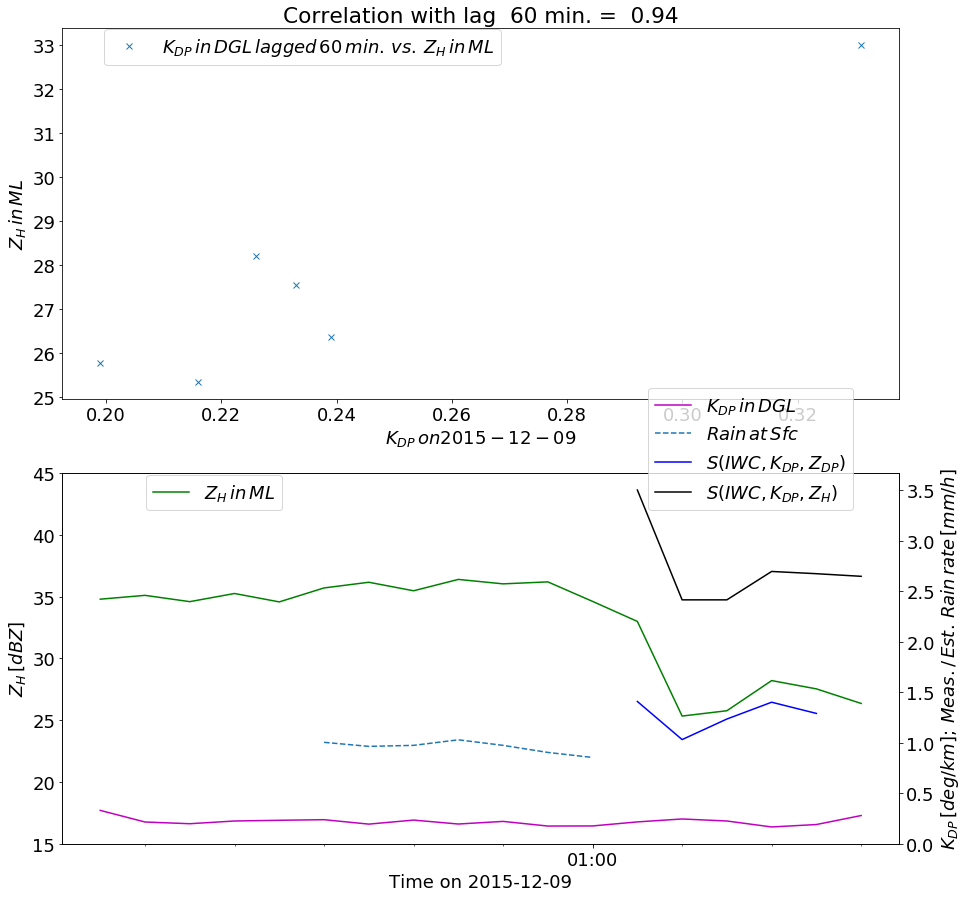

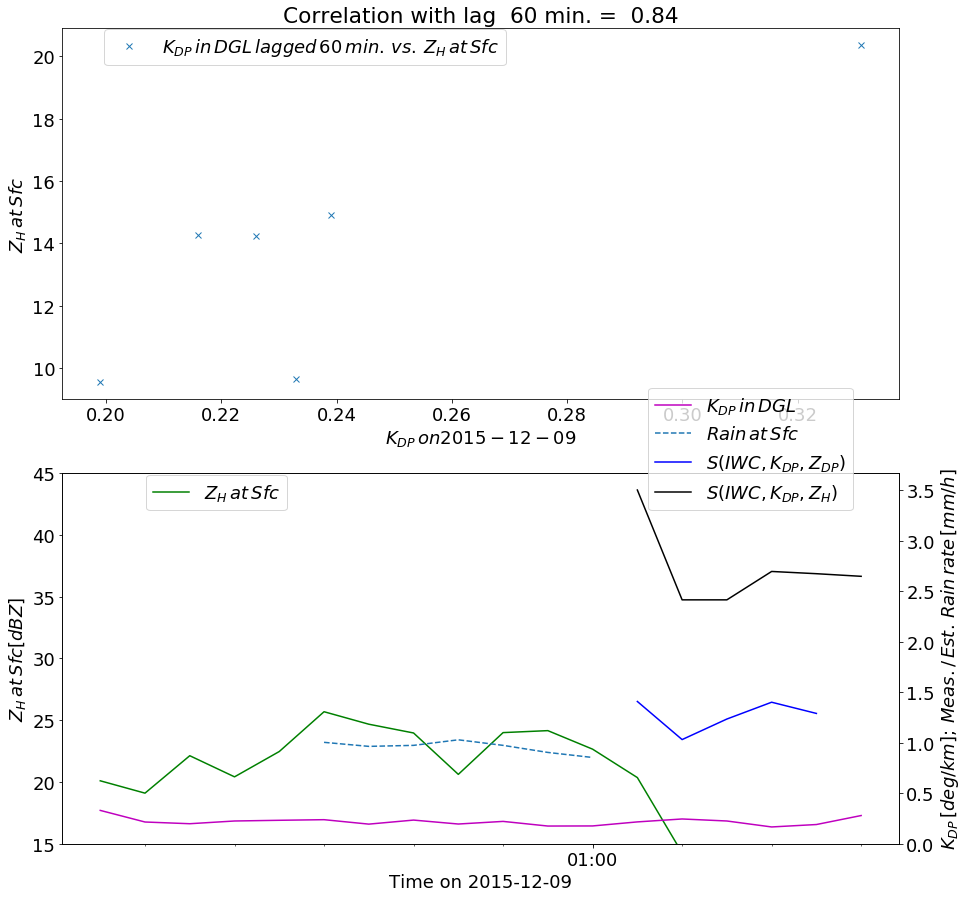

('vorher', -0.6354429145568495)
('p-value', 1.8698789949871496e-07)
('p-value', 0.12566687610122945)
('p-value', 0.15456031313576082)
('p-value', 0.6021199238781484)
('p-value', 0.35592895330458685)
('p-value', 0.13682915824475572)
('p-value', 0.6711541719556215)
('p-value', 0.986666086185899)
('p-value', 0.7575759828871942)
('p-value', 0.361860331274509)
('p-value', 0.5133534910030738)
('p-value', 0.4810423132070366)
('p-value', 0.7700506537306875)
('p-value', 0.9325773149462144)


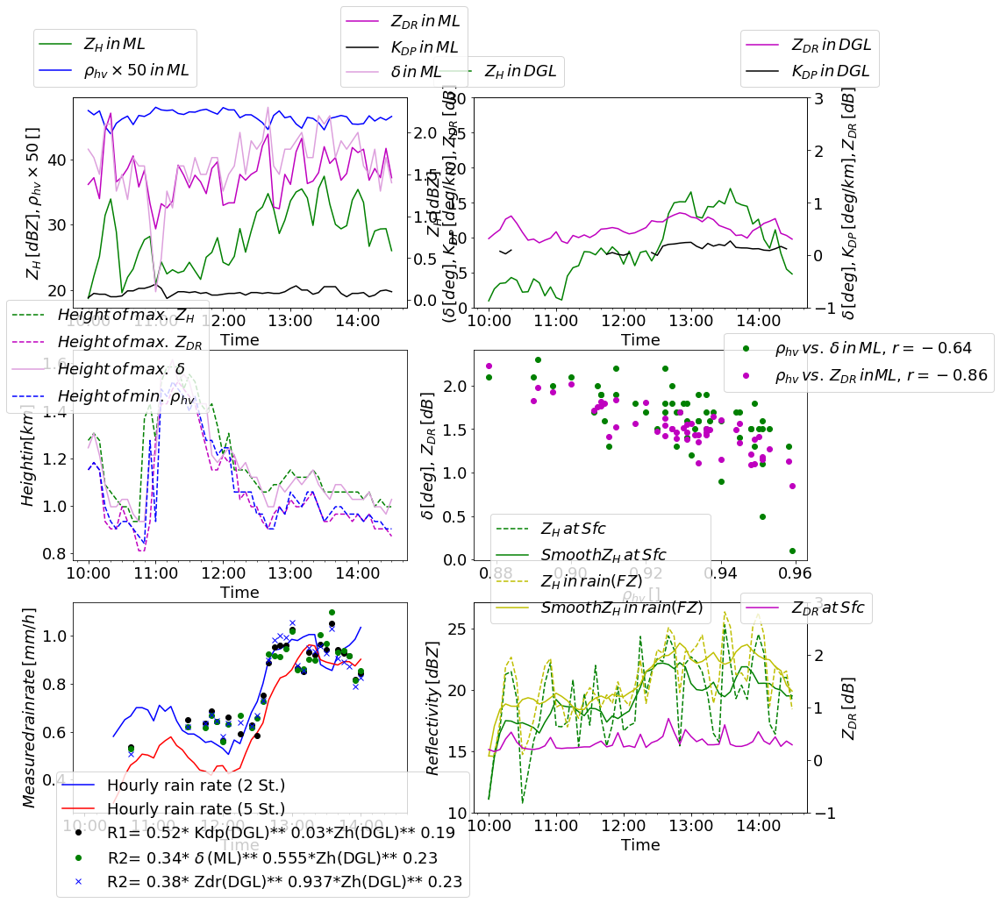

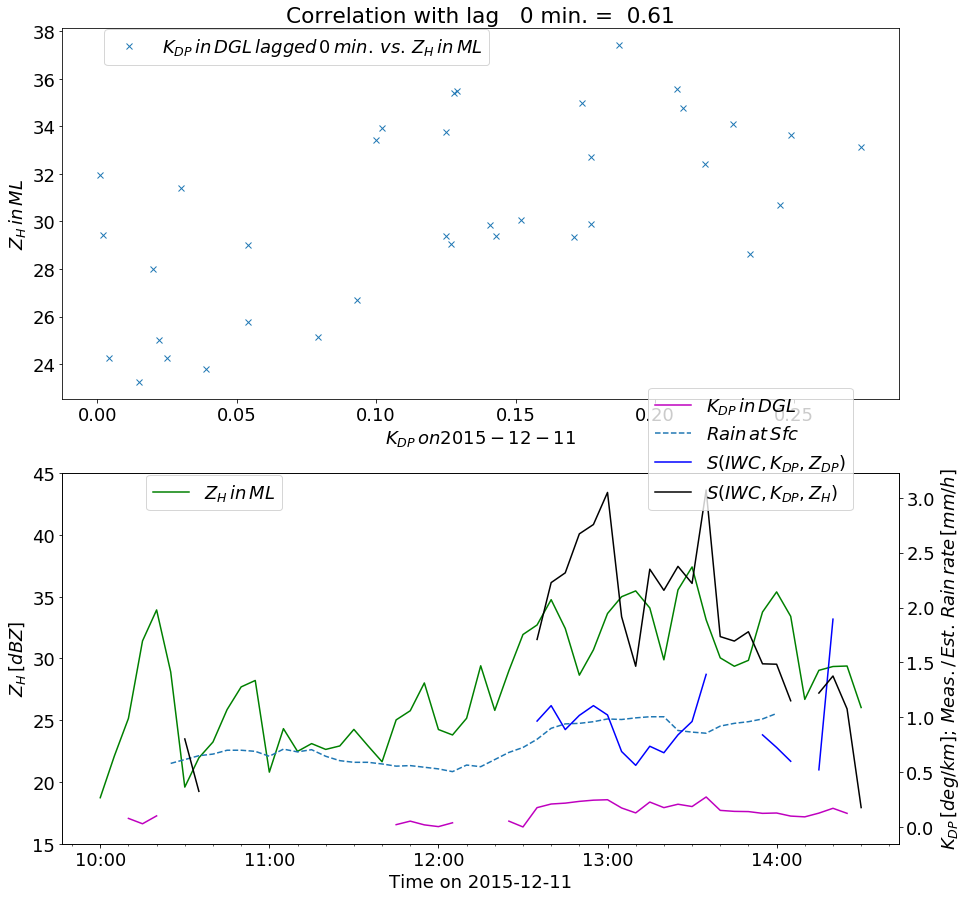

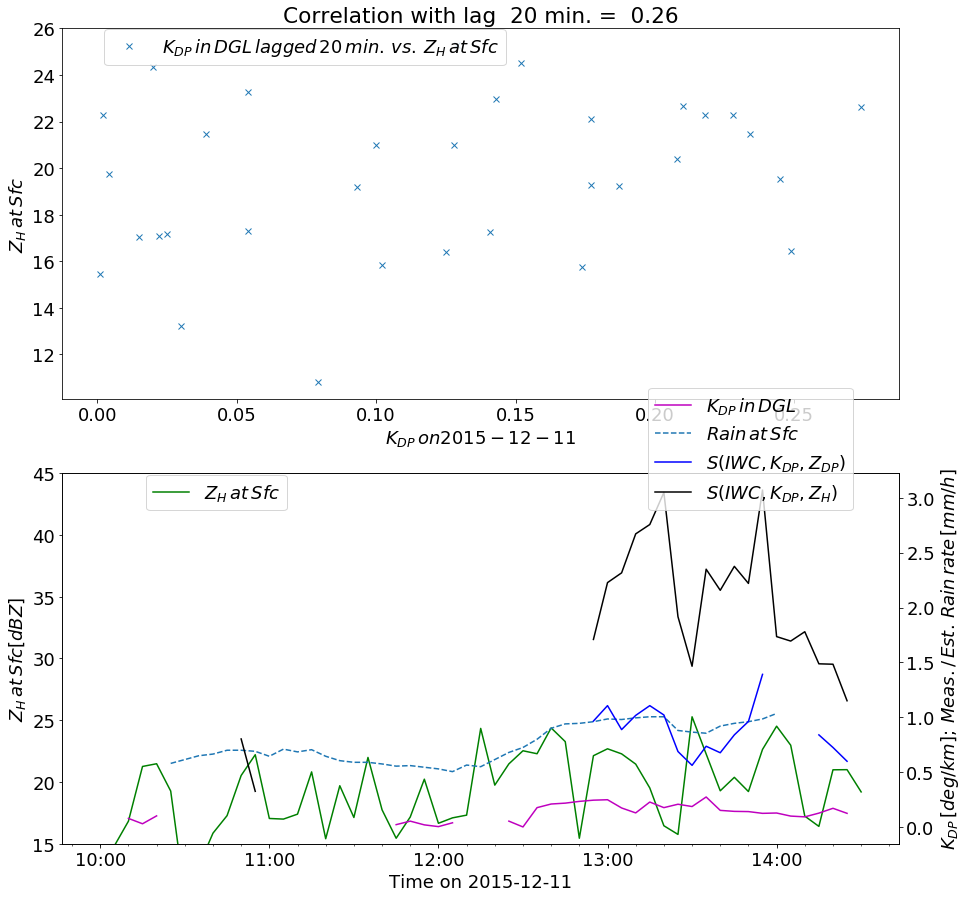

('vorher', -0.6765581822967385)
('p-value', 5.0466649539793155e-08)
('p-value', 0.010481493008657297)
('p-value', 0.029145708026249887)
('p-value', 0.0055892566694091496)
('p-value', 0.03481585777175396)
('p-value', 0.08424281012972659)
('p-value', 0.8396774857868419)
('p-value', 0.1676309239856086)
('p-value', 0.02508764988413999)
('p-value', 0.024922778516693323)
('p-value', 0.030878339969580487)
('p-value', 0.06417897063674448)
('p-value', 0.08621304695525696)
('p-value', 0.04745673946349445)


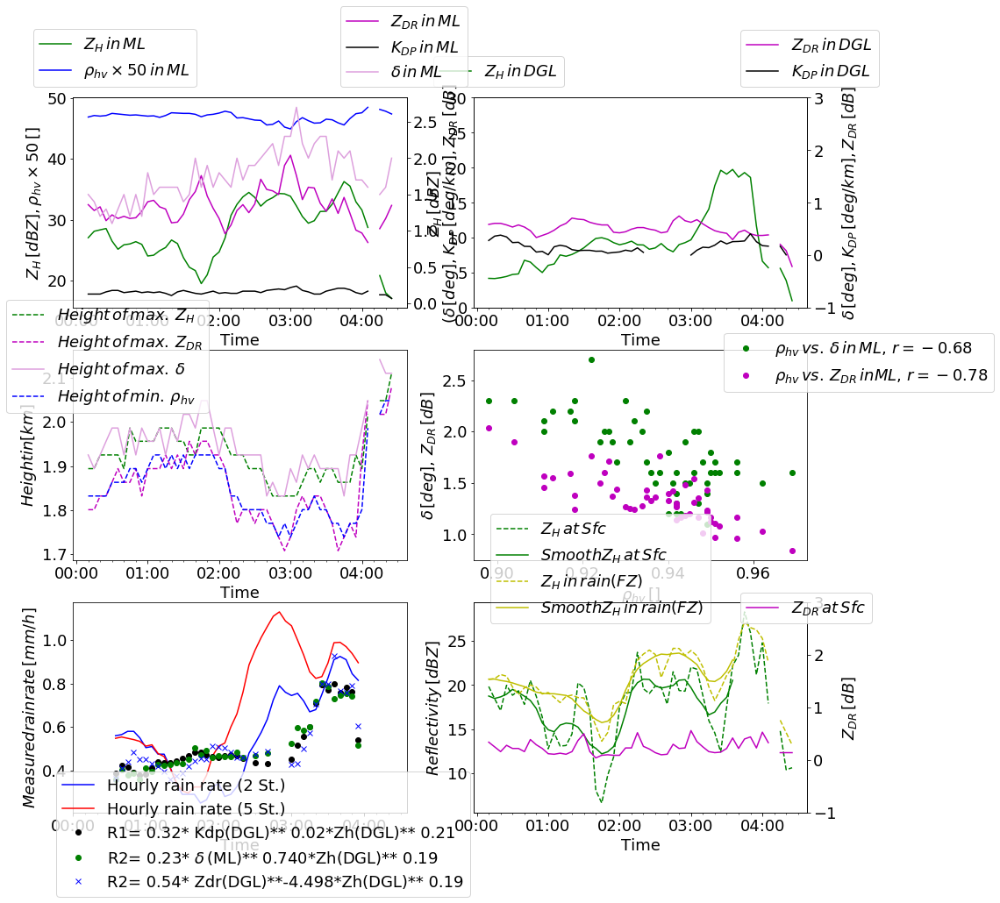

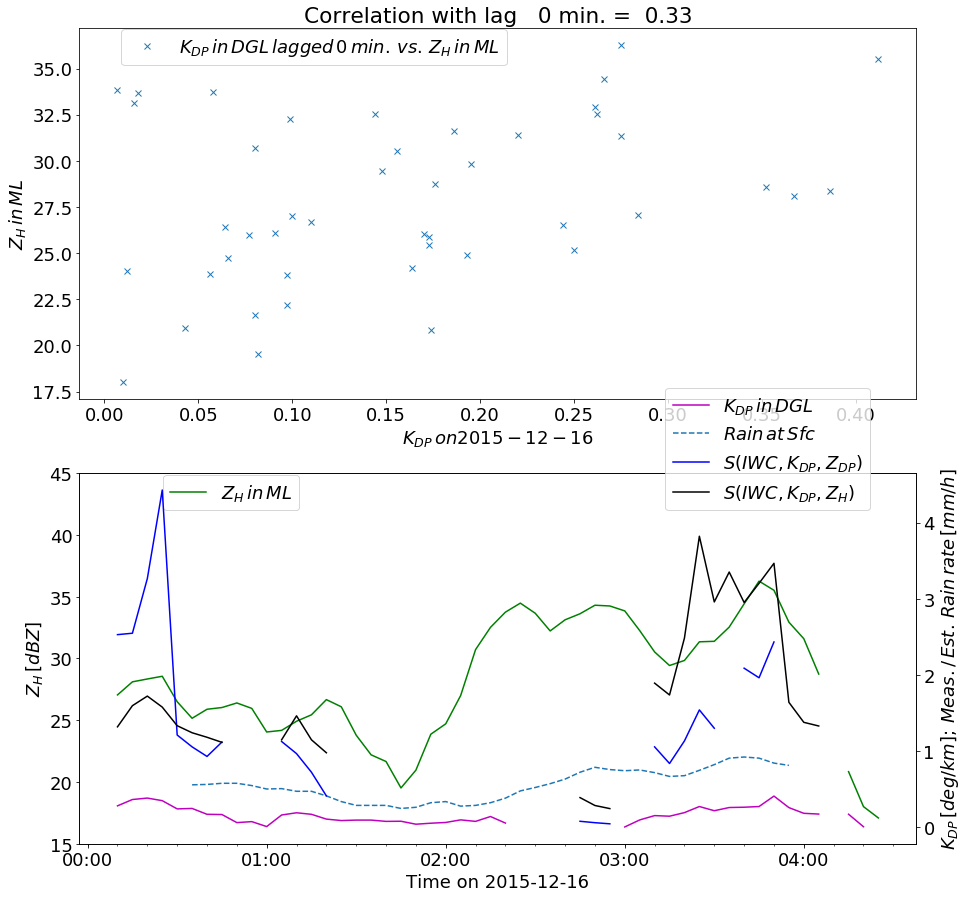

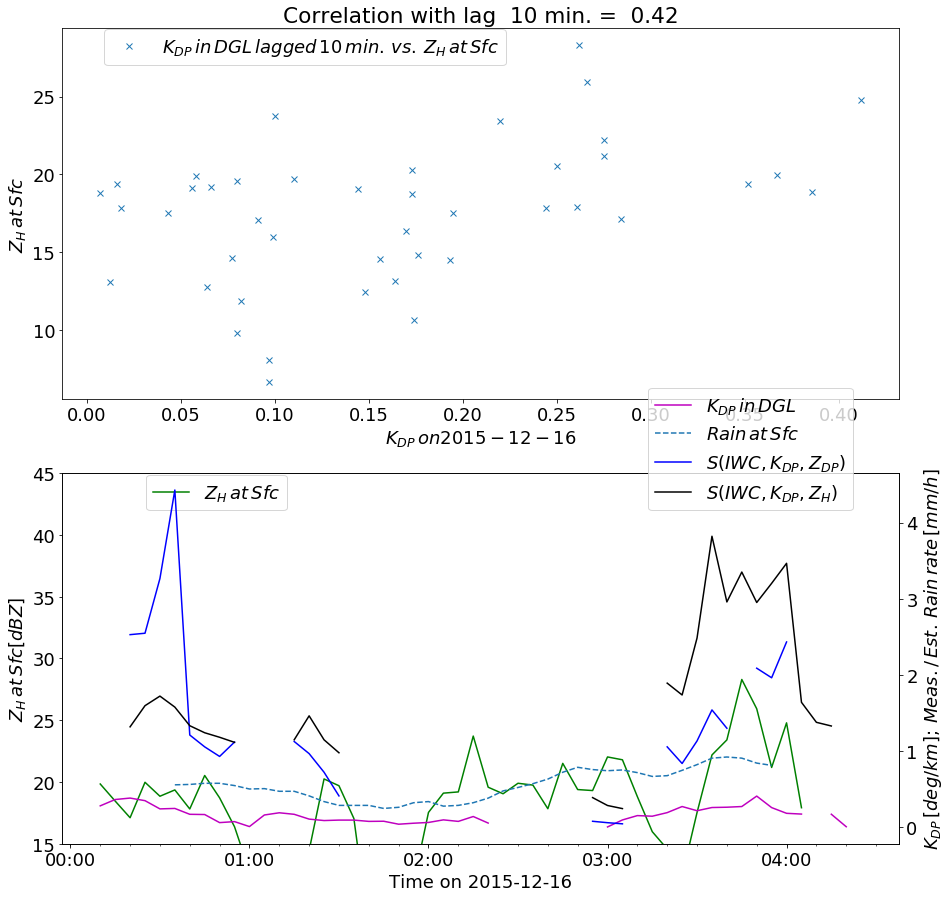

('vorher', -0.8333801144846035)
('p-value', 6.810803499895563e-08)
('p-value', 0.0014560041627589765)
('p-value', 0.00032896486121804637)
('p-value', 0.03272493420949866)
('p-value', 0.05132424459275665)
('p-value', 0.04850621475342178)
('p-value', 0.15455085506001925)
('p-value', 0.2588704298067003)
('p-value', 0.7738857415131842)
('p-value', 0.9683371732038283)
('p-value', 0.9260328847025829)
('p-value', 0.8396355779467621)
('p-value', 0.808705618399794)
('p-value', 0.9651547969650989)


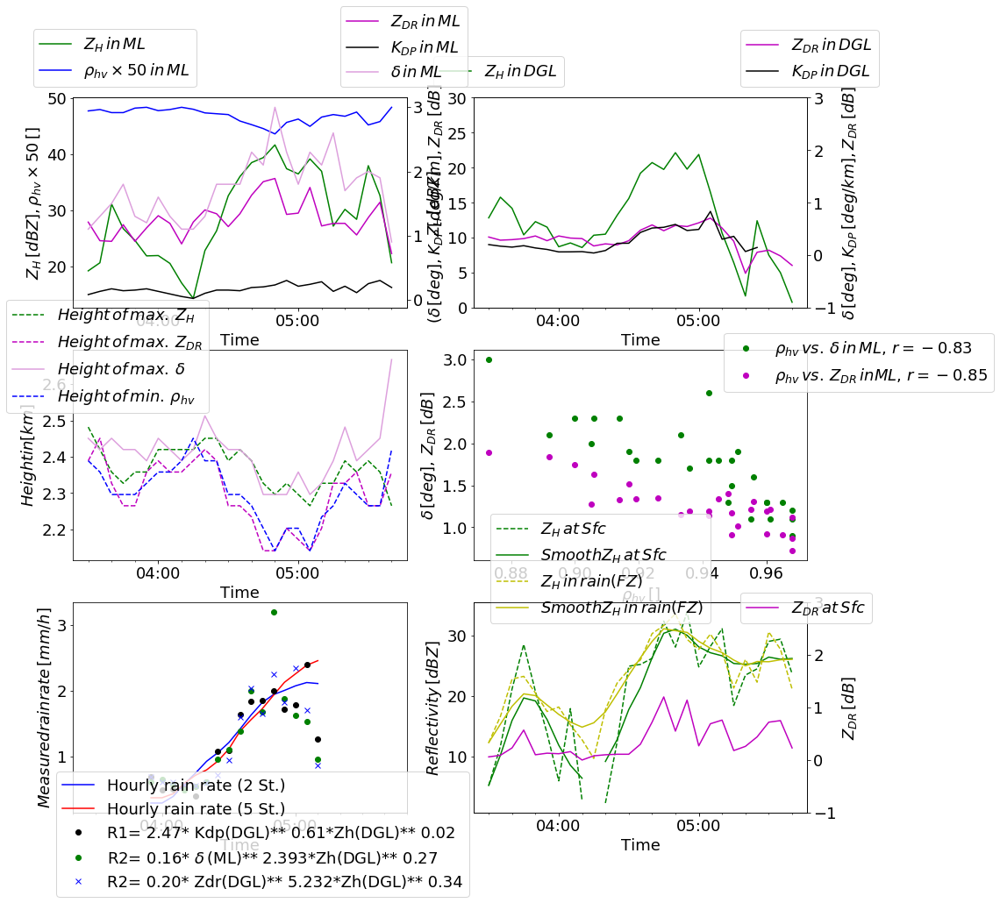

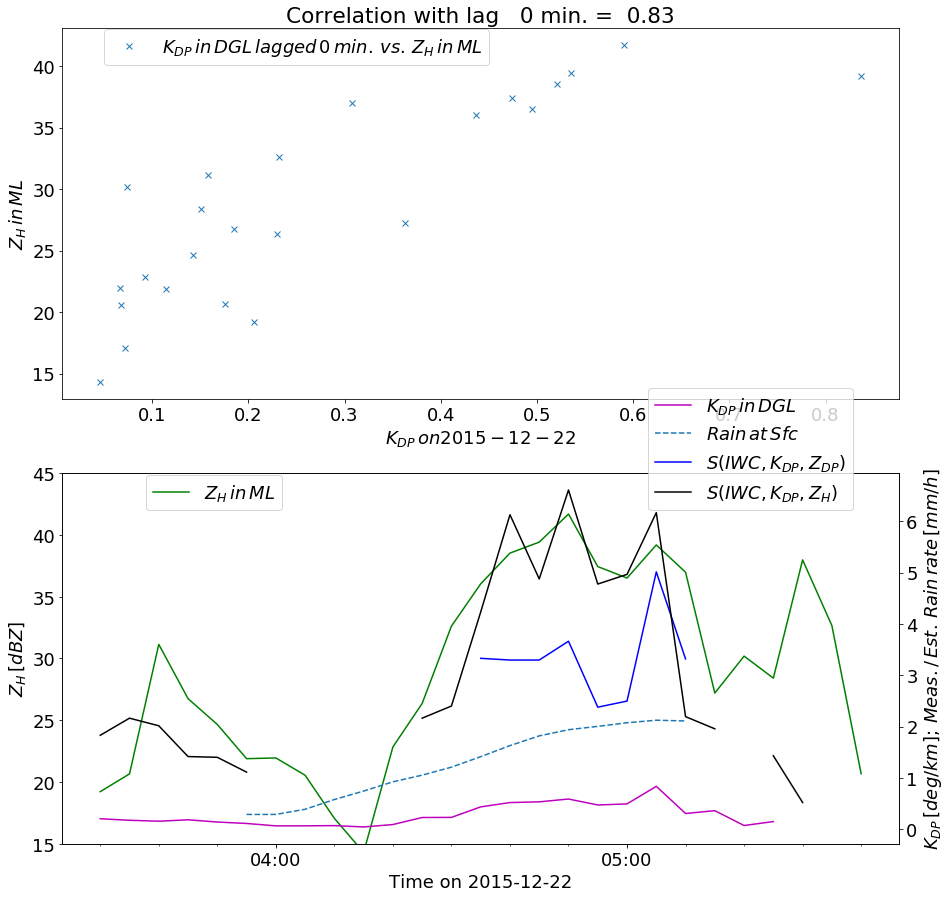

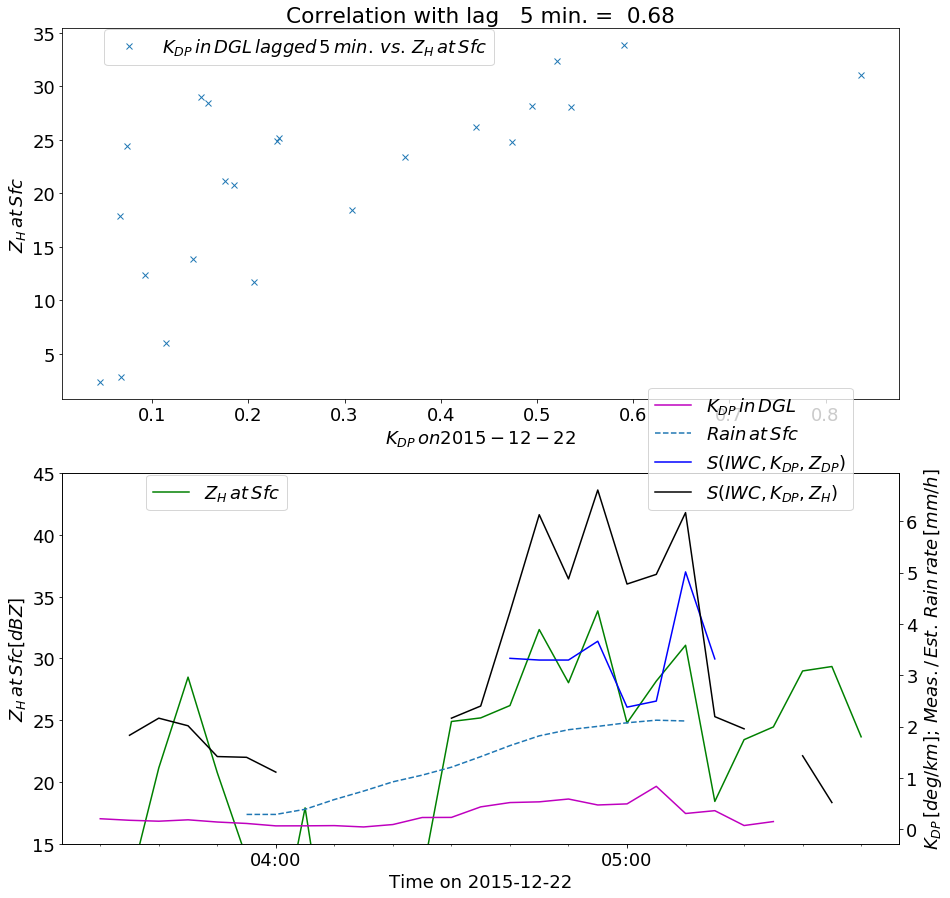

('vorher', -0.8353775578699293)
('p-value', 1.0990758513931916e-07)
('p-value', 0.0)
('p-value', nan)
('p-value', 0.0)
('p-value', nan)
('p-value', 0.0)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)
('p-value', nan)


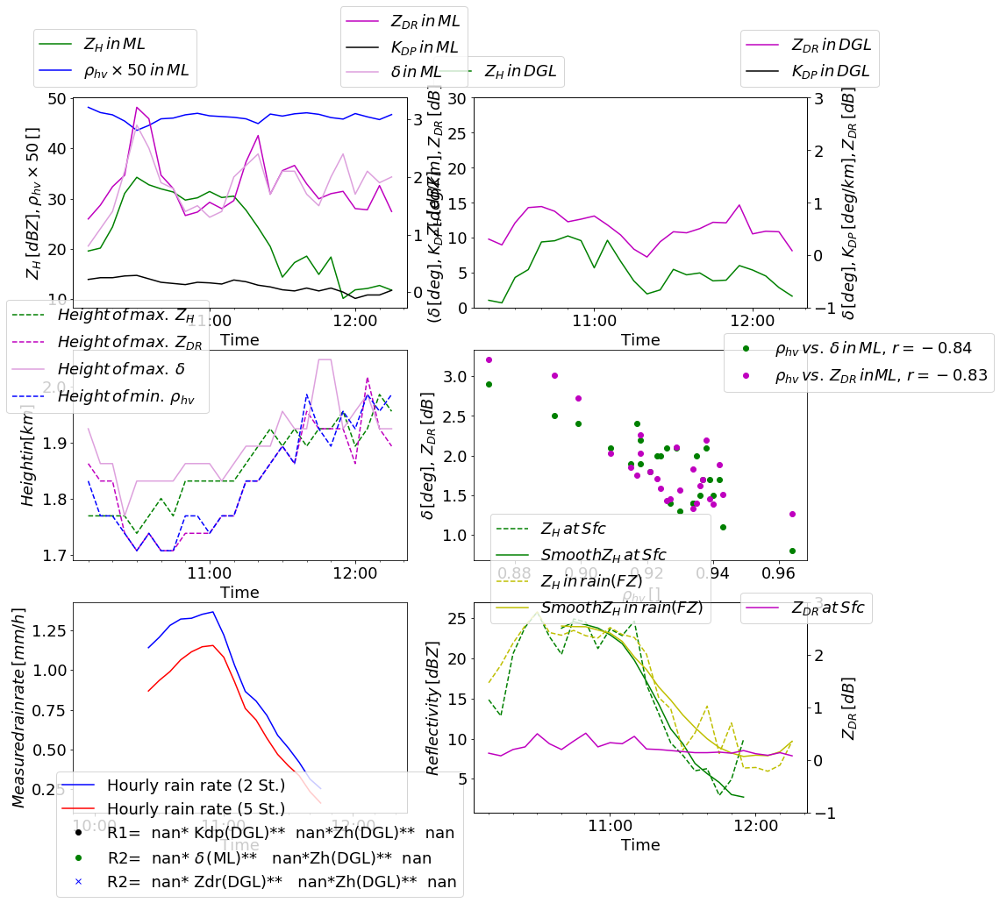

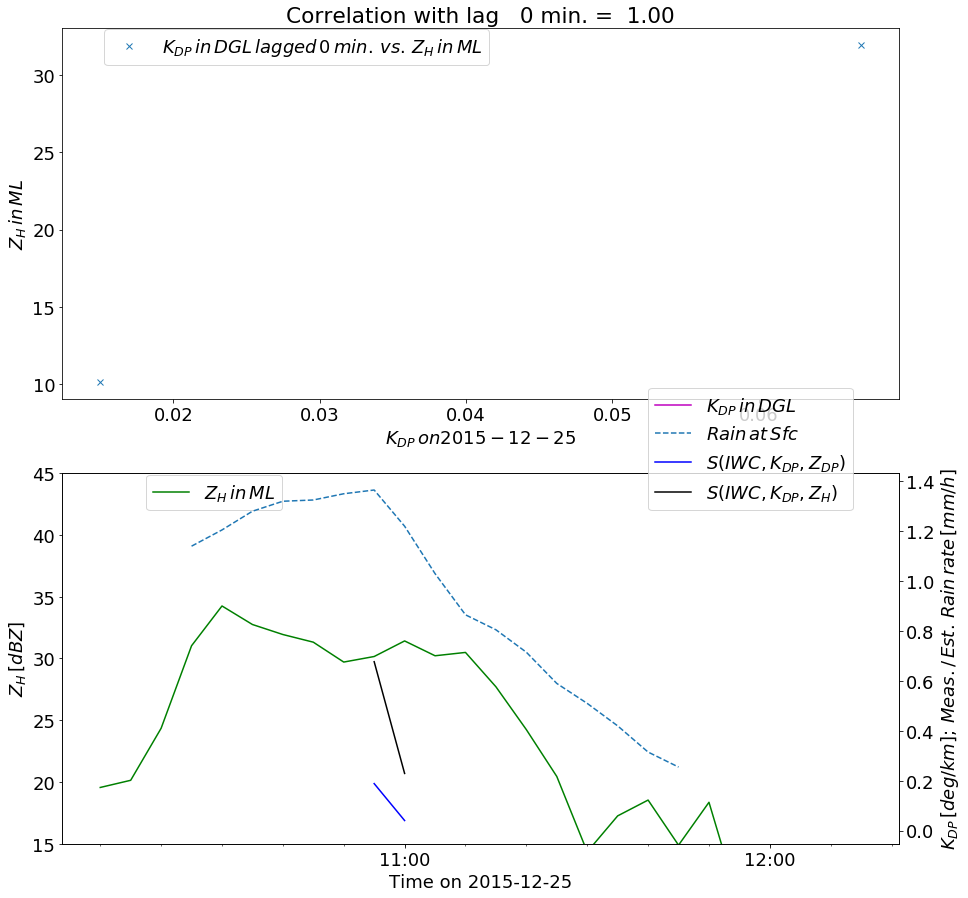

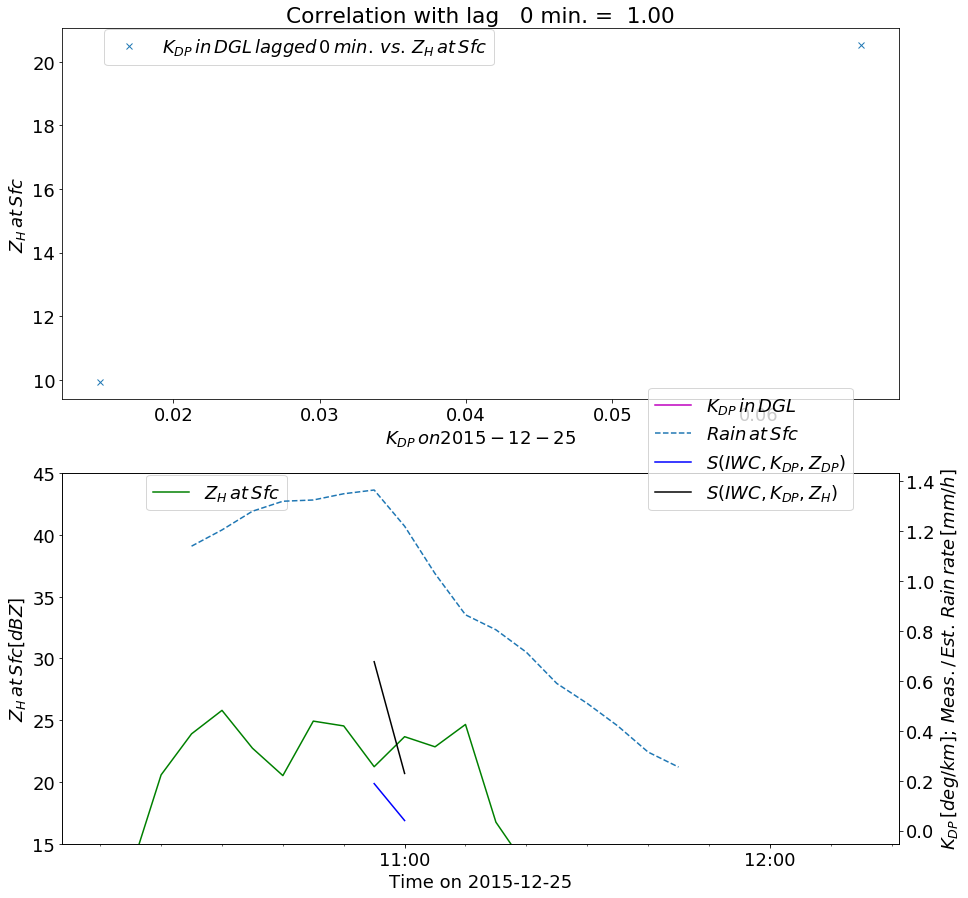

('vorher', -0.42641529280434076)
('p-value', 0.0002587513068248599)
('p-value', 0.015527446967435727)
('p-value', 0.39829747086009304)
('p-value', 0.3675222819373679)
('p-value', 5.7696306552903855e-05)
('p-value', 3.5438582775263596e-05)
('p-value', 4.8727532926312675e-05)
('p-value', 0.00023615275184738602)
('p-value', 0.0002735781833377165)
('p-value', 0.0014025264443877886)
('p-value', 0.00020972007078470234)
('p-value', 3.359322871488126e-08)
('p-value', 1.6202480809774121e-09)
('p-value', 1.0084319463006591e-05)


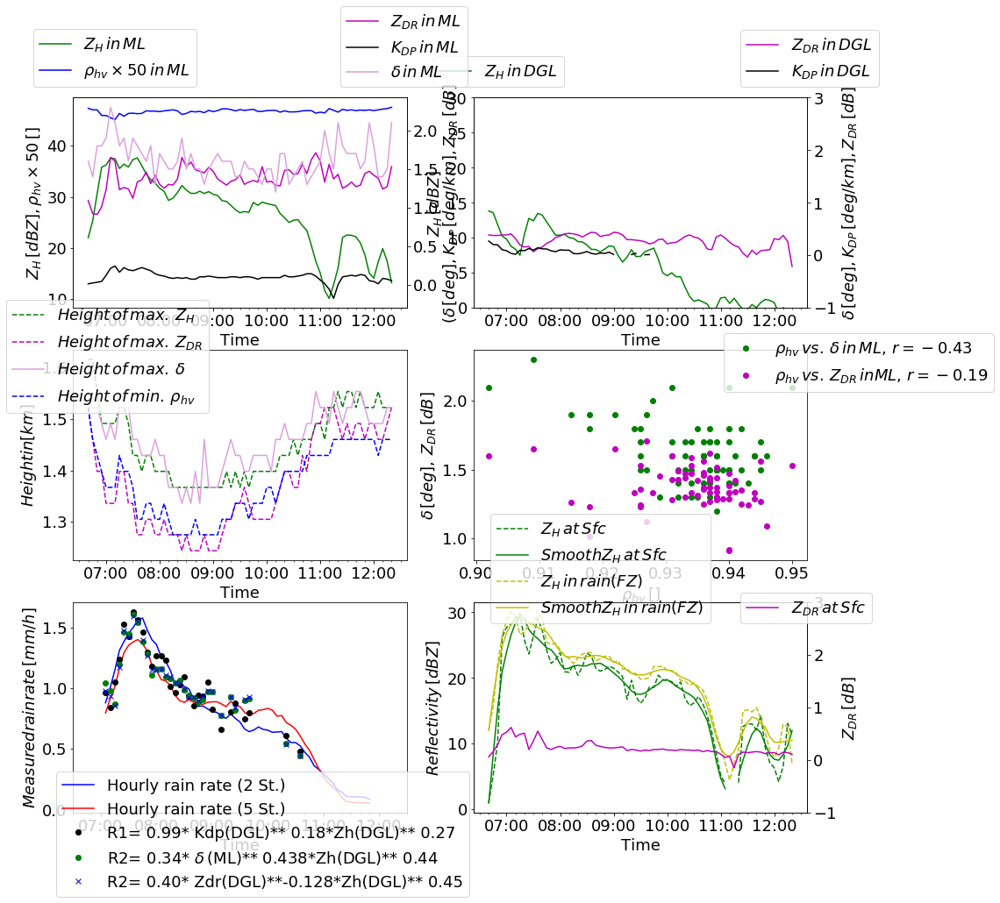

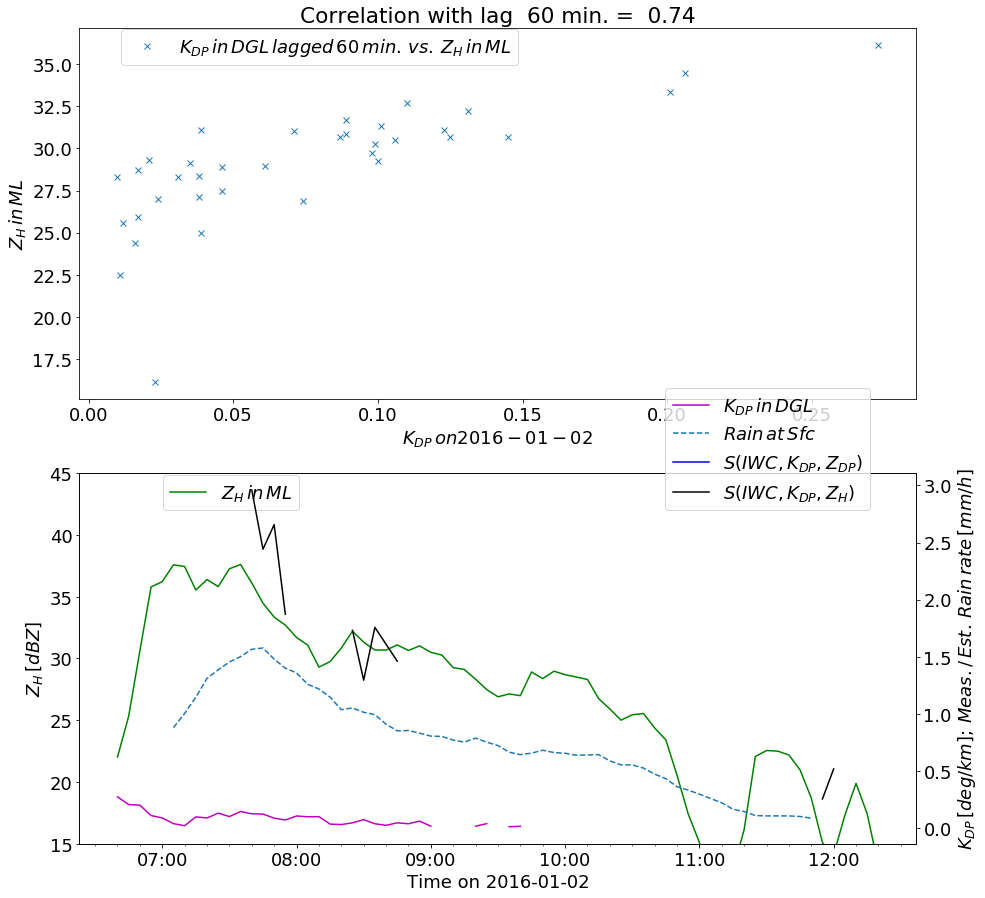

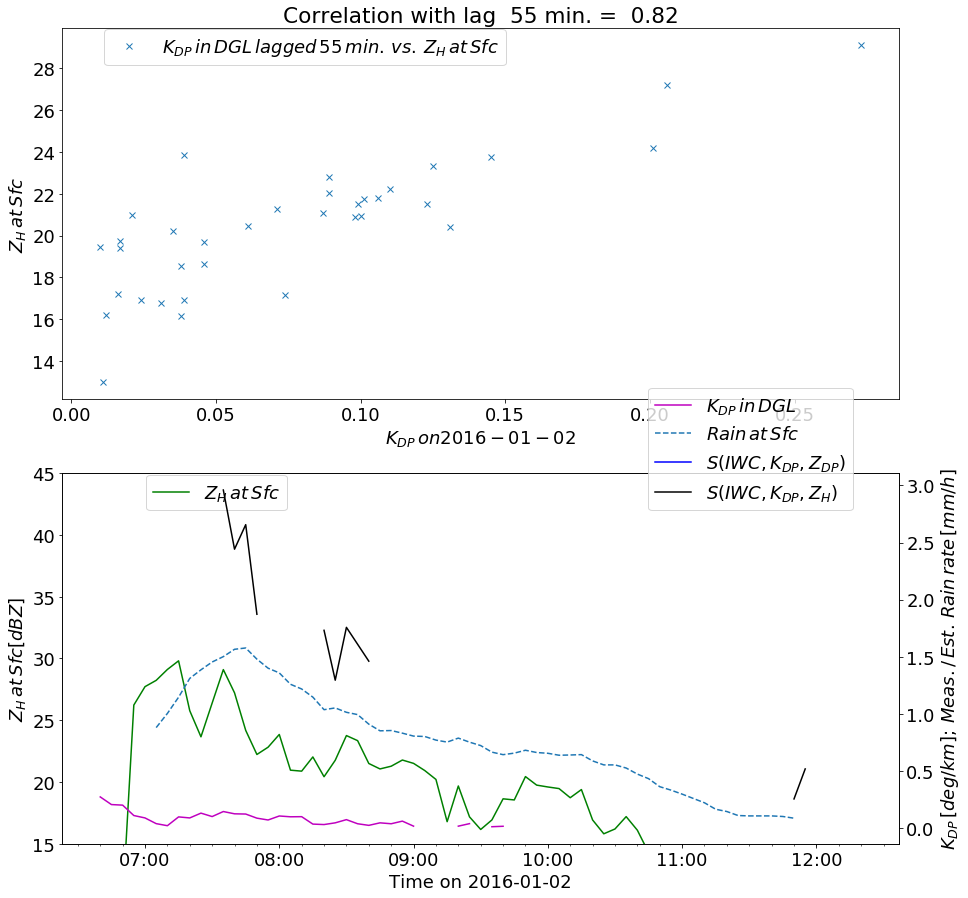

('vorher', -0.8521689357055329)
('p-value', 3.0629720884853084e-12)
('p-value', 0.43398926739428534)
('p-value', 0.3076916924293763)
('p-value', 0.1115966521042362)
('p-value', 0.1820595503568305)
('p-value', 0.15201092689448437)
('p-value', 0.09555924051707713)
('p-value', 0.09380446463665286)
('p-value', 0.03652860097928519)
('p-value', 0.030467370543607094)
('p-value', 0.02551971771038421)
('p-value', 0.05993371962238071)
('p-value', 0.12422295978921494)
('p-value', 0.17426186714664677)


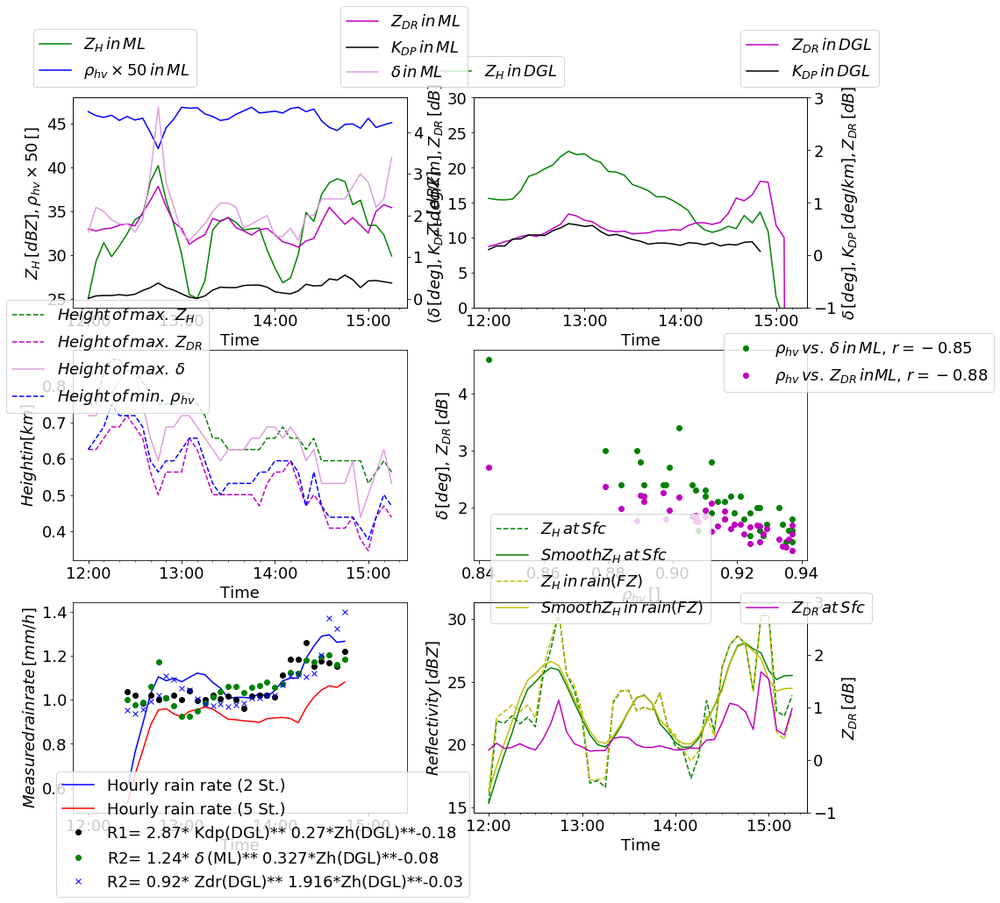

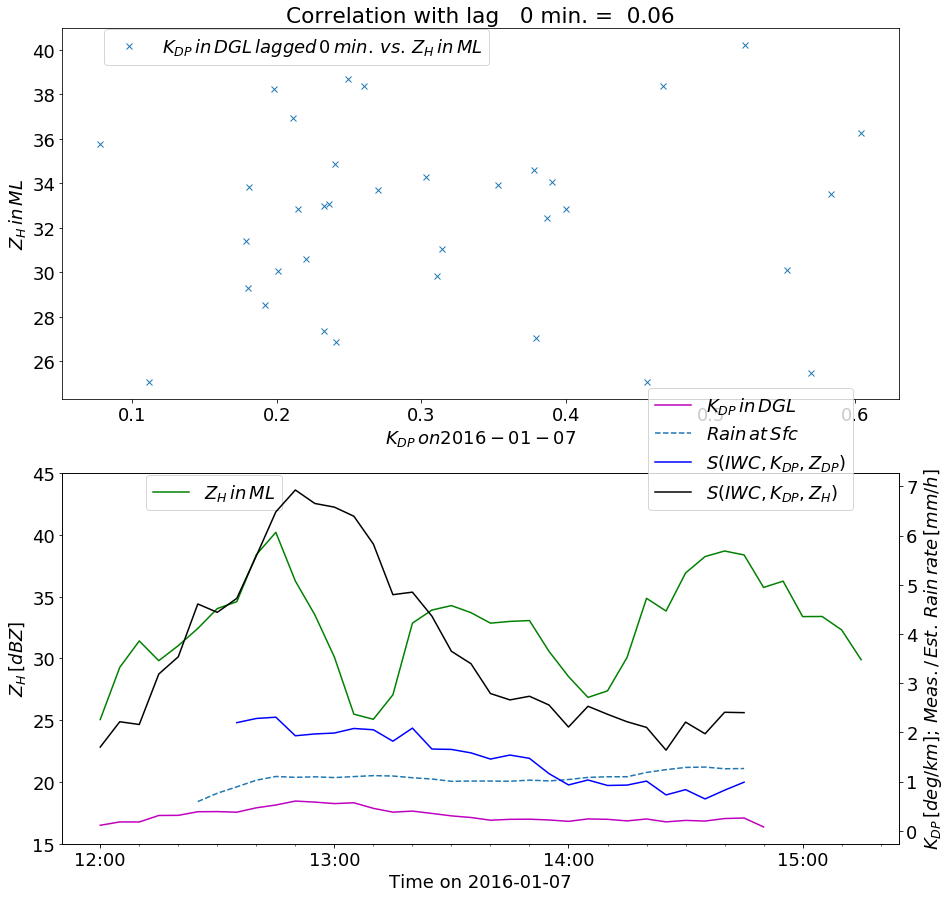

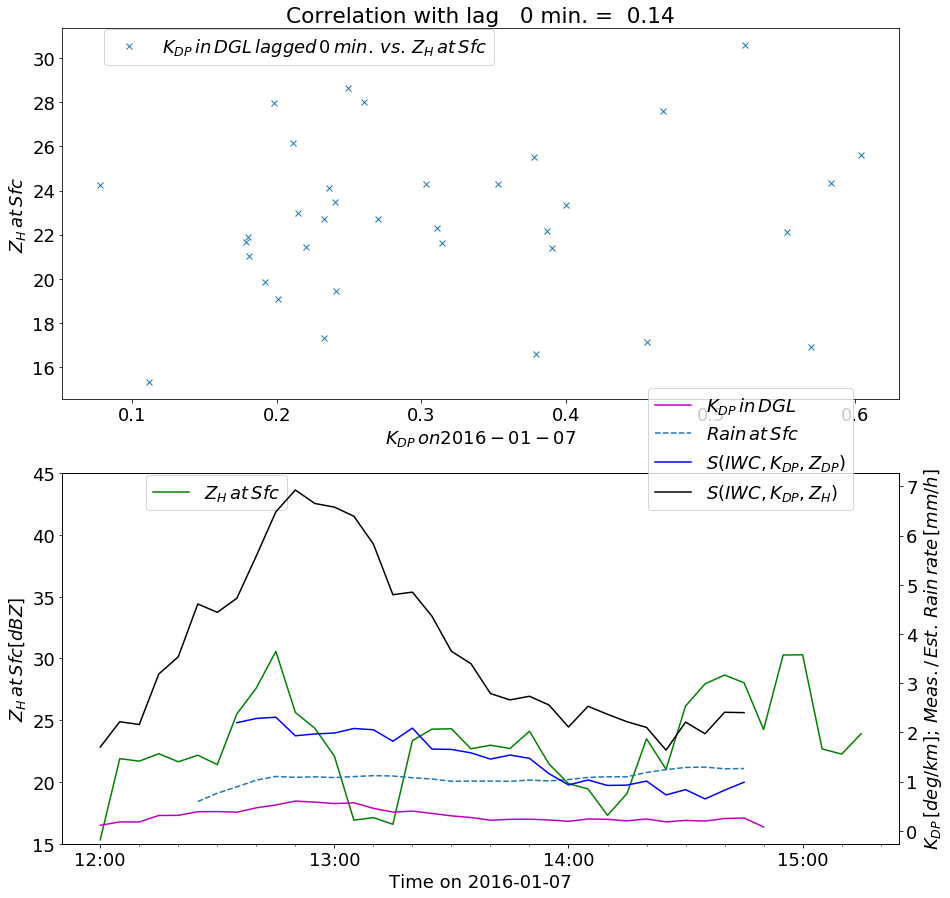

('vorher', -0.6776156229707092)
('p-value', 0.0007381758088891833)
('p-value', 0.11203216683304944)
('p-value', 0.26007427213702655)
('p-value', 0.26931737508022474)
('p-value', 0.981919081334446)
('p-value', 0.44513970301722106)
('p-value', 0.10114881748029976)
('p-value', 0.023538792167351445)
('p-value', 0.02084877635461109)
('p-value', 0.003942497455413127)
('p-value', 0.004857828263448429)
('p-value', 0.008246868527602286)
('p-value', 0.004578494374508623)
('p-value', 0.01836082818794468)


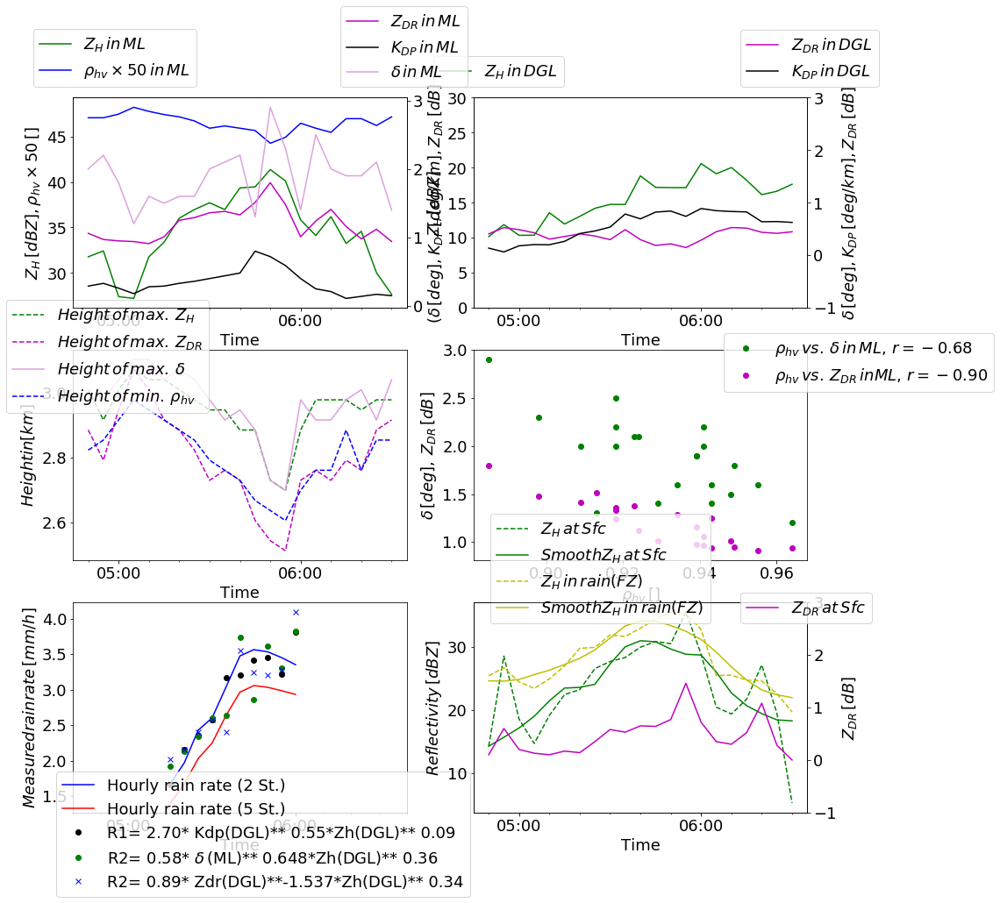

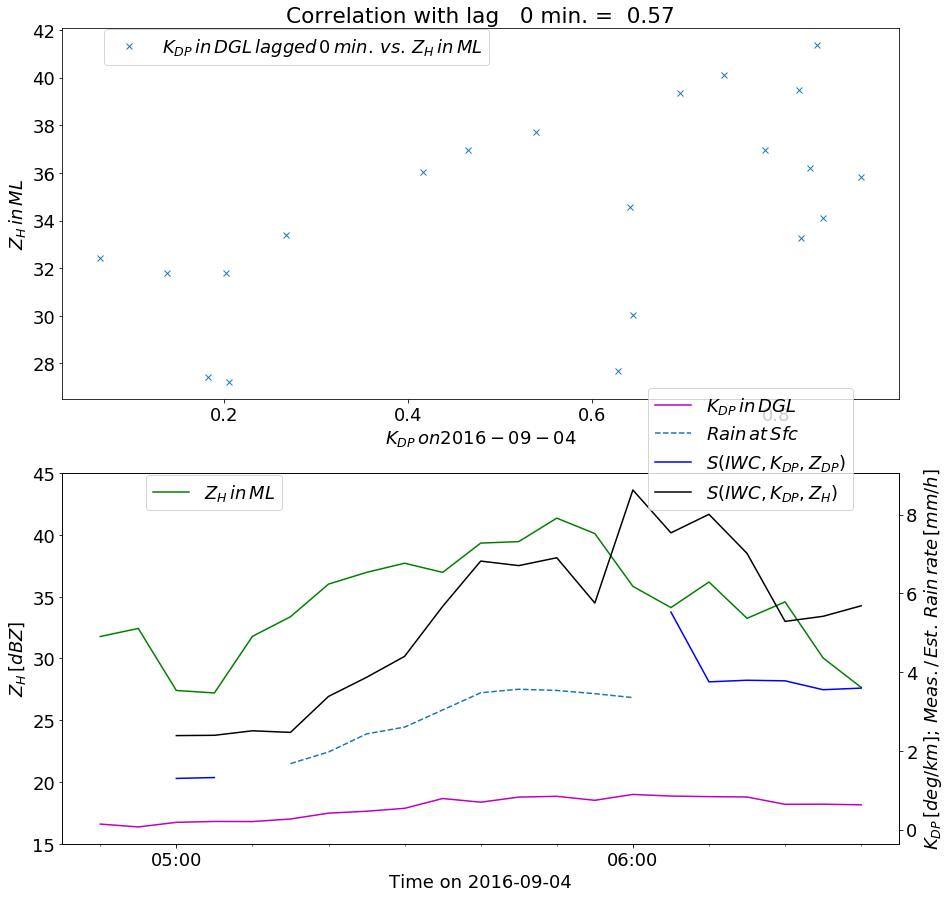

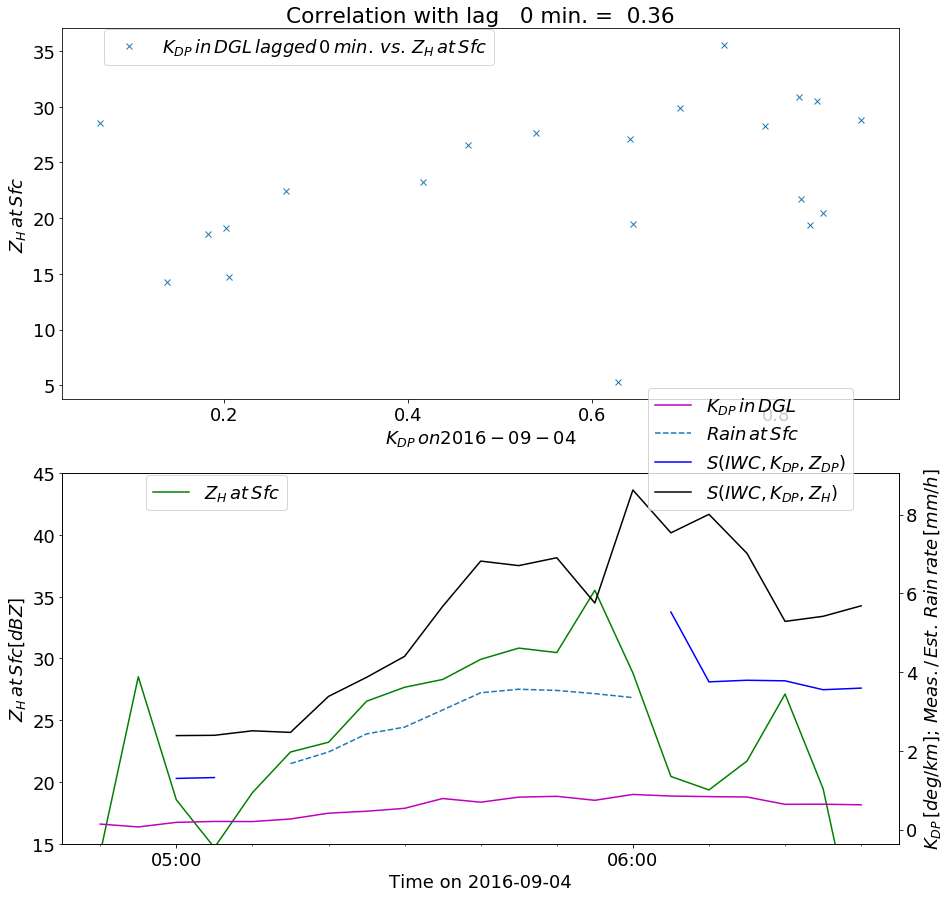

('D_ML_ave und _max', 1.8374463, 5.0)
('R_ML_ave und _max und _min', 0.92983806, 0.97, 0.818)


In [26]:
## read the QVP data
ML_b_clim=[]
ML_t_clim=[]
ML_th_clim=[]
Kdp_ML_clim=[]
D_ML_clim=[]
Dh_clim=[]
Zh_ML_clim=[]
Zhh_clim=[]
Zdr_ML_clim=[]
Zdrh_clim=[]
R_ML_clim=[]
R_S_clim=[]
Rh_clim=[]
Kdp_D_clim=[]
Zdr_D_clim=[]
Zh_D_clim=[]
Zh_rain_clim=[]
Zh_S_clim=[]
Zdr_S_clim=[]
St_clim=[]

R_IWC_D_clim=[]
R_IWC2_D_clim=[]
#for the overall retrieval
Kdp_D_new_clim=[]
Zh_D_new_clim=[]
St_h_new_clim=[]
D_ML_new_clim=[]
Zdr_D_new_clim=[]


#File for output statistics
out_file= open('QVP_ML_Statistics.dat',"w")
out_file.write("The ensuing columns include\n")
out_file.write("Date and covered timespan of event, ML_t_max, ML_t_minmax and ML_th_ave give max and min height of ML with Wolfensberger method and resulting average thickness\n")
out_file.write("Kdp_ML_max and Kdp_ML_min is the max and min amplitude of Kdp in ML\n")
out_file.write("D_ML_max, D_ML_min, D_ML_ave are the max, min, and average amplitudes of delta in ML\n")
out_file.write("Dh-Zhh_max, Dh-Zhh_min, Dh-Zhh_ave are the max, min, and average height differences of delta and Zh in ML\n")
out_file.write("Dh-Zdr_max, Dh-Zdr_min, Dh-Zdr_ave are the max, min, and average height differences of delta and Zdr in ML\n")
out_file.write("ZdrMLS_max and ZdrMLS_min give max and min differences in amplitudes of Zdr betw. ML and Surface\n")
out_file.write("ZhMLS_max, ZhMLS_min, ZhMLS_ave give max, min, and average differences in amplitudes of Zh betw. ML and Surface\n")
out_file.write("\n")
out_file.write("%5s %4s %4s %5s %5s %5s %5s %5s %5s %5s %5s %5s %5s %5s %5s %5s %4s %4s %4s %4s %4s" %
              ('Date','Timespan','ML_t_max','ML_t_min','ML_th_ave','Kdp_ML_max','Kdp_ML_min',
               'D_ML_max', 'D_ML_min', 'D_ML_ave','Dh-Zhh_max', 'Dh-Zhh_min', 'Dh-Zhh_ave','Dh-Zdr_max',
               'Dh-Zdr_min', 'Dh-Zdr_ave', 'ZdrMLS_max', 'ZdrMLS_min', 'ZhMLS_max',
               'ZhMLS_min', 'ZhMLS_ave\n')) 

out_file1= open('QVP_ML_Statistics1.dat',"w")
out_file1.write("The ensuing columns include\n")
out_file1.write("ZhML_max, ZhML_min, ZhML_ave is the max, min, and mean Zh value in the ML\n")
out_file1.write("ZdrML_max, ZdrML_min, ZdrML_ave is the max, min, and mean Zdr value in the ML\n")
out_file1.write("RML_max, RML_min, RML_ave is the max, min, and mean Rhohv value in the ML\n")
out_file1.write("KdpD_max, KdpD_min, KdpD_ave is the max, min, and mean Kdp value in the DGL\n")
out_file1.write("ZdrD_max, ZdrD_min, ZdrD_ave is the max, min, and mean Zdr value in the DGL\n")
out_file1.write("Zdiff_max, Zdif0f_min, Zdiff_ave is the max, min, and mean difference betw. Zh in ML and 150m below ML_bottom\n")
out_file1.write("\n")
out_file1.write("%5s %4s %4s %4s %4s %4s %4s %4s %4s %4s %4s %4s %4s %4s %4s %4s %4s %4s %4s %4s" %
              ('Date','Timespan','ZhML_max', 'ZhML_min','ZhML_ave', 'ZdrML_max', 'ZdrML_min','ZdrML_ave',
               'RML_max', 'RML_min','RML_ave','KdpD_max', 'KdpD_min','KdpD_ave',
               'ZdrD_max', 'ZdrD_min','ZdrD_ave','Zdiff_max', 'Zdiff_min','Zdiff_ave\n')) 

out_file2= open('QPE_Parameters.dat',"w")
out_file2.write("Fit of the Parameters a,b,c,d,e,f in\n")
out_file2.write("R=c* KDP(DGL)^a ZH(DGL)^b\n")
out_file2.write("R=f* delta (ML)^d ZH(DGL)^e\n")
out_file2.write("R=i* Zdr (DGL)^g ZH(DGL)^h\n")
out_file2.write("\n")
out_file2.write("%7s %7s %7s %7s %7s %10s %7s %7s %10s %7s %7s" % ('Date','Timespan','c', 'a', 'b', 'f', 'd', 'e', 'i', 'g','h\n'))

out_file3= open('QVP_correlations.dat',"w")
out_file3.write("The ensuing columns include\n")
out_file3.write("Date and covered timespan of event, Pearson's r betw. delta and rho in ML =c_DML_RML, betw. Zdr and rho= c_ZdrML_RML,\n")
out_file3.write("betw. Zdr and delta=c_ZdrML_DML, betw. Kdp and delta=c_KdpML_DML, betw. delta and its height level=c_DML_Dh\n")
out_file3.write("betw. Zdr at the surface and in the ML=c_ZdrSfc_ZdrML, betw. Zdr at the surface and in delta in the ML=c_ZdrSfc_DML\n") 
out_file3.write("betw. Zh at the surface and delta in the ML=c_ZhSfc_DML\n")
out_file3.write("betw. Zh at the surface and Zh in the ML=c_ZhSfc_ZhML\n")
out_file3.write("betw. Zdr at the surface and Zdr in the ML=c_ZdrSfc_ZdrML\n")
out_file3.write("betw. Kdp in DGL and Zh at the surface=c_KdpD_ZhS\n")
out_file3.write("betw. Zdr in DGL and Zh at the surface=c_ZdrD_ZhS\n")
out_file3.write("betw. Zdr in DGL and Kdp in DGL=c_ZdrD_KdpD\n")
out_file3.write("betw. Zh in DGL and Zh at the surface=c_ZhSfc_ZhD\n")
out_file3.write("\n")
out_file3.write("%7s %7s %7s %7s %7s %8s %7s %8s %8s %7s %7s %7s %7s %7s %7s %7s" % ('Date','Timespan',
                'c_DML_RML','c_ZdrML_RML','c_ZdrML_DML','c_KdpML_DML','c_DML_Dh', 'c_ZdrSfc_ZdrML', 
                'c_ZdrSfc_DML', 'c_ZhSfc_DML', 'c_ZhSfc_ZhML', 'c_ZdrSfc_ZdrML','c_KdpD_ZhS',
                'c_ZdrD_ZhS', 'c_ZdrD_KdpD','c_ZhSfc_ZhD\n'))

#out_file4= open('QVP_correlations_DGL.dat',"w")
#out_file4.write("The ensuing columns include\n")
#out_file4.write("Date and covered timespan of event, Pearson's r betw.\n")
#out_file4.write("betw. Zdr in DGL and Zh at the surface=c_ZdrD_ZhS\n")
#out_file4.write("betw. Zdr in DGL and Kdp in DGL=c_ZdrD_KdpD\n")
#out_file4.write("betw. unsmoothed Zh in DGL and Zh at the surface=c_ZhSfc_ZhD\n")
#out_file4.write("betw. smoothed Zh in DGL and Zh at the surface=c_ZhSfc_ZhD\n")
#out_file4.write("betw. Zh in DGL lag 5min and smoothed Zh at the surface=c_ZhSfc_ZhD05\n")
#out_file4.write("betw. Zh in DGL lag 10min and smoothed Zh at the surface=c_ZhSfc_ZhD1\n")
#out_file4.write("betw. Zh in DGL lag 20min and smoothed Zh at the surface=c_ZhSfc_ZhD2\n")
#out_file4.write("betw. Zh in DGL lag 30min and smoothed Zh at the surface=c_ZhSfc_ZhD3\n")
#out_file4.write("betw. Zh in DGL lag 40min and smoothed Zh at the surface=c_ZhSfc_ZhD4\n")
#out_file4.write("betw. Zh in DGL lag 50min and smoothed Zh at the surface=c_ZhSfc_ZhD5\n")
#out_file4.write("betw. Zh in DGL lag 60min and smoothed Zh at the surface=c_ZhSfc_ZhD6\n")
#out_file4.write("betw. Kdp in DGL and Zh at the surface=c_KdpD_ZhS\n")
#out_file4.write("betw. Kdp in DGL and smoothed Zh at the surface=c_KdpD_ZhSs\n")
#out_file4.write("betw. Kdp in DGL lag 5min and smoothed Zh at the surface=c_ZhSfc_KdpD05\n")
#out_file4.write("betw. Kdp in DGL lag 10min and smoothed Zh at the surface=c_ZhSfc_KdpD10\n")
#out_file4.write("betw. Kdp in DGL lag 20min and smoothed Zh at the surface=c_ZhSfc_KdpD20\n")
#out_file4.write("betw. Kdp in DGL lag 30min and smoothed Zh at the surface=c_ZhSfc_KdpD30\n")
#out_file4.write("betw. Kdp in DGL lag 40min and smoothed Zh at the surface=c_ZhSfc_KdpD40\n")
#out_file4.write("betw. Kdp in DGL lag 50min and smoothed Zh at the surface=c_ZhSfc_KdpD50\n")
#out_file4.write("betw. Kdp in DGL lag 60min and smoothed Zh at the surface=c_ZhSfc_KdpD60\n")
#out_file4.write("\n")
#out_file4.write("%7s %7s %7s %7s %7s %8s %7s %7s %8s %8s %7s %7s %7s %7s %7s %7s %8s %8s %7s %7s %7s %7s" % ('Date','Timespan',
#                'c_ZdrD_ZhS', 'c_ZdrD_KdpD','c_ZhSfc_ZhD','c_ZhSfcs_ZhD','c_ZhSfc_ZhD05',
#                'c_ZhSfc_ZhD1','c_ZhSfc_ZhD2','c_ZhSfc_ZhD3','c_ZhSfc_ZhD4','c_ZhSfc_ZhD5',
#                'c_ZhSfc_ZhD6','c_KdpD_ZhS','c_KdpD_ZhSs','c_ZhSfc_KdpD05','c_ZhSfc_KdpD10','c_ZhSfc_KdpD20',
#                'c_ZhSfc_KdpD30','c_ZhSfc_KdpD40','c_ZhSfc_KdpD50','c_ZhSfc_KdpD60\n'))

#updated file4
out_file4= open('QVP_correlations_DGL.dat',"w")
out_file4.write("The ensuing columns include\n")
out_file4.write("Date, timespan of event, Pearson's r betw.\n")
out_file4.write("betw. Kdp in DGL and Zh at surface=c_KdpD_ZhSs\n")
out_file4.write("betw. Kdp in DGL lag 5min and Zh at surface=c_ZhSfc_ZhD05\n")
out_file4.write("betw. Kdp in DGL lag 10min and Zh at surface=c_ZhSfc_ZhD10\n")
out_file4.write("betw. Kdp in DGL lag 15min and Zh at surface=c_ZhSfc_ZhD15\n")
out_file4.write("betw. Kdp in DGL lag 20min and Zh at surface=c_ZhSfc_ZhD20\n")
out_file4.write("betw. Kdp in DGL lag 25min and Zh at surface=c_ZhSfc_ZhD25\n")
out_file4.write("betw. Kdp in DGL lag 30min and Zh at surface=c_ZhSfc_ZhD30\n")
out_file4.write("betw. Kdp in DGL lag 35min and Zh at surface=c_ZhSfc_ZhD35\n")
out_file4.write("betw. Kdp in DGL lag 40min and Zh at surface=c_ZhSfc_ZhD40\n")
out_file4.write("betw. Kdp in DGL lag 45min and Zh at surface=c_ZhSfc_ZhD45\n")
out_file4.write("betw. Kdp in DGL lag 50min and Zh at surface=c_ZhSfc_ZhD50\n")
out_file4.write("betw. Kdp in DGL lag 55min and Zh at surface=c_ZhSfc_ZhD55\n")
out_file4.write("betw. Kdp in DGL lag 60min and Zh at surface=c_ZhSfc_ZhD60\n")
out_file4.write("\n")
out_file4.write("%8s %10s %7s %7s %7s %8s %7s %7s %7s %10s %8s %7s %7s %8s %8s %10s %4s  %4s" % ('Date','Timespan',
                'c_KdpD_ZhSs', 'c_ZhSfc_ZhD05','c_ZhSfc_ZhD10', 'c_ZhSfc_ZhD15','c_ZhSfc_KdpD20','c_ZhSfc_KdpD25','c_ZhSfc_KdpD30',
                'c_ZhSfc_KdpD35','c_ZhSfc_KdpD40','c_ZhSfc_KdpD45','c_ZhSfc_KdpD50','c_ZhSfc_KdpD55','c_ZhSfc_KdpD60','Bestlag', 'Bestcorr', 'Signi2\n'))


# New output based on Alexanders suggestion
out_file5= open('QVP_correlations_DGL_ML.dat',"w")
out_file5.write("The ensuing columns include\n")
out_file5.write("Date, timespan of event, Pearson's r betw.\n")
out_file5.write("betw. Kdp in DGL and Zh in ML=c_ZhML_KdpD\n")
out_file5.write("betw. Kdp in DGL lag 5min and Zh in ML=c_ZhML_KdpD05\n")
out_file5.write("betw. Kdp in DGL lag 10min and Zh in ML=c_ZhML_KdpD10\n")
out_file5.write("betw. Kdp in DGL lag 20min and Zh in ML=c_ZhML_KdpD20\n")
out_file5.write("betw. Kdp in DGL lag 30min and Zh in ML=c_ZhML_KdpD30\n")
out_file5.write("betw. Kdp in DGL lag 40min and Zh in ML=c_ZhML_KdpD40\n")
out_file5.write("betw. Kdp in DGL lag 50min and Zh in ML=c_ZhML_KdpD50\n")
out_file5.write("betw. Kdp in DGL lag 60min and Zh in ML=c_ZhML_KdpD60\n")
out_file5.write("\n")
out_file5.write("%8s %10s %7s %7s %7s %8s %7s %7s %7s %10s %8s %7s %7s %8s %8s %10s %4s" % ('Date','Timespan',
                'c_ZhML_KdpD', 'c_ZhML_KdpD05','c_ZhML_KdpD10', 'c_ZhML_KdpD15','c_ZhML_KdpD20','c_ZhML_KdpD25','c_ZhML_KdpD30',
                'c_ZhML_KdpD35','c_ZhML_KdpD40','c_ZhML_KdpD45','c_ZhML_KdpD50','c_ZhML_KdpD55','c_ZhML_KdpD60','Bestlag', 'Bestcorr\n'))


for k in range(len(dates)):
#for k in range(0,1):    
    #file=outputf[k]
    file= datepath + "out_" + dates[k] + ".txt"

    #Uhrzeit in 5min Schritten
    Time=[]
    #Hoehe Unterkante ML
    ML_b=[]
    #Hoehe Oberkante ML
    ML_t=[]
    #Dicke der ML
    ML_th=[]
    #Kdp in der ML
    Kdp_ML=[]
    #Maximales PHI in ML
    Phimax=[]
    #Delta in ML
    D_ML=[]
    # Betrachtetes Hoehenintervall für Kdp_ML Schaetzung
    Dh=[]
    #Zh in ML
    Zh_ML=[]
    #Hoehe des Zh Maximums in ML
    Zhh=[]
    #Zdr in ML
    Zdr_ML=[]
    #Hoehe des Zdr Maximums in ML
    Zdrh=[]
    #RHOhv Minimum in ML
    R_ML=[]
    #Rhohv at the surface
    R_S=[]
    #Hoehe des RHOhv Minimums
    Rh=[]
    #KDP in der DGL
    Kdp_D=[]
    #ZDR in der DGL
    Zdr_D=[]
    #Zh in der DGL
    Zh_D=[]
    #Zh in rain approx.150 below ML_bottom
    Zh_rain=[]
    #Zh am Boden
    Zh_S=[]
    #Zdr am Boden
    Zdr_S=[]
    #NN der ersten Raingaugestation
    St1=[]
    #NN der zweiten Raingaugestation
    St2=[]
    #NN der dritten Raingaugestation
    St3=[]
    St4=[]
    St5=[]
    #IWC in the dendritic growth layer a la Ryzhkov et al 2018
    IWC_D=[]
    IWC2_D=[]
    R_IWC_D=[]
    R_IWC2_D=[]

    
    #in_file= open(outputf[k],"r")
    in_file= open(datepath + "out_" + dates[k] + ".txt","r")
    data =np.loadtxt(in_file, skiprows=1, usecols=range(1,26,1), dtype = 'f4')
    in_file.close()
    #in_file= open(outputf[k],"r")
    in_file= open(datepath + "out_" + dates[k] + ".txt","r")
    #Time =np.loadtxt(in_file, skiprows=1, usecols=(0), dtype = np.dtype(dtype))
    Time =np.loadtxt(in_file, skiprows=1, usecols=(0), dtype = 'S5')
    in_file.close()
    #
    in_file2 = open(datepath + 'Retriev_'+ dates[k] +'.txt', 'r')
    data2 =np.loadtxt(in_file2, skiprows=1, usecols=(3,4,1), dtype = 'f4')
    in_file2.close()
    #
    for l in range(len(Time)):
        Time[l]=Time[l][0:5]
        #St=max(St1,St2,St3)
        #print(Time[l],l)
    
    dates0 = dt.datetime.strptime(dates[k]+Time[0], '%Y-%m-%d%H:%M')
    dates1 = dt.datetime.strptime(dates[k]+Time[-1], '%Y-%m-%d%H:%M')
    deltat = dates1-dates0
    #print(dates0, dates1)
    Time=np.arange(dates0, dates1 + timedelta(minutes=5), timedelta(minutes=5))

    IWC_D=data2[:,0]
    R_IWC_D=IWC_D*3.7
    IWC2_D=data2[:,1]
    R_IWC2_D=IWC2_D*3.7
    
    R_IWC_D_clim.extend(R_IWC_D)
    R_IWC2_D_clim.extend(R_IWC2_D)
    ML_b=data[:,0]
    ML_b_clim.extend(ML_b)
    ML_t=data[:,1]
    ML_t_clim.extend(ML_t)
    ML_th=data[:,2]
    ML_th_clim.extend(ML_th)
    Kdp_ML=data[:,3]
    Kdp_ML_clim.extend(Kdp_ML)
    Phimax=data[:,4]
    D_ML=data[:,5]
    D_ML_clim.extend(D_ML)
    Dh=data[:,6]
    Dh_clim.extend(Dh)
    Zh_ML=data[:,7]
    Zh_ML_clim.extend(Zh_ML)
    Zhh=data[:,8]
    Zhh_clim.extend(Zhh)
    Zdr_ML=data[:,9]
    Zdr_ML_clim.extend(Zdr_ML)
    Zdrh=data[:,10]
    Zdrh_clim.extend(Zdrh)
    R_ML=data[:,11]
    R_ML_clim.extend(R_ML)
    Rh=data[:,12]
    Rh_clim.append(Rh)
    Kdp_D=data[:,13]
    Kdp_D_clim.extend(Kdp_D)
    Zdr_D=data[:,14]
    Zdr_D_clim.extend(Zdr_D)
    Zh_D=data[:,15]
    Zh_D_clim.extend(Zh_D)
    Zh_rain=data[:,16]
    Zh_rain_clim.extend(Zh_rain)
    Zh_S=data[:,17]
    Zh_S_clim.extend(Zh_S)
    Zdr_S=data[:,18]
    Zdr_S_clim.extend(Zdr_S)
    R_S=data[:,19]
    R_S_clim.extend(R_S)
    St1=data[:,20]
    St2=data[:,21]
    St3=data[:,22]
    St4=data[:,23]
    St5=data[:,24]
    ## Single event statistics
    ##To avoid single high values due to small gaps of negative Zh
    zMLplus=np.copy(Zh_ML)
    zSplus=np.copy(Zh_S)
    zdrMLplus=np.copy(Zdr_ML)
    zdrSplus=np.copy(Zdr_S)
    zmask= np.where((zMLplus < 0) | (zSplus <0))
    zMLplus[zmask]=np.nan
    zSplus[zmask]=np.nan
    zdrmask= np.where((zdrMLplus < 0) | (zdrSplus <0))
    zdrMLplus[zdrmask]=np.nan
    zdrSplus[zdrmask]=np.nan
    
    out_file.write("%6s %7s %7.2f %7.2f %7.2f %8.2f %7.2f %7.2f %7.2f %7.2f %8.3f %7.3f %7.3f %7.3f %7.3f %7.3f %6.2f %6.2f %7.2f %7.2f %7.2f\n" %
              (dates[k],deltat,np.nanmax(ML_t, axis=0),np.nanmin(ML_t, axis=0),np.nanmean(ML_th, axis=0),
               np.nanmax(Kdp_ML, axis=0),np.nanmin(Kdp_ML, axis=0),np.nanmax(D_ML, axis=0), 
               np.nanmin(D_ML, axis=0), np.nanmean(D_ML,axis=0), np.nanmax(Dh-Zhh,axis=0), np.nanmin(Dh-Zhh,axis=0), np.nanmean(Dh-Zhh,axis=0),
               np.nanmax(Dh-Zdrh,axis=0),np.nanmin(Dh-Zdrh,axis=0), np.nanmean(Dh-Zdrh,axis=0),
               np.nanmax(zdrMLplus-zdrSplus,axis=0),np.nanmin(zdrMLplus-zdrSplus,axis=0),
               np.nanmax(zMLplus-zSplus,axis=0),np.nanmin(zMLplus-zSplus,axis=0), 
               np.nanmean(zMLplus-zSplus,axis=0)))
           
    out_file1.write("%6s %7s %7.2f %7.2f %7.2f %7.2f %7.2f %7.2f %7.3f %7.3f %7.3f %7.2f %7.2f %7.2f %7.2f %7.2f %7.2f %7.2f %7.2f %7.2f\n" %
              (dates[k],deltat, np.nanmax(zMLplus,axis=0),np.nanmin(zMLplus,axis=0),np.nanmean(zMLplus,axis=0),
               np.nanmax(zdrMLplus,axis=0),np.nanmin(zdrMLplus,axis=0),np.nanmean(zdrMLplus,axis=0),
               np.nanmax(R_ML,axis=0),np.nanmin(R_ML,axis=0),np.nanmean(R_ML,axis=0),
               np.nanmax(Kdp_D,axis=0),np.nanmin(Kdp_D,axis=0),np.nanmean(Kdp_D,axis=0),
               np.nanmax(Zdr_D,axis=0),np.nanmin(Zdr_D,axis=0),np.nanmean(Zdr_D,axis=0),
               np.nanmax((Zh_ML-Zh_rain),axis=0),np.nanmin((Zh_ML-Zh_rain),axis=0),
               np.nanmean((Zh_ML-Zh_rain),axis=0)))
 
    #St=(St1+St2+St3+St4+St5)/5.
    St= (St1+St2)/2.
    #St_clim.extend(St)
    St_all=(St1+St2+St3+St4+St5)/5.
    
    claw='pearson'
    #claw='spearman'
    #claw='kendall'
    
    #delta in ML with Rho in ML
    #c_DML_RML, p =pearsonr(D_ML, R_ML)
    #alternativ
    c = np.vstack((D_ML, R_ML))
    #print(c.shape)
    df = pd.DataFrame(c.T, columns=['D_ML', 'R_ML'])
    c_DML_RML=df.corr(method=claw).as_matrix()[1,0]
    #Signifikanz
    print('vorher', c_DML_RML)
    df_clean = df.dropna()
    nachher=stats.pearsonr(df_clean['D_ML'], df_clean['R_ML'])
    print('p-value', nachher[1])
    vix_on_gdp = pd.ols(y=df_clean['D_ML'], x=df_clean['R_ML'], intercept=True)
    print('nochmal',df['D_ML'].corr(df['R_ML']), vix_on_gdp.f_stat['p-value'])
    
    

    #Zdr in ML with Rho in ML
    #c_ZdrML_RML, p =pearsonr(Zdr_ML, R_ML)
        #alternativ
    c =np.vstack((Zdr_ML,R_ML))
    df = pd.DataFrame(c.T, columns=['Zdr_ML', 'R_ML'])
    c_ZdrML_RML=df.corr(method=claw).as_matrix()[1,0]
    #Zdr in ML with delta in ML
        #alternativ
    #c_ZdrML_DML, p =pearsonr(Zdr_ML, D_ML)
    c =np.vstack((Zdr_ML,D_ML))
    df = pd.DataFrame(c.T, columns=['Zdr_ML', 'D_ML'])
    c_ZdrML_DML=df.corr(method=claw).as_matrix()[1,0]
    #delta in ML with Kdp in ML
    #c_KdpML_DML, p =pearsonr(Kdp_ML, D_ML)
        #alternativ
    c =np.vstack((Kdp_ML,D_ML))
    df = pd.DataFrame(c.T, columns=['Kdp_ML', 'D_ML'])
    c_KdpML_DML=df.corr(method=claw).as_matrix()[1,0]
    #delta in ML with height level of delta
    #c_DML_Dh, p =pearsonr(D_ML, Dh)
        #alternativ
    c =np.vstack((D_ML,Dh))    
    df = pd.DataFrame(c.T, columns=['D_ML', 'Dh'])
    c_DML_Dh=df.corr(method=claw).as_matrix()[1,0]
    
    ###ML with Sfc
    #Zdr at Sfc with Zdr in ML
    #c_ZdrSfc_ZdrML, p = pearsonr(Zdr_S, Zdr_ML)
        #alternativ
    c =np.vstack((Zdr_S,Zdr_ML))    
    df = pd.DataFrame(c.T, columns=['Zdr_S', 'Zdr_ML'])
    c_ZdrSfc_ZdrML=df.corr(method=claw).as_matrix()[1,0]
    #Zdr at Sfc with delta in ML
    #c_ZdrSfc_DML, p = pearsonr(Zdr_S, D_ML)
        #alternativ
    c =np.vstack((Zdr_S,D_ML))    
    df = pd.DataFrame(c.T, columns=['Zdr_S', 'D_ML'])   
    c_ZdrSfc_DML=df.corr(method=claw).as_matrix()[1,0]
    #delta in ML with Z at Sfc
    #c_ZhSfc_DML, p = pearsonr(Zh_S, D_ML)
        #laternativ
    c =np.vstack((Zh_S,D_ML))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'D_ML']) 
    c_ZhSfc_DML=df.corr(method=claw).as_matrix()[1,0]
    
    #Zh at the Surface and in the ML
    c =np.vstack((Zh_S,Zh_ML))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Zh_ML']) 
    c_ZhSfc_ZhML=df.corr(method=claw).as_matrix()[1,0]
    
    #Zh in rain and in the ML
    c =np.vstack((Zh_rain,Zh_ML))    
    df = pd.DataFrame(c.T, columns=['Zh_rain', 'Zh_ML']) 
    c_Zhrain_ZhML=df.corr(method=claw).as_matrix()[1,0]
    
    #Zdr at the Surface and in the ML
    c =np.vstack((Zdr_S,Zdr_ML))    
    df = pd.DataFrame(c.T, columns=['Zdr_S', 'Zdr_ML']) 
    c_ZdrSfc_ZdrML=df.corr(method=claw).as_matrix()[1,0]
    
    #Kdf in DGL and Zh at the Surface
    c =np.vstack((Kdp_D,Zh_S))    
    df = pd.DataFrame(c.T, columns=['Kdp_D', 'Zh_S']) 
    c_KdpD_ZhS=df.corr(method=claw).as_matrix()[1,0]
    
    #Zdr in DGL and Zh at the Surface
    c =np.vstack((Zdr_D,Zh_S))    
    df = pd.DataFrame(c.T, columns=['Zdr_D', 'Zh_S']) 
    c_ZdrD_ZhS=df.corr(method=claw).as_matrix()[1,0]
    
    #Zdr in DGL and Kdp in DGL
    c =np.vstack((Zdr_D,Kdp_D))    
    df = pd.DataFrame(c.T, columns=['Zdr_D', 'Kdp_D']) 
    c_ZdrD_KdpD=df.corr(method=claw).as_matrix()[1,0]
    
    # Zh DGL with Zh surface
    c =np.vstack((Zh_S,Zh_D))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Zh_D']) 
    c_ZhSfc_ZhD=df.corr(method=claw).as_matrix()[1,0]
    
    # Kdp DGL with Zh in ML
    c =np.vstack((Zh_ML,Kdp_D))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D']) 
    c_ZhML_KdpD=df.corr(method=claw).as_matrix()[1,0]
    
    
    #geht lagged correlation? Zh DGL shifted with Zh suface
    #Zh_D1=np.roll(Zh_D, 1)
    #Zh_D2=np.roll(Zh_D, 2)
    #Zh_D3=np.roll(Zh_D, 3)
    #alternativ
    Zh_Ss=savitzky_golay(Zh_S, window_size=13, order=2, deriv=0)
    Zh_rains=savitzky_golay(Zh_rain, window_size=13, order=2, deriv=0)
    Zh_D05=np.copy(Zh_D)
    Zh_D1=np.copy(Zh_D)
    Zh_D2=np.copy(Zh_D)
    Zh_D3=np.copy(Zh_D)
    Zh_D4=np.copy(Zh_D)
    Zh_D5=np.copy(Zh_D)
    Zh_D6=np.copy(Zh_D)
    Zh_D05=shift(Zh_D05, 1)
    Zh_D1=shift(Zh_D1, 2)
    Zh_D2=shift(Zh_D2, 4)
    Zh_D3=shift(Zh_D3, 6)
    Zh_D4=shift(Zh_D4, 8)
    Zh_D5=shift(Zh_D5, 10)
    Zh_D6=shift(Zh_D6, 12)
    
    #Alexanders suggestions, do not include insignificant KDP
    Kdp_D_mask=np.where(Kdp_D <= 0 )
    Kdp_D[Kdp_D_mask]=np.nan
    
    Kdp_D05=np.copy(Kdp_D)
    Kdp_D10=np.copy(Kdp_D)
    Kdp_D15=np.copy(Kdp_D)
    Kdp_D20=np.copy(Kdp_D)
    Kdp_D25=np.copy(Kdp_D)
    Kdp_D30=np.copy(Kdp_D)
    Kdp_D35=np.copy(Kdp_D)
    Kdp_D40=np.copy(Kdp_D)
    Kdp_D45=np.copy(Kdp_D)
    Kdp_D50=np.copy(Kdp_D)
    Kdp_D55=np.copy(Kdp_D)
    Kdp_D60=np.copy(Kdp_D)
    Kdp_D05=shift(Kdp_D05, 1)
    Kdp_D10=shift(Kdp_D10, 2)
    Kdp_D15=shift(Kdp_D15, 3)
    Kdp_D20=shift(Kdp_D20, 4)
    Kdp_D25=shift(Kdp_D25, 5)
    Kdp_D30=shift(Kdp_D30, 6)
    Kdp_D35=shift(Kdp_D35, 7)
    Kdp_D40=shift(Kdp_D40, 8)
    Kdp_D45=shift(Kdp_D45, 9)
    Kdp_D50=shift(Kdp_D50, 10)
    Kdp_D55=shift(Kdp_D55, 11)
    Kdp_D60=shift(Kdp_D60, 12)
    
    # same for R_IWC
    R_IWC_D_mask=np.where((Zdr_D<0.4) | (Kdp_D<0.1)| (Zh_D<0.))
    R_IWC_D[R_IWC_D_mask]=np.nan
    R_IWC_D05=np.copy(R_IWC_D)
    R_IWC_D10=np.copy(R_IWC_D)
    R_IWC_D15=np.copy(R_IWC_D)
    R_IWC_D20=np.copy(R_IWC_D)
    R_IWC_D25=np.copy(R_IWC_D)
    R_IWC_D30=np.copy(R_IWC_D)
    R_IWC_D35=np.copy(R_IWC_D)
    R_IWC_D40=np.copy(R_IWC_D)
    R_IWC_D45=np.copy(R_IWC_D)
    R_IWC_D50=np.copy(R_IWC_D)
    R_IWC_D55=np.copy(R_IWC_D)
    R_IWC_D60=np.copy(R_IWC_D)
    R_IWC_D05=shift(R_IWC_D05, 1)
    R_IWC_D10=shift(R_IWC_D10, 2)
    R_IWC_D15=shift(R_IWC_D15, 3)
    R_IWC_D20=shift(R_IWC_D20, 4)
    R_IWC_D25=shift(R_IWC_D25, 5)
    R_IWC_D30=shift(R_IWC_D30, 6)
    R_IWC_D35=shift(R_IWC_D35, 7)
    R_IWC_D40=shift(R_IWC_D40, 8)
    R_IWC_D45=shift(R_IWC_D45, 9)
    R_IWC_D50=shift(R_IWC_D50, 10)
    R_IWC_D55=shift(R_IWC_D55, 11)
    R_IWC_D60=shift(R_IWC_D60, 12)
    #
    # same for R_IWC_D2
    # same for R_IWC
    R_IWC2_D_mask=np.where(Kdp_D<0.1)
    R_IWC2_D[R_IWC2_D_mask]=np.nan
    R_IWC2_D05=np.copy(R_IWC2_D)
    R_IWC2_D10=np.copy(R_IWC2_D)
    R_IWC2_D15=np.copy(R_IWC2_D)
    R_IWC2_D20=np.copy(R_IWC2_D)
    R_IWC2_D25=np.copy(R_IWC2_D)
    R_IWC2_D30=np.copy(R_IWC2_D)
    R_IWC2_D35=np.copy(R_IWC2_D)
    R_IWC2_D40=np.copy(R_IWC2_D)
    R_IWC2_D45=np.copy(R_IWC2_D)
    R_IWC2_D50=np.copy(R_IWC2_D)
    R_IWC2_D55=np.copy(R_IWC2_D)
    R_IWC2_D60=np.copy(R_IWC2_D)
    R_IWC2_D05=shift(R_IWC2_D05, 1)
    R_IWC2_D10=shift(R_IWC2_D10, 2)
    R_IWC2_D15=shift(R_IWC2_D15, 3)
    R_IWC2_D20=shift(R_IWC2_D20, 4)
    R_IWC2_D25=shift(R_IWC2_D25, 5)
    R_IWC2_D30=shift(R_IWC2_D30, 6)
    R_IWC2_D35=shift(R_IWC2_D35, 7)
    R_IWC2_D40=shift(R_IWC2_D40, 8)
    R_IWC2_D45=shift(R_IWC2_D45, 9)
    R_IWC2_D50=shift(R_IWC2_D50, 10)
    R_IWC2_D55=shift(R_IWC2_D55, 11)
    R_IWC2_D60=shift(R_IWC2_D60, 12)
    #
    
    c =np.vstack((Zh_Ss,Zh_D))    
    df = pd.DataFrame(c.T, columns=['Zh_Ss', 'Zh_D']) 
    c_ZhSfcs_ZhD=df.corr(method=claw).as_matrix()[1,0]
    
    c =np.vstack((Zh_Ss,Zh_D05))    
    df = pd.DataFrame(c.T, columns=['Zh_Ss', 'Zh_D05']) 
    c_ZhSfc_ZhD05=df.corr(method=claw).as_matrix()[1,0]
    
    c =np.vstack((Zh_Ss,Zh_D1))    
    df = pd.DataFrame(c.T, columns=['Zh_Ss', 'Zh_D1']) 
    c_ZhSfc_ZhD1=df.corr(method=claw).as_matrix()[1,0]
    
    c =np.vstack((Zh_Ss,Zh_D2))    
    df = pd.DataFrame(c.T, columns=['Zh_Ss', 'Zh_D2']) 
    c_ZhSfc_ZhD2=df.corr(method=claw).as_matrix()[1,0]
    
    c =np.vstack((Zh_Ss,Zh_D3))    
    df = pd.DataFrame(c.T, columns=['Zh_Ss', 'Zh_D3']) 
    c_ZhSfc_ZhD3=df.corr(method=claw).as_matrix()[1,0]
    
    c =np.vstack((Zh_Ss,Zh_D4))    
    df = pd.DataFrame(c.T, columns=['Zh_Ss', 'Zh_D4']) 
    c_ZhSfc_ZhD4=df.corr(method=claw).as_matrix()[1,0]
    
    c =np.vstack((Zh_Ss,Zh_D5))    
    df = pd.DataFrame(c.T, columns=['Zh_Ss', 'Zh_D5']) 
    c_ZhSfc_ZhD5=df.corr(method=claw).as_matrix()[1,0]
    
    c =np.vstack((Zh_Ss,Zh_D6))    
    df = pd.DataFrame(c.T, columns=['Zh_Ss', 'Zh_D6']) 
    c_ZhSfc_ZhD6=df.corr(method=claw).as_matrix()[1,0]
    
    ##lagged corr of Zh surface mit KDP_D, extended with 5min steps
    #Zh_Ss_mask=np.where(Zh_Ss<0)
    #Zh_Ss[Zh_Ss_mask]=np.nan
    #Zh_S[Zh_Ss_mask]=np.nan
    #correls2=[]
    #c =np.vstack((Zh_Ss,Kdp_D))  
    
    ###ich versuch mal stattdessenden die nicht geglättete surface reflectivity
    Zh_S_mask=np.where(Zh_S<0)
    Zh_Ss[Zh_S_mask]=np.nan
    Zh_S[Zh_S_mask]=np.nan
    correls2=[]
    sigs2=[]
    c =np.vstack((Zh_S,Kdp_D))  
    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D']) 
    c_KdpD_ZhSs=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_KdpD_ZhSs)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D05))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D05']) 
    c_ZhSfc_KdpD05=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD05)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D05'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D10))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D10']) 
    c_ZhSfc_KdpD10=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD10)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D10'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D15))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D15']) 
    c_ZhSfc_KdpD15=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD15)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D15'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D20))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D20']) 
    c_ZhSfc_KdpD20=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD20)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D20'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D25))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D25']) 
    c_ZhSfc_KdpD25=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD25)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D25'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D30))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D30']) 
    c_ZhSfc_KdpD30=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD30)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D30'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D35))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D35']) 
    c_ZhSfc_KdpD35=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD35)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D35'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D40))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D40']) 
    c_ZhSfc_KdpD40=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD40)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D40'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D45))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D45']) 
    c_ZhSfc_KdpD45=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD45)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D45'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D50))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D50']) 
    c_ZhSfc_KdpD50=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD50)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D50'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D55))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D55']) 
    c_ZhSfc_KdpD55=df.corr(method=claw).as_matrix()[1,0]
    correls2.append(c_ZhSfc_KdpD55)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D55'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    c =np.vstack((Zh_S,Kdp_D60))    
    df = pd.DataFrame(c.T, columns=['Zh_S', 'Kdp_D60']) 
    c_ZhSfc_KdpD60=df.corr(method=claw).as_matrix()[1,0]    
    correls2.append(c_ZhSfc_KdpD60)
    df_clean = df.dropna()
    sig=stats.pearsonr(df_clean['Zh_S'], df_clean['Kdp_D60'])
    print('p-value', sig[1])
    sigs2.append(sig[1])
    
    mlag2=correls2.index(max(correls2))
    mcorrel2=max(correls2)
    signi2=sigs2[mlag2]

    ####new lagged correlations according to Alexanders suggestions
    ##lagged corr of Zh surface mit KDP_D
    correls=[]
    
    c =np.vstack((Zh_ML,Kdp_D))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D']) 
    c_ZhML_KdpD=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD)
    
    c =np.vstack((Zh_ML,Kdp_D05))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D05']) 
    c_ZhML_KdpD05=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD05)
    
    c =np.vstack((Zh_ML,Kdp_D10))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D10']) 
    c_ZhML_KdpD10=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD10)
    
    c =np.vstack((Zh_ML,Kdp_D15))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D15']) 
    c_ZhML_KdpD15=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD15)
    
    c =np.vstack((Zh_ML,Kdp_D20))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D20']) 
    c_ZhML_KdpD20=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD20)
    
    c =np.vstack((Zh_ML,Kdp_D25))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D25']) 
    c_ZhML_KdpD25=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD25)
    
    c =np.vstack((Zh_ML,Kdp_D30))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D30']) 
    c_ZhML_KdpD30=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD30)
    
    c =np.vstack((Zh_ML,Kdp_D35))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D35']) 
    c_ZhML_KdpD35=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD35)
    
    c =np.vstack((Zh_ML,Kdp_D40))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D40']) 
    c_ZhML_KdpD40=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD40)
    
    c =np.vstack((Zh_ML,Kdp_D45))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D45']) 
    c_ZhML_KdpD45=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD45)
    
    c =np.vstack((Zh_ML,Kdp_D50))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D50']) 
    c_ZhML_KdpD50=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD50)
    
    c =np.vstack((Zh_ML,Kdp_D55))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D55']) 
    c_ZhML_KdpD55=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD55)
    
    c =np.vstack((Zh_ML,Kdp_D60))    
    df = pd.DataFrame(c.T, columns=['Zh_ML', 'Kdp_D60']) 
    c_ZhML_KdpD60=df.corr(method=claw).as_matrix()[1,0]
    correls.append(c_ZhML_KdpD60)
    
    mlag=correls.index(max(correls))
    mcorrel=max(correls)
    #minlag=5*mlag
    #if minlag == 0:
    #    series = 'Kdp_D'
    #if minlag == 5:
    #    series = 'Kdp_D05'
    #if minlag > 5:
    #    series = 'Kdp_D'+str(minlag)
    
    series=np.array([Kdp_D,Kdp_D05,Kdp_D10, Kdp_D15,Kdp_D20,Kdp_D25,Kdp_D30,Kdp_D35,Kdp_D40,Kdp_D45,Kdp_D50,Kdp_D55,Kdp_D60])
    rseries=np.array([R_IWC_D, R_IWC_D05 ,R_IWC_D10 ,R_IWC_D15 ,R_IWC_D20 ,R_IWC_D25 ,R_IWC_D30 ,R_IWC_D35, R_IWC_D40, R_IWC_D45,R_IWC_D50,R_IWC_D55,R_IWC_D60])
    rseries2=np.array([R_IWC2_D, R_IWC2_D05 ,R_IWC2_D10 ,R_IWC2_D15 ,R_IWC2_D20 ,R_IWC2_D25 ,R_IWC2_D30 ,R_IWC2_D35, R_IWC2_D40, R_IWC2_D45,R_IWC2_D50,R_IWC2_D55,R_IWC2_D60])
   
    
    ###############################################################
    
    fig1, ax = pl.subplots(3,2, figsize=(15, 15))
    #ax2 = ax.twinx()
    #pl.figsize(10)
        
    ax[0,0].plot(Time, Zh_ML, 'g', label=r'$Z_H\, in\, ML$')
    ax[0,0].xaxis.set_major_locator(HourLocator())
    ax[0,0].xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax[0,0].xaxis.set_major_formatter(DateFormatter('%H:%M'))
    #ax[0,0].fmt_xdata = DateFormatter('%Y-%m-%d %H:%M:%S')
    ax2 = ax[0,0].twinx()
    ax2.xaxis.set_major_locator(HourLocator())
    ax2.xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax2.xaxis.set_major_formatter(DateFormatter('%H:%M'))
    ax2.plot(Time, Zdr_ML, 'm', label=r'$Z_{DR}\, in\, ML$')
    ax[0,0].plot(Time, R_ML*50, 'b', label=r'$\rho_{hv}\times 50\, in\, ML$')
    ax2.plot(Time, Kdp_ML, 'k', label=r'$K_{DP}\, in\, ML$')
    ax2.plot(Time, D_ML, 'plum',label=r'$\delta\, in\, ML$')
    handles, labels = ax[0,0].get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()
    ax[0,0].legend(handles, labels, bbox_to_anchor=(-0.12, 1.05), loc=[0,0], borderaxespad=0.)
    ax2.legend(handles2, labels2, bbox_to_anchor=(0.8, 1.05), loc=[0,0], borderaxespad=0.)
    ax[0,0].set_ylabel(r"$Z_H\, [dBZ], \rho_{hv}\times 50\, []$")
    ax[0,0].set_xlabel("Time")
    ax2.set_ylabel(r"($\delta\, [deg], K_{DP}\, [deg/km], Z_{DR}\, [dB]$")
    
  
    
    #ax2 = ax.twinx()
    ax[0,1].plot(Time, Zh_D, 'g', label=r'$Z_H\, in\, DGL$')
    ax[0,1].set_ylim([0, 30])
    ax[0,1].xaxis.set_major_locator(HourLocator())
    ax[0,1].xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax[0,1].xaxis.set_major_formatter(DateFormatter('%H:%M'))
    #ax[0,1].fmt_xdata = DateFormatter('%Y-%m-%d %H:%M:%S')
    #ax.plot(Time, Zh_S, 'g--', label=r'$Z_H\, at\, Sfc$')
    ax2=ax[0,1].twinx()
    ax2.xaxis.set_major_locator(HourLocator())
    ax2.xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax2.xaxis.set_major_formatter(DateFormatter('%H:%M'))
    ax2.set_ylim([-1,3])
    ax2.plot(Time, Zdr_D, 'm', label=r'$Z_{DR}\, in\, DGL$')
    #ax2.plot(Time, Zdr_S, 'm--', label=r'$Z_{DR}\, at\, Sfc$')
    ax2.plot(Time, Kdp_D, 'k', label=r'$K_{DP}\, in\, DGL$')
    handles, labels = ax[0,1].get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()
    ax[0,1].legend(handles, labels, bbox_to_anchor=(-0.12, 1.05), loc=[0,1], borderaxespad=0.)
    ax2.legend(handles2, labels2, bbox_to_anchor=(0.8, 1.05), loc=[0,1], borderaxespad=0.)
    ax[0,1].set_ylabel(r"$Z_H\, [dBZ]$")
    ax[0,1].set_xlabel("Time")
    ax2.set_ylabel(r"$\delta\, [deg], K_{DP}\, [deg/km], Z_{DR}\, [dB]$")
    
    ax[1,0].plot(Time, Zhh, 'g--', label=r'$Height\, of\, max.\, Z_H$')
    ax[1,0].plot(Time, Zdrh, 'm--', label=r'$Height\, of\, max.\, Z_{DR}$')
    ax[1,0].plot(Time, Dh, 'plum', label=r'$Height\, of\, max.\, \delta$')
    ax[1,0].plot(Time, Rh, 'b--', label=r'$Height\, of\, min.\, \rho_{hv}$')
    ax[1,0].xaxis.set_major_locator(HourLocator())
    ax[1,0].xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax[1,0].xaxis.set_major_formatter(DateFormatter('%H:%M'))
    #ax[1,0].fmt_xdata = DateFormatter('%Y-%m-%d %H:%M:%S')
    handles, labels = ax[1,0].get_legend_handles_labels()
    ax[1,0].legend(handles, labels, bbox_to_anchor=(-0.2, 0.70), loc=[1,0], borderaxespad=0.)
    ax[1,0].set_ylabel(r"$Height in [km]$")
    ax[1,0].set_xlabel("Time")
    

    
    #print('Pearson ML vs Sfc',c_ZdrSfc_ZdrML, c_ZdrSfc_DML, c_ZhSfc_DML)
    
    out_file3.write("%7s %7s %9.5f %7.3f %7.3f %7.3f %7.3f %8.3f %8.3f %8.3f %7.3f %7.3f %7.3f %7.3f %7.3f %7.3f\n" %
    (dates[k],deltat,c_DML_RML,c_ZdrML_RML,c_ZdrML_DML,c_KdpML_DML,c_DML_Dh,
    c_ZdrSfc_ZdrML, c_ZdrSfc_DML, c_ZhSfc_DML, c_ZhSfc_ZhML, c_ZdrSfc_ZdrML,
    c_KdpD_ZhS, c_ZdrD_ZhS, c_ZdrD_KdpD,c_ZhSfc_ZhD))
    
    out_file4.write("%7s %10s %7.3f %7.3f %7.3f %7.3f %7.3f %7.3f %7.3f %10.3f %7.3f %7.3f %7.3f %7.3f %7.3f %5.1f %5.2f %5.2f\n" %
    (dates[k],deltat,c_KdpD_ZhSs,c_ZhSfc_ZhD05, c_ZhSfc_KdpD10, c_ZhSfc_KdpD15, c_ZhSfc_KdpD20, c_ZhSfc_KdpD25, c_ZhSfc_KdpD30, c_ZhSfc_KdpD35, c_ZhSfc_KdpD40, c_ZhSfc_KdpD45, c_ZhSfc_KdpD50, c_ZhSfc_KdpD55, c_ZhSfc_KdpD60, mlag2, mcorrel2, signi2))
    

    out_file5.write("%7s %10s %7.3f %7.3f %7.3f %7.3f %7.3f %7.3f %7.3f %10.3f %7.3f %7.3f %7.3f %7.3f %7.3f %5.1f %5.2f\n" %
    (dates[k],deltat,c_ZhML_KdpD,c_ZhML_KdpD05, c_ZhML_KdpD10, c_ZhML_KdpD15, c_ZhML_KdpD20, c_ZhML_KdpD25, c_ZhML_KdpD30, c_ZhML_KdpD35, c_ZhML_KdpD40, c_ZhML_KdpD45, c_ZhML_KdpD50, c_ZhML_KdpD55, c_ZhML_KdpD60, mlag, mcorrel))
    
    
    
    ax[1,1].plot(R_ML, D_ML, 'go', label=r'$\rho_{hv}\,vs.\, \delta\, in\, ML,\, r=%5.2f$' %(c_DML_RML))
    ax[1,1].plot(R_ML, Zdr_ML, 'mo', label=r'$\rho_{hv}\, vs.\, Z_{DR}\, in ML,\, r=%5.2f$' %(c_ZdrML_RML))
    handles, labels = ax[1,1].get_legend_handles_labels()
    ax[1,1].legend(handles, labels, bbox_to_anchor=(0.75, 0.8), loc=[1,1], borderaxespad=0.)
    ax[1,1].set_xlabel(r"$\rho_{hv}\,[]$")
    ax[1,1].set_ylabel(r"$\delta\,[deg],\,Z_{DR}\, [dB]$")
    
    #Stundenmittel der Gauges aus 2 Stationen
    St_h=runningMean(St, 12)
    St_h_fit=np.zeros_like(Zhh)
    Retrieve_fit=np.full_like(Zhh,np.nan)
    Retrieve2_fit=np.full_like(Zhh,np.nan)
    Retrieve3_fit=np.full_like(Zhh,np.nan)
    anz=len(St_h)+5
    St_h_fit[0:5]=np.nan
    St_h_fit[5:anz]=St_h
    #St_h_fit hat die urspr. Feldgroesse fuer das Event
    St_h_fit[-6:]=np.nan
    #stellenh=np.isnan(St_h_fit)
    #St_h_fit[stellenh]=St[stellenh]
    #Stundenmittel der Gauges aus 5 Stationen
    
    St_all_h=runningMean(St_all,12)
    St_all_h_fit=np.zeros_like(Zhh)
    St_all_h_fit[0:5]=np.nan
    St_all_h_fit[5:anz]=St_all_h
    St_all_h_fit[-6:]=np.nan
    #stellenha=np.isnan(St_all_h_fit)
    #St_all_h_fit[stellenha]=St_all[stellenha]
    
    missing = np.isnan(St_h_fit)|np.isnan(Kdp_D)|np.isnan(D_ML)|np.isnan(Zh_D)|(Kdp_D<=0.)
    D_ML_new=D_ML[~missing]
    Kdp_D_new=Kdp_D[~missing]
    Zh_D_new=Zh_D[~missing]
    Time_new=Time[~missing]
    St_h_new=St_h_fit[~missing]
    Zdr_D_new=Zdr_D[~missing]
    
    
    
    #here just for the case study
    #Retrieval auf Basis von Kdp(DGL) und ZH(DGL)
    Zhlin_D_new=10**(Zh_D_new/10.)
    Zdrlin_D_new=10**(Zdr_D_new/10.)
    Dlin_ML_new=10**(D_ML_new/10.)
    #print('Kdp_D_new', Kdp_D_new)
    if (len(Kdp_D_new) > 2):
        
        A = np.vstack([np.log10(Kdp_D_new),np.log10(Zhlin_D_new), np.ones(len(Kdp_D_new))]).T
        a,b,c=(np.linalg.lstsq(A,np.log10(St_h_new))[0])        
        cc=10**(c)
        
        #Collection for the overall retrieval
        Kdp_D_new_clim.extend(Kdp_D_new)
        Zh_D_new_clim.extend(Zh_D_new)
        Zdr_D_new_clim.extend(Zdr_D_new)
        St_h_new_clim.extend(St_h_new)
        D_ML_new_clim.extend(D_ML_new)
    else:
        a=np.nan
        b=np.nan
        cc=np.nan
    #OklahomaRetrieve=1.53*Kdp_D_new**(0.68)*Zh_D_new**0.29
    
    Retrieve=cc*Kdp_D_new**(a)*Zhlin_D_new**b
    
    #Retrieve_new=np.zeros_like(Zhh)
    #Retrieve_new[0:5]=np.nan
    #Retrieve_new[5:anz]=Retrieve
    #Retrieve_new[-6:]=np.nan
    
    #Retrieval auf Basis von Delta(ML) und ZH(DGL)
    if (len(Zh_D_new) > 2):
        B = np.vstack([np.log10(Dlin_ML_new),np.log10(Zhlin_D_new), np.ones(len(D_ML_new))]).T
        d,e,f=(np.linalg.lstsq(B,np.log10(St_h_new))[0])
        ff=10**(f)
    else:
        d=np.nan
        e=np.nan
        ff=np.nan
        
    Retrieve2=ff*Dlin_ML_new**(d)*Zhlin_D_new**e
    
    
    #Retrieval auf Basis von ZDR(DGL) und ZH(DGL)
    if (len(Zh_D_new) > 2):
        C = np.vstack([np.log10(Zdrlin_D_new),np.log10(Zhlin_D_new), np.ones(len(D_ML_new))]).T
        g,h,i=(np.linalg.lstsq(C,np.log10(St_h_new))[0])
        ii=10**(i)
    else:
        g=np.nan
        h=np.nan
        ii=np.nan
        
    Retrieve3=ii*Zdrlin_D_new**(g)*Zhlin_D_new**h
    
    out_file2.write("%7s %7s %9.5f %7.3f %7.3f %10.5f %7.3f %7.3f %10.5f %7.3f %7.3f\n" % (dates[k],deltat,float(cc), float(a), float(b), float(ff), float(d), float(e), float(ii), float(g), float(h)))
    #print("%6.3f %6.3f %6.3f %6.3f %6.3f %6.3f %6.3f %6.3f %6.3f\n" % (cc, a, b, ff, d, e, ii, g, h))
    #print(dates0,dates1)
    #St_h_fit[missing==False]=St_h_new
    Retrieve_fit[missing==False]=Retrieve
    Retrieve2_fit[missing==False]=Retrieve2
    Retrieve3_fit[missing==False]=Retrieve3
    ax[2,0].plot(Time,St_h_fit, 'b', label=r'Hourly rain rate (2 St.)')
    ax[2,0].set_xlim([dates0-timedelta(minutes=10), dates1+timedelta(minutes=10)])
    ax[2,0].plot(Time,St_all_h_fit, 'r', label=r'Hourly rain rate (5 St.)')
    ax[2,0].plot(Time,Retrieve_fit, 'ko', label=r'R1=%5.2f* Kdp(DGL)**%5.2f*Zh(DGL)**%5.2f' % (cc,a,b))
    ax[2,0].plot(Time,Retrieve2_fit, 'go', label=r'R2=%5.2f* $\delta\,$(ML)**%6.3f*Zh(DGL)**%5.2f' % (ff,d,e))
    ax[2,0].plot(Time,Retrieve3_fit, 'bx', label=r'R2=%5.2f* Zdr(DGL)**%6.3f*Zh(DGL)**%5.2f' % (ii,g,h))
    ax[2,0].set_ylabel(r"$Measured rain rate\,[mm/h]$")
    ax[2,0].set_xlabel("Time")
    ax[2,0].xaxis.set_major_locator(HourLocator())
    ax[2,0].xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax[2,0].xaxis.set_major_formatter(DateFormatter('%H:%M'))
    #ax[2,0].fmt_xdata = DateFormatter('%Y-%m-%d %H:%M:%S')
    handles, labels = ax[2,0].get_legend_handles_labels()
    ax[2,0].legend(handles, labels, bbox_to_anchor=(-0.05, -0.4), loc=[2,0], borderaxespad=0.)
    

    ax[2,1].plot(Time,Zh_S, 'g--', label=r'$Z_{H}\, at\, Sfc$')
    ax[2,1].plot(Time,Zh_Ss, 'g', label=r'$Smooth Z_{H}\, at\, Sfc$')
    
    ax[2,1].plot(Time,Zh_rain, 'y--', label=r'$Z_{H}\, in\, rain (FZ)$')
    ax[2,1].plot(Time,Zh_rains, 'y', label=r'$Smooth Z_{H}\, in\, rain (FZ)$')
    ax[2,1].set_ylabel(r"$Reflectivity\,[dBZ]$")
    ax[2,1].set_xlabel("Time")
    handles, labels = ax[2,1].get_legend_handles_labels()
    ax[2,1].legend(handles, labels, bbox_to_anchor=(0.05, 0.9), loc=[2,1], borderaxespad=0.)
    ax[2,1].xaxis.set_major_locator(HourLocator())
    ax[2,1].xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax[2,1].xaxis.set_major_formatter(DateFormatter('%H:%M'))
    #ax[2,1].fmt_xdata = DateFormatter('%Y-%m-%d %H:%M:%S')
    ax2=ax[2,1].twinx()
    ax2.xaxis.set_major_locator(HourLocator())
    ax2.xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax2.xaxis.set_major_formatter(DateFormatter('%H:%M'))
    ax2.set_ylim([-1,3])
    ax2.plot(Time, Zdr_S, 'm', label=r'$Z_{DR}\, at\, Sfc$')
    handles2, labels2 = ax2.get_legend_handles_labels()
    ax2.legend(handles2, labels2, bbox_to_anchor=(0.8, 0.9), loc=[2,1], borderaxespad=0.)
    ax2.set_ylabel(r"$Z_{DR}\, [dB]$")     
    fig1.savefig('/home/silke/Python/projects/climatology/' + dates[k] + '.png')
    
    
    mpl.rcParams.update({'font.size': 18})
    ### Extra plots for each day to have ZH_ML and KDP_DGL in one panel
    fig2, ax = pl.subplots(2, figsize=(15, 15))
    ax[0].plot(series[mlag], Zh_ML, 'x', label=r'$K_{DP}\, in\, DGL\,lagged\, %2.0f \,min. \, vs.\,Z_H\, in\, ML$' % (mlag*5))
    handles, labels = ax[0].get_legend_handles_labels()
    ax[0].legend(handles, labels, bbox_to_anchor=(0.05, 0.90), loc=[1,0], borderaxespad=0.)
    ax[0].set_ylabel(r"$Z_H\, in\, ML$")
    ax[0].set_xlabel(r"$K_{DP}\, on %s $" % (dates[k]))
    ax[0].set_title("Correlation with lag %3.0f min. = %5.2f" % (mlag*5, correls[mlag]))
       
    ax[1].plot(Time, Zh_ML, 'g', label=r'$Z_H\, in\, ML$')
    ax[1].set_ylim([15, 45])
    ax[1].xaxis.set_major_locator(HourLocator())
    ax[1].xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax[1].xaxis.set_major_formatter(DateFormatter('%H:%M'))
    ax2=ax[1].twinx()
    ax2.xaxis.set_major_locator(HourLocator())
    ax2.xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax2.xaxis.set_major_formatter(DateFormatter('%H:%M'))
    #ax.plot(Time, Zh_S, 'g--', label=r'$Z_H\, at\, Sfc$')
    
    #ax2.set_ylim([-0.5,2])
    ax2.plot(Time, Kdp_D, 'm', label=r'$K_{DP}\, in\, DGL$')
    ax2.plot(Time, St_h_fit, '--', label=r'$Rain\, at\, Sfc$')
    ax2.plot(Time, rseries[mlag], 'blue', label=r'$S(IWC, K_{DP}, Z_{DP})$')
    ax2.plot(Time, rseries2[mlag], 'black', label=r'$S(IWC, K_{DP}, Z_{H})$')
    handles, labels = ax[1].get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()
    ax[1].legend(handles, labels, bbox_to_anchor=(0.1, 0.9), loc=[0,1], borderaxespad=0.)
    ax2.legend(handles2, labels2, bbox_to_anchor=(0.7, 0.9), loc=[0,1], borderaxespad=0.)
    ax[1].set_ylabel(r"$Z_H\, [dBZ]$")
    ax[1].set_xlabel("Time on %s" % (dates[k]))
    ax2.set_ylabel(r"$K_{DP}\, [deg/km];\, Meas./\,Est.\,Rain\, rate\, [mm/h]$")
    fig2.savefig('/home/silke/Python/projects/climatology/DGL_ML_' + dates[k] + '.png')
    pl.show()
    
    ################One more similar plot with ZhSfc#######################
    fig3, ax = pl.subplots(2, figsize=(15, 15))
    ax[0].plot(series[mlag2], Zh_S, 'x', label=r'$K_{DP}\, in\, DGL\,lagged\, %2.0f \,min. \, vs.\,Z_H\, at\, Sfc$' % (mlag2*5))
    handles, labels = ax[0].get_legend_handles_labels()
    ax[0].legend(handles, labels, bbox_to_anchor=(0.05, 0.90), loc=[1,0], borderaxespad=0.)
    ax[0].set_ylabel(r"$Z_H\, at\, Sfc$")
    ax[0].set_xlabel(r"$K_{DP}\, on %s $" % (dates[k]))
    ax[0].set_title("Correlation with lag %3.0f min. = %5.2f" % (mlag2*5, correls2[mlag2]))
       
    ax[1].plot(Time, Zh_S, 'g', label=r'$Z_H\, at\, Sfc$')
    ax[1].set_ylim([15, 45])
    ax[1].xaxis.set_major_locator(HourLocator())
    ax[1].xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax[1].xaxis.set_major_formatter(DateFormatter('%H:%M'))
    ax2=ax[1].twinx()
    ax2.xaxis.set_major_locator(HourLocator())
    ax2.xaxis.set_minor_locator(MinuteLocator(np.arange(0, 60, 10)))
    ax2.xaxis.set_major_formatter(DateFormatter('%H:%M'))
    #ax.plot(Time, Zh_S, 'g--', label=r'$Z_H\, at\, Sfc$')
    
    #ax2.set_ylim([-0.5,2])
    ax2.plot(Time, Kdp_D, 'm', label=r'$K_{DP}\, in\, DGL$')
    ax2.plot(Time, St_h_fit, '--', label=r'$Rain\, at\, Sfc$')
    ax2.plot(Time, rseries[mlag2], 'blue', label=r'$S(IWC, K_{DP}, Z_{DP})$')
    ax2.plot(Time, rseries2[mlag2], 'black', label=r'$S(IWC, K_{DP}, Z_{H})$')
    handles, labels = ax[1].get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()
    ax[1].legend(handles, labels, bbox_to_anchor=(0.1, 0.9), loc=[0,1], borderaxespad=0.)
    ax2.legend(handles2, labels2, bbox_to_anchor=(0.7, 0.9), loc=[0,1], borderaxespad=0.)
    ax[1].set_ylabel(r"$Z_H\,at\,Sfc [dBZ]$")
    ax[1].set_xlabel("Time on %s" % (dates[k]))
    ax2.set_ylabel(r"$K_{DP}\, [deg/km];\, Meas./\,Est.\,Rain\, rate\, [mm/h]$")
    fig3.savefig('/home/silke/Python/projects/climatology/DGL_ML_' + dates[k] + 'V2.png')
    pl.show()
    ###################################
    
    in_file.close()         

out_file.close()  
out_file1.close() 
out_file2.close()  
out_file3.close()
out_file4.close()
out_file5.close()
#print(len(D_ML_clim))    
# Total mean over all events    
D_ML_ave=np.nanmean(D_ML_clim, axis=0)
D_ML_max=np.nanmax(D_ML_clim, axis=0)
print('D_ML_ave und _max', D_ML_ave, D_ML_max)
R_ML_ave=np.nanmean(R_ML_clim, axis=0)
R_ML_min=np.nanmin(R_ML_clim, axis=0)
R_ML_max=np.nanmax(R_ML_clim, axis=0)
print('R_ML_ave und _max und _min', R_ML_ave, R_ML_max, R_ML_min)




('Retrieval1 all: cc,a,b', 0.04972914138616839, -0.5070771676726112, 0.793217679394257)


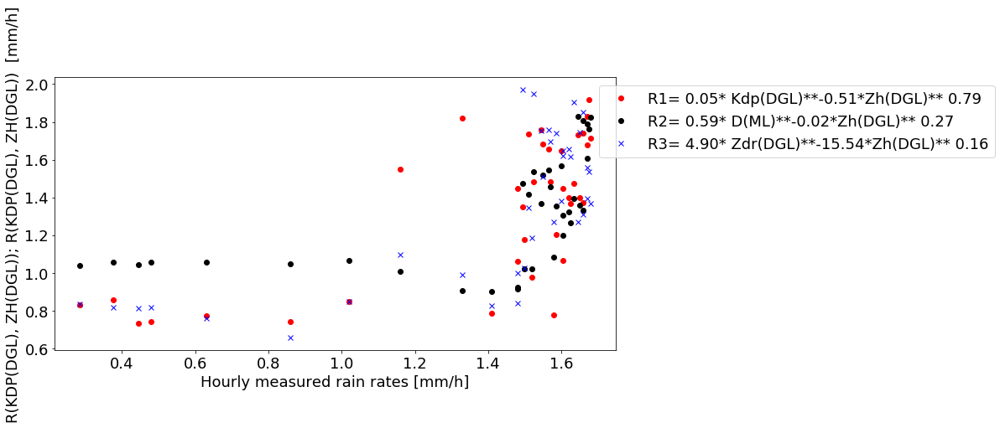

In [11]:
# the overall Snow retrieval
#print(Kdp_D_new_clim.dtype)
Kdp_D_new_clim=np.stack(Kdp_D_new_clim)
Zh_D_new_clim=np.stack(Zh_D_new_clim)
Zdr_D_new_clim=np.stack(Zdr_D_new_clim)
St_h_new_clim=np.stack(St_h_new_clim)
D_ML_new_clim=np.stack(D_ML_new_clim)
Zhlin_D_new_clim=10**(Zh_D_new_clim/10.)
Zdrlin_D_new_clim=10**(Zdr_D_new_clim/10.)
Dlin_ML_new_clim=10**(D_ML_new_clim/10.)

A = np.vstack([np.log10(Kdp_D_new_clim),np.log10(Zhlin_D_new_clim), np.ones(len(Kdp_D_new_clim))]).T
a,b,c=(np.linalg.lstsq(A,np.log10(St_h_new_clim))[0])
cc=10**(c)
Retrieval1_all=cc*Kdp_D_new_clim**a*Zhlin_D_new_clim**b
print('Retrieval1 all: cc,a,b',cc,a,b)

B = np.vstack([np.log10(Dlin_ML_new_clim),np.log10(Zhlin_D_new_clim), np.ones(len(Kdp_D_new_clim))]).T
d,e,f=(np.linalg.lstsq(B,np.log10(St_h_new_clim))[0])
ff=10**(f)
Retrieval2_all=ff*Dlin_ML_new_clim**d*Zhlin_D_new_clim**e

C = np.vstack([np.log10(Zdrlin_D_new_clim),np.log10(Zhlin_D_new_clim), np.ones(len(D_ML_new_clim))]).T
g,h,i=(np.linalg.lstsq(C,np.log10(St_h_new_clim))[0])
ii=10**(i)
Retrieval3_all=ii*Zdrlin_D_new_clim**(g)*Zhlin_D_new_clim**h

fig = pl.figure(figsize=(12,6))
ax = fig.add_subplot(111)
ax.plot(St_h_new_clim, Retrieval1_all,'ro',label=r'R1=%5.2f* Kdp(DGL)**%5.2f*Zh(DGL)**%5.2f' % (cc,a,b))
ax.plot(St_h_new_clim, Retrieval2_all,'ko',label=r'R2=%5.2f* D(ML)**%5.2f*Zh(DGL)**%5.2f' % (ff,d,e))
ax.plot(St_h_new_clim, Retrieval3_all,'bx',label=r'R3=%5.2f* Zdr(DGL)**%5.2f*Zh(DGL)**%5.2f' % (ii,g,h))
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels, bbox_to_anchor=(0.97, 0.97), borderaxespad=0.)
ax.set_ylabel('R(KDP(DGL), ZH(DGL)); R(KDP(DGL), ZH(DGL))  [mm/h]')
ax.set_xlabel('Hourly measured rain rates [mm/h]')
fig.savefig('/home/silke/Python/projects/climatology/Retrieval_high.png')
pl.show()

In [ ]:
### In the ML
#delta in ML with Rho in ML
c_DML_RML, p =pearsonr(D_ML, R_ML)
#Zdr in ML with Rho in ML
c_ZdrML_RML, p =pearsonr(Zdr_ML, R_ML)
#Zdr in ML with delta in ML
c_ZdrML_DML, p =pearsonr(Zdr_ML, D_ML)
#delta in ML with Kdp in ML
c_KdpML_DML, p =pearsonr(Kdp_ML, D_ML)
#delta in ML with height level of delta
c_DML_Dh, p =pearsonr(D_ML, Dh)

print('Pearson in ML',c_DML_RML,c_ZdrML_RML,c_ZdrML_DML,c_KdpML_DML,c_DML_Dh )

###ML with Sfc
#Zdr at Sfc with Zdr in ML
c_ZdrSfc_ZdrML, p = pearsonr(Zdr_S, Zdr_ML)
#Zdr at Sfc with delta in ML
c_ZdrSfc_DML, p = pearsonr(Zdr_S, D_ML)
#delta in ML with Z at Sfc
c_ZhSfc_DML, p = pearsonr(Zh_S, D_ML)
print('Pearson ML vs Sfc',c_ZdrSfc_ZdrML, c_ZdrSfc_DML, c_ZhSfc_DML)

###DGL with Sfc
#Lagged Kdp at DGL with Z at Sfc
lag = np.argmax(correlate(Kdp_D, Zh_S))
c_sig = np.roll(Zh_S, shift=int(np.ceil(lag)))
print('lag',lag)
print(c_sig)

In [ ]:
# Multilinear fitting from Ryzhkov S=1.48*kdpdlg**0.61 * Zhdgl**0.33

#direkt mit 5min-Werten

In [ ]:
#linKdp_D=10**(Kdp_D/10.)
Zh_D_clim=np.stack(Zh_D_clim)
Kdp_D_clim=np.stack(Kdp_D_clim)
Kdp_ML_clim=np.stack(Kdp_ML_clim)
D_ML_clim=np.stack(D_ML_clim)
St_clim=np.stack(St_clim)
linZh_D_clim=10**(Zh_D_clim/10.)
#Zh_D
#St

start=dates0
end=dates1

missing = np.isnan(Kdp_D_clim)

Kdp_D_new=Kdp_D_clim[~missing]
Kdp_ML_new=Kdp_ML_clim[~missing]
Zh_D_new=Zh_D_clim[~missing]
print(Kdp_D_new)
St_new=St_clim[~missing]
print(St_new)
D_ML_new=D_ML_clim[~missing]

fig, ax = pl.subplots(figsize=(10, 5))

#Retriev=1.53*Kdp_D_new**(0.68)*Zh_D_new**0.29
#Retriev=10**(-2.77364662)*Kdp_D_h_clim**(-0.64093149)*Zh_D_h_clim**(2.12240623)
Retriev=10**(-10.81956363)*Kdp_D_new**(0.65091226)*Zh_D_new**(9.26608004)


#Retriev=10**(0.5103135)*Kdp_D_h_clim**(0.36195831)*Kdp_ML_h_clim**(1.70192433)
#Retriev=10**(0.12927204)*Kdp_D_h_clim**(2.75357236)*D_ML_h_clim**(8.31533512)


ax.plot(St_new, Retriev, 'ro')
pl.show()

#Stundenmittel

In [ ]:
#linKdp_D=10**(Kdp_D/10.)
Zh_D_clim=np.stack(Zh_D_clim)
Kdp_D_clim=np.stack(Kdp_D_clim)
Kdp_ML_clim=np.stack(Kdp_ML_clim)
D_ML_clim=np.stack(D_ML_clim)
St_clim=np.stack(St_clim)
linZh_D_clim=10**(Zh_D_clim/10.)
#Zh_D
#St
print(Time)
start=dates0
end=dates1

missing = np.isnan(Kdp_D_clim)

Kdp_D_new=Kdp_D_clim[~missing]
Kdp_ML_new=Kdp_ML_clim[~missing]
#print(Kdp_D_new)
linZh_D_new=linZh_D_clim[~missing]
St_new=St_clim[~missing]
print(St_new)
D_ML_new=D_ML_clim[~missing]

Kdp_D_h_clim = np.zeros((len(Kdp_D_new)-12))
Kdp_ML_h_clim = np.zeros((len(Kdp_ML_new)-12))
Zh_D_h_clim = np.zeros((len(linZh_D_new)-12))
St_h_clim = np.zeros((len(St_new)-12))
D_ML_h_clim = np.zeros((len(D_ML_new)-12))

Kdp_D_h_clim=runningMean(Kdp_D_new,12)
Kdp_ML_h_clim=runningMean(Kdp_ML_new,12)
D_ML_h_clim = runningMean(D_ML_new,12)
print(Kdp_D_h_clim)
#Kdp_D_h=10*np.log10(Kdp_D_h)

Zh_D_h_clim=runningMean(linZh_D_new,12)
Zh_D_h_clim=10*np.log10(Zh_D_h_clim)
St_h_clim=runningMean(St_new, 12)
## NUll Niederschlag raus
missing2=St_h_clim<0.2
St_h_clim = St_h_clim[~missing2]
Kdp_ML_h_clim = Kdp_ML_h_clim[~missing2]
Zh_D_h_clim = Zh_D_h_clim[~missing2]
Kdp_D_h_clim =Kdp_D_h_clim[~missing2]
D_ML_h_clim = D_ML_h_clim[~missing2]
#plot(St_h_clim,Kdp_D_h_clim)

thourly=Time[0:len(Kdp_D_h_clim)]
print(thourly.shape)
fig, ax = pl.subplots(figsize=(10, 5))

#Retriev=1.53*Kdp_D_h_clim**(0.68)*Zh_D_h_clim**0.29
#Retriev=10**(-2.77364662)*Kdp_D_h_clim**(-0.64093149)*Zh_D_h_clim**(2.12240623)
Retriev=10**(-10.81956363)*Kdp_D_h_clim**(0.65091226)*Zh_D_h_clim**(9.26608004)


#Retriev=10**(0.5103135)*Kdp_D_h_clim**(0.36195831)*Kdp_ML_h_clim**(1.70192433)
#Retriev=10**(0.12927204)*Kdp_D_h_clim**(2.75357236)*D_ML_h_clim**(8.31533512)


ax.plot(St_h_clim, Retriev, 'ro')
pl.show()
print('Kdp_D_h_clim',Kdp_D_h_clim)
print('D_ML_h_clim',D_ML_h_clim)
print('Zh_D_h_clim',Zh_D_h_clim)
print('Kdp_ML_h_clim',Kdp_ML_h_clim)
print('St_h_clim',St_h_clim)

In [ ]:
#A = np.array([Kdp_D_h,Zh_D_h])

A = np.vstack([np.log10(Kdp_D_h_clim),np.log10(Zh_D_h_clim), np.ones(len(Kdp_D_h_clim))]).T
#A = np.vstack([np.log10(Kdp_D_h_clim), np.log10(D_ML_h_clim), np.ones(len(Kdp_D_h_clim))]).T
print(np.linalg.lstsq(A,np.log10(St_h_clim))[0])
10**(-6.8924571)
